In [1]:
import h5py
import os
import numpy as np
import matplotlib.pyplot as plt
from scipy.optimize import curve_fit
import cv2
import statistics
import skimage as ski
from skimage.morphology import square,disk
from scipy import signal
from scipy import stats
from pathlib import Path
import hashlib
import numbers
import matplotlib.colors as mcolors
import matplotlib.cm as cm

# Functions for Screen Sorting

In [2]:
def check_plunger_states(files, plengths=None):
    """
    Checks is plunger in the line, and which one.....
    """
    if plengths is None:

        plengths = [0.5, 1.5, 2.5, 3.5, 4.5, 5.5, 6.5, 7.5, 8.5, 9.5, 10.3]
        
    results = []

    for i, file_path in enumerate(files):
        
        plunger_state = 0
        plunger_in = None
        is_there_a_plunger = 0
 
        try:

            with h5py.File(file_path, 'r') as f:
                
                for p in range(len(plengths)):
                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PE_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])

                    try:
                        plunger = list(f['AwakeEventData'][f'AWAKE.XAWAV2_PG_P{p + 1}_ST']['PosSt']['value'])

                    except:
                        pass

                    else:
                        plunger_state = int(plunger[0])
                        

                    if plunger_state == 3 or plunger_state == 4:
                        plunger_in = p + 1
                        is_there_a_plunger = 1

                        break
 

        except Exception as e:
            print(f"Error reading file {file_path}: {e}")

            continue
 
        results.append({
            "index": i,
            "file": file_path,
            "is_there_a_plunger": bool(is_there_a_plunger),
            "plunger_in": plunger_in
        })

    return results

In [3]:
def load_all_event_data(date,event_filename,spectro_no,threshold):
    
    with h5py.File('/eos/experiment/awake/event_data/'+date+'/'+ event_filename, 'r') as f:
        root = f['AwakeEventData']

        # Main data
        spectro_path = f'TCC4.SPECTRO{spectro_no}.DigiCam'
        data = root[spectro_path]['ExtractionImage']['image2D'][:]

        try:
            protons = root['TT41.BCTF.412340']['CaptureAcquisition']['totalIntensity'][0]
            
            ## sort BTV54
            screen_of_interest = root['TT41.BTV.412354.DigiCam']['ExtractionImage']['image2D'][400:610,510:720]
            bg_sensor = np.array(screen_of_interest) - 3.78126279
            w_median_filter = ski.filters.median(bg_sensor, footprint=disk(3)) 

            total_count = np.sum(w_median_filter)

            if protons !=0 and total_count > threshold:
                BTV54_position = 1

            else:
                BTV54_position = 0
                
                
        except(ValueError, KeyError):
            protons=0
            BTV54_position = 0
        
        rif = root['Sps2AwakeSynchro']['ProtonDelayNs']['delay'][0]
        plunger_status = check_plunger_states(['/eos/experiment/awake/event_data/'+date+'/'+ event_filename])
        
        # Screens
        screens = {
            'OTR': root['MPP-VACTRANS-OTR']['Acquisition']['end_switch_plus_active'][()],
            'CTR': root['MPP-VACTRANS-CTR']['Acquisition']['end_switch_plus_active'][()],
            'LDBP': root['LBDP2']['Acq']['position'][0],
            'BTV50': root['TT41.BTV.412350.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV53': root['TT41.BTV.412353.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV426': root['TT41.BTV.412426.BTVI']['SisAcquisition']['screenIn'][0],
            'BTV442': root['TT41.BTV.412442.BTVI']['SisAcquisition']['screenIn'][0],
            'Plunger': plunger_status[0]['plunger_in'],
            'BTV54': BTV54_position
        }

    return data, protons, rif, screens

In [4]:
def sort_by_rif(Date):
    
    rif_data = {}
    
    DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
    event_files = os.listdir(DATA_PATH)

    for i in np.arange(0,len(event_files),1):
        filename = event_files[i]

        data, protons, rif, screens = load_all_event_data(Date,filename,spectro_no=1,threshold=1750000)

        bg_sensor = np.array(data) - 3.78126279
        w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 


        if rif not in rif_data:
            rif_data[rif] = {'fit_parameters': [], 'proton_count': [],'density': [], 'OTR_screen': [],'CTR_screen': [],'LDBP_screen': [],
                            'BTV50_screen': [],'BTV53_screen': [],'BTV426_screen': [], 'BTV442_screen': [], 'BTV54_screen': [], 'Plunger_screen': []}


        # Store values for the corresponding RIF
        rif_data[rif]['fit_parameters'].append(np.mean(w_median_filter))
        rif_data[rif]['proton_count'].append(protons)
        #rif_data[rif]['density'].append(density)

        ## Store screen positions
        rif_data[rif]['OTR_screen'].append(screens['OTR'])
        rif_data[rif]['CTR_screen'].append(screens['CTR'])
        rif_data[rif]['LDBP_screen'].append(screens['LDBP'])
        rif_data[rif]['BTV50_screen'].append(screens['BTV50'])
        rif_data[rif]['BTV53_screen'].append(screens['BTV53'])
        rif_data[rif]['BTV426_screen'].append(screens['BTV426'])
        rif_data[rif]['BTV442_screen'].append(screens['BTV442'])
        rif_data[rif]['Plunger_screen'].append(screens['Plunger'])
        rif_data[rif]['BTV54_screen'].append(screens['BTV54'])
        
    return rif_data

# Functions for Plotting

In [5]:
def get_colour_for_combination(combo):
    
    colour_list = [
        "#FFD700",
        "#3D3D3D",
        "#7FFFD4",
       "#12436D",
        "#FF0000" ,
        "#28A197",
        "#00FFFF",
        "#F46A25" ,
        "#801650",
        "#A285D1",
        "#6BACE6", # Light blue 
        "#8B0000",
        "#FF00FF",
        "#008000" ,
        "#3776ab" ,
        "#9370DB" ,
    ]

    
    hash_val = int(hashlib.md5(combo.encode()).hexdigest(), 16)
    return colour_list[hash_val % len(colour_list)]

In [6]:
def fit_line(x,a,b):
    return a*x + b

In [7]:
list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']
screen_combinations = {}

def plot_all_screens_per_rif(rif_data):
    for rif, data in rif_data.items():
        screen_combinations[rif] = {}

        fig, ax = plt.subplots(figsize=(10, 6))
        plotted_labels = set()

        for i in range(len(data['fit_parameters'])):  
            active_screens = []

            # Determine which screen is active
            screen_used = None
            for screen in list_screens: 

                if screen =='LDBP':
                    val = data.get(f'LDBP_screen', None)[i]
                    if val == 0:
                        active_screens.append('LDBP')
                        
                if screen == 'Plunger':
                    val = data.get(f'Plunger_screen')[i]
                    
                    for j in np.arange(1,11,1):
                        if val == j:
                            active_screens.append(f'Plunger{j}')                
                
                else:
                    val = data.get(f'{screen}_screen',None)[i]

                    if isinstance(val, (bool, np.bool_)):
                        if val == False:
                            active_screens.append(screen)

                    elif isinstance(val, numbers.Number):
                        if float(val) == 1:
                            active_screens.append(screen)

            if not active_screens:
                active_screens = ['None']

            # Create a combined label
            screen_label = '+'.join(active_screens)
            colour = get_colour_for_combination(screen_label)
            
            if screen_label not in screen_combinations[rif]:
                screen_combinations[rif][screen_label] = {'fit_parameters': [0], 'proton_count': [0]}
        
    
            # Store values for the corresponding Screen combination
            screen_combinations[rif][screen_label]['fit_parameters'].append(data['fit_parameters'][i])
            screen_combinations[rif][screen_label]['proton_count'].append(data['proton_count'][i])

            # Plot with unique legend entries
            show_label = screen_label not in plotted_labels
            ax.scatter(data['fit_parameters'][i], data['proton_count'][i], color=colour, label=screen_label if show_label else None, alpha=0.7)
            plotted_labels.add(screen_label)
        
        for screen_label, combo_data in screen_combinations[rif].items():
            print(screen_label)
            x = np.array(combo_data['fit_parameters'])
            #print(len(x))
            y = np.array(combo_data['proton_count'])

            if len(x) >= 2:  # Curve fitting requires at least two data points
                params = curve_fit(fit_line, x, y)[0]
                a, b = params
                colour = get_colour_for_combination(screen_label)
                ax.plot(np.sort(x), a*np.sort(x)+b, '--', color=colour, alpha=0.8)
            

        ax.set_title(f'RIF Offset = {round(rif - 1132482.599, 4)}', fontsize=16)
        ax.set_xlabel('Mean Pixel Intensity', fontsize=14)
        ax.set_ylabel('Proton Bunch Density', fontsize=14)
        ax.grid()

        ax.legend(title="Screen Active", loc='best')

        plt.tight_layout()
        plt.show()
        #print(screen_combinations)

## Test plotting/RIFs

In [15]:
Rif_data_17 = sort_by_rif('2025/05/17')

OTR+CTR+BTV442
OTR+CTR+BTV442+BTV54
OTR+CTR+BTV53+BTV426+BTV442+LDBP
OTR+CTR+BTV53+BTV426+BTV442+LDBP+BTV54
OTR+CTR+BTV426+BTV442+LDBP
OTR+CTR+BTV426+BTV442+LDBP+BTV54
OTR+CTR+BTV426+BTV442+LDBP+Plunger2


/tmp/ipykernel_468/704730851.py:68: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


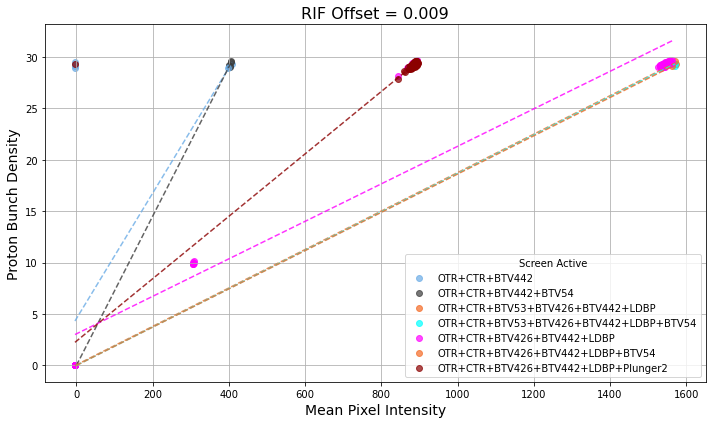

OTR+CTR+BTV426+BTV442+LDBP


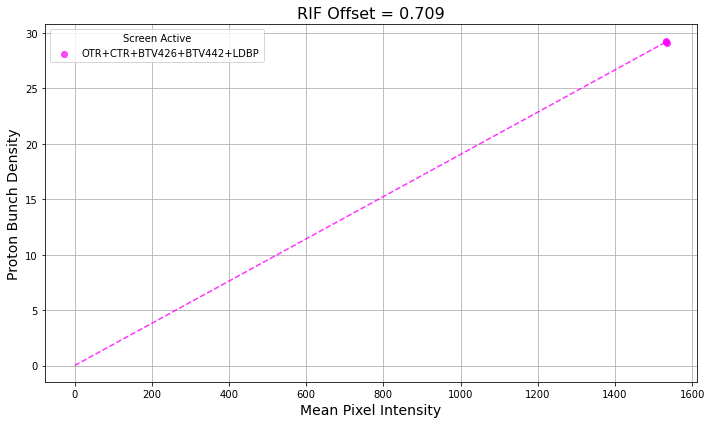

OTR+CTR+BTV426+BTV442+LDBP


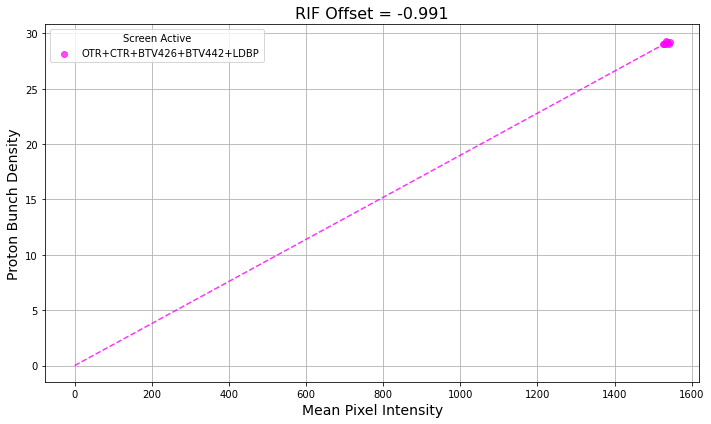

OTR+CTR+BTV426+BTV442+LDBP
OTR+CTR+BTV426+BTV442+LDBP+Plunger10
OTR+CTR+BTV426+BTV442+LDBP+Plunger8
OTR+CTR+BTV426+BTV442+LDBP+Plunger6
OTR+CTR+BTV426+BTV442+LDBP+Plunger4
OTR+CTR+BTV426+BTV442+LDBP+Plunger3
OTR+CTR+BTV426+BTV442+LDBP+Plunger2
OTR+CTR+BTV426+BTV442+LDBP+Plunger1
OTR+CTR+BTV426+BTV442+LDBP+Plunger5
OTR+CTR+BTV426+BTV442+LDBP+Plunger7
OTR+CTR+BTV426+BTV442+LDBP+Plunger9


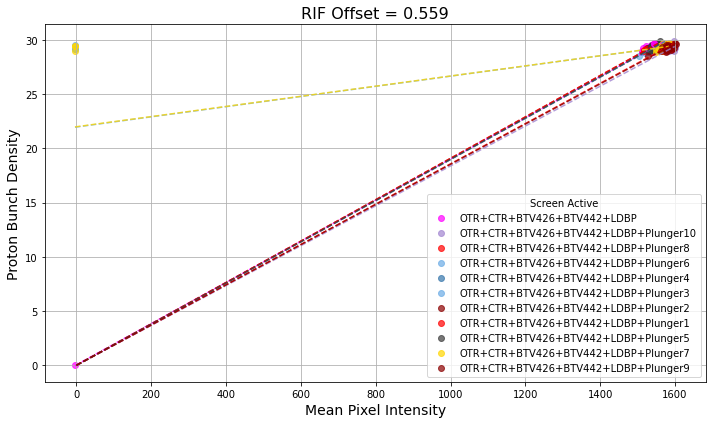

OTR+CTR+BTV426+BTV442+LDBP
OTR+CTR+BTV426+BTV442+LDBP+Plunger10
OTR+CTR+BTV426+BTV442+LDBP+Plunger8
OTR+CTR+BTV426+BTV442+LDBP+Plunger6
OTR+CTR+BTV426+BTV442+LDBP+Plunger4
OTR+CTR+BTV426+BTV442+LDBP+Plunger2
OTR+CTR+BTV426+BTV442+LDBP+Plunger1
OTR+CTR+BTV426+BTV442+LDBP+Plunger3
OTR+CTR+BTV426+BTV442+LDBP+Plunger5
OTR+CTR+BTV426+BTV442+LDBP+Plunger7
OTR+CTR+BTV426+BTV442+LDBP+Plunger9


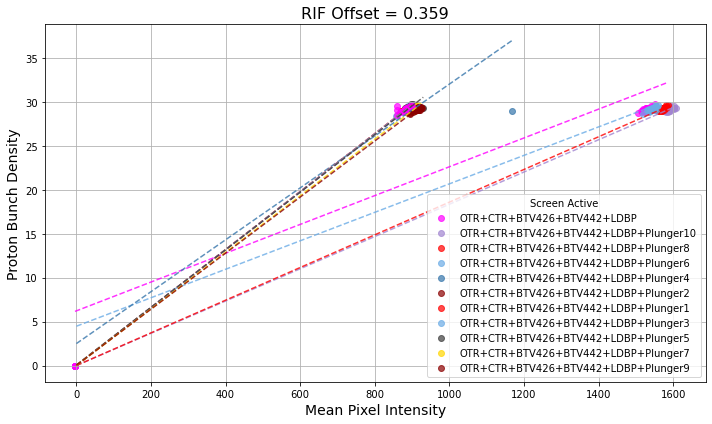

OTR+CTR+BTV426+BTV442+LDBP


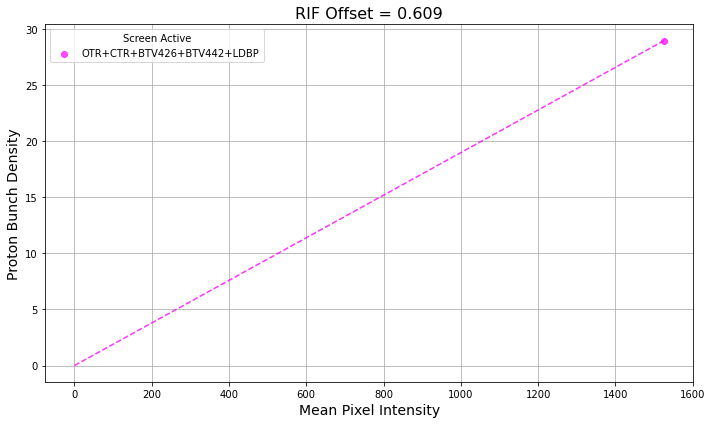

OTR+CTR+BTV426+BTV442+LDBP


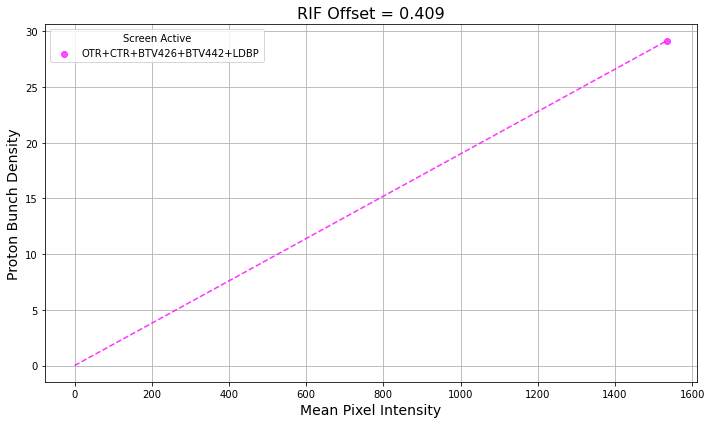

OTR+CTR+BTV426+BTV442+LDBP+Plunger2


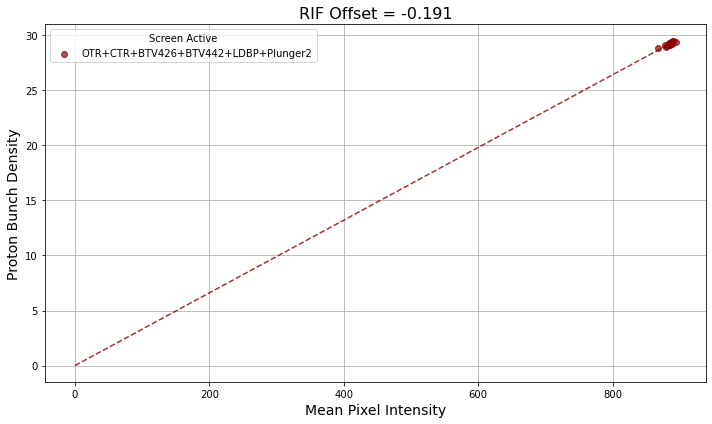

OTR+CTR+BTV426+BTV442+LDBP+Plunger2


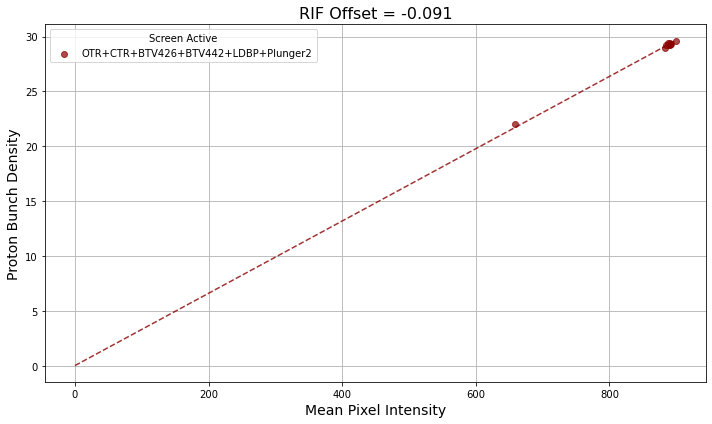

OTR+CTR+BTV426+BTV442+LDBP+Plunger2


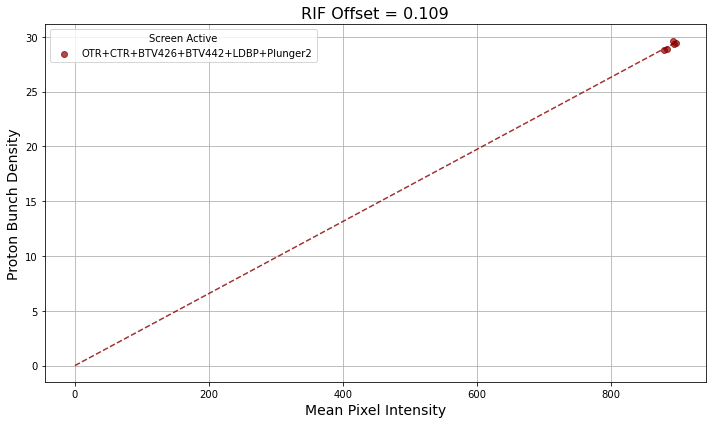

OTR+CTR+BTV426+BTV442+LDBP+Plunger2


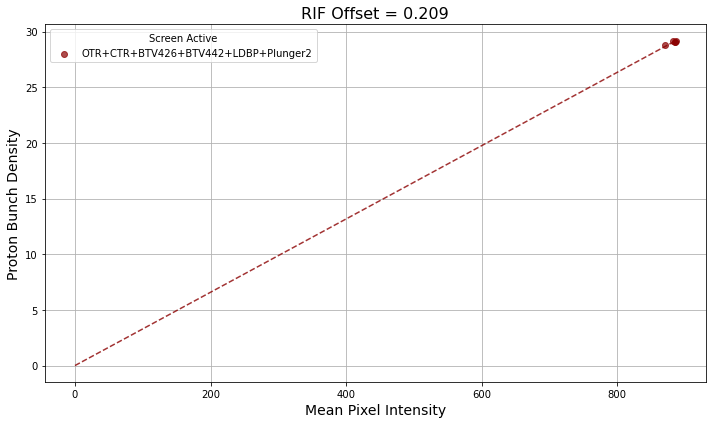

OTR+CTR+BTV426+BTV442+LDBP
OTR+CTR+BTV426+BTV442+LDBP+Plunger2


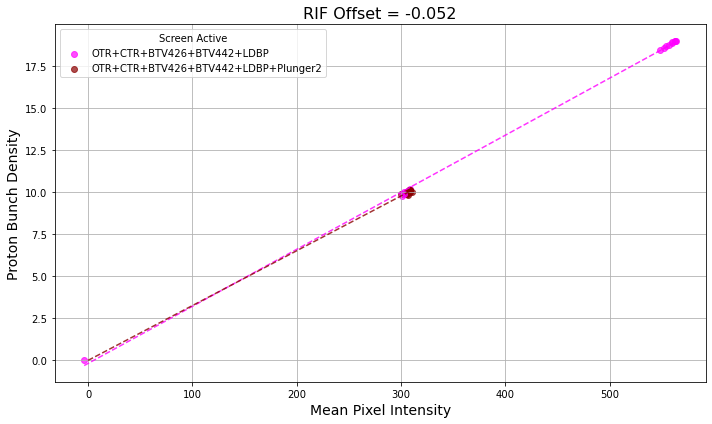

OTR+CTR+BTV426+BTV442+LDBP+Plunger2


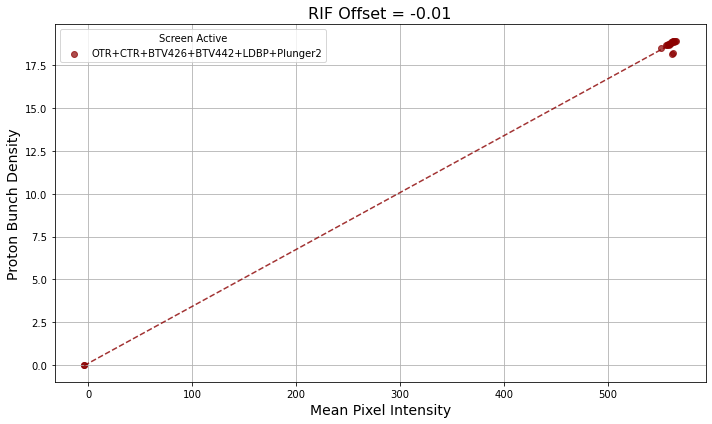

In [19]:
plot_all_screens_per_rif(Rif_data_17)

# Spatial Map???

In [2]:
Date = '2025/05/17'
DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
event_files = os.listdir(DATA_PATH)
filename = event_files[200]

In [7]:
ex_data, protons, rif, screens = load_all_event_data('2025/05/17',filename,spectro_no=1,threshold=1750000)

In [50]:
print(ex_data,protons,rif,screens)

[[   3   11  116 ...    8   31    1]
 [  38   79   81 ...    0    6    4]
 [ 109  165   16 ...    2  103   50]
 ...
 [   5    7  134 ...   13   39  122]
 [   1  144  870 ...   15   38  111]
 [  62 1030  106 ...    1   16  109]] 28.982847 1132483.158 {'OTR': False, 'CTR': False, 'LDBP': 0, 'BTV50': 0, 'BTV53': 0, 'BTV426': 1, 'BTV442': 1, 'Plunger': 8, 'BTV54': 0}


2


(1216, 1936)

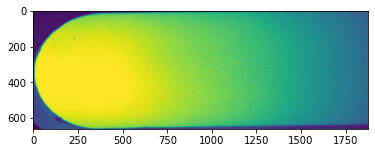

In [65]:
plt.imshow(ex_data[330:990,60:],vmax=4095)
print(ex_data.ndim)
ex_data.shape

In [197]:
list_indices_y = np.arange(0,1216,int(1216/4))
list_indices_y

array([  0, 304, 608, 912])

In [198]:
1936/176

11.0

In [199]:
list_indices_x = np.arange(0,1936,int(1936/4))
list_indices_x

array([   0,  484,  968, 1452])

[[146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821]
 [146.39899821 146.39899821 146.39899821 146.39899821 146.39899821
  146.39899821 146.39899821 146.3

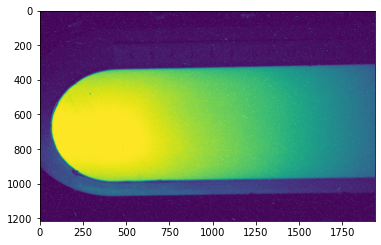

In [205]:
y_step = int(1216/4)
x_step = int(1936/4)

results = []
list_means= []
intensity_grid = np.zeros((1216, 1936))

for i in list_indices_y:
    for j in list_indices_x:        
        sliced_data = ex_data[i:i+y_step,j:j+x_step]
        
        block_mean = np.mean(sliced_data)
        list_means.append(block_mean)
        
        intensity_grid[i:i+y_step, j:j+x_step] = block_mean       
        
print(intensity_grid[8:16,11:22])
print(list_means)
plt.imshow(ex_data)
#print(results[0])

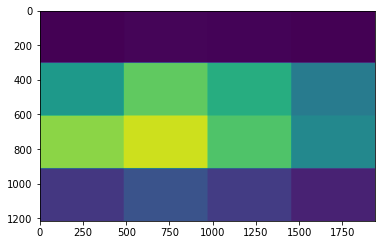

In [206]:
plt.imshow(intensity_grid,vmax=4095)

In [8]:
def sort_by_space_2(Date):
    
    y_step = int(1216/4)
    x_step = int(1936/4)    
    
    list_indices_y = list(range(0, 1216, y_step))
    list_indices_x = list(range(0, 1936, x_step))
    
    rif_data = {}
    
    DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
    event_files = os.listdir(DATA_PATH)

    for i in np.arange(0,400,1):
        filename = event_files[i]
        
        data, protons, rif, screens = load_all_event_data(Date,filename,spectro_no=1,threshold=1750000)
        bg_sensor = np.array(data) - 3.78126279
        w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
        
        if rif not in rif_data:
            rif_data[rif] = {}
            
            
        ## check what screens are in
        active_screens = []
        list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']

        # Determine which screen is active
        screen_used = None
        for screen in list_screens: 

            if screen =='LDBP':
                val = screens['LDBP']
                if val == 0:
                    active_screens.append('LDBP')

            if screen == 'Plunger':
                val = screens['Plunger']

                for j in np.arange(1,11,1):
                    if val == j:
                        active_screens.append(f'Plunger{j}')                

            else:
                val = screens[screen]

                if isinstance(val, (bool, np.bool_)):
                    if val == False:
                        active_screens.append(screen)

                elif isinstance(val, numbers.Number):
                    if float(val) == 1:
                        active_screens.append(screen)

        if not active_screens:
            active_screens = ['None']

        # Create a combined label
        screen_label = '+'.join(active_screens)
        #colour = get_colour_for_combination(screen_label)

        if screen_label not in rif_data[rif]:
            rif_data[rif][screen_label] = {'full_image': {'fit_parameters': [], 'proton_count': [] }}
            
        ## Add full camera image
        rif_data[rif][screen_label]['full_image']['fit_parameters'].append(np.mean(w_median_filter))
        rif_data[rif][screen_label]['full_image']['proton_count'].append(protons)

        for i in list_indices_y:
            for j in list_indices_x:        
                sliced_data = w_median_filter[i:i+y_step,j:j+x_step]
                #print(np.mean(sliced_data))

                index_cut = (i, i+y_step , j, j+x_step)

                if index_cut not in rif_data[rif][screen_label]:
                    rif_data[rif][screen_label][index_cut] = {
                        'fit_parameters': [], 'proton_count': []}

                rif_data[rif][screen_label][index_cut]['fit_parameters'].append(np.mean(sliced_data))
                rif_data[rif][screen_label][index_cut]['proton_count'].append(protons)


    return rif_data

In [16]:
events_100 = sort_by_space_2('2025/05/17')
#print(events_200)

In [9]:
events_full = sort_by_space_2('2025/05/17')

In [11]:
## want to plot divided by rif/screens and now place on camera 

In [93]:
list(events_200)

[1132482.608, 1132483.308, 1132481.608, 1132483.158]

In [94]:
list(events_200[1132482.608])

['OTR+CTR+BTV442',
 'OTR+CTR+BTV442+BTV54',
 'OTR+CTR+BTV53+BTV426+BTV442+LDBP',
 'OTR+CTR+BTV53+BTV426+BTV442+LDBP+BTV54',
 'OTR+CTR+BTV426+BTV442+LDBP',
 'OTR+CTR+BTV426+BTV442+LDBP+BTV54']

In [90]:
list(events_200[1132482.608]['OTR+CTR+BTV442'][(0, 304, 0, 484)])

['fit_parameters', 'proton_count']

In [59]:
len(list(events_200[1132482.608][(0, 304, 0, 484)]['fit_parameters']))

112

In [27]:
len(list(events_200[1132482.608][(0, 304, 484, 968)]['fit_parameters']))

91

In [28]:
len(list(events_200[1132482.608][(0, 304, 968, 1452)]['fit_parameters']))

91

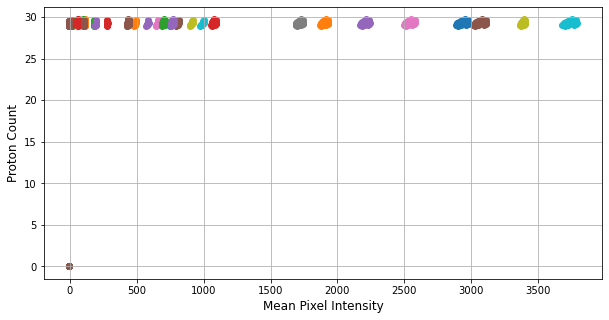

In [60]:
plt.figure(figsize=(10,5))
index_counts = list(events_200[1132482.608])

for n in index_counts:
    plt.scatter(events_200[1132482.608][n]['fit_parameters'],events_200[1132482.608][n]['proton_count'])
    
plt.xlabel('Mean Pixel Intensity',fontsize=12)
plt.ylabel('Proton Count',fontsize=12)
plt.grid()

In [50]:
## need to sort screen positions

In [153]:
events_200[1132482.608].items()

dict_items([('OTR+CTR+BTV442', {(0, 304, 0, 484): {'fit_parameters': [-3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, -3.7787481097042197, 10.788502597124838, 10.486489493601564, 10.341664297864288, -3.778517030974337, -3.7801073963505876, -3.77933939939539, -3.7802229357155293, -3.7789859848673344, -3.7802365285819928, -3.7790063741670297, -3.780019042718574, -3.778918020535016, -3.7802229357155293, -3.7803384750804705], 'proton_count': [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 29.332003, 29.50658, 28.921316, 29.144547, 29.316265, 29.032932, 28.935625, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0]}, (0, 304, 484, 968): {'fit_parameters': [-3.779319010095694, -3.779319010095694, -3.779319010095694, -3.779319010095694, -3.

In [174]:
events_200.keys()

dict_keys([1132482.608, 1132483.308, 1132481.608, 1132483.158])

In [47]:
def plot_spatially_sliced(rif_data):
    list_rifs = list(rif_data)
    #colour_list = ["#FFD700", "#3D3D3D", "#7FFFD4","#12436D", "#FF0000" , "#28A197", "#00FFFF", "#F46A25" , "#801650",
     #   "#A285D1","#6BACE6",   "#8B0000", "#FF00FF", "#008000" , "#3776ab" ,"#4f3222" ]
    
    colour_distinct_list = ['#0000ff','#e6194b', '#3cb44b', '#4363d8', '#f58231', '#911eb4', '#46f0f0', '#f032e6', '#bcf60c', 
    '#008080', '#e6beff', '#9a6324', '#800000', '#aaffc3', '#808000', '#000075', '#ffe119']
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            plotted_labels = set()

            data = rif_data[rif][screen_label]
            index_count = list(data)
            #print(index_count)
    
            list_slopes = []
            slopes_mean = []
            
            for i,n in zip(index_count, np.arange(0,17,1)):
                colour = colour_distinct_list[n]
                show_label = i not in plotted_labels
                
                x = np.array(data[i]['fit_parameters'])
                y = np.array(data[i]['proton_count'])
                
                mean_x = np.mean(x)
                mean_y = np.mean(y)

                std_x = np.std(x)
                std_y = np.std(y)

                mask = (np.abs(x - mean_x) <= 2 * std_x) & (np.abs(y - mean_y) <= 2 * std_y)

                # Filter out outliers > 2 std deviations
                filtered_x = x[mask]
                filtered_y = y[mask]

                # Filter out outliers > 2 std deviations
                filtered_x = x[mask]
                filtered_y = y[mask]
                
                ax.scatter(filtered_y, filtered_x, color=colour, label=i if show_label else None)
                plotted_labels.add(i)
                

                if len(filtered_x) >= 2:  # Curve fitting requires at least two data points
                    #guess_a, guess_b = np.polyfit(filtered_y,filtered_x,1)
                    #print(guess_a,guess_b)
                    params = curve_fit(fit_line, filtered_y, filtered_x, p0=[1,0])[0]
                    a, b = params
                    print(a,b)
                    list_slopes.append({"slope": a,"camera section": i, "colour": colour})
                    slopes_mean.append(a)
                    
                    x_fitted = np.linspace(0,30,1000)
                    y_fitted = fit_line(x_fitted,a,b)
                    ax.plot(x_fitted, y_fitted, '--', color=colour, alpha=0.8)
                
            #print(list_slopes)
            #print(np.mean(slopes_mean[1:]))


            ax.set_title(f'RIF Offset = {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
            ax.set_ylabel('Mean Pixel Intensity', fontsize=14)
            ax.set_xlabel('Proton Bunch Density', fontsize=14)
            ax.grid()
            #ax.set_ylim(0,31)

            ax.legend(title="Position", loc='best')

            plt.tight_layout()
            plt.show()

In [37]:
slopesss = [1.7179378246693537,0.9012587039606746,1.0681612150392374,1.6912834272398252,0.04220241902664712,0.030403672853450133,
       0.037544403240829305,0.05595925650550282,0.027044269214634823,0.024825247807681,0.03228602189408836,0.050115206252518196
        , 0.13420622423466674, 0.08730259687522124, 0.12494454331534255,0.22149464881921857]
len(slopesss)
np.mean(slopesss)

0.39043560505930575

[{'slope': 0.06062452878964879, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 1.7179378103005427, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.9012587116064816, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 1.0681612191619878, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 1.6912834130504915, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.042202419822109774, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.030403672640498973, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.037544402886717065, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.05595925791107278, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.027044269320084215, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.02482524787917018, 'camera section': (608, 912, 484, 968), 'colour': '#e6

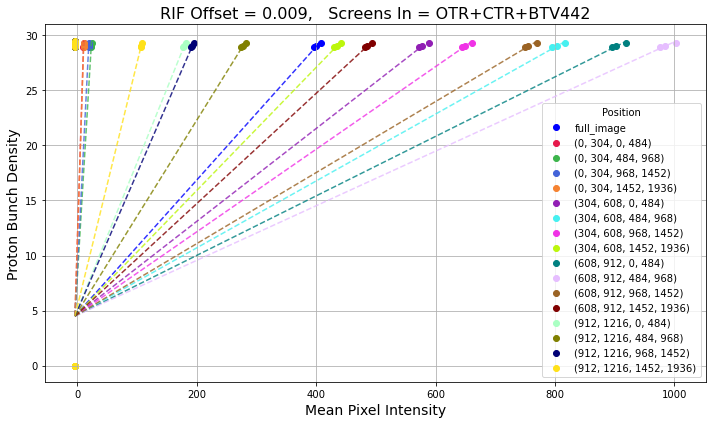

[{'slope': 0.06421298561465041, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 1.6149325193694604, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 1.01199929959175, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 1.2882557197414197, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 1.3794713894267414, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.0445709002506451, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.032482894349262874, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.03925643180661514, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.0584141819473777, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.028813134617392367, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.02630933130537933, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}

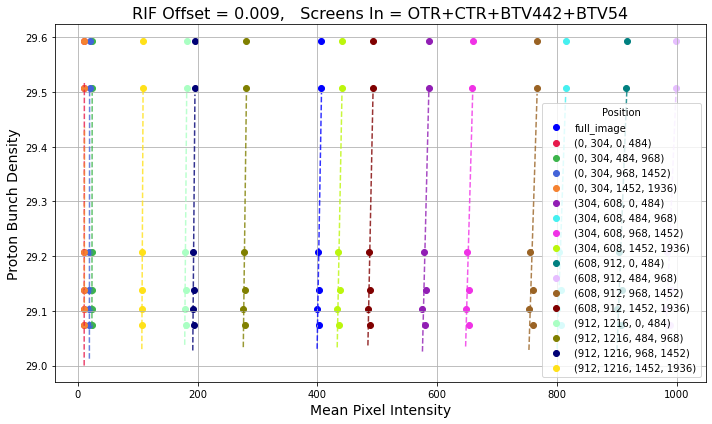

[{'slope': 0.0186935580865126, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.4237034626052269, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.2445141691274619, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.2806108621482256, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.4153919936345463, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.013130197196226165, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.009453115439811971, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.011415197798020495, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.016869905288309117, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.008651316969479914, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.0077702187887222236, 'camera section': (608, 912, 484, 968), 'colour': '#

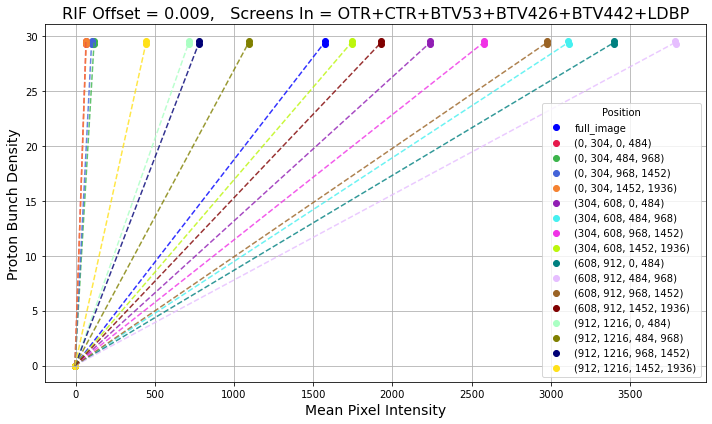

[{'slope': -0.010929141915041761, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.12629024997174837, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': -0.10399727289664892, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': -0.0810165569382415, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': -0.11810655179599, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': -0.007736143594480372, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': -0.00483780328483998, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': -0.005378832572194567, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': -0.007368286492068585, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': -0.020896485381082762, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': -0.004971204623492491, 'camera section': (608, 912, 484, 968), 'c

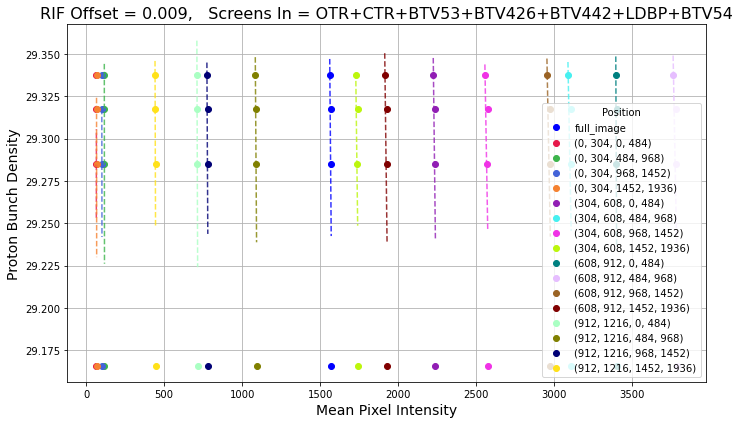

[{'slope': 0.01892560611365743, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.44788665565972857, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.25323686676310003, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.29133446963710957, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.4365455975325654, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.013308678524260755, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.009584592594218322, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.011569594228439352, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.01710258740394713, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.008660034207036538, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.007857958529939923, 'camera section': (608, 912, 484, 968), 'colour': 

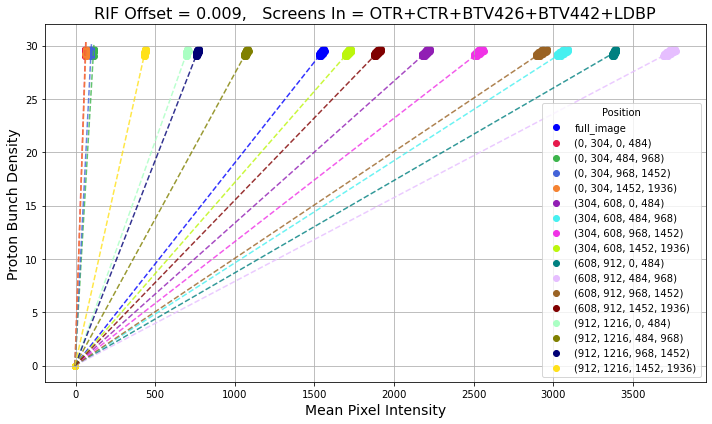

[]
nan


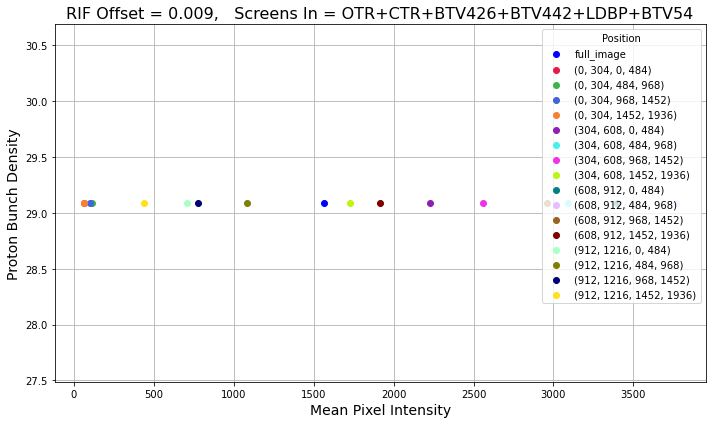

/tmp/ipykernel_537/3696718176.py:34: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y,p0=[guess_a,guess_b])[0]


[{'slope': -0.01081717720359589, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -0.6131918114919561, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': -0.08992178412816654, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': -0.0992227978010131, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': -0.0524533558002718, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': -0.0075397426402216364, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': -0.004965089272019675, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': -0.005762537957037763, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': -0.0098806828461056, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': -0.00881412326699474, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': -0.004895069558128415, 'camera section': (608, 912, 484, 968), 'c

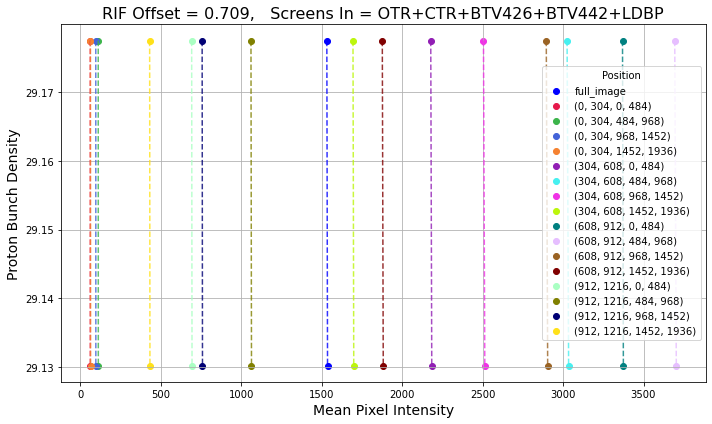

[{'slope': 0.008035099837742456, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.24819855094117496, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.03010826015538094, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.04576420778162013, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.0056878579822160664, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.005070112898483048, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.003712129503036892, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.004677386209336956, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.006905475414092687, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.007221062027945677, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.0033814601012479724, 'camera section': (608, 912, 484, 968), 'col

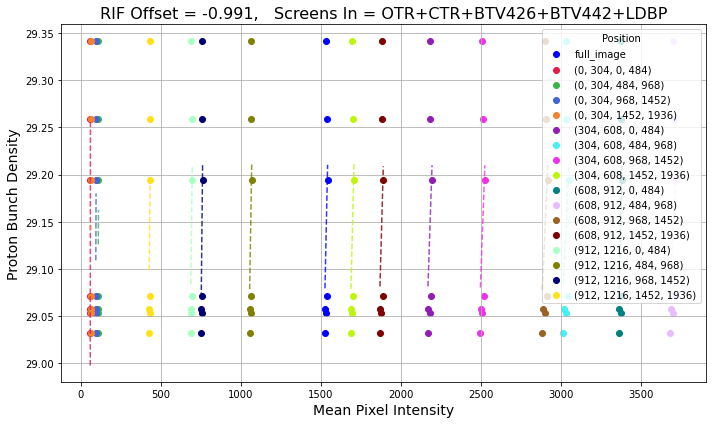

In [25]:
plot_spatially_sliced(events_100)

In [106]:
events_full = sort_by_space_2('2025/05/17')

1.0179853758840451e-06 -3.7789770835568723
1.5061691479467676e-05 -3.7791883287829995
8.170307027155488e-06 -3.779557809638077
8.043471730667662e-06 -3.779323023800163
-6.447460918490577e-07 -3.779830287421948
2.3221428898101415e-05 -3.778285018616765
3.077869865808491e-05 -3.7780233537108665
2.7533828985015774e-05 -3.7778673456313006
4.978285394363624e-06 -3.7790431352255687
-3.4731732070802934e-05 -3.7794184953963312
-3.2279583001670886e-05 -3.7792047159558777
-2.7163892703185866e-05 -3.7793270502469003
-2.779806918629113e-05 -3.779492018404002
6.954802100778146e-06 -3.778944586361399
-2.1139216110910297e-07 -3.7787079490246733
6.574296210648534e-06 -3.7785188826101623
7.800370745214558e-06 -3.7789013360826265


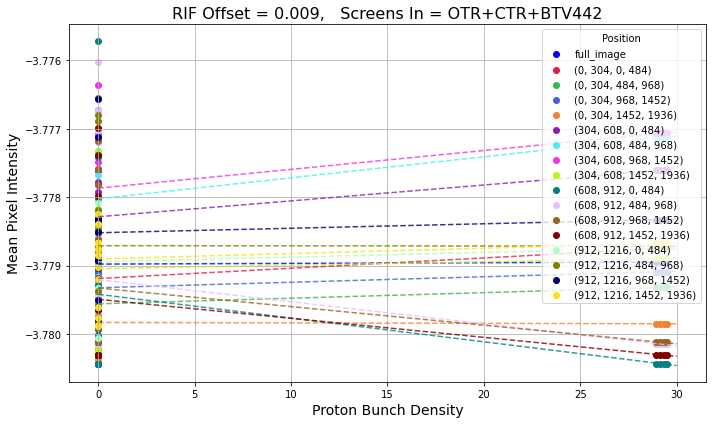

11.463924625106937 67.72619122253072
0.45439043730805895 -2.7662656321586465
0.6930489305502585 3.2429513205793827
0.5908024641481253 1.979595627537155
0.27617496259872076 2.6477754644549885
16.725750082033507 91.43039940362137
22.580127569676424 146.92285798659438
18.331781019340635 117.06723887128868
12.548810594484099 69.86371699390101
25.563965312967728 160.62298525534348
28.07570416621404 168.599999449992
21.48188302970754 131.65878506799626
13.681287198806768 88.25126763253016
5.351850717211292 23.3474976835897
8.233959561346193 37.85895268337837
5.61549433203508 29.318566440301694
3.2176820446159913 13.57512323413802


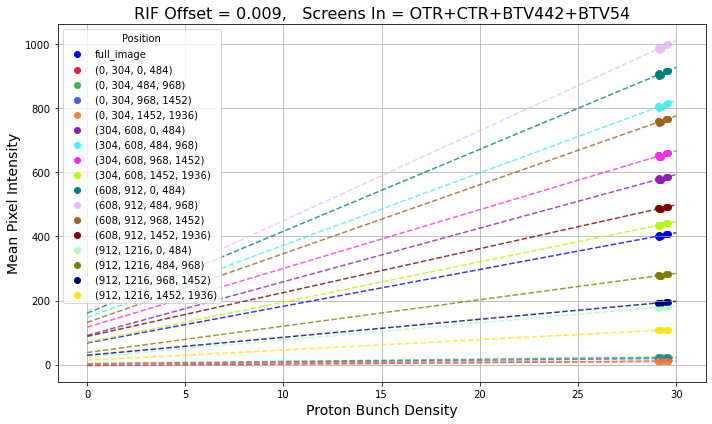

53.49216406648036 -3.760588899601753
2.360141152753907 -3.779063088565264
4.089650965382899 -3.778272136513832
3.5635830116136042 -3.778360052787808
2.4073191590597487 -3.7790651063027774
76.15702575729799 -3.751793961062428
105.78054348362912 -3.7408526107270936
87.59893326607525 -3.7489187304877793
59.27481097651434 -3.7592428654969137
115.58455804112548 -3.7390778396616744
128.69116301663726 -3.734330897024449
101.21961121680526 -3.7435828082519946
65.63612816570152 -3.756419852496206
24.40692540814264 -3.769917254866026
37.24937385146623 -3.766111099042792
26.610069877385175 -3.770099451665273
15.244787653394129 -3.774313401221862


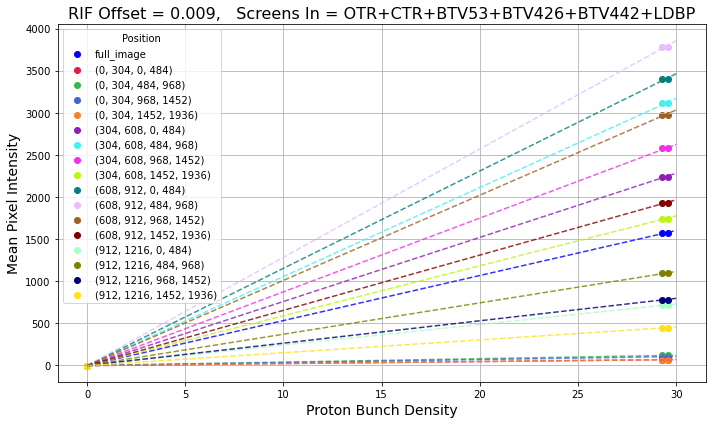

-35.70412101073672 2612.6226410390123
0.8291859439089609 40.87083324671964
-4.596213327607273 251.23160419750982
-2.0383364929755965 160.28718919856166
-2.3437068775085366 135.24236961860362
-51.907571125658286 3753.366539441722
-75.55927746720316 5314.195708296689
-65.56558560650798 4487.529245026034
-41.107381912473784 2939.719513798496
-20.591892546471115 4000.80100559922
-84.81445058438662 6259.669292286606
-81.35036817521657 5349.465872633579
-57.315175312370755 3601.346179391926
-20.333417312348615 1307.6212944340919
-31.231047666602578 2003.530709136633
-21.184277297559674 1397.7467111088567
-12.157101955091093 799.3581417254561


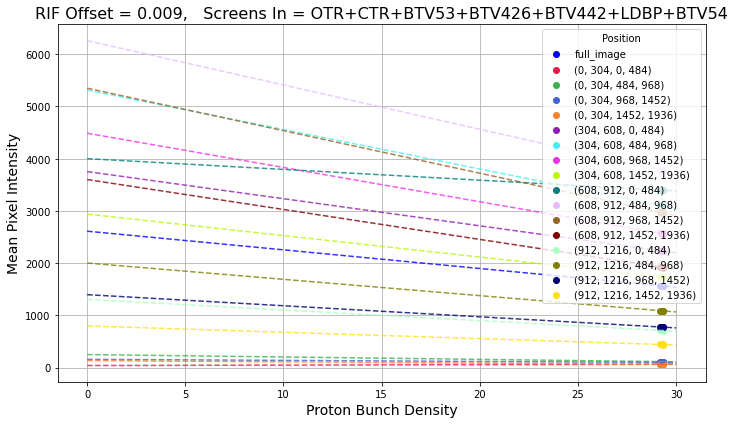

35.62154919985019 500.45330942754384
2.0982251390450832 0.05830857676805359
3.0208820972481916 23.33917776310896
3.198053386820277 2.9610337972085206
2.213299402248322 -1.6081205977293902
56.000387606349825 556.2351438790855
78.49213964440797 752.4500462644266
64.5896168109539 635.5293912378149
44.279345076285225 411.5773548930932
30.649673603940844 2483.4006802288627
84.91572000530638 1236.4770432294438
74.48031372227496 739.6448845706269
48.68488124758666 466.9176074449518
18.2207372259319 164.12727379833967
27.775833143627537 256.1023911383178
19.837078176555647 182.27821020815938
11.488712043454436 97.75927013104281


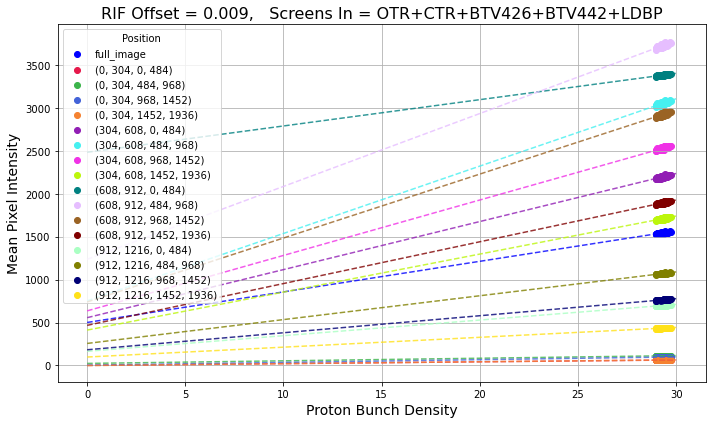

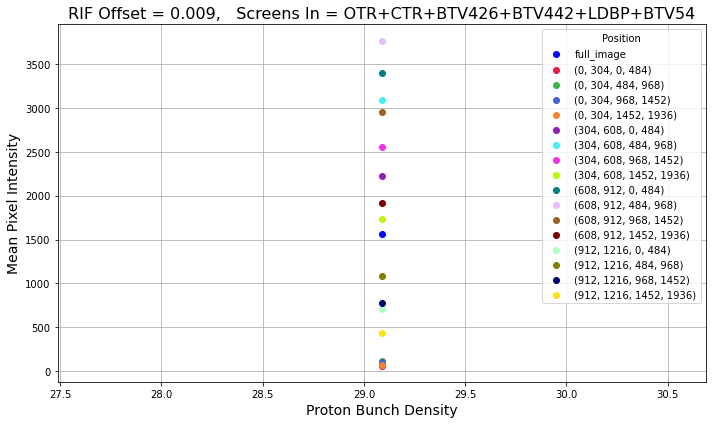

-18.742732899231715 2080.409594982259
-1.101064472627579 93.12545743849289
-1.2512611807285974 147.37923196039353
0.2660242300388548 87.73235862446022
-5.243087541219571 215.59085437312928
-30.1228424380488 3059.216068513628
-38.65422425175256 4157.247847006925
-30.482513495437193 3398.5458721590358
-19.146798244624186 2255.04663729013
-23.878066349570126 4068.615064741399
-40.21821615428334 4872.118385176139
-37.95458306854097 4007.0006211741133
-27.01178270300979 2667.1658025680667
-10.121221681574719 987.7109053726415
-15.885030784006737 1524.9219410197816
-12.786971808442061 1130.4558395986614
-6.293172761746961 614.7123715555996


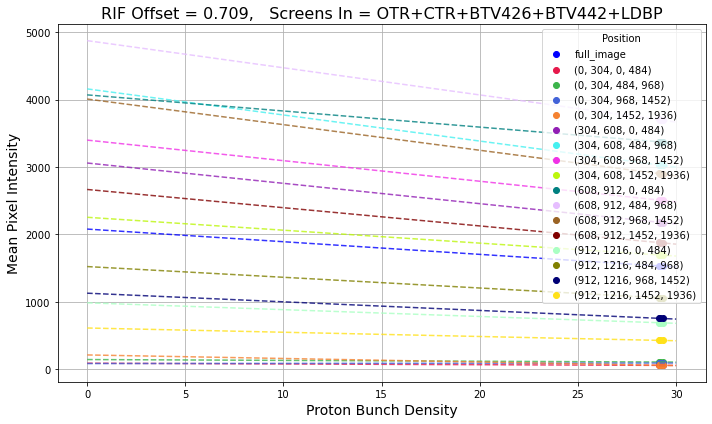

18.48664502864557 995.5549595491079
2.823706869548784 -21.442776119672725
0.4066857008560948 99.04365441290008
0.906656881309984 69.3457538052978
0.059398681468981085 60.892278260945545
27.650802411463264 1375.9887526752757
38.48033416132175 1909.8294685458025
31.45652036309976 1593.731491407507
22.637764526077454 1038.0812755930285
23.72124049701506 2680.6798733599894
45.97023915412975 2360.8926427216006
39.25421988313066 1757.0412526405346
24.286232293611302 1172.1411724087873
8.76771827018093 437.1396422223063
14.455815835401882 640.8467878165234
10.199911255945956 460.6566467827967
4.708247953905834 294.03550042954873


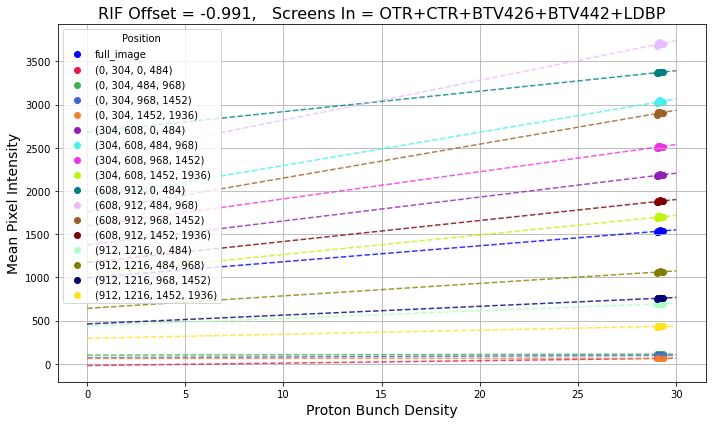

26.302055267683972 770.0723163918768
1.820446154184646 7.9135653573656395
2.78658968670798 29.84955305415496
2.5554217120250047 21.534892831982486
1.5728989931288457 16.89259920510665
41.080687866435895 987.8513270117968
59.05789557025389 1314.4556221674225
49.175450586749015 1081.625147063066
34.17317142679244 704.1010226500396
27.711754776592702 2564.677514778201
60.320474575239814 1948.496210807251
52.97301957788488 1363.0653770855936
35.303513552391784 854.6735875132375
12.033279211339867 343.60636420464294
18.259444460101243 532.2270880139647
13.637293791542492 362.0572975429949
8.371784835073697 188.12279862108068


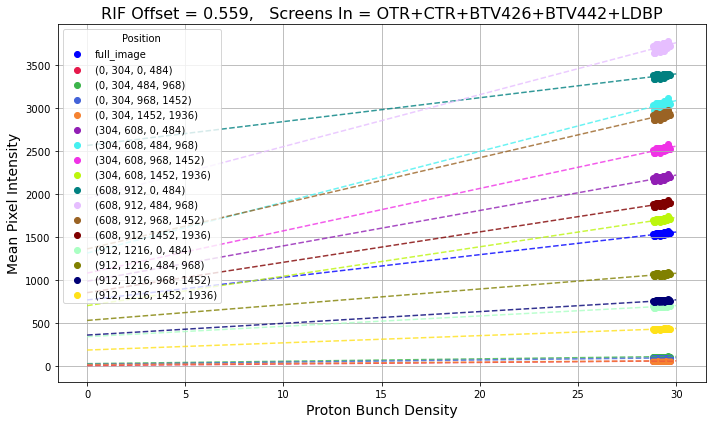

24.66465502317426 869.5390117257385
1.8640782777290985 11.459659973068547
1.7260365800952175 67.24843309402524
2.576620741615409 26.9684012459806
0.9397388700548487 40.02608739407501
34.77840444965105 1247.8101717182587
61.66106777967583 1353.049966363179
53.21260702890484 1058.6696280128008
36.81466591977496 692.0284513116376
8.432434554512872 3160.66388217886
49.39180933141461 2384.0003465385707
53.98770031576398 1442.9085919967072
36.91196988108907 879.7743009968772
10.661012549630927 411.8959748148084
17.91133770734818 584.3401828517019
13.151796335072666 406.6076073296775
7.7481296562103665 224.78924602742995


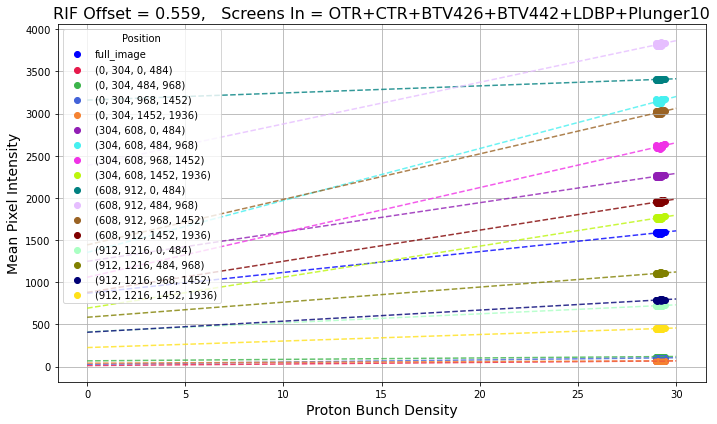

30.404271239828557 686.6357473135186
1.5919135724255773 17.98810004555045
3.4333676693728687 15.615257834255123
2.9618744535489268 14.030683559748905
1.5832445237374608 20.02901622452128
37.27065059794515 1152.4428239436438
61.319739630723234 1326.470001573436
51.410010634454636 1080.5354951601485
34.84177652893923 728.5465097097625
12.199870242094113 3044.9342477816836
68.33904743255744 1798.4209912269898
67.0568679884363 1028.1166904584115
44.204154524741206 644.7275582386012
16.704658143809606 227.75967739917394
24.955310548749694 367.0020284906806
17.754205289948548 263.7500714525762
10.5619613048025 137.4414175508357


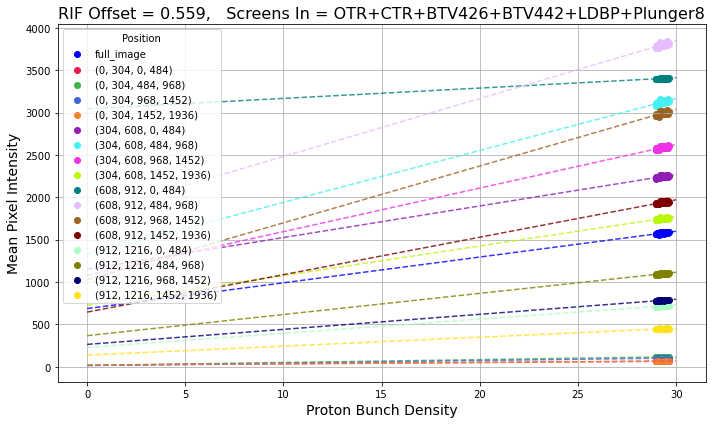

31.379337879715106 624.1297709567046
1.565705523940537 15.740670491495749
2.989590612390378 24.45988619991841
2.504999422286242 23.255962008432597
1.5925605885580274 16.736773382333226
49.89231321500727 733.0860898886517
68.75599101386453 1035.3901680211209
55.75802638124467 892.3713791744814
38.3793929922042 583.5258598203716
33.4691142994057 2400.107755737712
75.36773605428758 1514.2191440315423
64.11543435628745 1041.727250040046
41.87353661612968 665.7243878125873
15.036876305245611 257.8170376080867
23.544998366833788 380.7416046194636
16.698317981030243 274.61256531012344
10.524654643900739 126.56440898182834


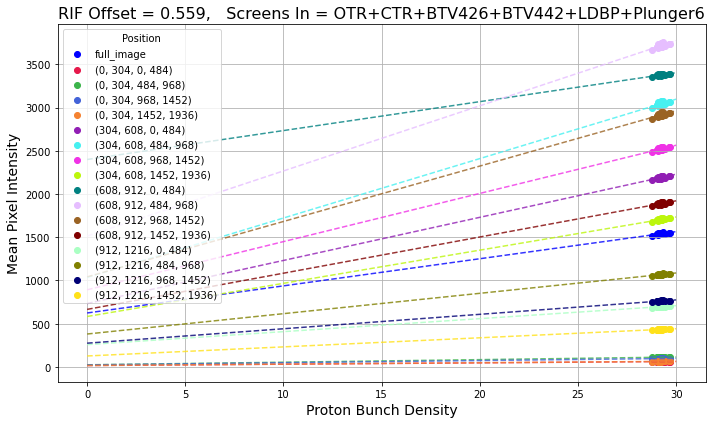

27.11710032747296 748.3942024385949
1.5256297905606329 16.95951175571386
2.5661523497232626 36.872916729809155
2.372832075401477 27.38145417465199
1.4072662403349745 22.29035495628866
42.37646817564802 952.5414950797892
59.28747589457253 1311.8039882506287
48.36325955098171 1108.3029760925717
34.07640627170544 709.2748359046197
22.348373576864688 2726.0655758846797
65.10819821368636 1813.334533237418
56.86016075405497 1252.6999489796897
36.976386075568456 808.3276819603424
13.909917176195204 290.12404471564236
20.565109574653697 466.7161712963241
15.136098709706182 319.7376688199846
8.894876088127358 173.89098522406087


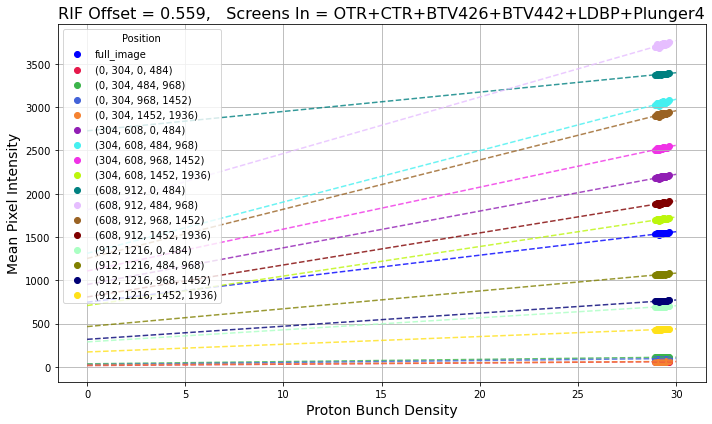

36.41917127264804 476.5200743964576
1.767022040031667 9.965255371990683
3.5490859434583166 8.215544440022342
2.8460793651370246 13.455934084754738
2.092467655017426 2.3710408754133363
57.77490497255515 502.9125320061948
79.1883056072896 730.5781651917288
65.46509180810713 608.6986300644085
45.23169545318296 383.52391008279966
34.11165940826976 2380.650203255078
86.92438706399504 1175.7705880896235
75.70250783164147 702.2421652875133
48.731820023460166 464.70567938106143
18.921665328687734 143.44789971098362
28.091832378979714 246.49205458505347
19.90683801809939 180.14430868028623
11.99610810353239 82.95971267953391


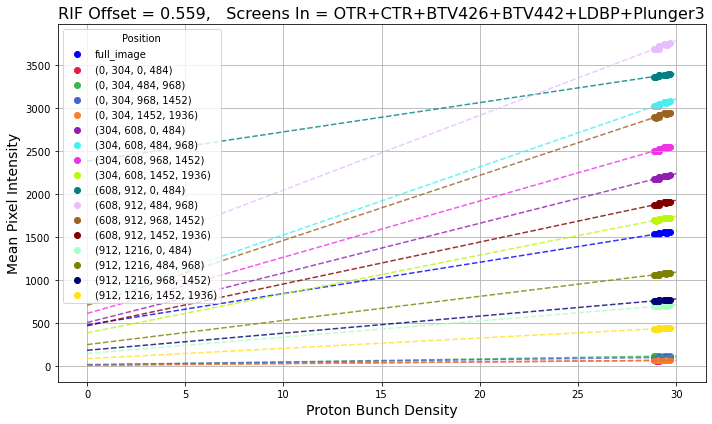

34.03332303545041 540.5548491361342
2.2722483843765673 -5.082544704053724
2.983666214560621 24.0886342056185
2.7863227012436242 14.769479890078125
1.5549556084140241 17.586655766979263
53.83464139696929 609.1717198867789
74.0987921125881 866.9813726923595
59.89462000678561 761.2567554240812
41.93785172320749 472.5666577009344
31.676993876243337 2447.031800582904
82.28385659919888 1297.9797907762759
71.12224064810697 824.3814489563342
45.89646882188659 539.798330312194
17.11619076572087 193.27754468245521
26.79391145540427 279.9539480424522
19.053937635240466 201.62379765544907
11.226935718579195 103.47853577385585


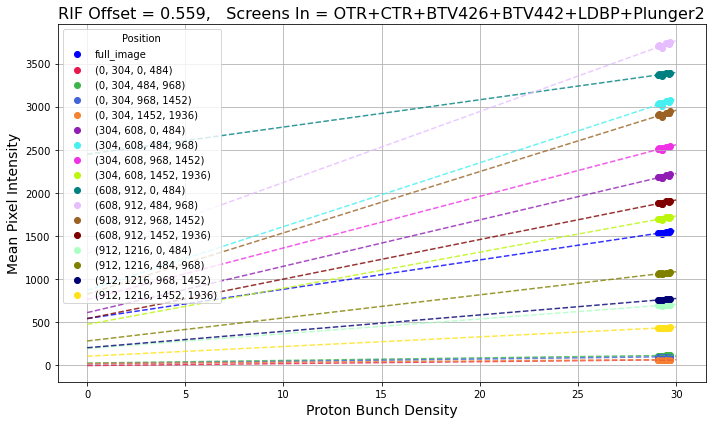

44.90431975880798 219.90073854036052
2.8589440372667427 -22.389921186799054
4.948104679704944 -33.58585291345569
3.6659966607709675 -11.145243889335942
2.7321843401851074 -17.032068927423587
68.87925012046843 165.5387826134692
95.37808802129496 239.3445770031645
77.24953111341081 249.2873097051357
53.2222717097046 139.5953431766996
55.59251472987724 1742.4376783240432
108.33701601549384 529.0407509469419
90.15442698523647 262.2167147649151
59.56794690428217 136.41534877280807
22.855948392323167 24.13144203967664
34.08031047085614 64.96831663943505
24.567596714529376 39.02764407984327
14.378820080105312 10.565826179726931


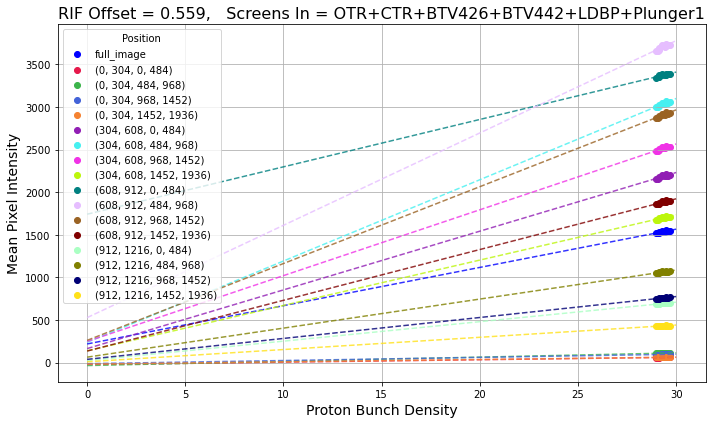

32.08526115659132 603.7720098966261
1.6076765006882532 14.637163486195542
3.102893131178756 21.115699242781496
2.925024278481118 11.103504002567595
1.7941855715730024 10.780370934548147
50.05674600555275 729.7044465475706
71.2745727208241 963.6091682082856
58.27709108209463 819.945835390414
39.824594583389434 542.3390663401158
26.421938366439953 2607.003282593833
75.90510770728572 1499.0885965610657
66.95330808021556 959.317188374618
43.88211974437691 607.31289598613
16.167524920416454 224.03398558332398
24.746972704016454 344.27087208959585
16.966618083908717 266.26086186948686
10.255188042149772 134.03041116568116


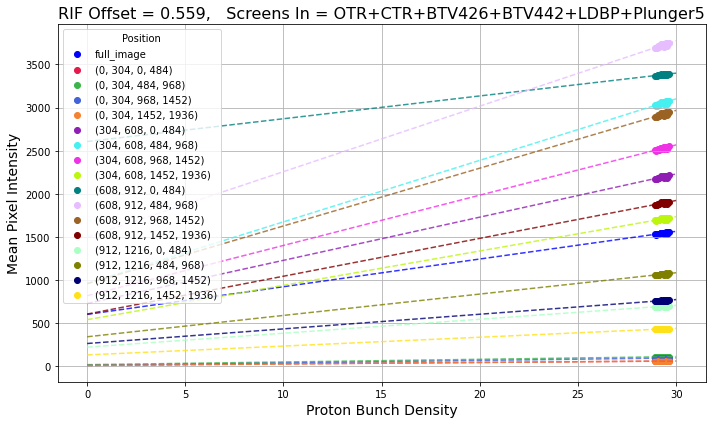

26.94287789380368 776.85964804428
2.0389635868777556 4.22421167751448
3.145950830280415 22.755189118070348
2.928747011926067 13.674913383489844
1.947706189148709 8.464568640354962
41.131552970444474 1025.0512975883064
60.01706741337402 1342.6017658351552
50.33802765565351 1093.3032749279027
35.19237625627468 705.7256272447825
15.756995318157939 2934.315918740628
62.2193106285091 1951.7400815369458
59.04286290413877 1237.9834865847731
38.22199566975475 803.9522837239982
14.12753710456141 296.33345409290627
21.212111249611446 466.53819390274543
15.06044908014034 335.41701878954075
8.704278771923537 187.67640939544827


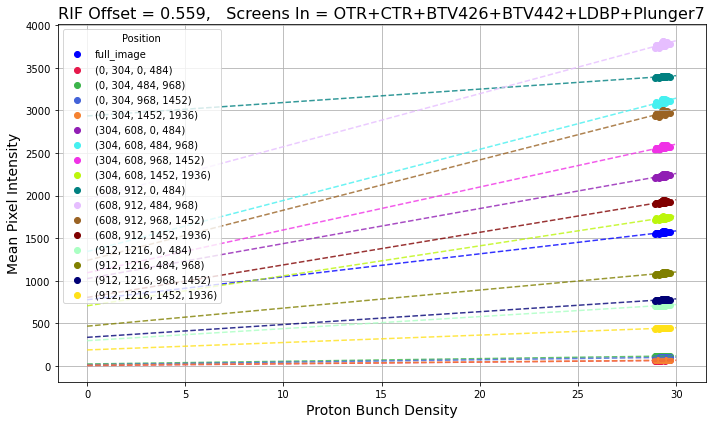

27.039312156047856 789.6873272801422
1.7554556479834065 13.841847132620718
2.5506874241780286 42.19722529057041
2.6595702013988793 23.360030148372367
1.8264255484404792 13.41645236208718
37.35951480019768 1157.5289643816943
64.82586606393895 1237.6218526995854
52.896116616828316 1049.07201580556
36.6587513338365 683.5313798368456
11.122034271642178 3077.2972623578785
58.91475150085189 2082.575920353974
60.224008496904425 1237.642022073998
39.96234494806083 775.5896270896084
14.41973747637217 296.34854739710045
21.940407787966187 458.0638650253907
16.003184051506356 317.2043949155919
9.510571655109896 169.6931344820175


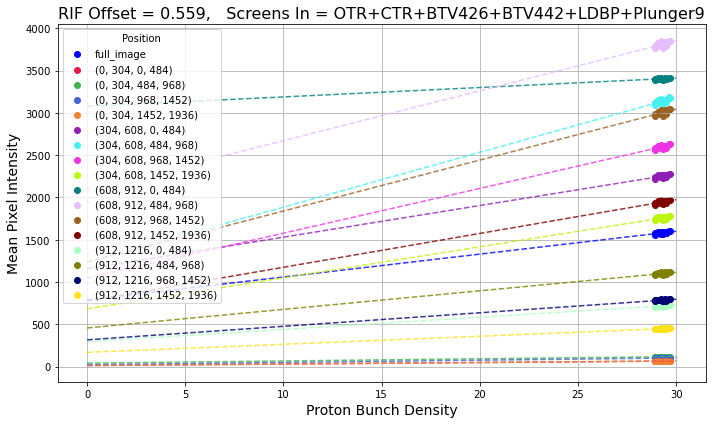

52.688037021306805 -3.707493201104812
2.2196422316399276 -3.779765425107655
3.9290248842878723 -3.776700407515141
3.4118018967200943 -3.778639184525065
2.275056812092431 -3.779953566659524
74.8254785102663 -3.6972273161260922
103.9177727692432 -3.6584326154637936
86.11216884001166 -3.6837636373377003
58.25371926034729 -3.714516444862337
115.61135464182281 -3.4560746622090943
126.92268881110746 -3.605634155139666
99.55249075578938 -3.669295351657164
64.55003116038253 -3.708844497817821
23.87664539675132 -3.7528754620747122
36.535744763347985 -3.7397221131744414
26.10810736768184 -3.7533567558881478
14.90686423420977 -3.7650893684948707


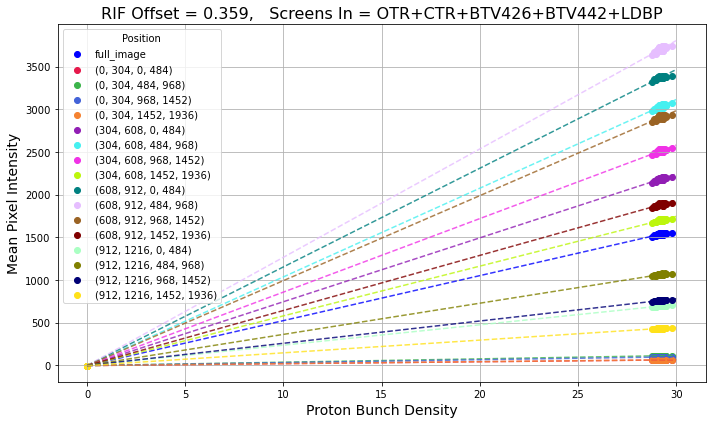

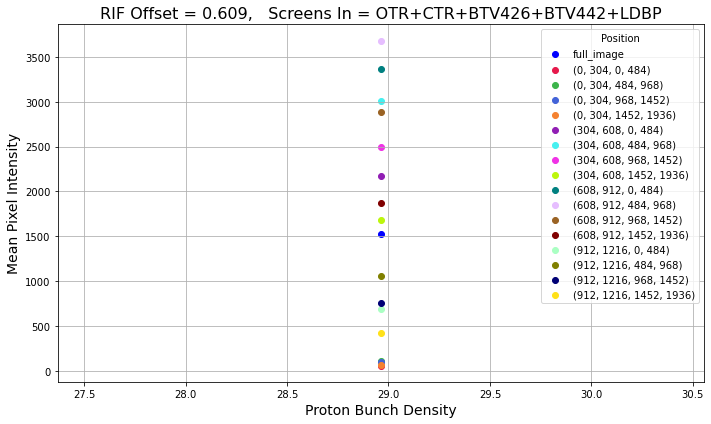

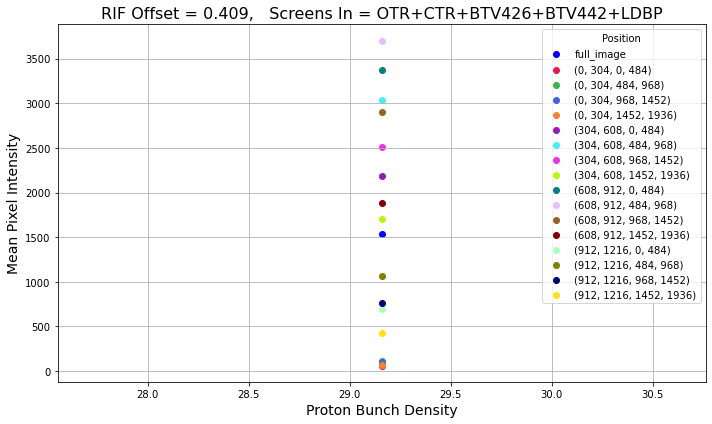

In [48]:
plot_spatially_sliced(events_full)

[{'slope': 1.7179378246693537, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.9012587039606746, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 1.0681612150392374, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 1.6912834272398252, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.04220241902664712, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.030403672853450133, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.037544403240829305, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.05595925650550282, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.027044269214634823, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.024825247807681, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.03228602189408836, 'camera section': (608, 912, 968, 1452), 'colour'

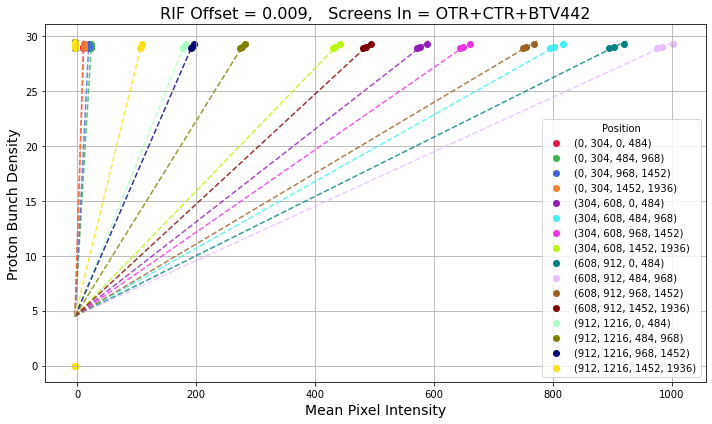

[{'slope': 1.614932456562317, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 1.0119992329031282, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 1.2882558593659794, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 1.379471530745143, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.04457091352075374, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.032482958466227244, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.039256437964844425, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.05841418357934538, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.028813136770030574, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.02630932750116932, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.03444973016541483, 'camera section': (608, 912, 968, 1452), 'colour'

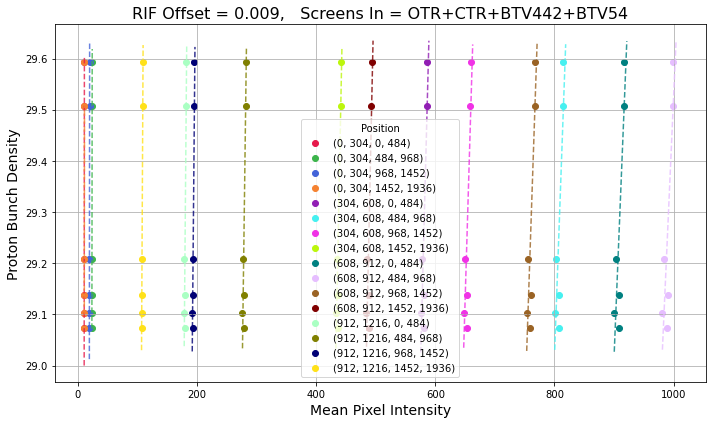

[{'slope': 0.4237034626051699, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.24451416913088125, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.2806108621422214, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.41539199363099455, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.013130197196209671, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.009453115439996338, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.011415197730567291, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.016869905287800947, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.00865131696949629, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.007770218788605524, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.009879092439174201, 'camera section': (608, 912, 968, 1452), '

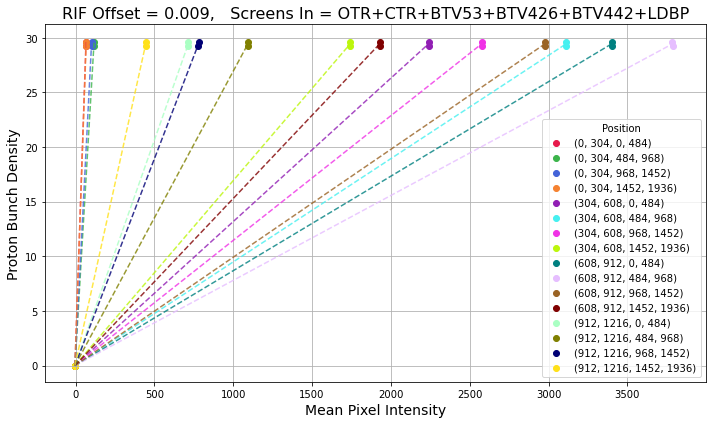

[{'slope': 0.12629048839584608, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': -0.10399745641559152, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': -0.08101652657498012, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': -0.11810654047450388, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': -0.007736141846062818, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': -0.004837795193499915, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': -0.005378845088675603, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': -0.007368290439641419, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': -0.02089646547596171, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': -0.004971201819034325, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': -0.0048342538774788875, 'camera section': (608, 912, 

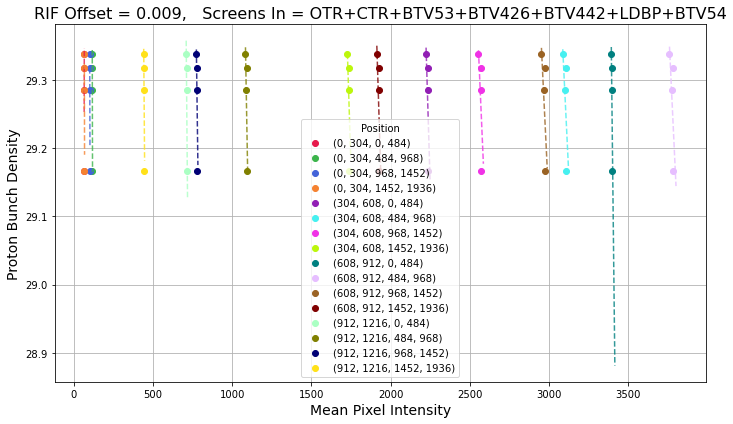

[{'slope': 0.4483489086884842, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.25329347641066347, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.2916055958158874, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.4369606410501725, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.013310399359915714, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.009585585599103687, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.011570486605820435, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.017103623625497354, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.00865164039497117, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.007857034391159114, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.010012630420567303, 'camera section': (608, 912, 968, 1452), 'c

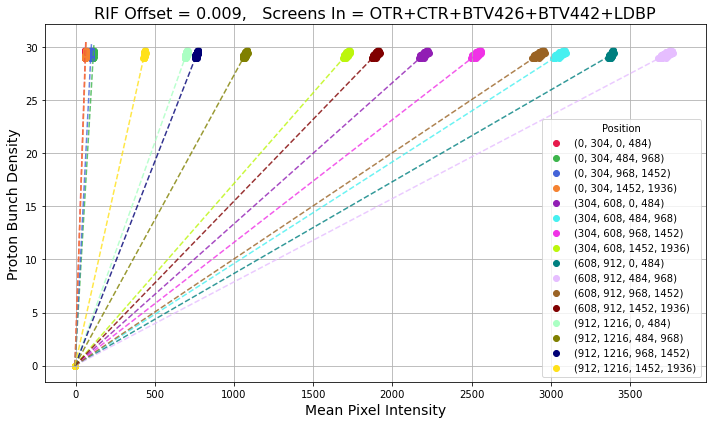

[]


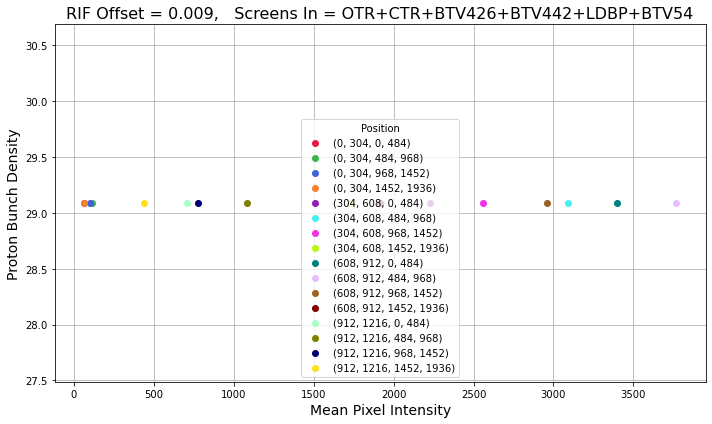

/tmp/ipykernel_454/2548346176.py:31: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


[{'slope': -0.6131918114920318, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': -0.08992178412817281, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': -0.09922279780101212, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': -0.052453355800272355, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': -0.0075397426402212305, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': -0.004965089272020674, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': -0.005762537957038148, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': -0.009880682846105037, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': -0.00881412326699407, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': -0.004895069558127876, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': -0.005465370568985221, 'camera section': (608, 912,

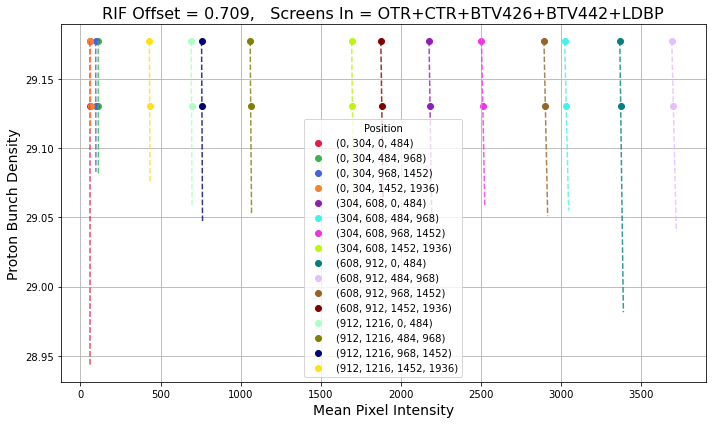

[{'slope': 0.2481984798193711, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.030108214977174863, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.04576410938569312, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.005688228383818661, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.005070106606228485, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.0037121430104291074, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.004677375697029665, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.006905459583368545, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.007220946688295109, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.0033814611649780934, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.003945521743320829, 'camera section': (608, 912, 968, 14

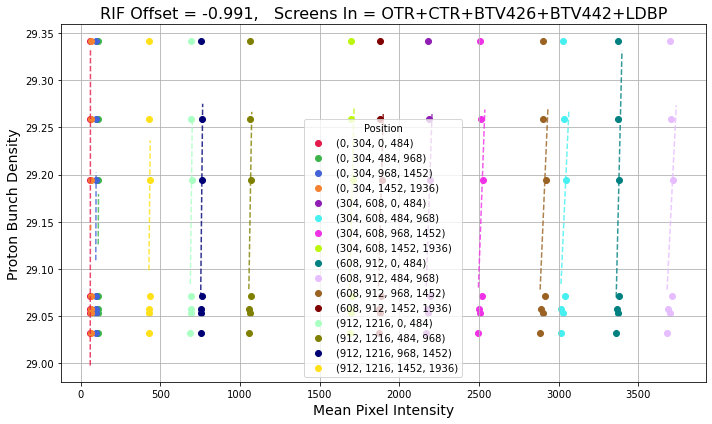

[{'slope': 0.4485730754476626, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.25331473274602406, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.2914225233432185, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.43703024620420206, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.013307388708059573, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.009583062850164588, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.011566333073953584, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.017097276366876305, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.008648524788658006, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.007850891374376466, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.010004721475275714, 'camera section': (608, 912, 968, 1452), 

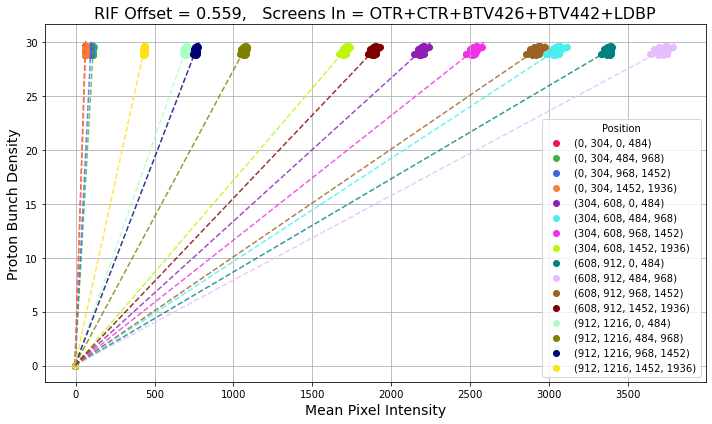

[{'slope': 0.21495831492414189, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.08708753387394227, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.12181214582620158, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.1771251024932362, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.008828290455611341, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.004840185045746856, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.00618888541984204, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.00941587408655203, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.02182142739747525, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.004408586980264954, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.004833949696375926, 'camera section': (608, 912, 968, 1452), 'c

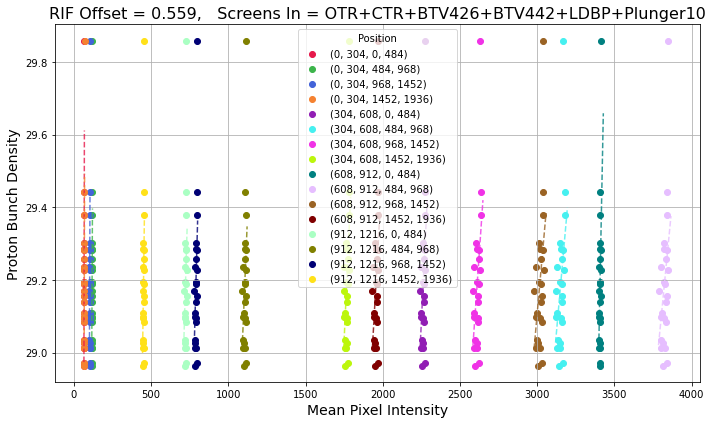

[{'slope': 0.18948468105199315, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.15989664764136532, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.18407345358078095, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.22552643453840898, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.010282134655292255, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.005931945270956982, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.007659625144518075, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.011369579488281724, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.029150010160446004, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.005900839744860813, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.0063192997681836855, 'camera section': (608, 912, 968, 1452

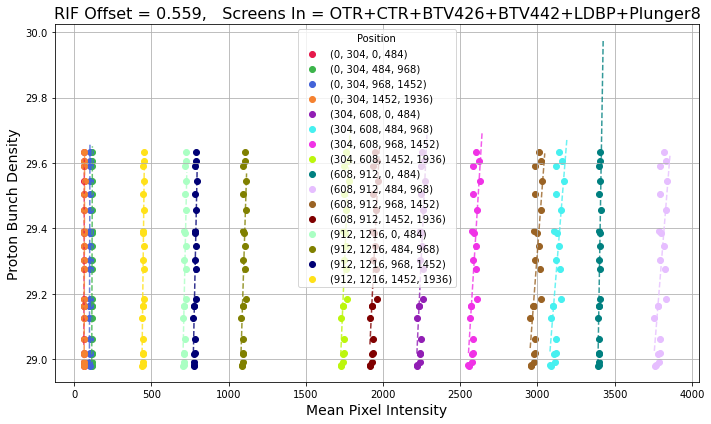

[{'slope': -0.0009682482577197948, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': -0.0005465726351637422, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': -0.0006309863808848693, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': -0.0009367580982810875, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': -2.977514820456939e-05, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': -2.1514178308480344e-05, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': -2.5980033875013267e-05, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': -3.832234990916795e-05, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': -2.1088172719081925e-05, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': -1.7866136961197654e-05, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': -2.2503854885109935e-05, 'camera 

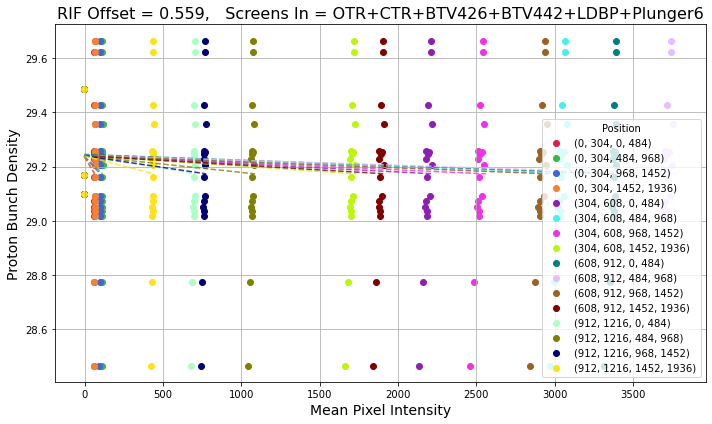

[{'slope': 0.0924913422247734, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.08651556405823835, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.08989906515926761, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.10777082283110812, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.007827150179429174, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.005363465529348401, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.006465757396497763, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.009497446640764233, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.015498464871850035, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.005037233072229962, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.0055772692736888105, 'camera section': (608, 912, 968, 1452)

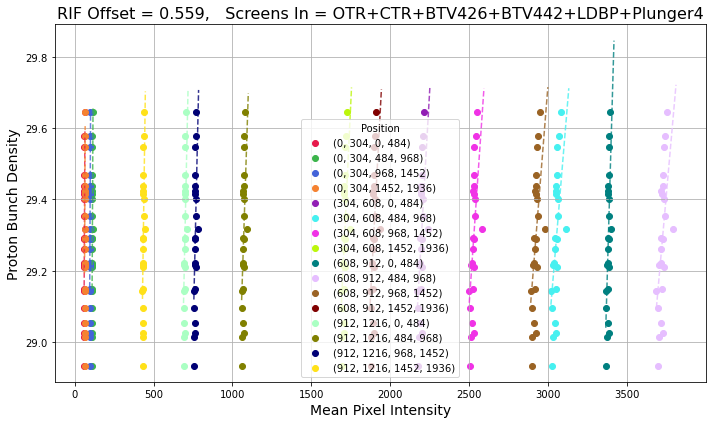

[{'slope': 0.3060536470933405, 'camera section': (0, 304, 0, 484), 'colour': '#e6194b'}, {'slope': 0.26082358090257174, 'camera section': (0, 304, 484, 968), 'colour': '#3cb44b'}, {'slope': 0.45086238033351145, 'camera section': (0, 304, 968, 1452), 'colour': '#4363d8'}, {'slope': 0.6809663057402472, 'camera section': (0, 304, 1452, 1936), 'colour': '#f58231'}, {'slope': 0.02388653550565112, 'camera section': (304, 608, 0, 484), 'colour': '#911eb4'}, {'slope': 0.018055060749975555, 'camera section': (304, 608, 484, 968), 'colour': '#46f0f0'}, {'slope': 0.021387828589148367, 'camera section': (304, 608, 968, 1452), 'colour': '#f032e6'}, {'slope': 0.03041790953925772, 'camera section': (304, 608, 1452, 1936), 'colour': '#bcf60c'}, {'slope': 0.05182422239572028, 'camera section': (608, 912, 0, 484), 'colour': '#008080'}, {'slope': 0.016843272014624027, 'camera section': (608, 912, 484, 968), 'colour': '#e6beff'}, {'slope': 0.01901622558371195, 'camera section': (608, 912, 968, 1452), 'col

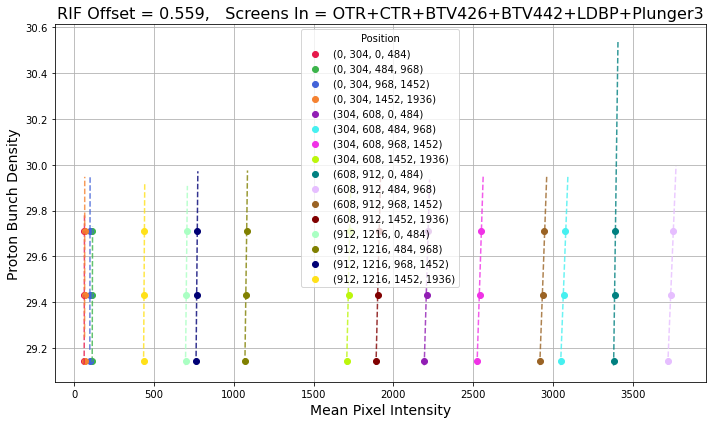

In [263]:
plot_spatially_sliced()

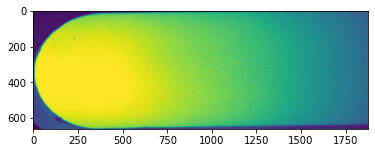

In [66]:
plt.imshow(ex_data[330:990,60:],vmax=4095)

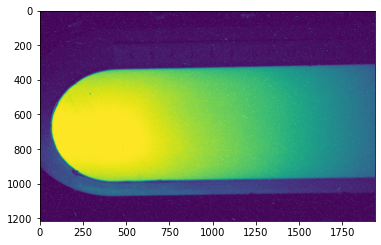

In [67]:
plt.imshow(ex_data,vmax=4095)

In [14]:
def sort_by_space_scin_screen(space_x,space_y,no_events,Date):
    
    y_step = int(660/space_x)
    x_step = int(1876/space_y)    
    
    list_indices_y = list(range(330, 990, y_step))
    list_indices_x = list(range(60, 1936, x_step))
    
    rif_data = {}
    
    DATA_PATH = f'/eos/experiment/awake/event_data/{Date}'
    event_files = os.listdir(DATA_PATH)

    for i in np.arange(0,no_events,1):
        filename = event_files[i]
        
        data, protons, rif, screens = load_all_event_data(Date,filename,spectro_no=1,threshold=1750000)
        bg_sensor = np.array(data) - 3.78126279
        w_median_filter = ski.filters.median(bg_sensor, footprint=disk(4)) 
        
        if rif not in rif_data:
            rif_data[rif] = {}
            
            
        ## check what screens are in
        active_screens = []
        list_screens = ['OTR','CTR','BTV50','BTV53', 'BTV426', 'BTV442', 'LDBP','Plunger', 'BTV54']

        # Determine which screen is active
        screen_used = None
        for screen in list_screens: 

            if screen =='LDBP':
                val = screens['LDBP']
                if val == 0:
                    active_screens.append('LDBP')

            if screen == 'Plunger':
                val = screens['Plunger']

                for j in np.arange(1,11,1):
                    if val == j:
                        active_screens.append(f'Plunger{j}')                

            else:
                val = screens[screen]

                if isinstance(val, (bool, np.bool_)):
                    if val == False:
                        active_screens.append(screen)

                elif isinstance(val, numbers.Number):
                    if float(val) == 1:
                        active_screens.append(screen)

        if not active_screens:
            active_screens = ['None']

        # Create a combined label
        screen_label = '+'.join(active_screens)
        #colour = get_colour_for_combination(screen_label)

        if screen_label not in rif_data[rif]:
            rif_data[rif][screen_label] = {'full_image': {'fit_parameters': [], 'proton_count': [] }}
            
        ## Add full camera image
        rif_data[rif][screen_label]['full_image']['fit_parameters'].append(np.mean(w_median_filter[330:990,60:]))
        rif_data[rif][screen_label]['full_image']['proton_count'].append(protons)

        for i in list_indices_y:
            for j in list_indices_x:        
                sliced_data = w_median_filter[i:i+y_step,j:j+x_step]
                #print(np.mean(sliced_data))

                index_cut = (i, i+y_step , j, j+x_step)

                if index_cut not in rif_data[rif][screen_label]:
                    rif_data[rif][screen_label][index_cut] = {
                        'fit_parameters': [], 'proton_count': []}

                rif_data[rif][screen_label][index_cut]['fit_parameters'].append(np.mean(sliced_data))
                rif_data[rif][screen_label][index_cut]['proton_count'].append(protons)


    return rif_data

In [102]:
scin_screen_events100 = sort_by_space_scin_screen('2025/05/17')#
#print(scin_screen_events100)

[{'slope': 0.03354106819009273, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.04236301472932058, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.029921689033790118, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.03644665688275976, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.05529706236389571, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.02448347444038157, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.026066721178838577, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.0333596831626452, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.0509134149404236, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.023021702993189164, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.02499679467106844, 'camera section': (660, 825, 529, 998), 'c

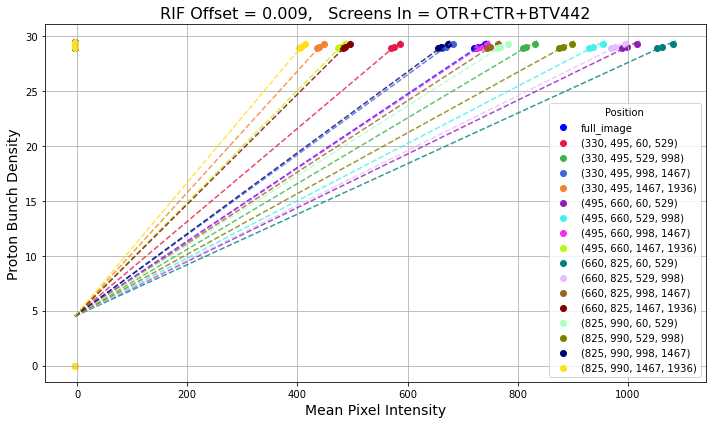

[{'slope': 0.03564321397039205, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.045181087075208966, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.031834206336246194, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.03870684847741285, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.05823291621119945, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.026089565615389016, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.028304646579805394, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.0347653147372238, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.054001316449816955, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.024635803141790695, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.026261507988239275, 'camera section': (660, 825, 529, 998

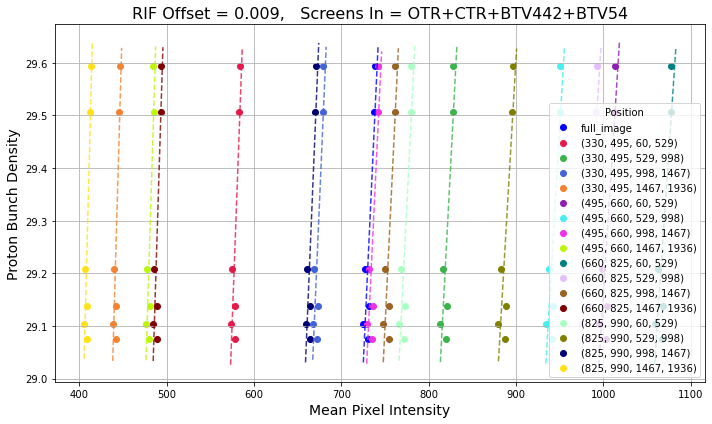

[{'slope': 0.010392491459667313, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.013135633747624983, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.009295456502144684, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.011048583006701425, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.016656787680034566, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.007719124098063323, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.008117588584857, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.010183696364403834, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.015408327947327514, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.007445647336643961, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.007814629527839479, 'camera section': (660, 825, 529, 9

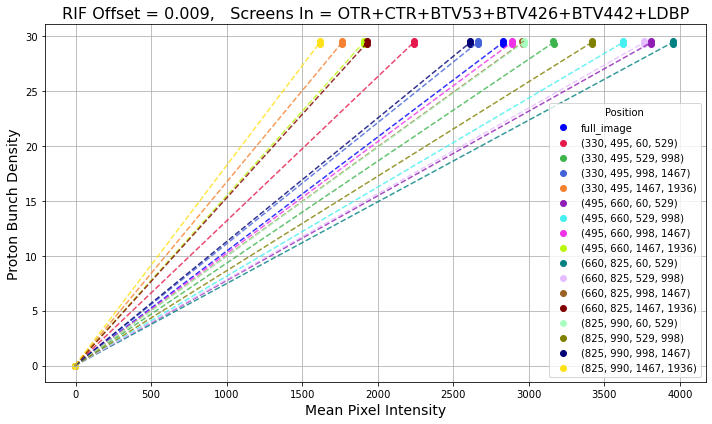

[{'slope': -0.006115319961023992, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -0.006435257391649997, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': -0.005084120529587826, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': -0.005420149454683868, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': -0.006564007944995881, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': -0.007796797567410484, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': -0.0039514025776257395, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': -0.004695691871966179, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': -0.007560960606946797, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': -0.11374379365126892, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': -0.00485864670916668, 'camera section': (660

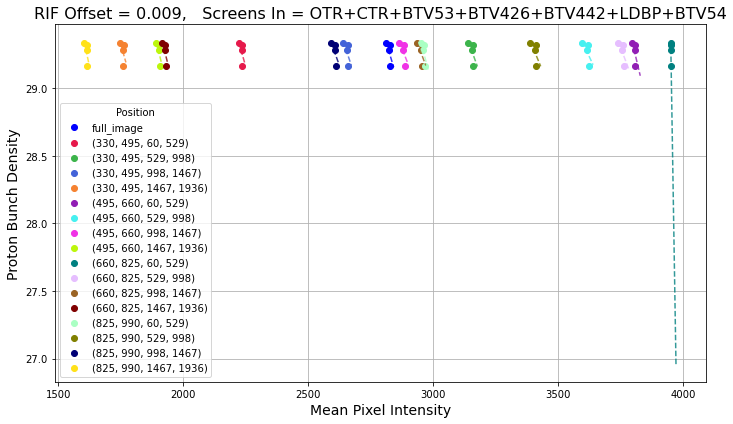

[{'slope': 0.010510441244324773, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.013329662978076803, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.009424742312592644, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.01119785918306504, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.016888222057759868, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.007776582023182079, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.008228478513903096, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.010321313575432959, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.015618898127384583, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.007411667254555455, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.007905378594628087, 'camera section': (660, 825, 529,

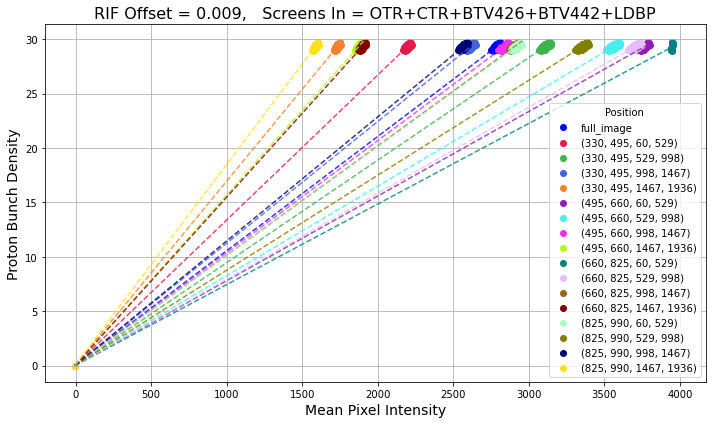

[]
nan


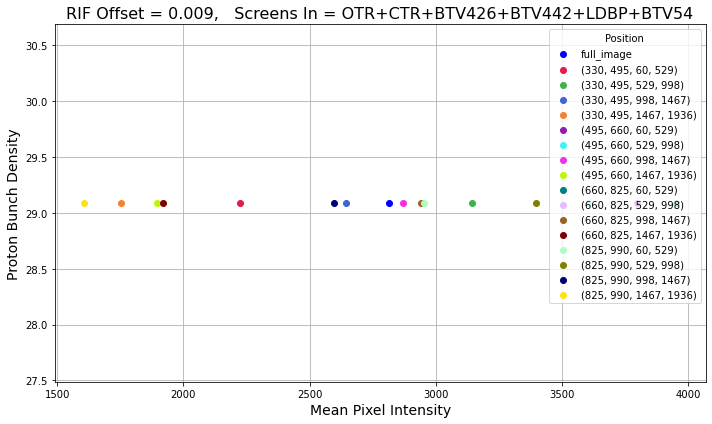

/tmp/ipykernel_470/2602836981.py:33: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


[{'slope': -0.006149413462418645, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -0.008399979557182047, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': -0.004520520879069078, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': -0.0057393512348050246, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': -0.009483102519700269, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': -0.0047593177888206805, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': -0.004359868840297214, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': -0.00523409070378122, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': -0.009834053490113844, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': -0.016641551936622458, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': -0.004405274231227317, 'camera section': (6

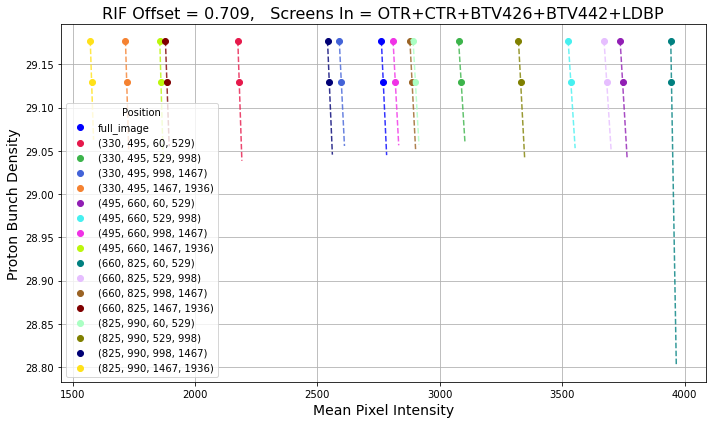

[{'slope': 0.0045253381029687545, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.005113072021227555, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.0034458408295380684, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.004736650462405513, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.0066197210912512855, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.0033980605988969963, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.003141340089876089, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.003923612292462025, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.006063062095499416, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.015985764838101255, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.0033941121739203273, 'camera section': (660, 825

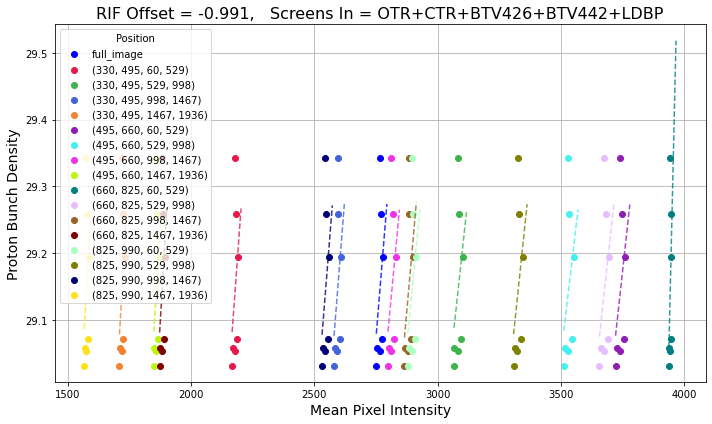

[{'slope': 0.010505583083537088, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.01332905125329753, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.009423050778795863, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.011194322198937335, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.01688377512472455, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.007774806170575663, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.008224454303239813, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.01031628508739711, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.015611618187393875, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.0074065993628187774, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.007899300246836632, 'camera section': (660, 825, 529, 

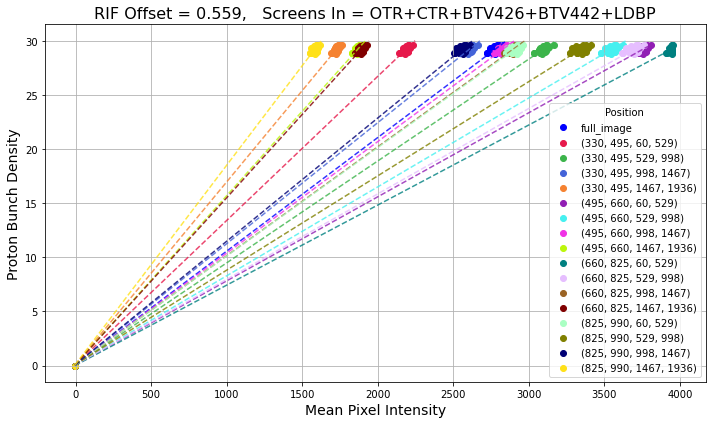

[{'slope': 0.0062876155283567116, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.006871658839143744, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.004657773598933022, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.006035233011020514, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.009273245752499475, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.009789830444724472, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.004198443266983862, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.005480720285624484, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.008321132073019679, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.08116796337944968, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.004446210085925514, 'camera section': (660, 825, 529

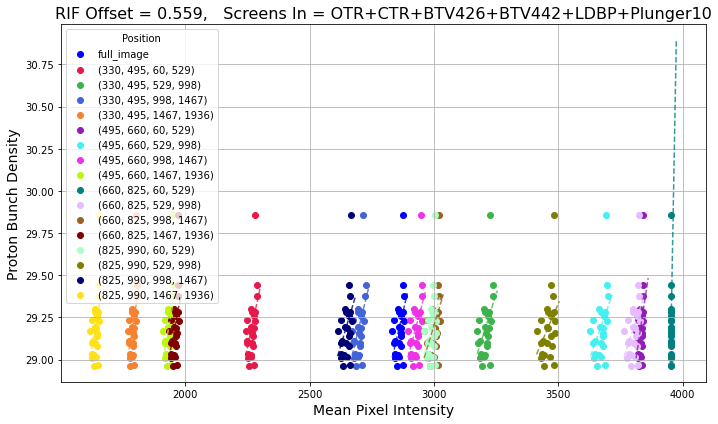

[{'slope': 0.007958083755964613, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.00814392088239002, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.005704550438539532, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.007471555582659073, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.01120787016951748, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.011011857245854413, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.005243793097338418, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.0067507074464736175, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.010176673320494335, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.13905965959210506, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.005897259783880615, 'camera section': (660, 825, 529, 

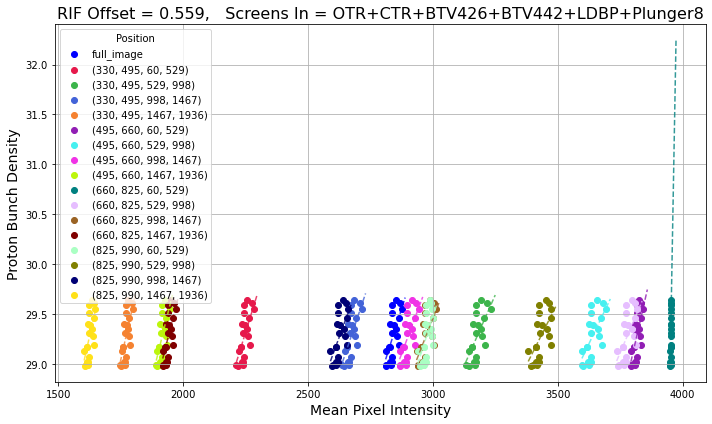

[{'slope': -2.3934292201581048e-05, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -2.9789062801200745e-05, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': -2.116506519121339e-05, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': -2.5118105375075716e-05, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': -3.7815362258832804e-05, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': -1.781864798023256e-05, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': -1.8464039667034998e-05, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': -2.3212379941998125e-05, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': -3.5037748923335664e-05, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': -1.882628690863622e-05, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': -1.7888912179369574e-05, 'c

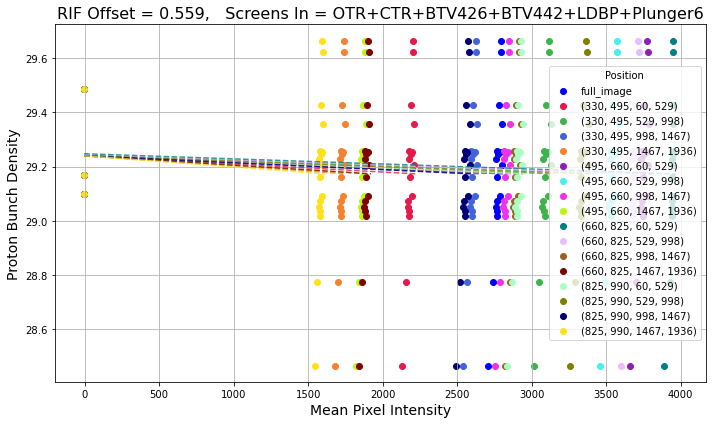

[{'slope': 0.006674998911466115, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.0074171191104554154, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.005283774862946359, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.00626701810817281, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.00926761803849939, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.006399917868545635, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.004586642832138957, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.0057666586985427835, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.008616882073820524, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.048856161807040464, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.004943009805211429, 'camera section': (660, 825, 529

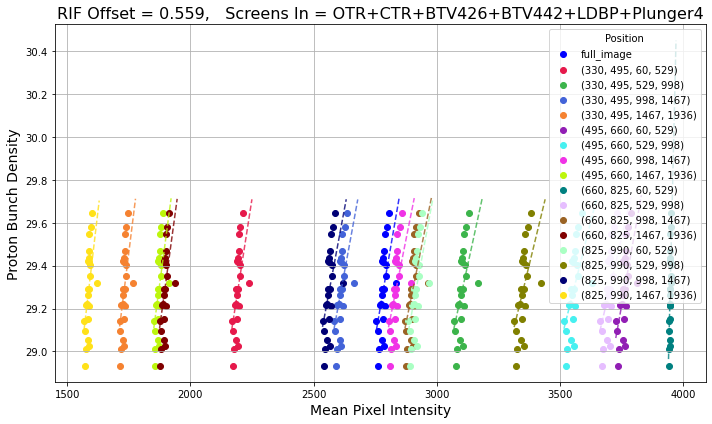

[{'slope': 0.0221692289568501, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.022589435291969395, 'camera section': (330, 495, 60, 529), 'colour': '#e6194b'}, {'slope': 0.017621415091523675, 'camera section': (330, 495, 529, 998), 'colour': '#3cb44b'}, {'slope': 0.021012651945591584, 'camera section': (330, 495, 998, 1467), 'colour': '#4363d8'}, {'slope': 0.02987969358099646, 'camera section': (330, 495, 1467, 1936), 'colour': '#f58231'}, {'slope': 0.01962040392554577, 'camera section': (495, 660, 60, 529), 'colour': '#911eb4'}, {'slope': 0.016169128906980933, 'camera section': (495, 660, 529, 998), 'colour': '#46f0f0'}, {'slope': 0.019024238166416928, 'camera section': (495, 660, 998, 1467), 'colour': '#f032e6'}, {'slope': 0.02859544016428939, 'camera section': (495, 660, 1467, 1936), 'colour': '#bcf60c'}, {'slope': 0.2320950887119255, 'camera section': (660, 825, 60, 529), 'colour': '#008080'}, {'slope': 0.01631961935289758, 'camera section': (660, 825, 529, 998), 

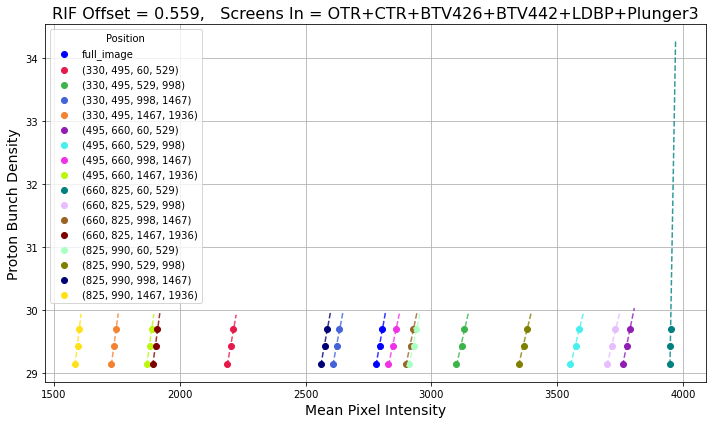

In [110]:
plot_spatially_sliced(scin_screen_events100)

## Smaller spatial breakdown

In [111]:
## modify plotting function to use colormap

In [17]:
def get_no_colours(n,cmap_name='viridis'):
   
    cmap = cm.get_cmap(cmap_name,n)
    return [mcolors.to_hex(cmap(i/max(n-1,1))) for i in range(n)]

In [53]:
get_no_colours(42,cmap_name='viridis')

/tmp/ipykernel_458/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


['#440154',
 '#460a5d',
 '#471365',
 '#481b6d',
 '#482374',
 '#472c7a',
 '#46337f',
 '#443a83',
 '#424186',
 '#3e4989',
 '#3c508b',
 '#39568c',
 '#365d8d',
 '#32648e',
 '#306a8e',
 '#2d708e',
 '#2b758e',
 '#287c8e',
 '#26828e',
 '#24878e',
 '#228d8d',
 '#20938c',
 '#1f998a',
 '#1f9f88',
 '#20a486',
 '#25ab82',
 '#2ab07f',
 '#32b67a',
 '#3bbb75',
 '#48c16e',
 '#54c568',
 '#60ca60',
 '#6ece58',
 '#7fd34e',
 '#8ed645',
 '#9dd93b',
 '#addc30',
 '#c0df25',
 '#d0e11c',
 '#dfe318',
 '#efe51c',
 '#fde725']

In [18]:
def plot_spatially_sliced2(n,rif_data):
    list_rifs = list(rif_data)
    #colour_list = ["#FFD700", "#3D3D3D", "#7FFFD4","#12436D", "#FF0000" , "#28A197", "#00FFFF", "#F46A25" , "#801650",
     #   "#A285D1","#6BACE6",   "#8B0000", "#FF00FF", "#008000" , "#3776ab" ,"#4f3222" ]
    
    colour_distinct_list = get_no_colours(n ,cmap_name='viridis')
    #print(len(colour_distinct_list))
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            fig2, ax2 = plt.subplots(figsize=(10, 6))
            fig3, ax3 = plt.subplots(figsize=(10, 6))
            plotted_labels = set()

            data = rif_data[rif][screen_label]
            index_count = list(data)
            #print(len(index_count))
    
            list_slopes = []
            slopes_mean = []
            slope_heat_map = np.zeros((1216, 1936))
            intercept_heat_map = np.zeros((1216, 1936))

            for i,n in zip(index_count, np.arange(0,len(colour_distinct_list),1)):
                colour = colour_distinct_list[n]
                show_label = i not in plotted_labels
                
                x = np.array(data[i]['fit_parameters'])
                y = np.array(data[i]['proton_count'])
                ax.scatter(x, y,color=colour, label=i if show_label else None)
                plotted_labels.add(i)
                

                if len(x) >= 4 and i != 'full_image':  # Curve fitting requires at least two data points
                    a_guess,b_guess = np.polyfit(x,y,1)
                    params = curve_fit(fit_line, np.sort(x), np.sort(y),p0=[a_guess,b_guess])[0]
                    a, b = params
                    list_slopes.append({"slope": a,"camera section": i})#, "colour": colour})
                    slopes_mean.append(a)
                    
                    x_fitted = np.linspace(0,np.max(x)+.005*np.max(x),1000)
                    y_fitted = fit_line(x_fitted,a,b)
                    ax.plot(x_fitted, y_fitted, '--', color=colour, alpha=0.8)
                    
                    slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                    intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b

                
            #print(list_slopes)
            #print(np.mean(slopes_mean[1:]))


            ax.set_title(f'RIF Offset = {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
            ax.set_xlabel('Mean Pixel Intensity', fontsize=14)
            ax.set_ylabel('Proton Bunch Density', fontsize=14)
            ax.grid()
            #ax.set_ylim(0,31)

            #ax.legend(title="Position", loc='best')
            
            im = ax2.imshow(slope_heat_map,cmap='viridis',origin='upper')
            ax2.imshow(slope_heat_map)
            fig2.colorbar(im, ax=ax2, label ='Slope')
            
            ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
            ax2.set_xlabel('X Pixels', fontsize=14)
            ax2.set_ylabel('Y Pixels', fontsize=14)
            
            im2 = ax3.imshow(intercept_heat_map,cmap='Blues',origin='upper')
            ax3.imshow(intercept_heat_map,cmap='Blues')
            fig3.colorbar(im2, ax=ax3, label ='Y int')

            plt.tight_layout()
            plt.show()

/tmp/ipykernel_470/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


[{'slope': 0.04236301472932058, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.029921689033790118, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.03644665688275976, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.05529706236389571, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.02448347444038157, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.026066721178838577, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.0333596831626452, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.0509134149404236, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.023021702993189164, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.02499679467106844, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.032517490846562636, 'camera section': (660, 825, 998,

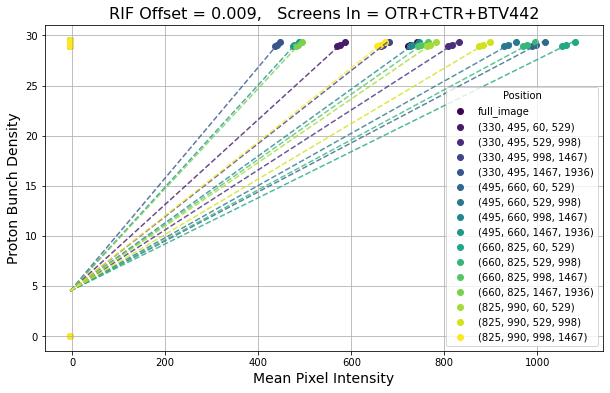

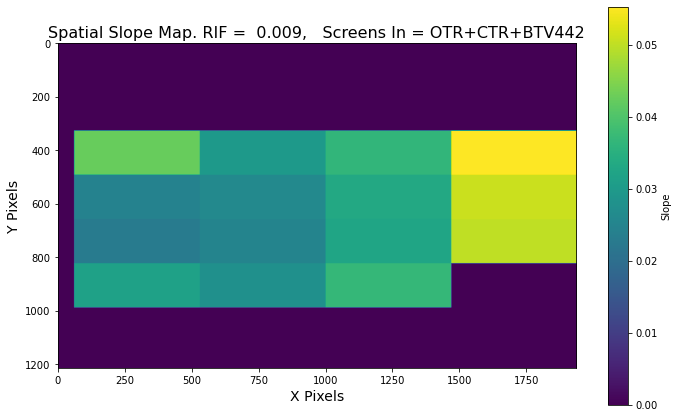

[{'slope': 0.045181087075208966, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.031834206336246194, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.03870684847741285, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.05823291621119945, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.026089565615389016, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.028304646579805394, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.0347653147372238, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.054001316449816955, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.024635803141790695, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.026261507988239275, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.03452635656246086, 'camera section': (660, 825, 

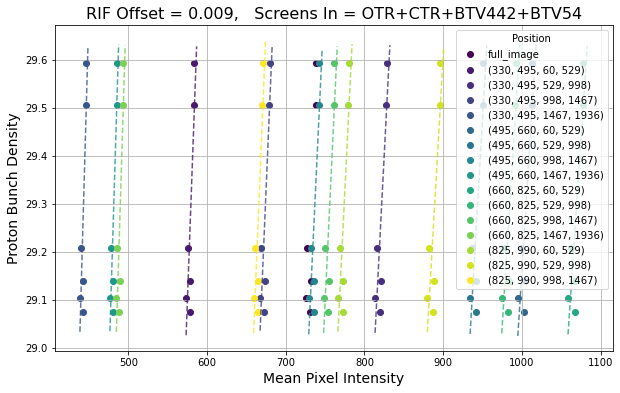

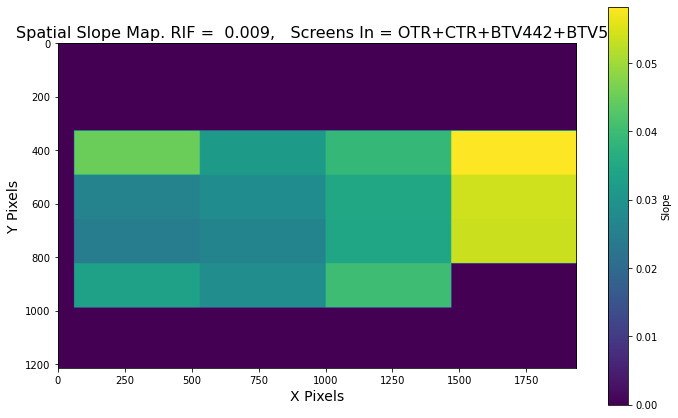

[{'slope': 0.013135633747624983, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.009295456502144684, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.011048583006701425, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.016656787680034566, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.007719124098063323, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.008117588584857, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.010183696364403834, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.015408327947327514, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.007445647336643961, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.007814629527839479, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.009942117724984509, 'camera section': (660, 825

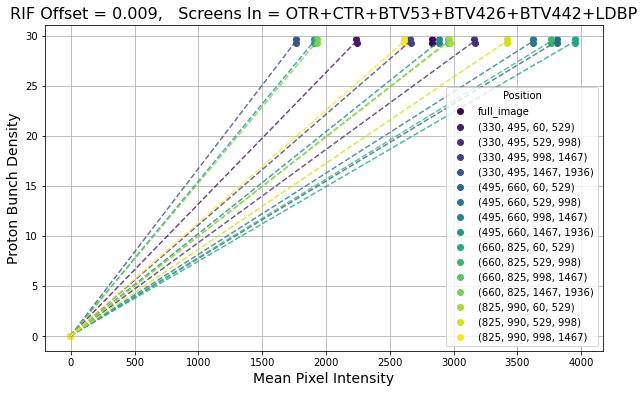

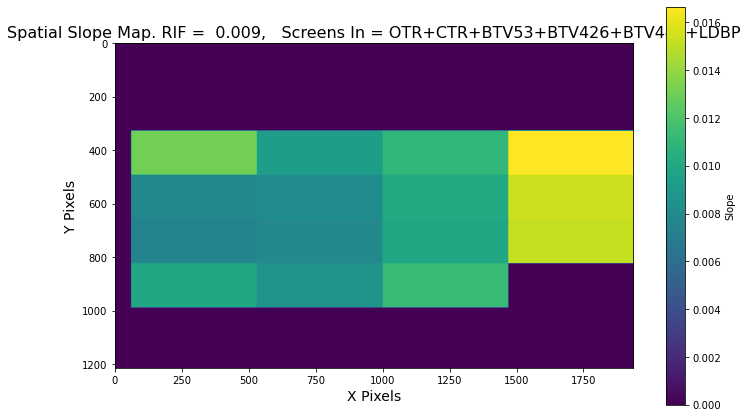

[{'slope': -0.006435257391649997, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': -0.005084120529587826, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': -0.005420149454683868, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': -0.006564007944995881, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': -0.007796797567410484, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': -0.0039514025776257395, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': -0.004695691871966179, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': -0.007560960606946797, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': -0.11374379365126892, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': -0.00485864670916668, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': -0.00491021183990603, 'camera section

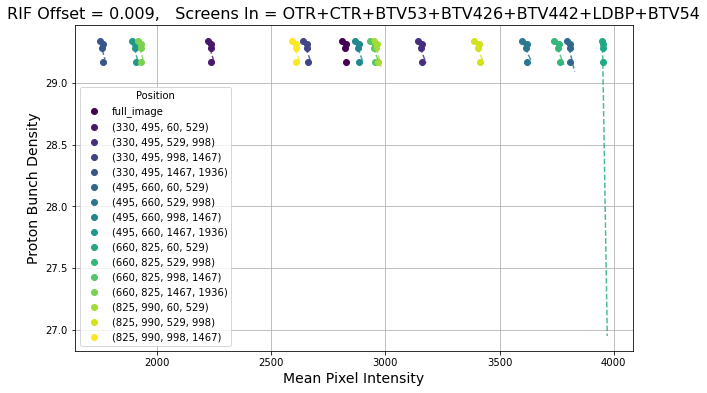

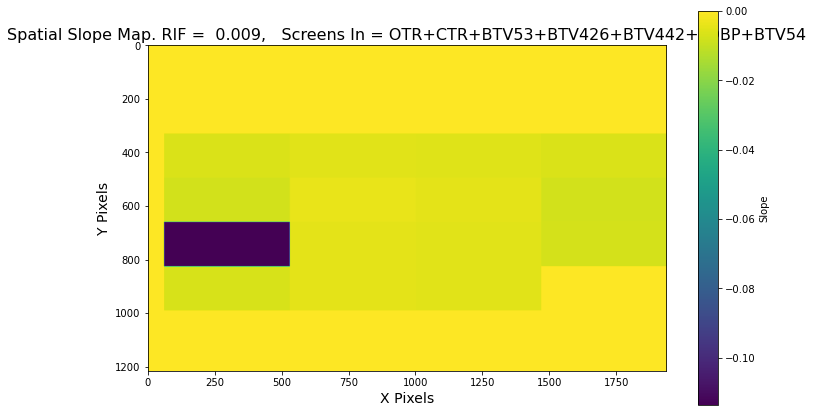

[{'slope': 0.013329662978076803, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.009424742312592644, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.01119785918306504, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.016888222057759868, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.007776582023182079, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.008228478513903096, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.010321313575432959, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.015618898127384583, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.007411667254555455, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.007905378594628087, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.010076817003958878, 'camera section': (660, 8

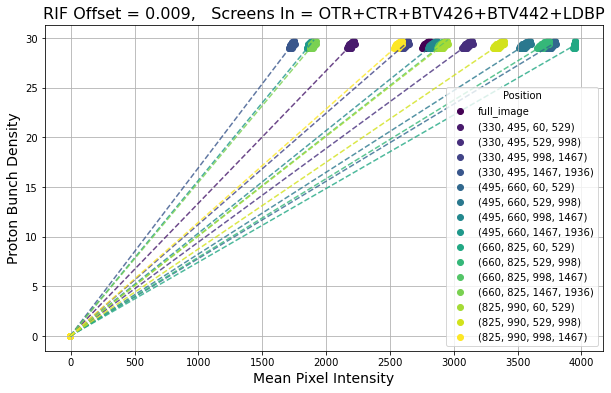

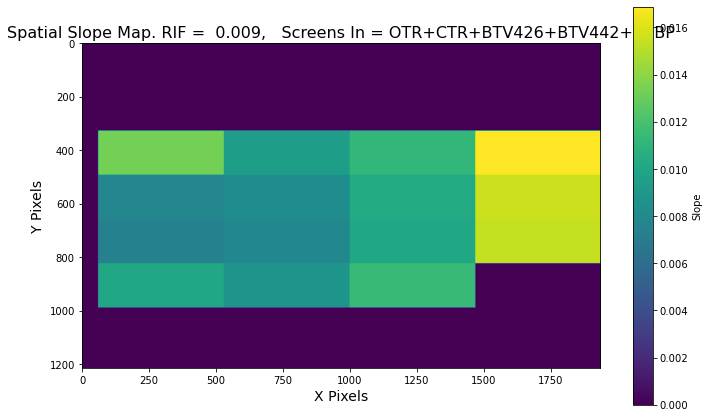

[]
nan


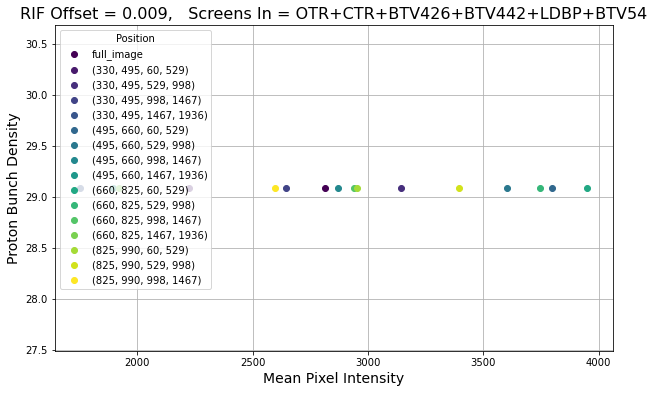

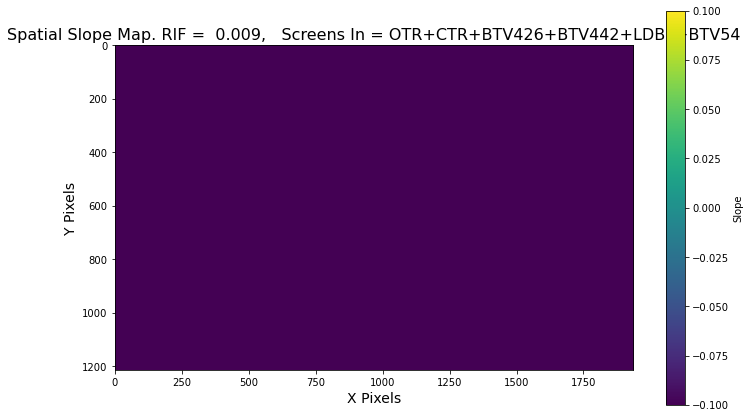

/tmp/ipykernel_470/1866989129.py:36: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


[{'slope': -0.008399979557182047, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': -0.004520520879069078, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': -0.0057393512348050246, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': -0.009483102519700269, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': -0.0047593177888206805, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': -0.004359868840297214, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': -0.00523409070378122, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': -0.009834053490113844, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': -0.016641551936622458, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': -0.004405274231227317, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': -0.005418218720395874, 'camera sect

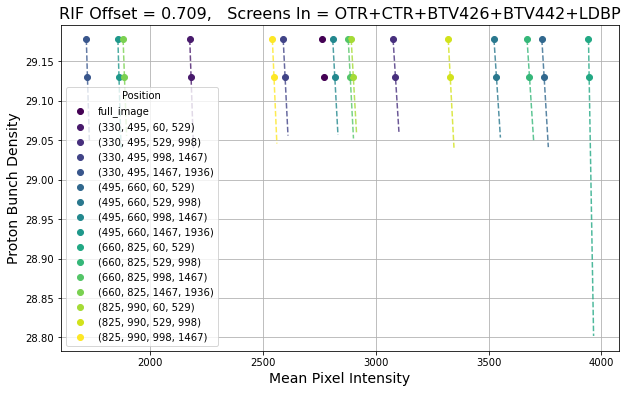

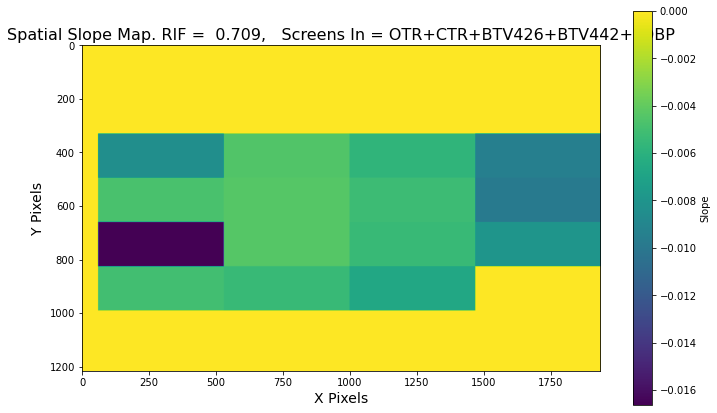

[{'slope': 0.005113072021227555, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.0034458408295380684, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.004736650462405513, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.0066197210912512855, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.0033980605988969963, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.003141340089876089, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.003923612292462025, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.006063062095499416, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.015985764838101255, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.0033941121739203273, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.004210326927131016, 'camera section': (6

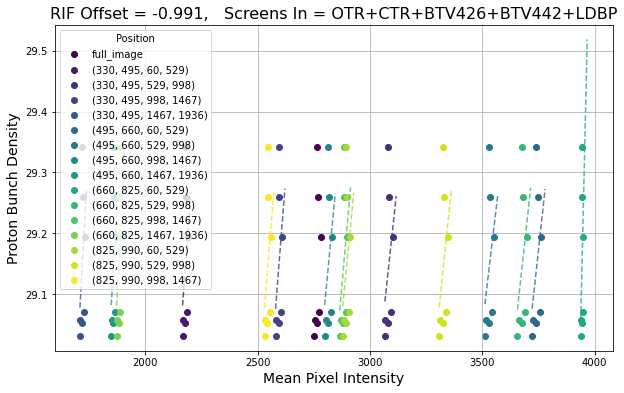

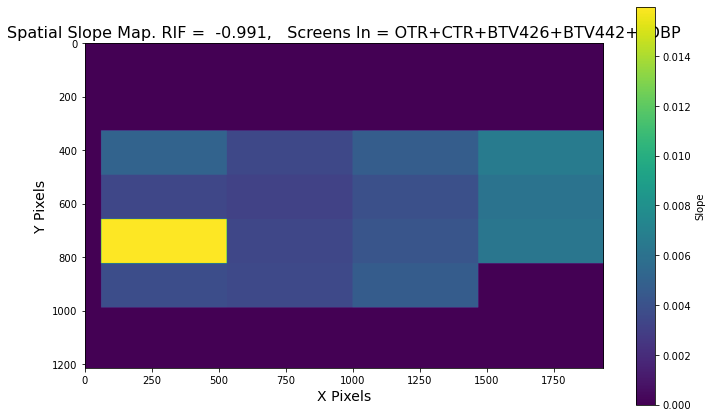

[{'slope': 0.01332905125329753, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.009423050778795863, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.011194322198937335, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.01688377512472455, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.007774806170575663, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.008224454303239813, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.01031628508739711, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.015611618187393875, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.0074065993628187774, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.007899300246836632, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.01006968487214053, 'camera section': (660, 825

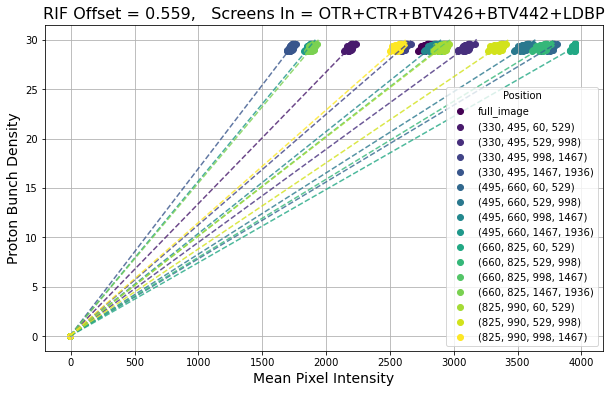

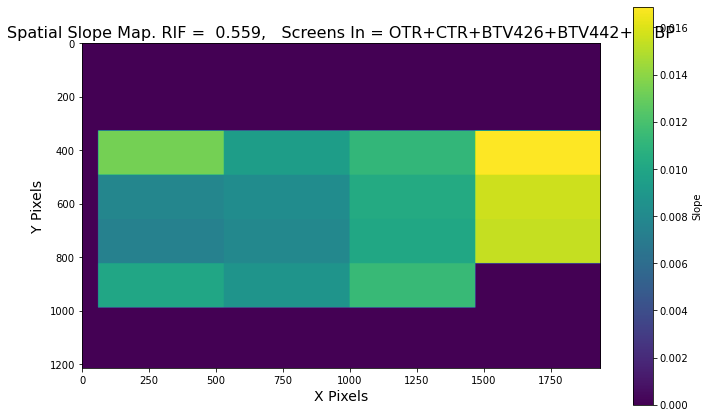

[{'slope': 0.006871658839143744, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.004657773598933022, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.006035233011020514, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.009273245752499475, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.009789830444724472, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.004198443266983862, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.005480720285624484, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.008321132073019679, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.08116796337944968, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.004446210085925514, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.0048704800762059035, 'camera section': (660, 

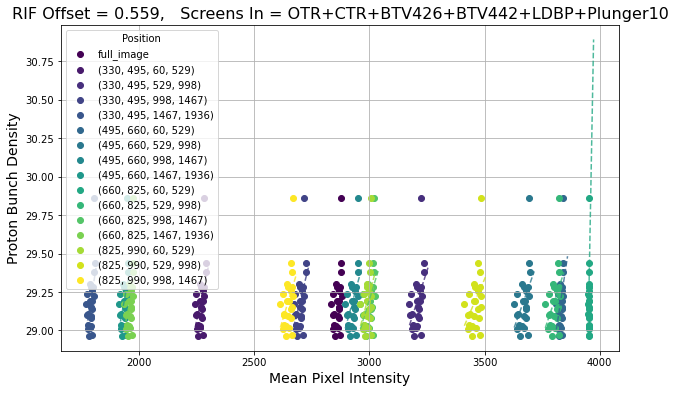

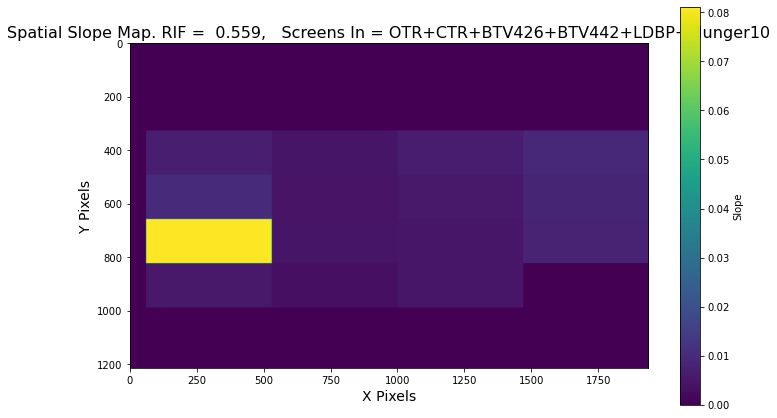

[{'slope': 0.00814392088239002, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.005704550438539532, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.007471555582659073, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.01120787016951748, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.011011857245854413, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.005243793097338418, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.0067507074464736175, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.010176673320494335, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.13905965959210506, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.005897259783880615, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.006393609540090231, 'camera section': (660, 82

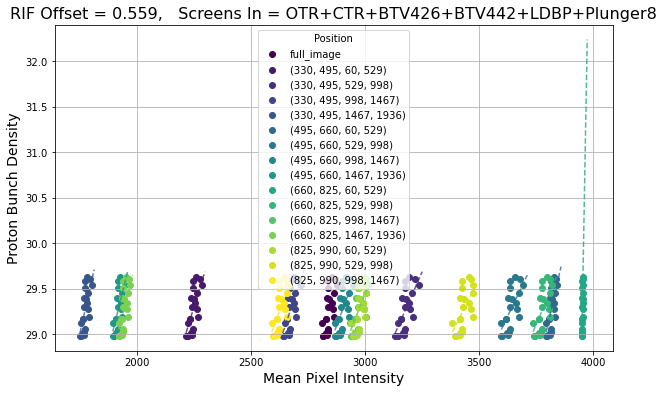

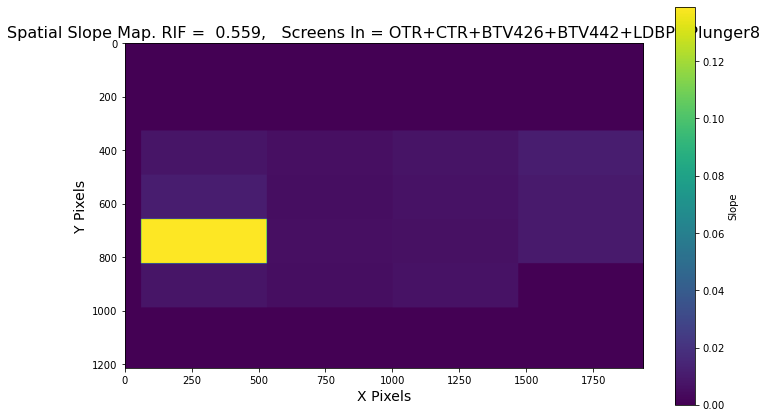

[{'slope': -2.9789062801200745e-05, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': -2.116506519121339e-05, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': -2.5118105375075716e-05, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': -3.7815362258832804e-05, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': -1.781864798023256e-05, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': -1.8464039667034998e-05, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': -2.3212379941998125e-05, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': -3.5037748923335664e-05, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': -1.882628690863622e-05, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': -1.7888912179369574e-05, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': -2.2652305030623765

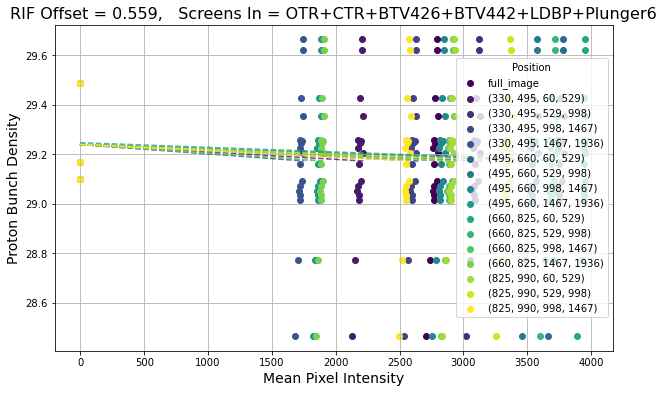

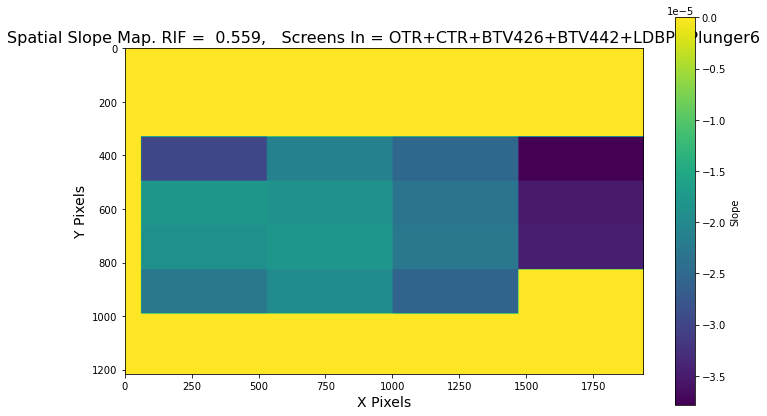

[{'slope': 0.0074171191104554154, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.005283774862946359, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.00626701810817281, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.00926761803849939, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.006399917868545635, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.004586642832138957, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.0057666586985427835, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.008616882073820524, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.048856161807040464, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.004943009805211429, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.005673117512279663, 'camera section': (660, 

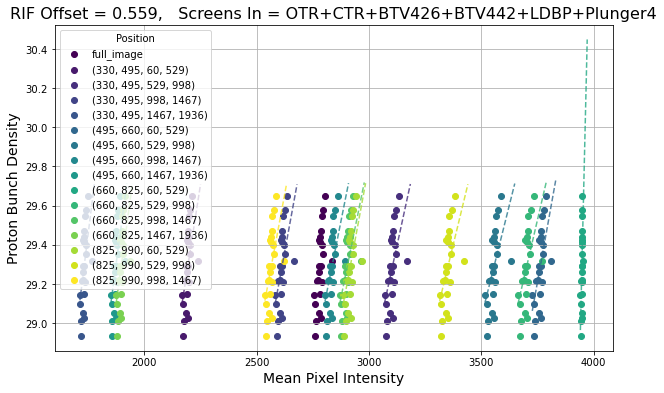

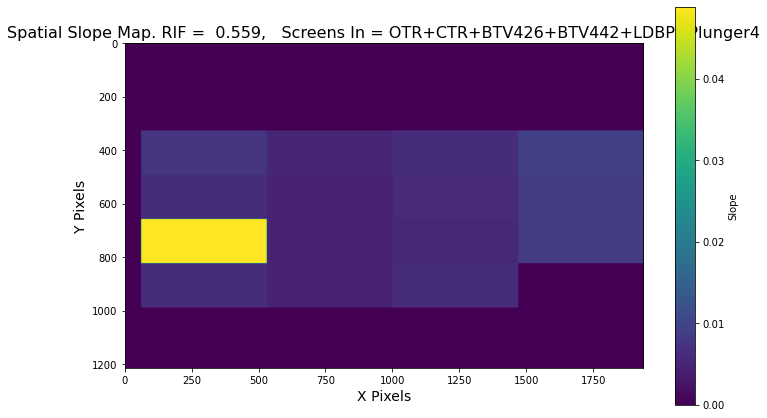

[{'slope': 0.022589435291969395, 'camera section': (330, 495, 60, 529), 'colour': '#481a6c'}, {'slope': 0.017621415091523675, 'camera section': (330, 495, 529, 998), 'colour': '#472f7d'}, {'slope': 0.021012651945591584, 'camera section': (330, 495, 998, 1467), 'colour': '#414487'}, {'slope': 0.02987969358099646, 'camera section': (330, 495, 1467, 1936), 'colour': '#39568c'}, {'slope': 0.01962040392554577, 'camera section': (495, 660, 60, 529), 'colour': '#31688e'}, {'slope': 0.016169128906980933, 'camera section': (495, 660, 529, 998), 'colour': '#2a788e'}, {'slope': 0.019024238166416928, 'camera section': (495, 660, 998, 1467), 'colour': '#23888e'}, {'slope': 0.02859544016428939, 'camera section': (495, 660, 1467, 1936), 'colour': '#1f988b'}, {'slope': 0.2320950887119255, 'camera section': (660, 825, 60, 529), 'colour': '#22a884'}, {'slope': 0.01631961935289758, 'camera section': (660, 825, 529, 998), 'colour': '#35b779'}, {'slope': 0.019131781796974952, 'camera section': (660, 825, 9

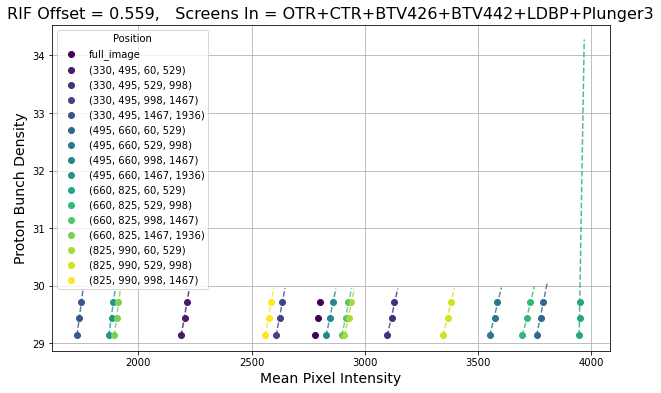

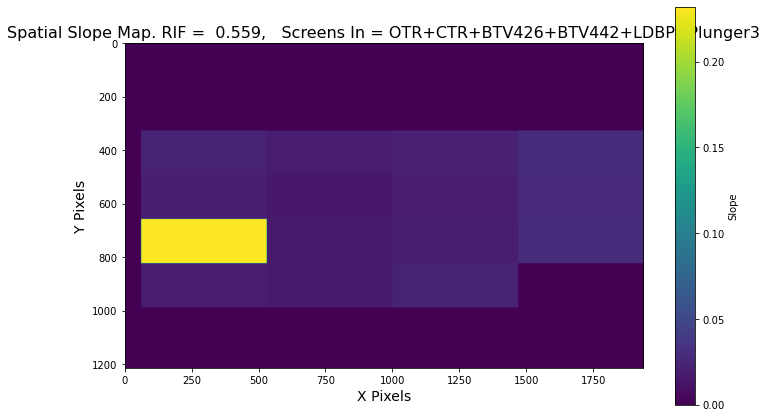

In [176]:
plot_spatially_sliced2(16,scin_screen_events100)

Text(0.5, 1.0, 'Spectrometer 1, 42 Sections')

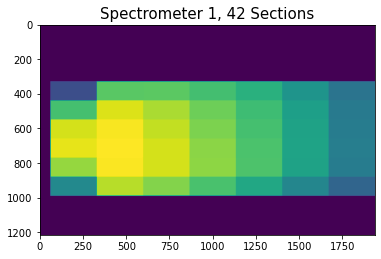

In [11]:
y_step = int(660/6)
x_step = int(1876/7)    
    
list_indices_y = list(range(330, 990, y_step))
list_indices_x = list(range(60, 1936, x_step))

results = []
list_means= []
intensity_grid = np.zeros((1216, 1936))

for i in list_indices_y:
    for j in list_indices_x:        
        sliced_data = ex_data[i:i+y_step,j:j+x_step]
        
        block_mean = np.mean(sliced_data)
        list_means.append(block_mean)
        
        intensity_grid[i:i+y_step, j:j+x_step] = block_mean       
        
#print(intensity_grid[8:16,11:22])
#print(list_means)
plt.imshow(intensity_grid)
plt.title('Spectrometer 1, 42 Sections',fontsize=15)

In [15]:
scin_screen_events_7_x_6 = sort_by_space_scin_screen(6,7,100,'2025/05/17')

/tmp/ipykernel_676/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


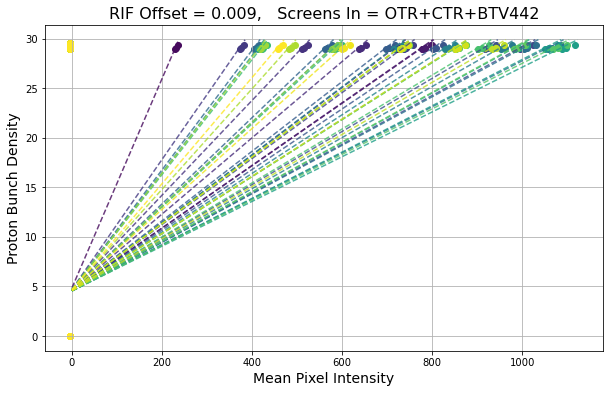

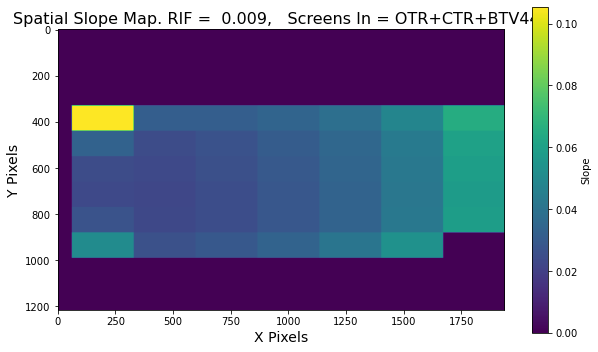

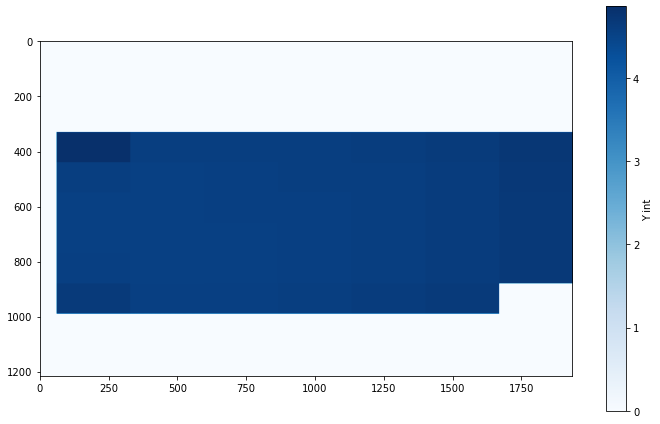

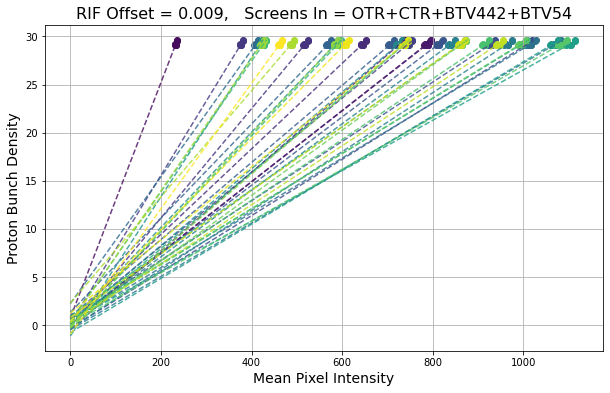

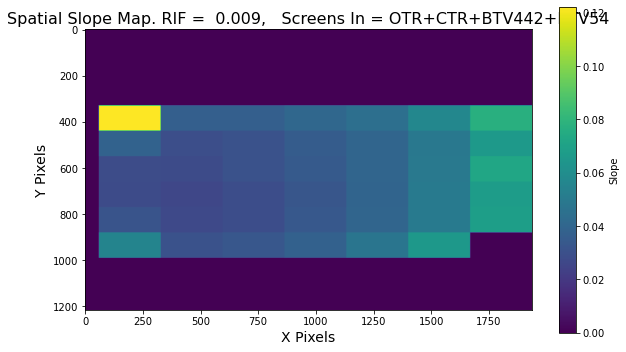

...

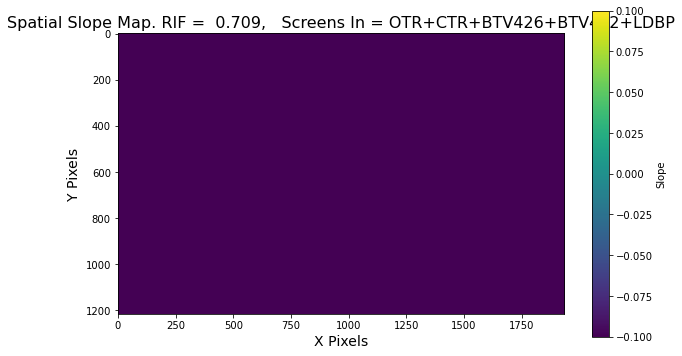

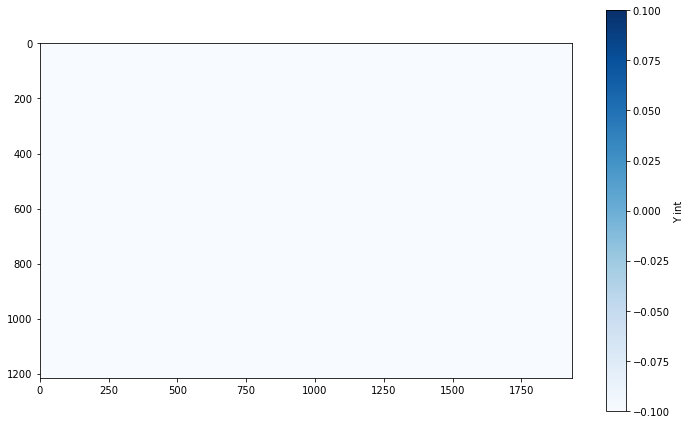

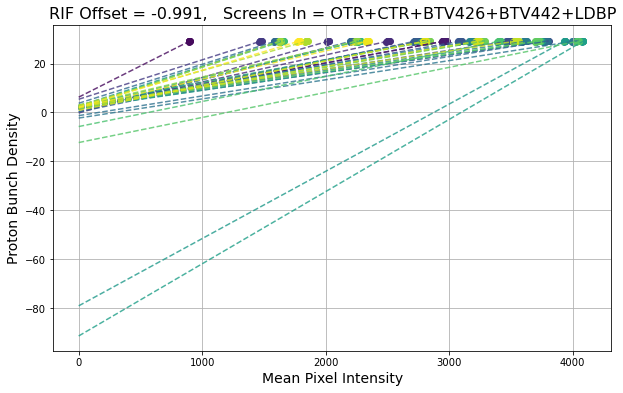

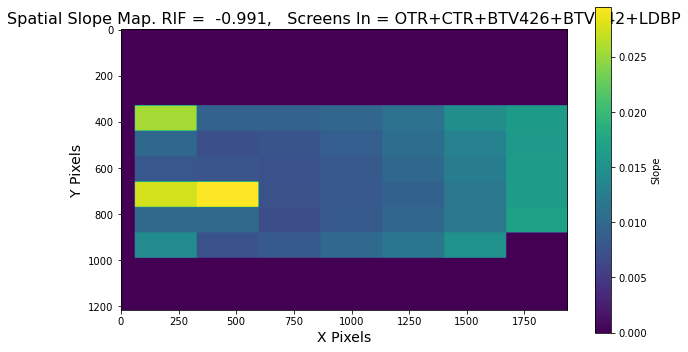

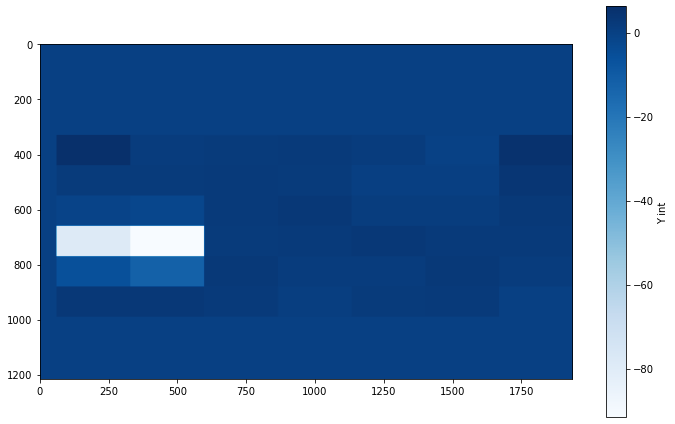

In [21]:
plot_spatially_sliced2(42 ,scin_screen_events_7_x_6)

[{'slope': 0.03354106819009273, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.10413570221164503, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.031163944808962143, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.031083767214216462, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.033702152472750734, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.03796868890876193, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.04719284537579982, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.06464775870766559, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.032842946122244476, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.024311776162082292, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.026433833946408525, 'camera section': (440, 550, 596, 8

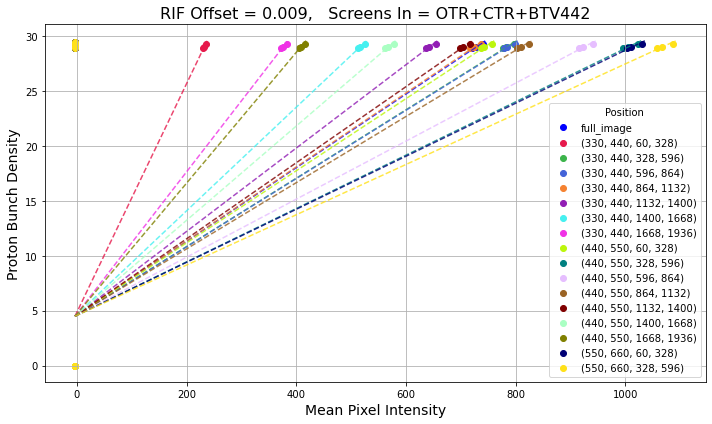

[{'slope': 0.03564321397039205, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.1078903872312615, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.032931702983662436, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.033033637227227984, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.036857579805259895, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.039595583625776115, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.051256849613285256, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.06842113977702464, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.03493796550584467, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.026374457971474672, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.02752988177822473, 'camera section': (440, 550, 596, 86

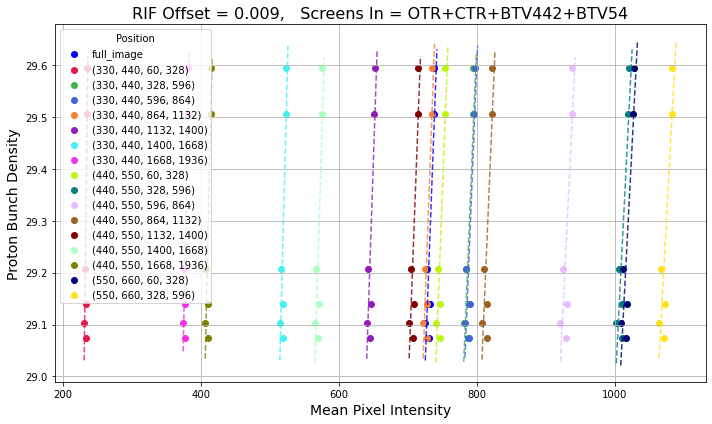

[{'slope': 0.010392491459667313, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.03177281317573398, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.009700943417204518, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.009674718695387788, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.010339056957084623, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.011448980549880935, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.01419445694718454, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.01944083815914695, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.010236033154038326, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.007563120615244628, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.008238870024409319, 'camera section': (440, 550, 596,

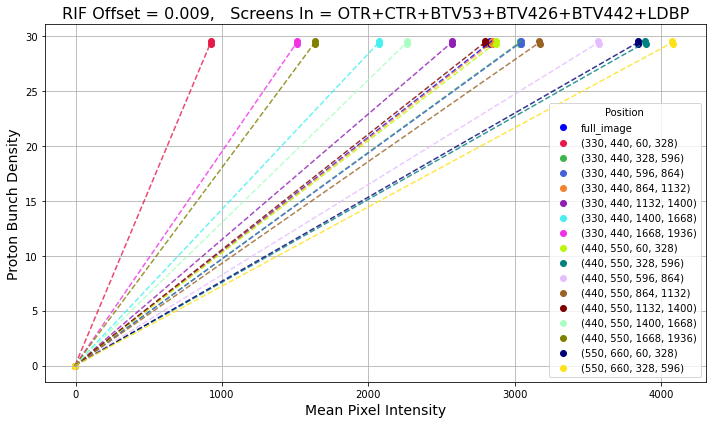

[{'slope': -0.006115319961023992, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -0.014442053677861671, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': -0.0045642605600967005, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': -0.005874492926211067, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': -0.0048767139396247525, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': -0.004839265944426133, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': -0.005954871184921444, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': -0.008144616077069148, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': -0.005125586979516395, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': -0.004657855994036999, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': -0.003895212787638697, 'camera section':

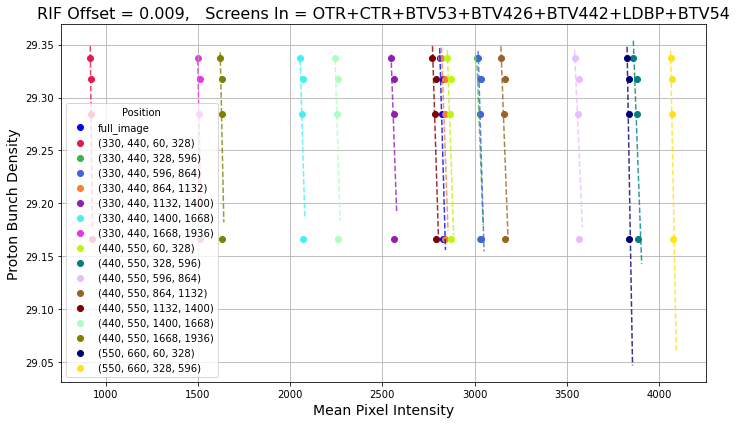

[{'slope': 0.010510441244324773, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.03230394882793771, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.009836748071598074, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.009809992855901043, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.010481790811343995, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.011605071491908354, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.014386104907215402, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.019716003876085433, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.010386896540703116, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.0076734587167284676, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.008353361017053333, 'camera section': (440, 550, 5

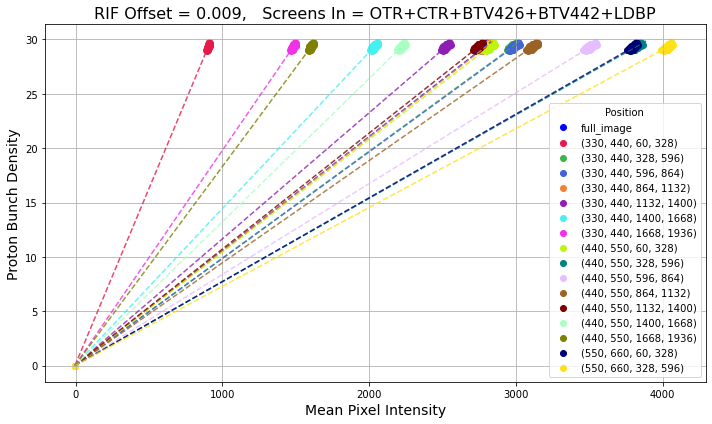

[]
nan


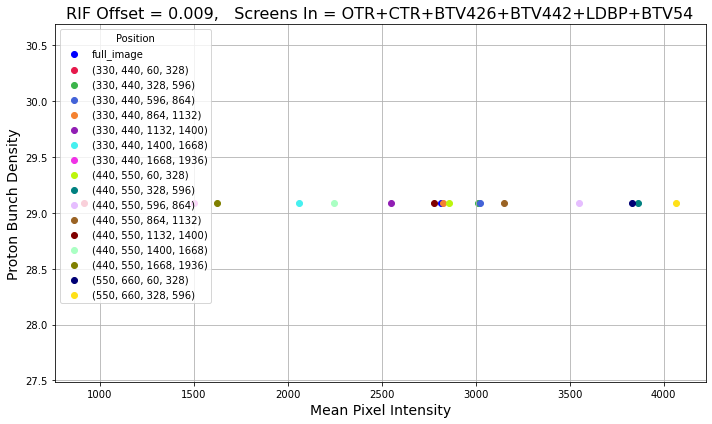

/tmp/ipykernel_470/3526793613.py:33: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


[{'slope': -0.006149413462418645, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -0.027643690543112234, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': -0.006022168728956494, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': -0.004924993851528035, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': -0.004581957357089869, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': -0.005637048603848034, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': -0.010165754683115574, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': -0.013406284784866954, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': -0.005884876000543724, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': -0.004304429976718734, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': -0.003682846501993243, 'camera section': (

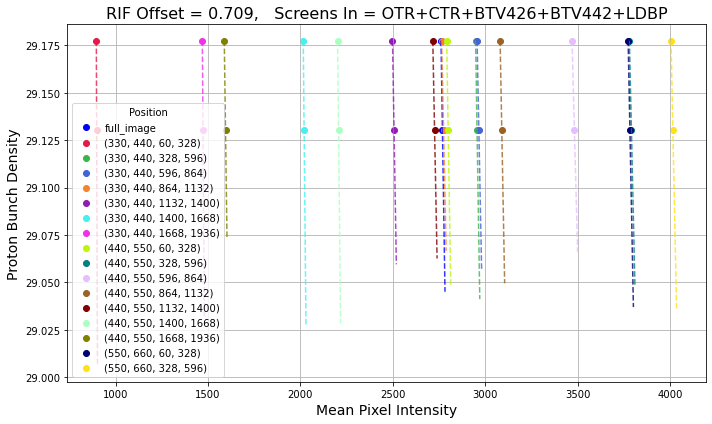

[{'slope': 0.0045253381029687545, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.012016009344833687, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.003830346665616501, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.0035170556628968393, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.003963767832454331, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.004917544285195835, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.005700919599109716, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.007438438044491709, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.004246718104123827, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.002897372711116626, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.003166236932464528, 'camera section': (440, 550,

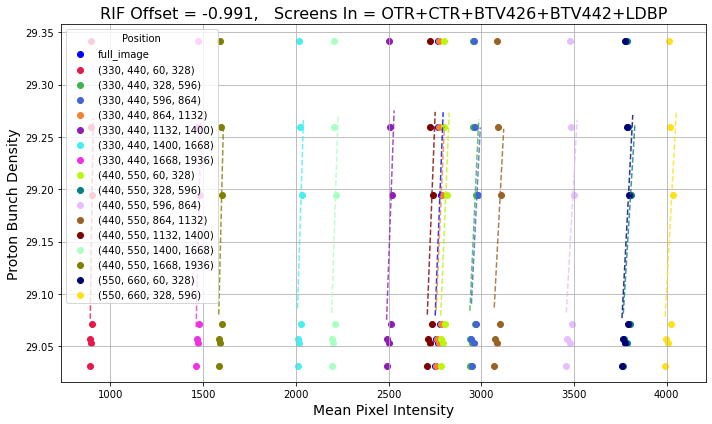

[{'slope': 0.010505583083537088, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.03230635987774501, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.00983623238283208, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.009808595046585045, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.010479561452577089, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.011601727768731128, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.01438198821489233, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.019710361036388787, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.010383806957958909, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.00767148163543424, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.008350815192797106, 'camera section': (440, 550, 596, 

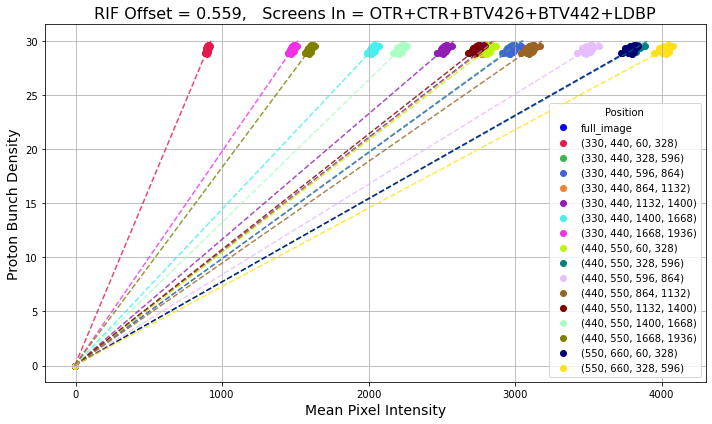

[{'slope': 0.0062876155283567116, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.017046132249327512, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.004951931029364374, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.004681447896675276, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.005525502669715732, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.006147578586094213, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.008281577270090709, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.010374407807530359, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.005412119477218064, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.003913897101673732, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.004096462003237165, 'camera section': (440, 550, 

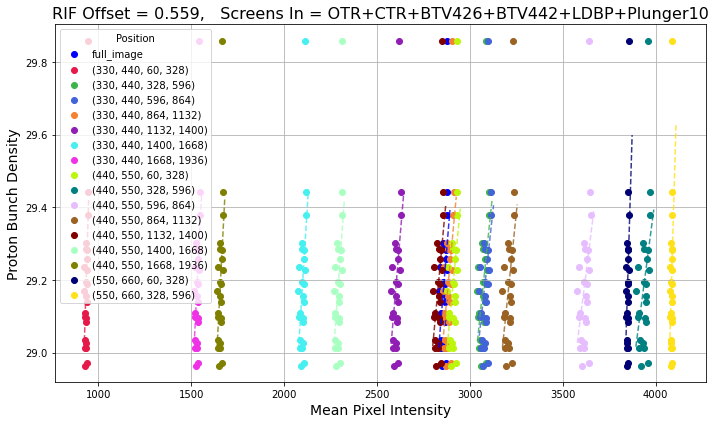

[{'slope': 0.007958083755964613, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.01959586504440212, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.005846240094106545, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.005836840928921468, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.006659179901897953, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.007912399472493736, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.009860374661624833, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.012918966426348107, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.006551344217070053, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.004767410501415534, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.005021995456584548, 'camera section': (440, 550, 59

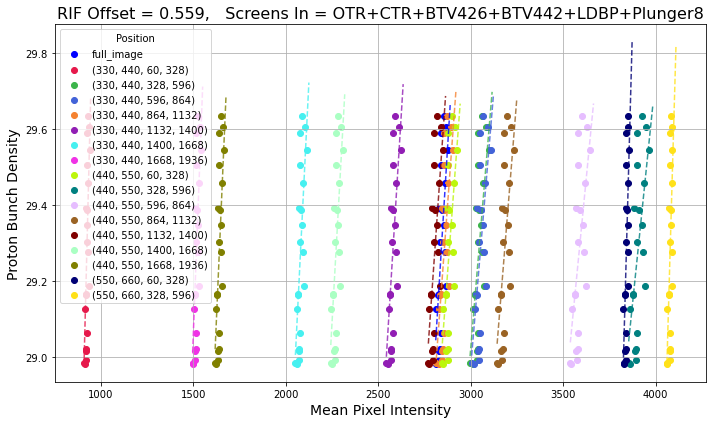

[{'slope': -2.3934292201581048e-05, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': -7.14351919046674e-05, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': -2.2053782944179203e-05, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': -2.2048398798925435e-05, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': -2.3510477808192924e-05, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': -2.6052464578821625e-05, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': -3.216028857755404e-05, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': -4.4122112457748966e-05, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': -2.3188973540383965e-05, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': -1.720854250205182e-05, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': -1.8759641121713344e-05, '

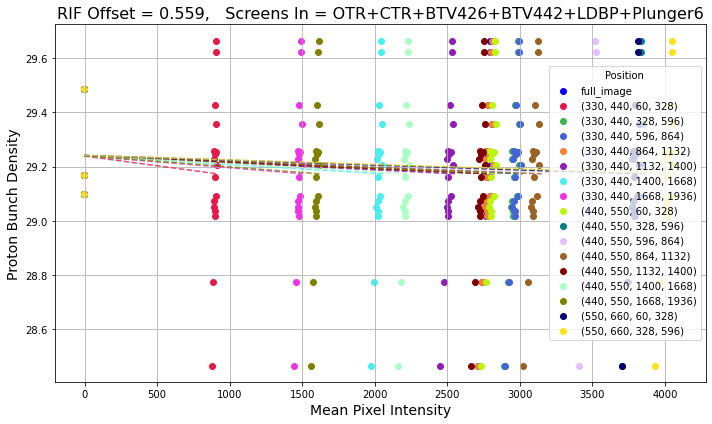

[{'slope': 0.006674998911466115, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.017595763831293933, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.0054584101620298985, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.0055230978680132796, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.005834561225864194, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.006566983925998341, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.007951801945425885, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.011076972160398187, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.005925936413717896, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.004234676402936534, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.004611446674067568, 'camera section': (440, 550,

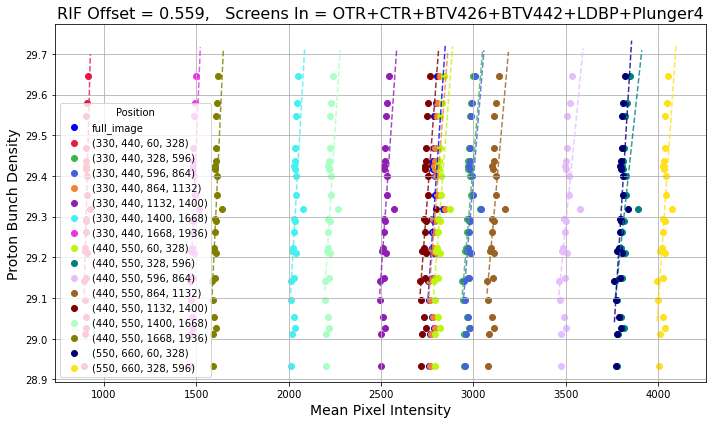

[{'slope': 0.0221692289568501, 'camera section': 'full_image', 'colour': '#0000ff'}, {'slope': 0.05080335768805927, 'camera section': (330, 440, 60, 328), 'colour': '#e6194b'}, {'slope': 0.016471969511458247, 'camera section': (330, 440, 328, 596), 'colour': '#3cb44b'}, {'slope': 0.018403297136965726, 'camera section': (330, 440, 596, 864), 'colour': '#4363d8'}, {'slope': 0.018991778651436565, 'camera section': (330, 440, 864, 1132), 'colour': '#f58231'}, {'slope': 0.022389485697387475, 'camera section': (330, 440, 1132, 1400), 'colour': '#911eb4'}, {'slope': 0.026369615274954187, 'camera section': (330, 440, 1400, 1668), 'colour': '#46f0f0'}, {'slope': 0.03501622756460943, 'camera section': (330, 440, 1668, 1936), 'colour': '#f032e6'}, {'slope': 0.017755980459500196, 'camera section': (440, 550, 60, 328), 'colour': '#bcf60c'}, {'slope': 0.014539443050092679, 'camera section': (440, 550, 328, 596), 'colour': '#008080'}, {'slope': 0.016313147773677636, 'camera section': (440, 550, 596, 

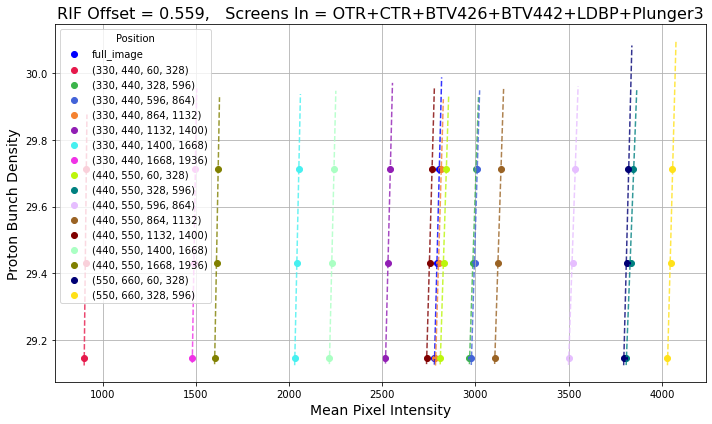

In [100]:
plot_spatially_sliced(scin_screen_events_7_x_6)

Text(0.5, 1.0, 'Spectrometer 1, 210 Sections')

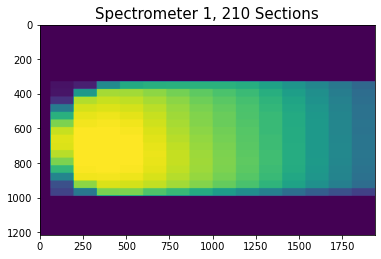

In [9]:
y_step = int(660/15)
x_step = int(1876/14)    
    
list_indices_y = list(range(330, 990, y_step))
list_indices_x = list(range(60, 1936, x_step))

results = []
list_means= []
intensity_grid = np.zeros((1216, 1936))

for i in list_indices_y:
    for j in list_indices_x:        
        sliced_data = ex_data[i:i+y_step,j:j+x_step]
        
        block_mean = np.mean(sliced_data)
        list_means.append(block_mean)
        
        intensity_grid[i:i+y_step, j:j+x_step] = block_mean       
        
#print(intensity_grid[8:16,11:22])
#print(list_means)
plt.imshow(intensity_grid)
plt.title('Spectrometer 1, 210 Sections',fontsize=15)

In [11]:
scin_screen_events_15_x_14 = sort_by_space_scin_screen(15,14,100,'2025/05/17')

/tmp/ipykernel_458/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


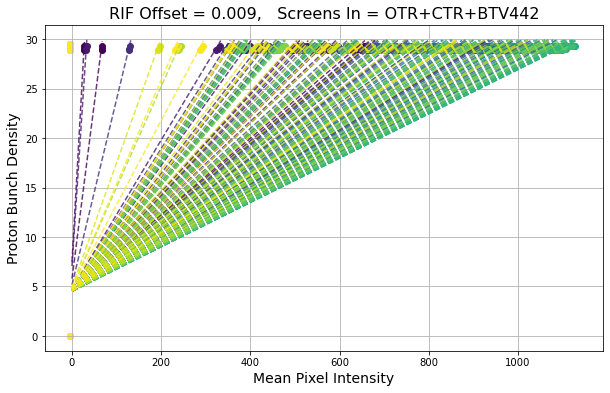

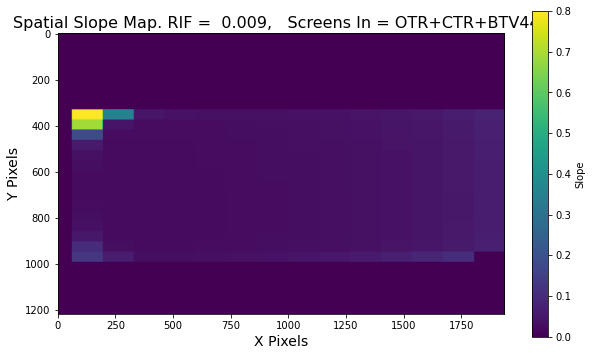

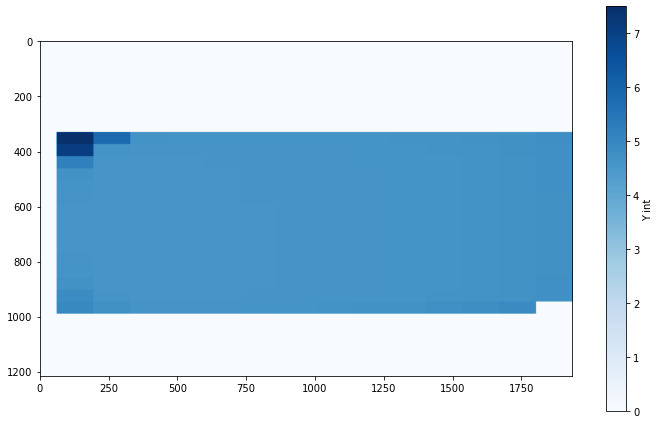

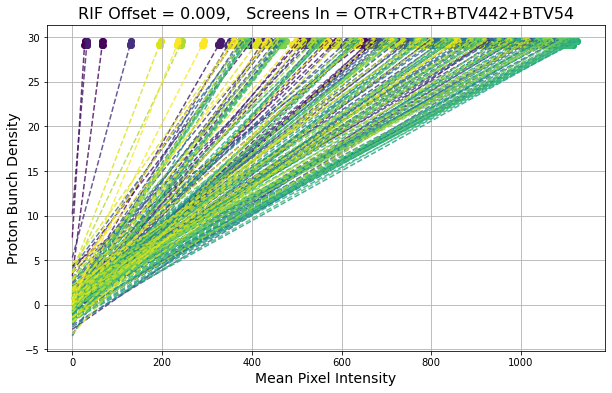

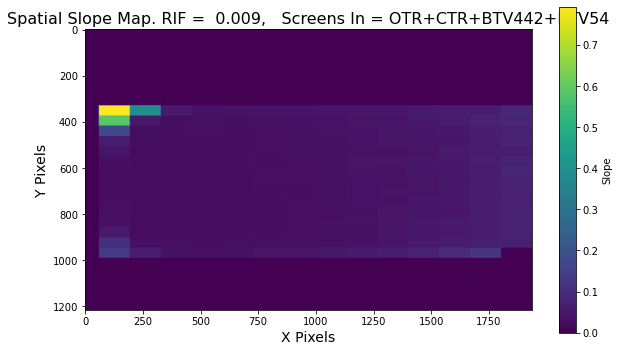

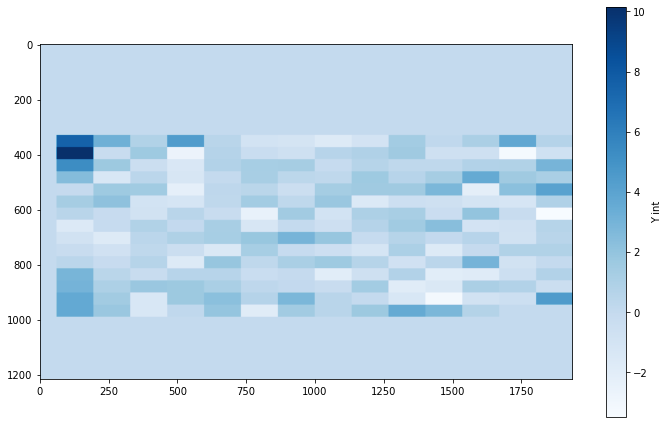

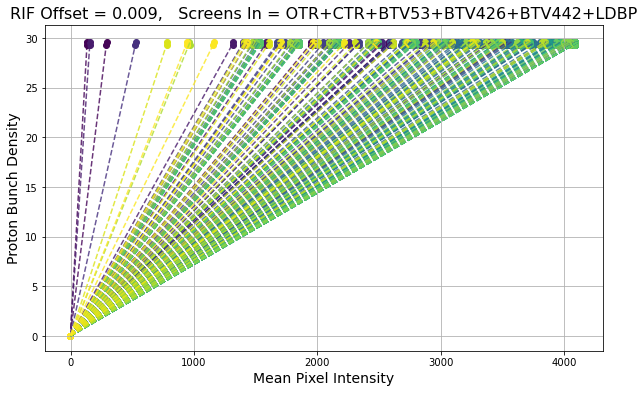

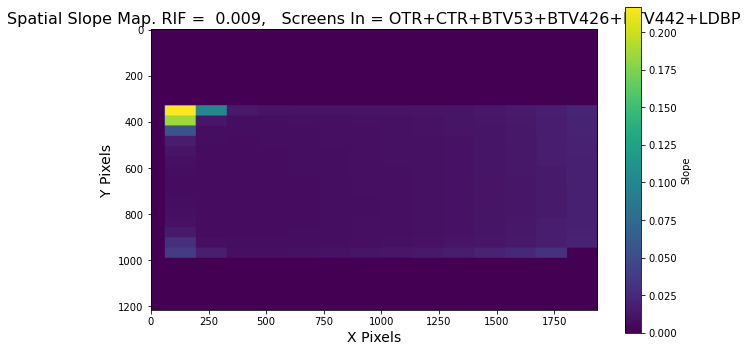

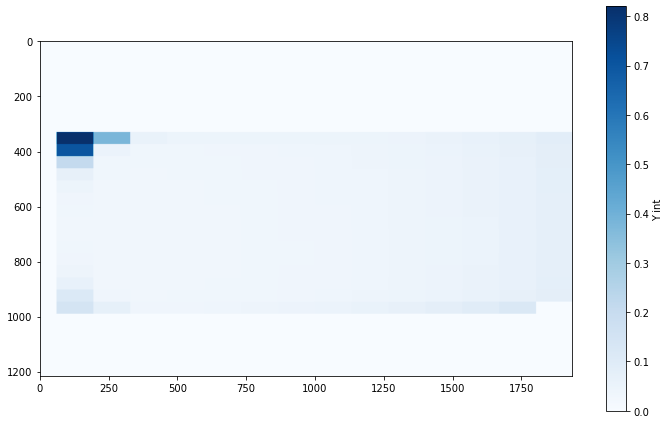

/tmp/ipykernel_458/3003152885.py:38: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, np.sort(x), np.sort(y))[0]


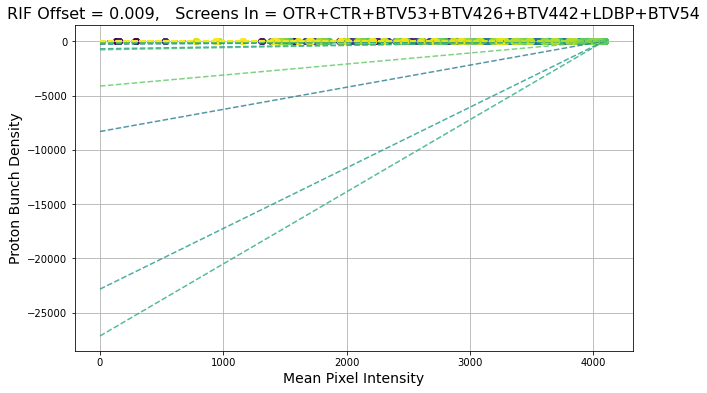

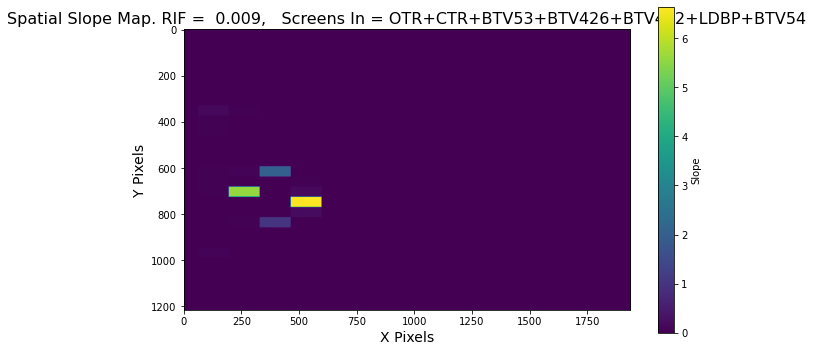

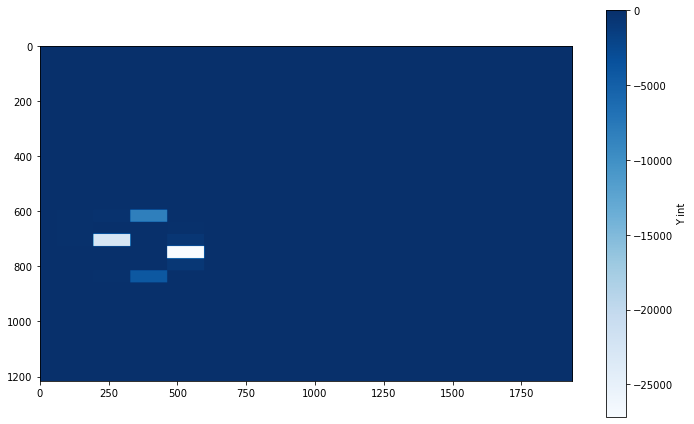

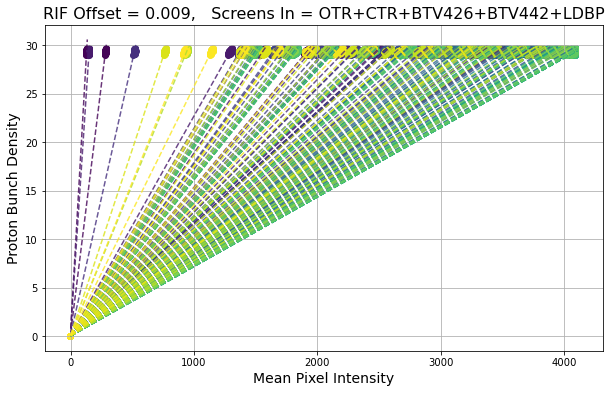

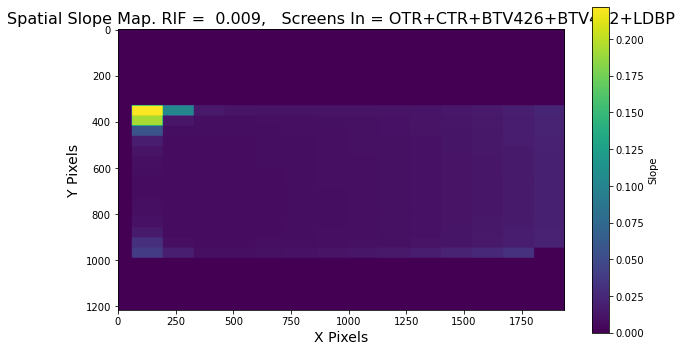

...

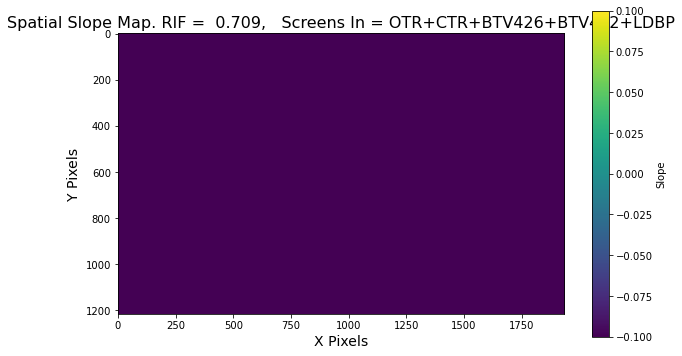

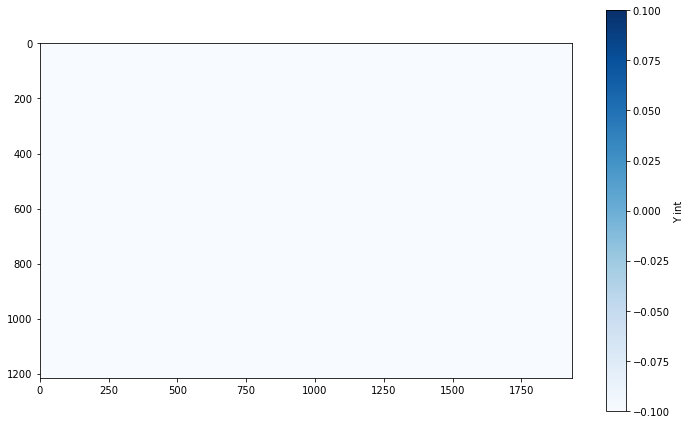

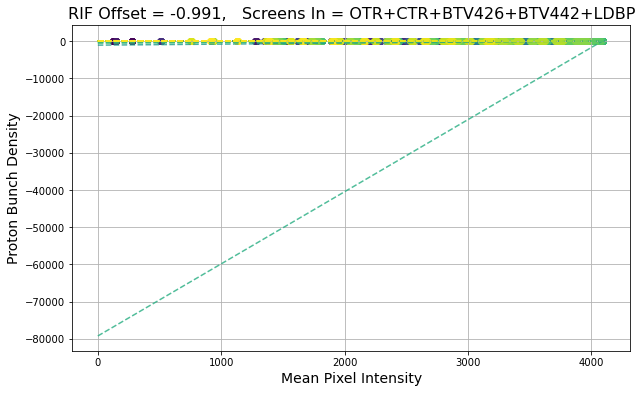

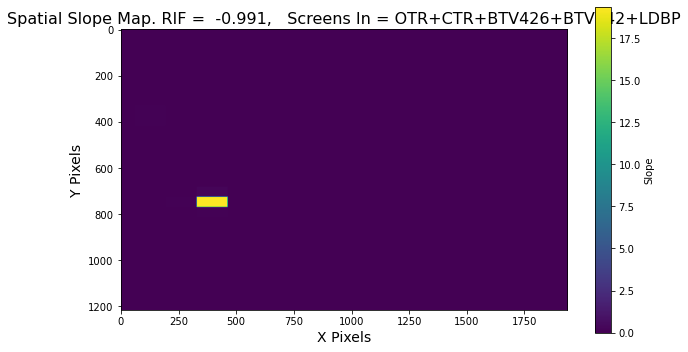

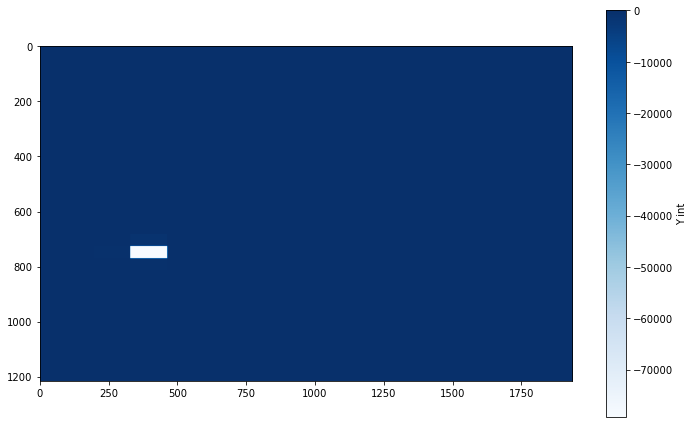

In [19]:
plot_spatially_sliced2(15*14,scin_screen_events_15_x_14)

In [21]:
scin_screen_events_15_x_14_15 = sort_by_space_scin_screen(15,14,100,'2025/05/16')

/tmp/ipykernel_458/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


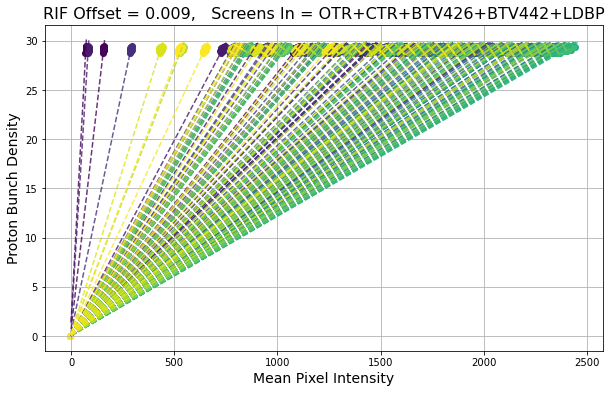

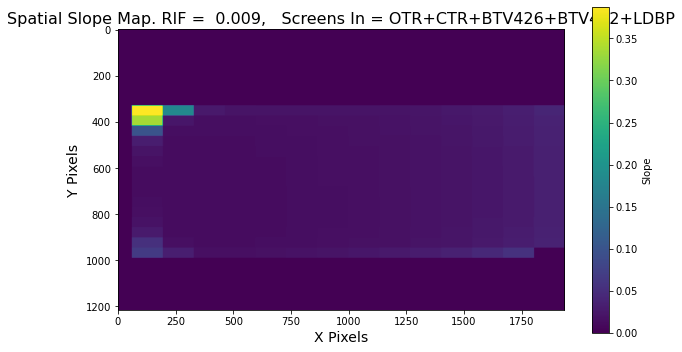

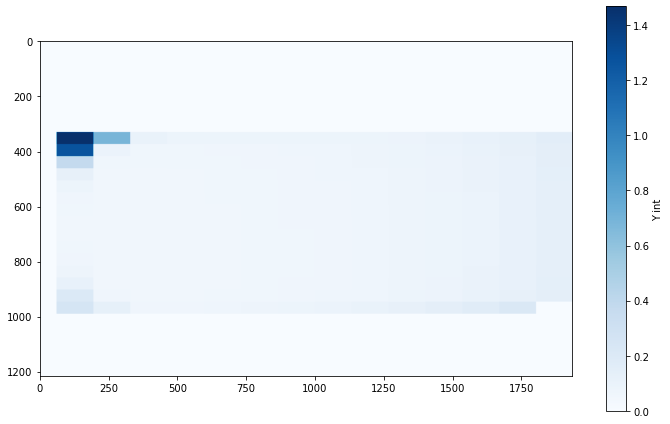

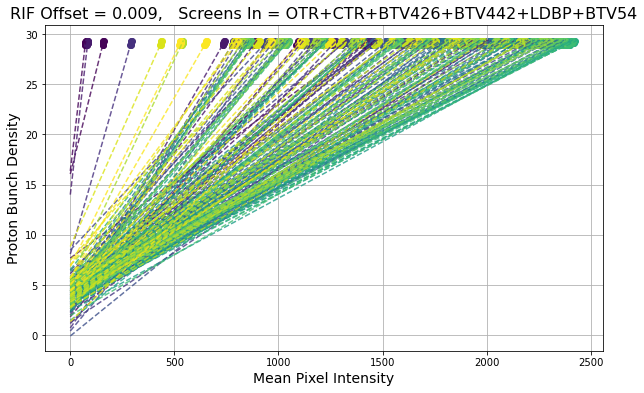

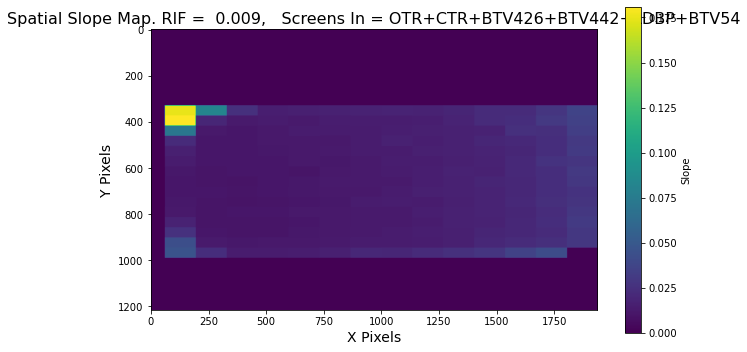

...

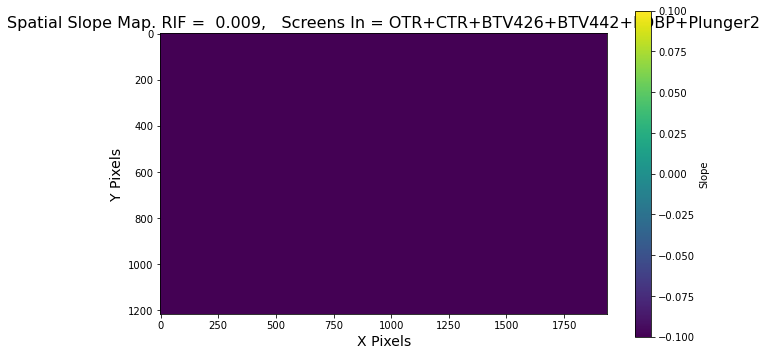

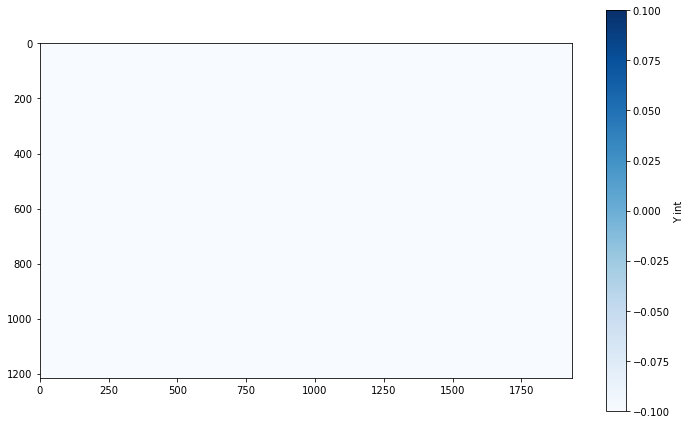

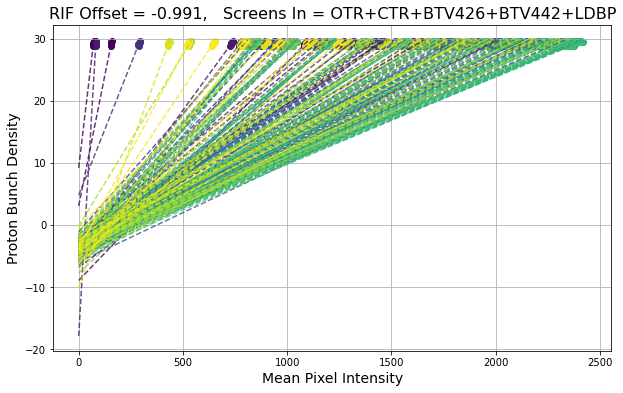

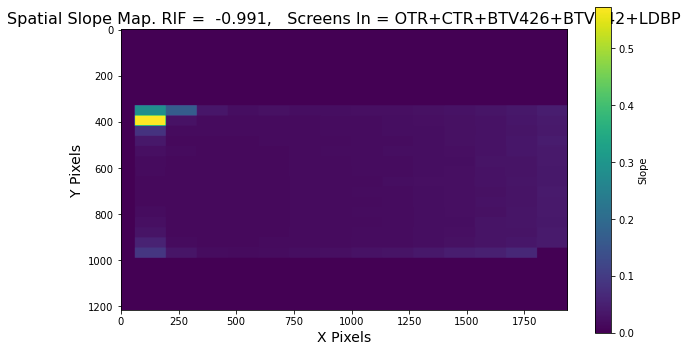

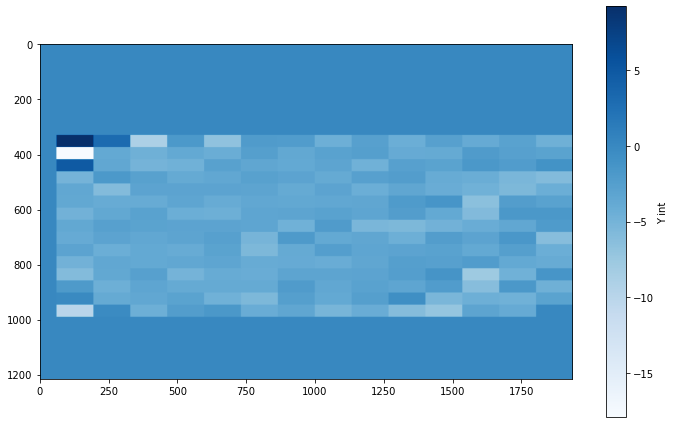

In [22]:
plot_spatially_sliced2(15*14,scin_screen_events_15_x_14_15)

In [24]:
scin_screen_events_4_x_4_15 = sort_by_space_scin_screen(4,4,100,'2025/05/16')

/tmp/ipykernel_458/2347484139.py:3: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed two minor releases later. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap(obj)`` instead.
  cmap = cm.get_cmap(cmap_name,n)


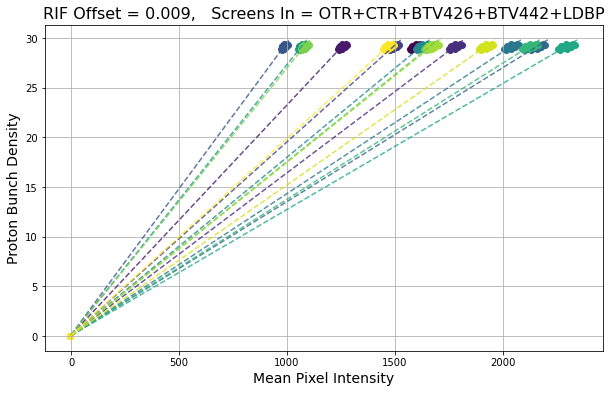

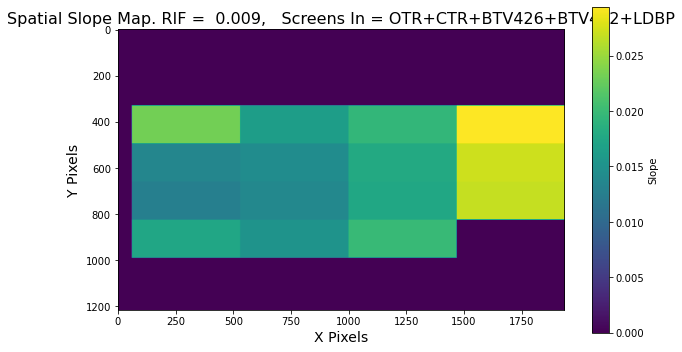

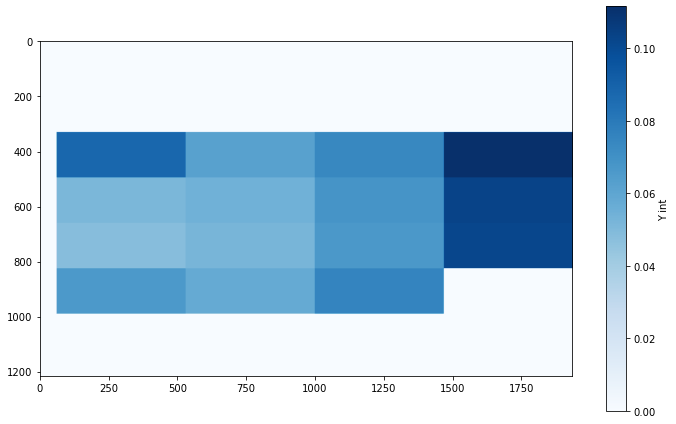

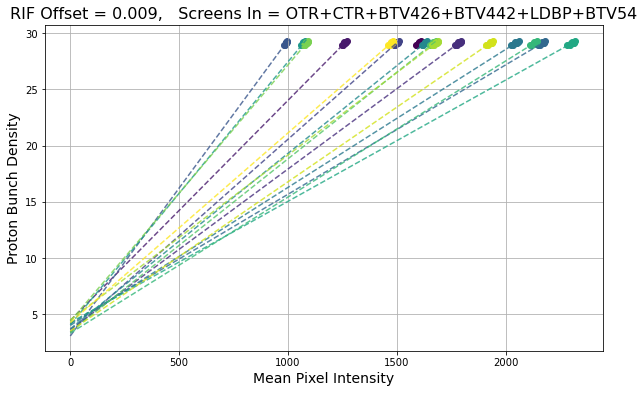

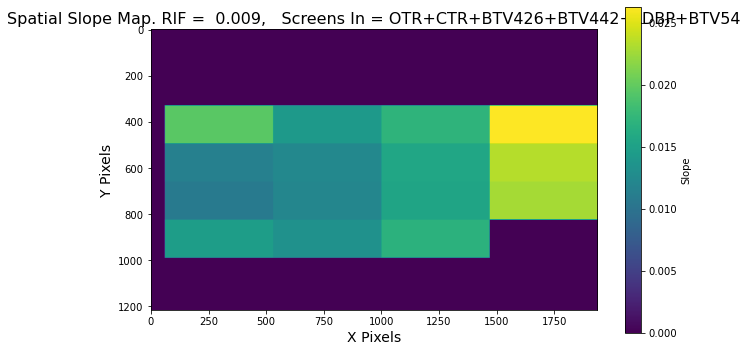

...

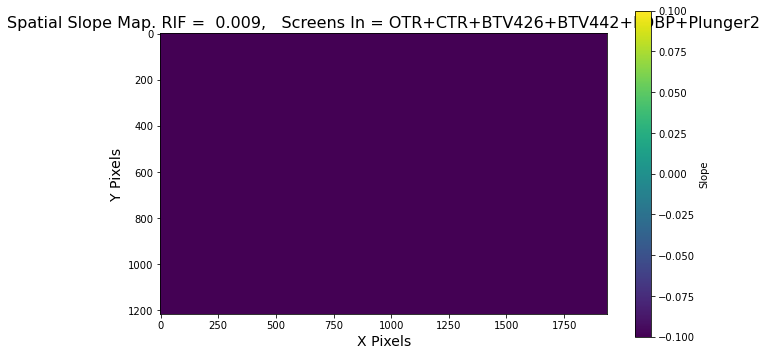

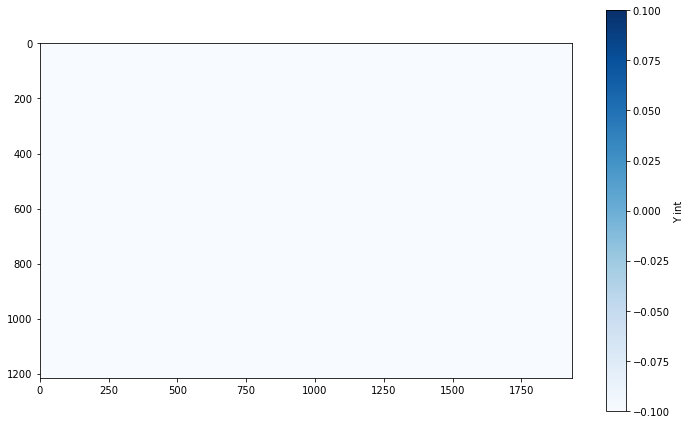

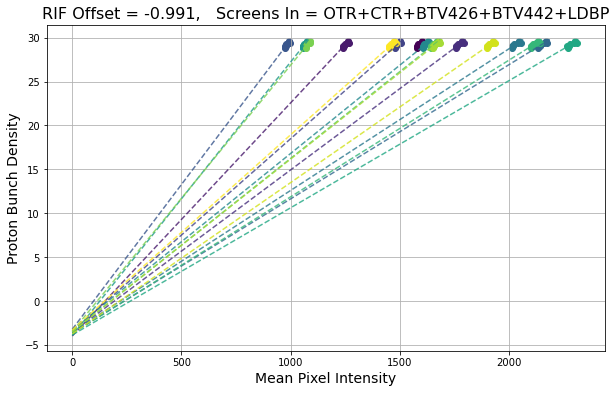

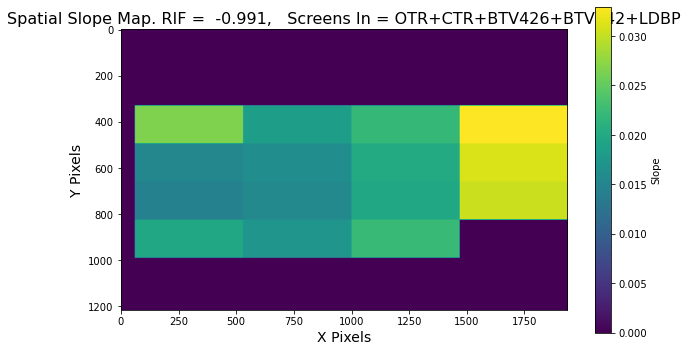

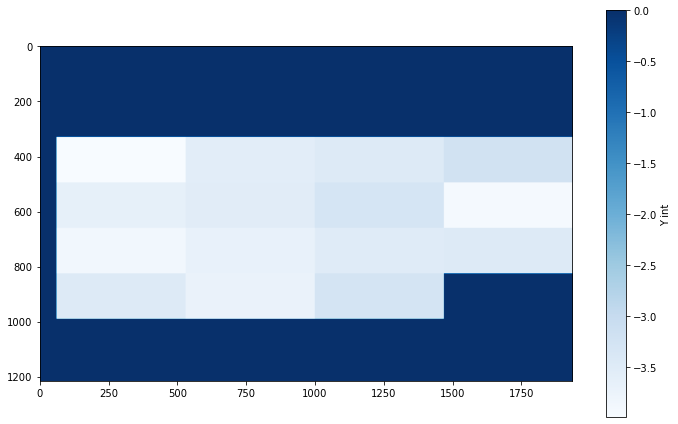

In [25]:
plot_spatially_sliced2(4*4,scin_screen_events_4_x_4_15)

# Try pixel by pixel analysis

In [12]:
def store_slopes_no_filtering(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            fig2, ax2 = plt.subplots(figsize=(10, 6))
            fig3, ax3 = plt.subplots(figsize=(10, 6))
            fig4, ax4 = plt.subplots(figsize=(10, 6))



            data = rif_data[rif][screen_label]
            index_count = list(data)
    
            list_slopes = []
            list_int = []
            slope_heat_map = np.zeros((1216, 1936))
            intercept_heat_map = np.zeros((1216, 1936))

            bin_width = 0.2
            
            try:
                for i in index_count:

                    x = np.array(data[i]['fit_parameters'])
                    y = np.array(data[i]['proton_count'])                

                    if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                        params = curve_fit(fit_line, x, y)[0]
                        a, b = params
                        list_slopes.append(a)
                        list_int.append(b)

                        slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                        intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b


                im = ax.imshow(slope_heat_map,cmap='Greens',origin='upper')
                ax.imshow(slope_heat_map,cmap='Greens')
                fig.colorbar(im, ax=ax, label ='Slope')

                im2 = ax2.imshow(intercept_heat_map,cmap='Blues',origin='upper')
                ax2.imshow(intercept_heat_map,cmap='Blues')
                fig2.colorbar(im2, ax=ax2, label ='Y int')
                
                
                # Histogram for slopes
                min_slope = np.floor(min(list_slopes))
                max_slope = np.ceil(max(list_slopes))
                bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                ax3.hist(list_slopes, bins=bins, color='green')
                ax3.set_title('Slope Distribution')
                ax3.set_xlabel('Slope')
                ax3.set_ylabel('Counts')
                ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                # Histogram for intercepts
                min_int = np.floor(min(list_int))
                max_int = np.ceil(max(list_int))
                bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                ax4.hist(list_int, bins=bins2, color='blue')
                ax4.set_title('Y-Intercept Distribution')
                ax4.set_xlabel('Intercept')
                ax4.set_ylabel('Counts')
                ax4.set_xlim([min_int*0.9, max_int*1.1])
                
                ax.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                plt.show()
                
            except:
                print('Error')
                continue

In [13]:
def store_slopes_std_filtering(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            fig2, ax2 = plt.subplots(figsize=(10, 6))
            fig3, ax3 = plt.subplots(figsize=(10, 6))
            fig4, ax4 = plt.subplots(figsize=(10, 6))



            data = rif_data[rif][screen_label]
            index_count = list(data)
    
            list_slopes = []
            list_int = []
            slope_heat_map = np.zeros((1216, 1936))
            intercept_heat_map = np.zeros((1216, 1936))


            for i in index_count:
                
                x = np.array(data[i]['fit_parameters'])
                y = np.array(data[i]['proton_count'])                

                if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                    params = curve_fit(fit_line, x, y)[0]
                    a, b = params
                    list_slopes.append(a)
                    list_int.append(b)
                    
                    slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                    intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
                    
            # Compute means and stds
            slopes_array = np.array(list_slopes)
            intercepts_array = np.array(list_int)
            
            mean_slope = np.mean(slopes_array)
            std_slope = np.std(slopes_array)

            mean_int = np.mean(intercepts_array)
            std_int = np.std(intercepts_array)

            # Filter out outliers > 2 std deviations
            filtered_slopes = slopes_array[np.abs(slopes_array - mean_slope) <= 2 * std_slope]
            filtered_intercepts = intercepts_array[np.abs(intercepts_array - mean_int) <= 2 * std_int]
            
            filtered_slope_map = np.zeros((1216, 1936))
            filtered_intercept_map = np.zeros((1216, 1936))
            
            slope_mask = (np.abs(slope_heat_map - mean_slope) <= 2 * std_slope) 
            intercept_mask = (np.abs(intercept_heat_map - mean_int) <= 2 * std_int) 

            # Apply masks
            filtered_slope_map[slope_mask] = slope_heat_map[slope_mask]
            filtered_intercept_map[intercept_mask] = intercept_heat_map[intercept_mask]
                    
            im = ax.imshow(filtered_slope_map,cmap='Greens',origin='upper')
            ax.imshow(filtered_slope_map,cmap='Greens')
            fig.colorbar(im, ax=ax, label ='Slope')
            
            im2 = ax2.imshow(filtered_intercept_map,cmap='Blues',origin='upper')
            ax2.imshow(filtered_intercept_map,cmap='Blues')
            fig2.colorbar(im2, ax=ax2, label ='Y int')

            
            bin_width = 0.1

            try:
                # Histogram for slopes
                min_slope = np.floor(min(filtered_slopes))
                max_slope = np.ceil(max(filtered_slopes))
                bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                ax3.hist(filtered_slopes, bins=bins, color='green')
                ax3.set_title('Slope Distribution')
                ax3.set_xlabel('Slope')
                ax3.set_ylabel('Counts')
                ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                # Histogram for intercepts
                min_int = np.floor(min(filtered_intercepts))
                max_int = np.ceil(max(filtered_intercepts))
                bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                ax4.hist(filtered_intercepts, bins=bins2, color='blue')
                ax4.set_title('Y-Intercept Distribution')
                ax4.set_xlabel('Intercept')
                ax4.set_ylabel('Counts')
                ax4.set_xlim([min_int*0.9, max_int*1.1])
                
                ax.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                
            except:
                print('Error')
                continue
      
            
            plt.show()

In [14]:
def store_slopes_mad_filtering(rif_data):
    list_rifs = list(rif_data)
    
    for rif in list_rifs:
        list_screen_combos = list(rif_data[rif])

        for screen_label in list_screen_combos:
            fig, ax = plt.subplots(figsize=(10, 6))
            fig2, ax2 = plt.subplots(figsize=(10, 6))
            fig3, ax3 = plt.subplots(figsize=(10, 6))
            fig4, ax4 = plt.subplots(figsize=(10, 6))



            data = rif_data[rif][screen_label]
            index_count = list(data)
    
            list_slopes = []
            list_int = []
            slope_heat_map = np.zeros((1216, 1936))
            intercept_heat_map = np.zeros((1216, 1936))


            for i in index_count:
                
                x = np.array(data[i]['fit_parameters'])
                y = np.array(data[i]['proton_count'])                

                if len(x) >= 3 and i != 'full_image':  # Curve fitting requires at least two data points
                    params = curve_fit(fit_line, x, y)[0]
                    a, b = params
                    list_slopes.append(a)
                    list_int.append(b)
                    
                    slope_heat_map[i[0]:i[1],i[2]:i[3]] = a 
                    intercept_heat_map[i[0]:i[1],i[2]:i[3]] = b
                    
            # Compute MAD
            slopes_array = np.array(list_slopes)
            intercepts_array = np.array(list_int)
            
        
            median_slope = np.median(slopes_array)
            abs_deviation = np.abs(slopes_array-median_slope)
            mad_slope =  np.median(abs_deviation)
            
            median_int = np.median(intercepts_array)
            abs_deviation_int = np.abs(intercepts_array-median_int)
            mad_int =  np.median(abs_deviation_int)



            # Filter out outliers > 2 MAD
            filtered_slopes = slopes_array[np.abs(slopes_array - median_slope) <= 2 * mad_slope]
            filtered_intercepts = intercepts_array[np.abs(intercepts_array - median_int) <= 2 * mad_int]
            
            filtered_slope_map = np.zeros((1216, 1936))
            filtered_intercept_map = np.zeros((1216, 1936))
            
            slope_mask = (np.abs(slope_heat_map - median_slope) <= 2 * mad_slope) 
            intercept_mask = (np.abs(intercept_heat_map - median_int) <= 2 * mad_int) 

            # Apply masks
            filtered_slope_map[slope_mask] = slope_heat_map[slope_mask]
            filtered_intercept_map[intercept_mask] = intercept_heat_map[intercept_mask]
                    
            im = ax.imshow(filtered_slope_map,cmap='Greens',origin='upper')
            ax.imshow(filtered_slope_map,cmap='Greens')
            fig.colorbar(im, ax=ax, label ='Slope')
            
            im2 = ax2.imshow(filtered_intercept_map,cmap='Blues',origin='upper')
            ax2.imshow(filtered_intercept_map,cmap='Blues')
            fig2.colorbar(im2, ax=ax2, label ='Y int')

            
            bin_width = 0.05

            try:
                # Histogram for slopes
                min_slope = np.floor(min(filtered_slopes))
                max_slope = np.ceil(max(filtered_slopes))
                bins = np.arange(min_slope, max_slope + bin_width, bin_width)
                ax3.hist(filtered_slopes, bins=bins, color='green')
                ax3.set_title('Slope Distribution')
                ax3.set_xlabel('Slope')
                ax3.set_ylabel('Counts')
                ax3.set_xlim([min_slope*0.9, max_slope*1.1])

                # Histogram for intercepts
                min_int = np.floor(min(filtered_intercepts))
                max_int = np.ceil(max(filtered_intercepts))
                bins2 = np.arange(min_int, max_int + bin_width, bin_width)
                ax4.hist(filtered_intercepts, bins=bins2, color='blue')
                ax4.set_title('Y-Intercept Distribution')
                ax4.set_xlabel('Intercept')
                ax4.set_ylabel('Counts')
                ax4.set_xlim([min_int*0.9, max_int*1.1])
                
                ax.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                ax2.set_title(f'Spatial Slope Map. RIF =  {round(rif - 1132482.599, 4)},   Screens In = {screen_label}' , fontsize=16)
                
                plt.show()
                
            except:
                print('Error')
                continue


In [63]:
## 17/05 220*469

In [15]:
scin_screen_events_pixel_by_pixel = sort_by_space_scin_screen(220,469,100,'2025/05/17')

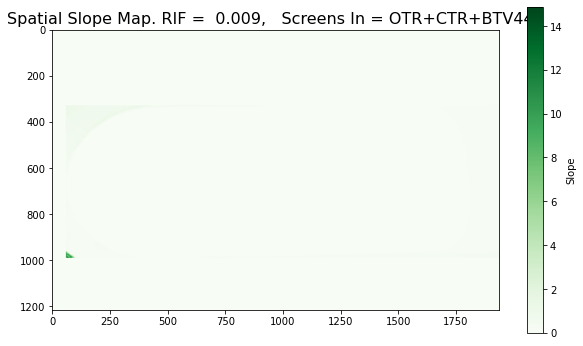

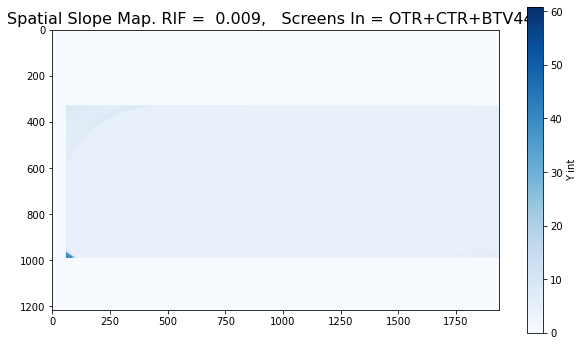

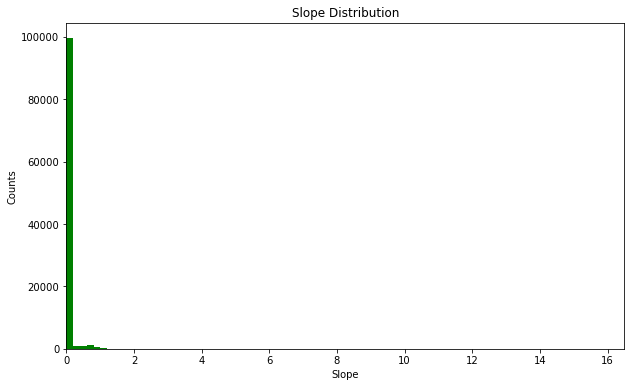

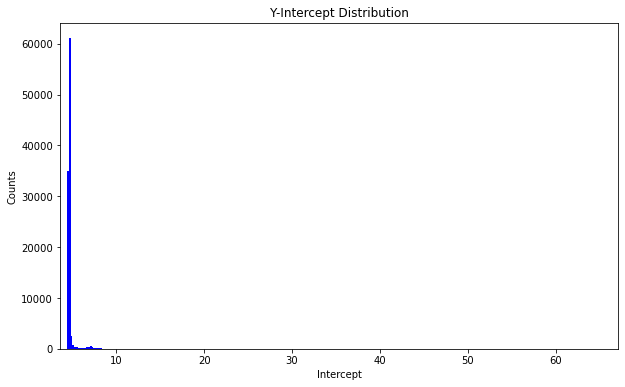

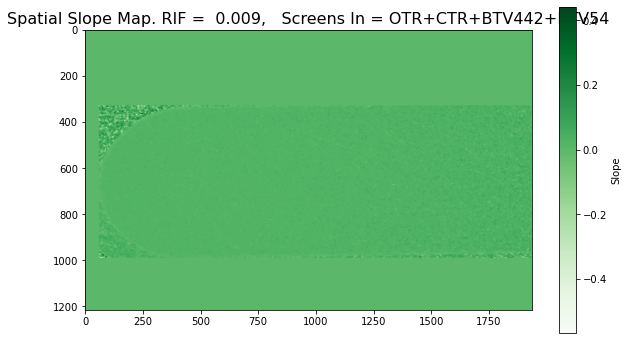

...

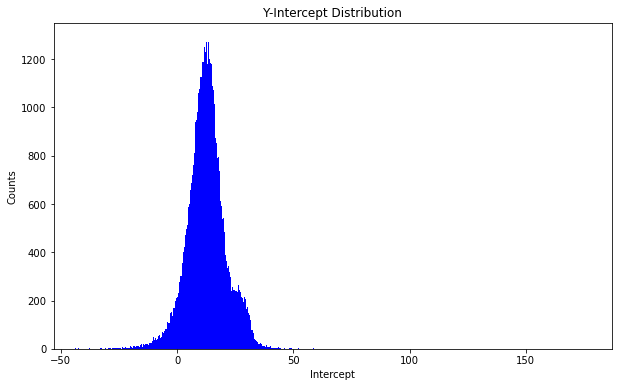

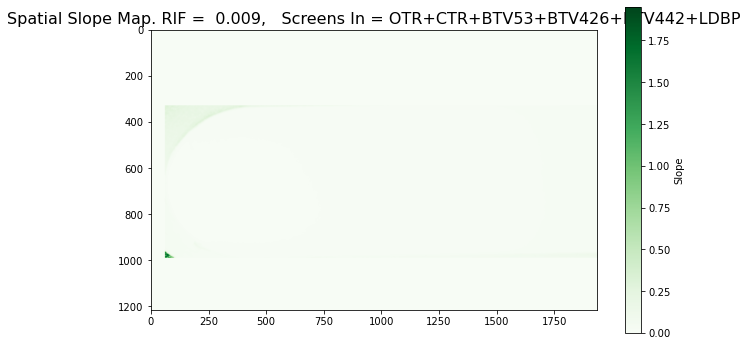

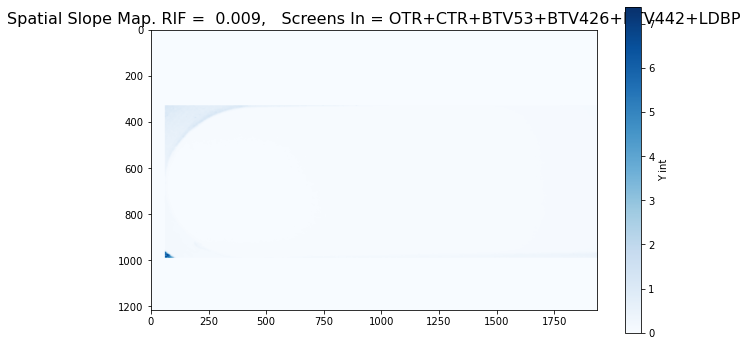

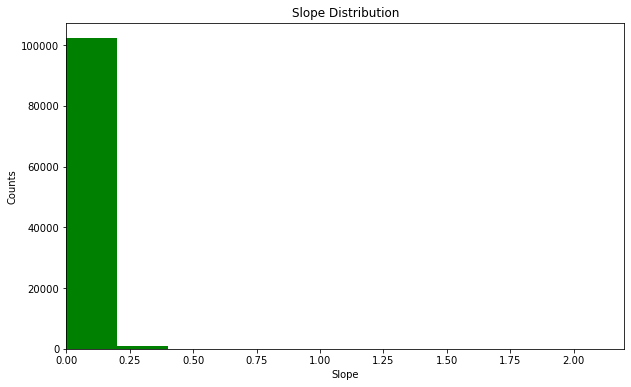

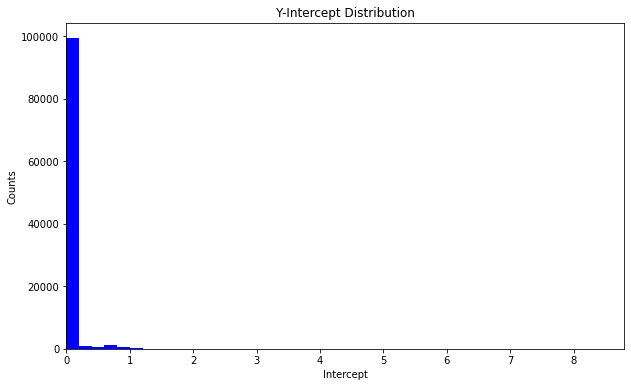

/tmp/ipykernel_458/3616925976.py:32: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


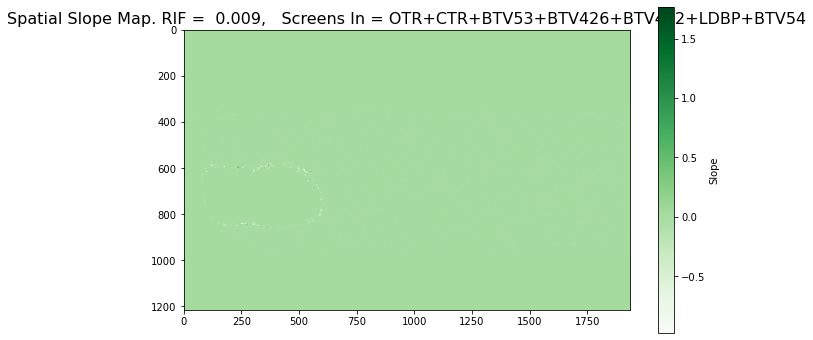

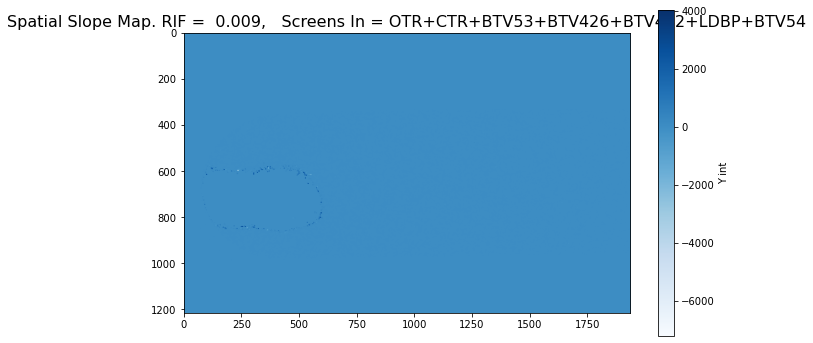

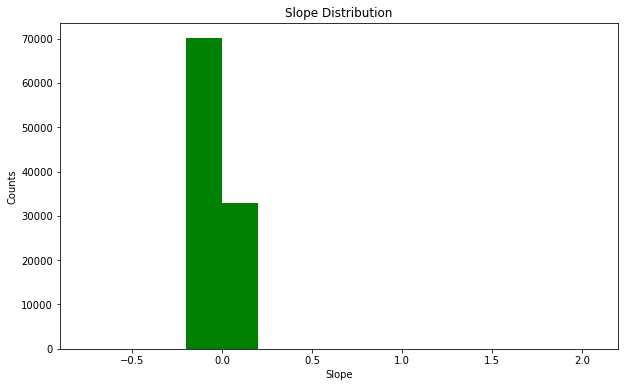

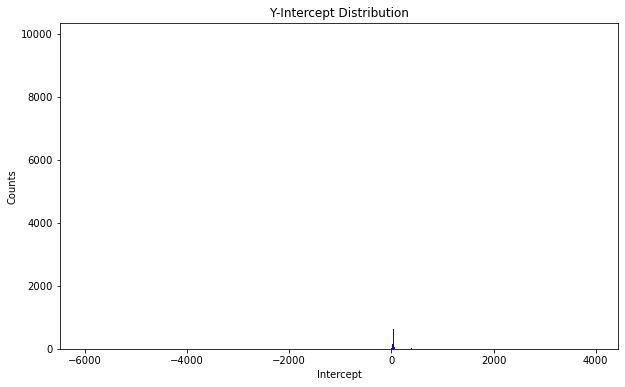

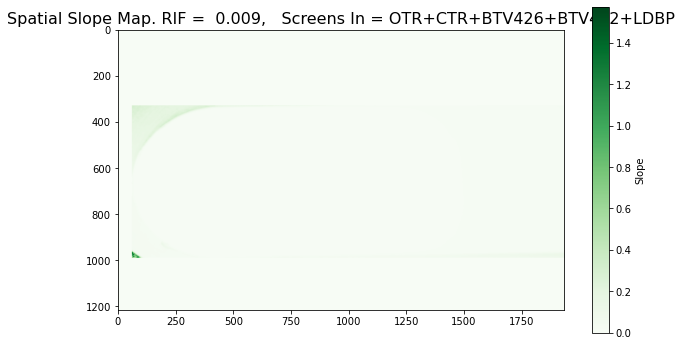

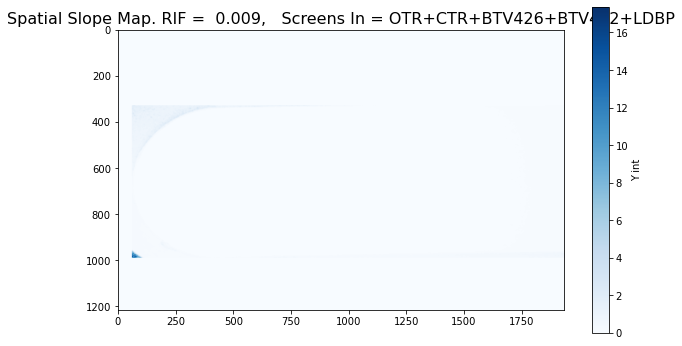

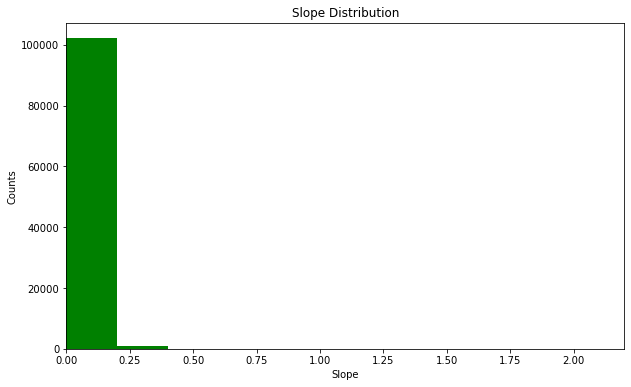

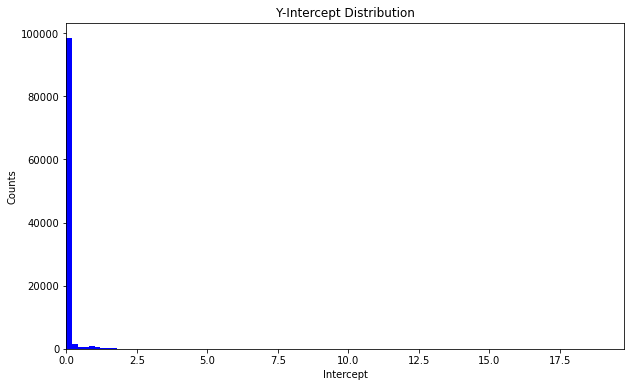

Error
Error
Error


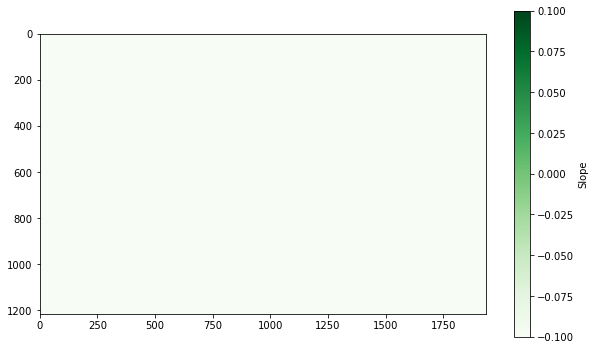

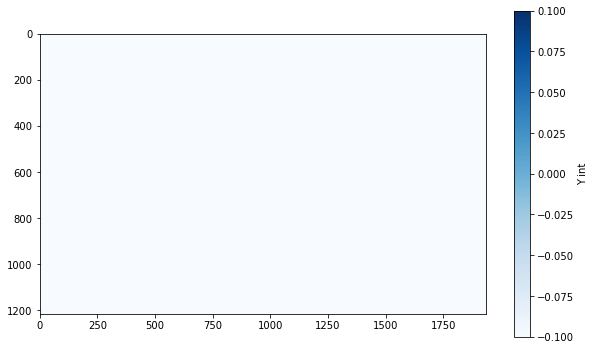

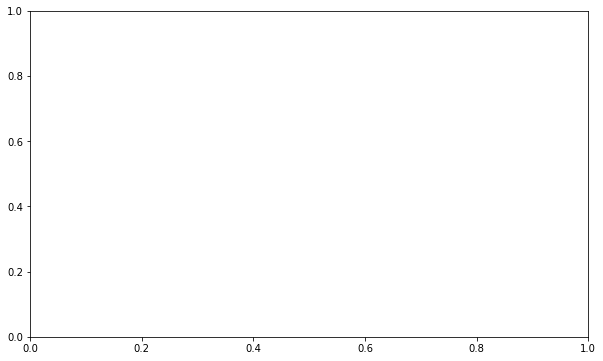

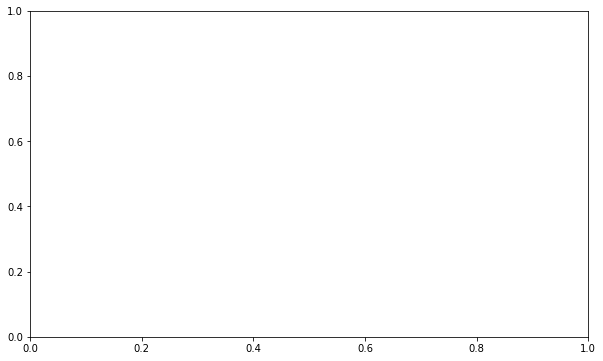

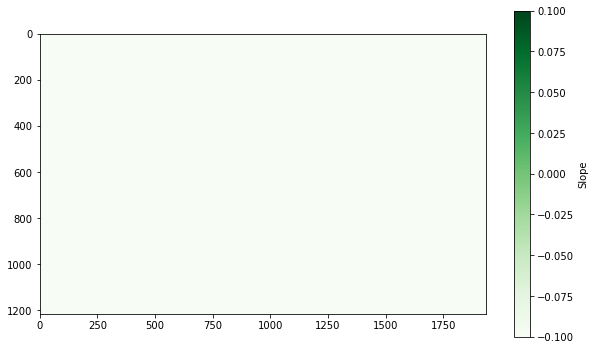

...

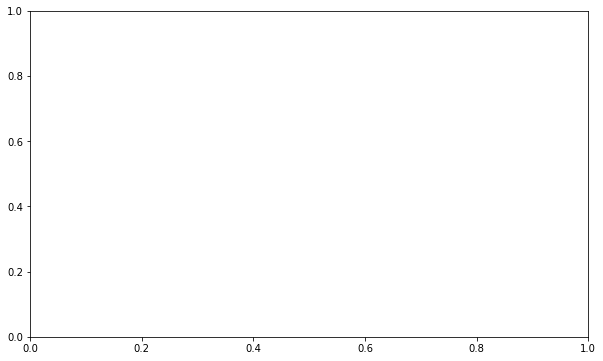

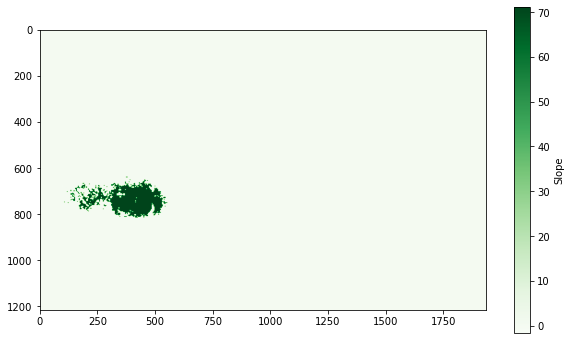

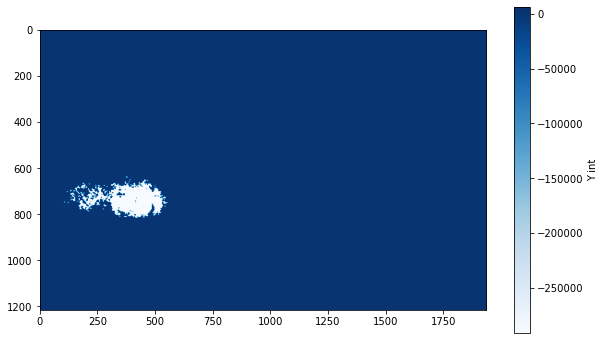

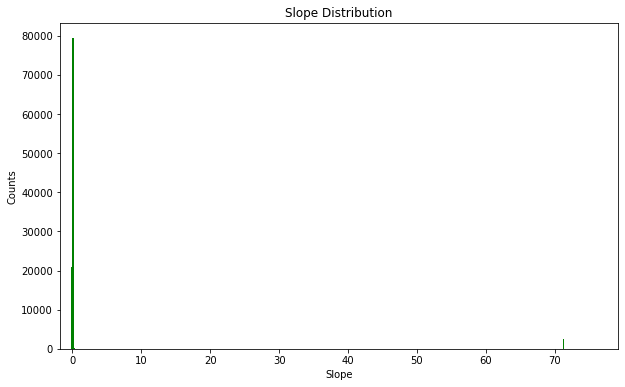

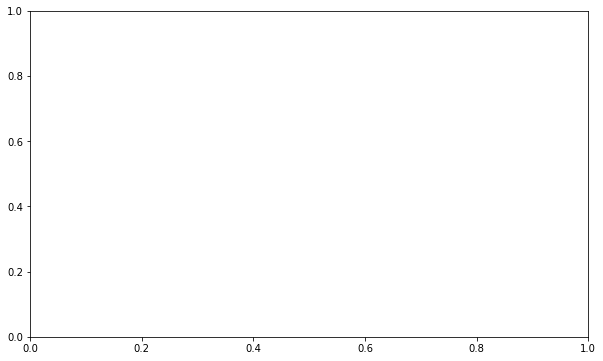

In [16]:
store_slopes_no_filtering(scin_screen_events_pixel_by_pixel)

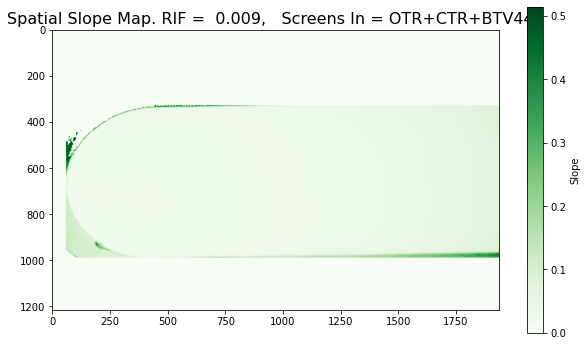

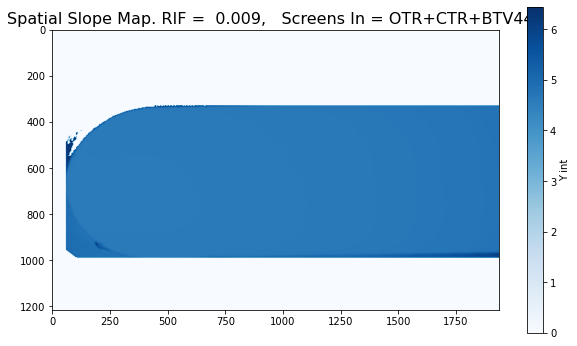

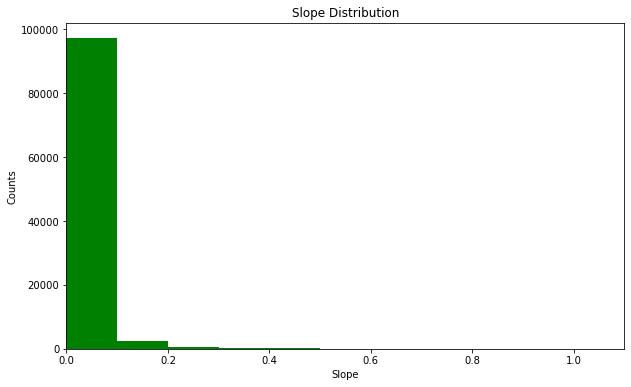

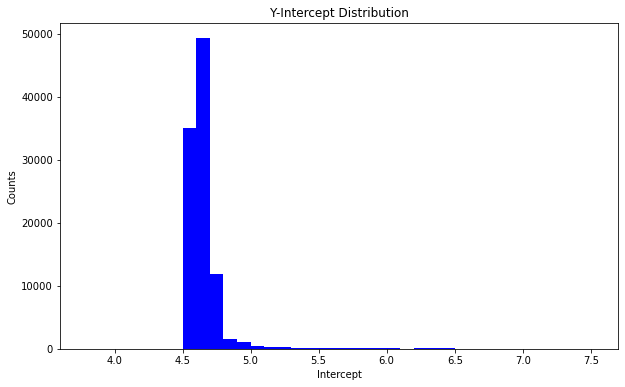

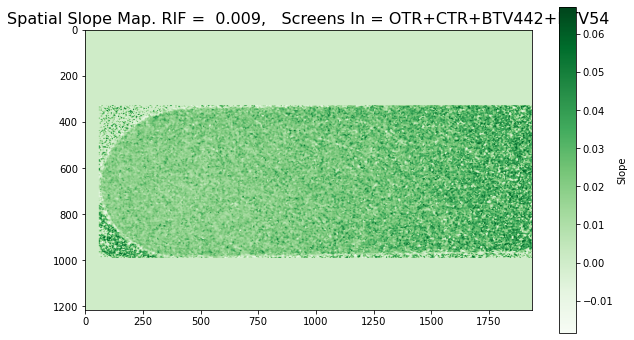

...

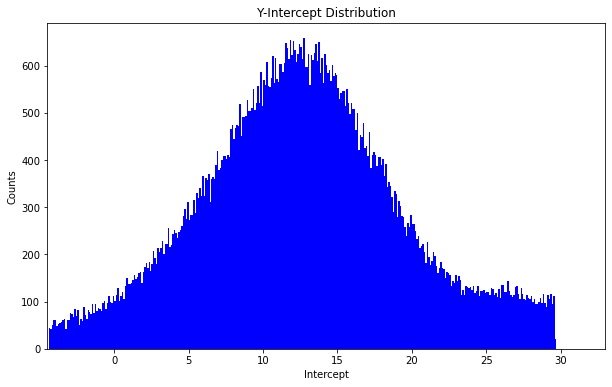

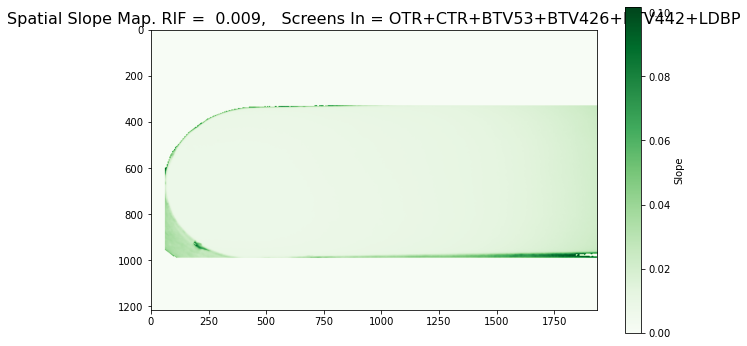

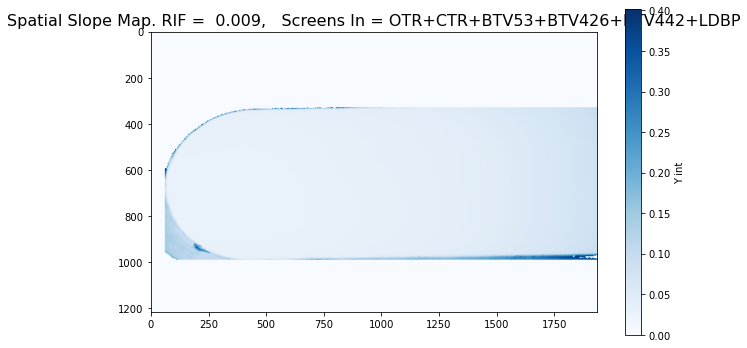

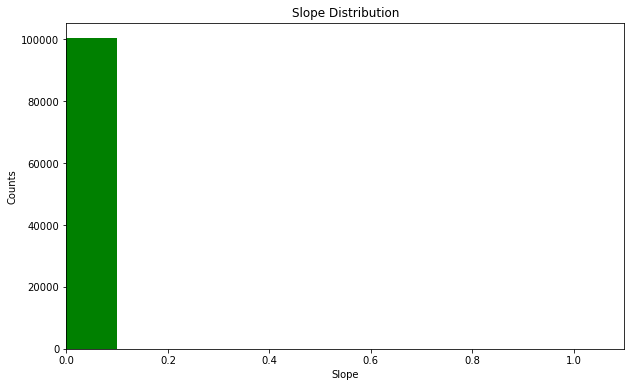

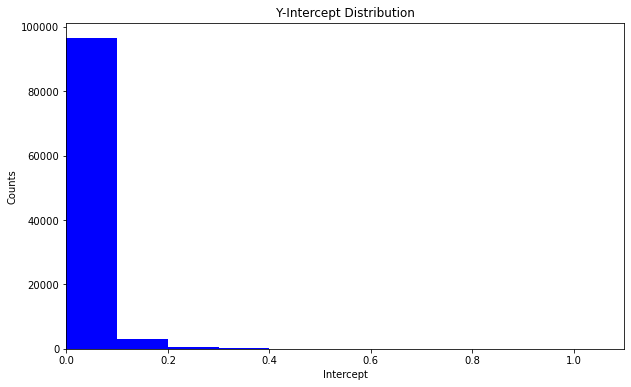

/tmp/ipykernel_458/1964412611.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


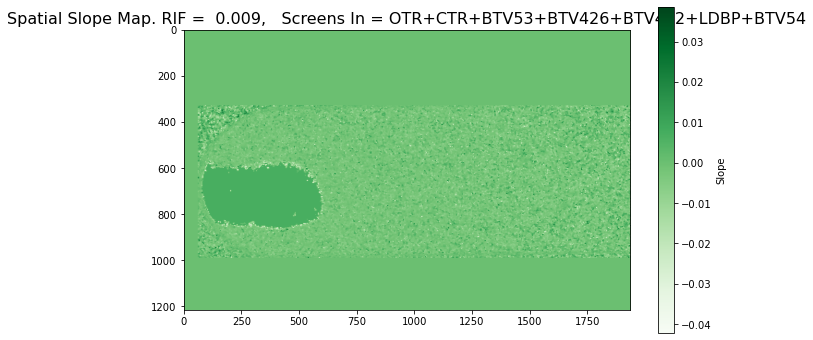

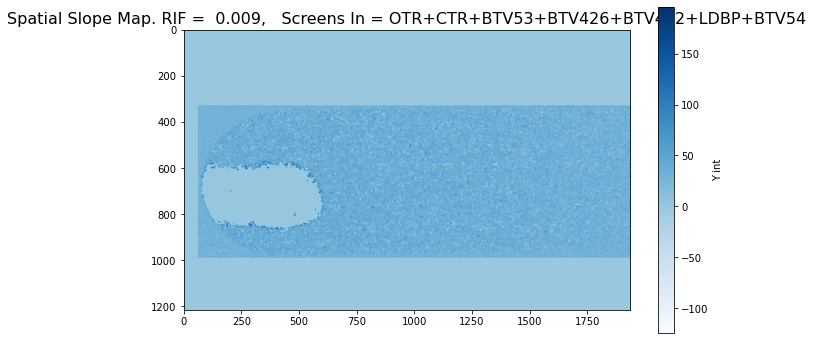

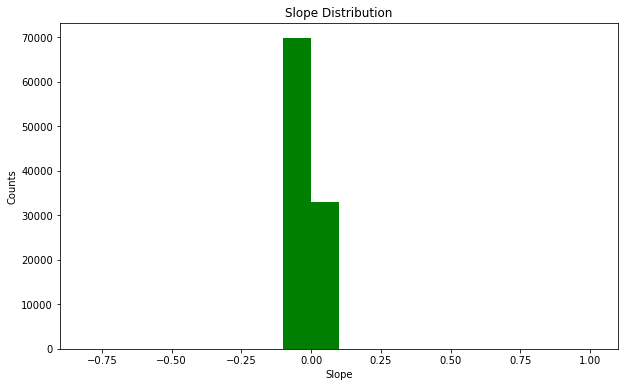

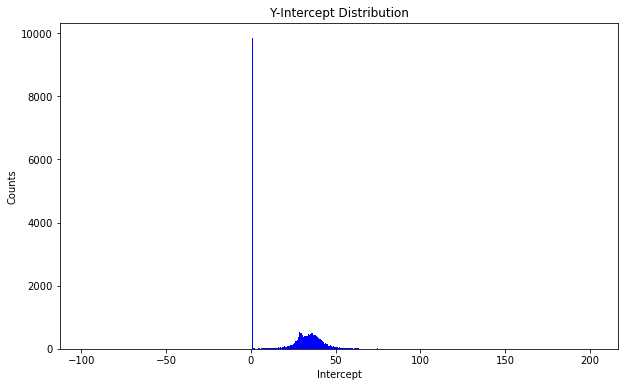

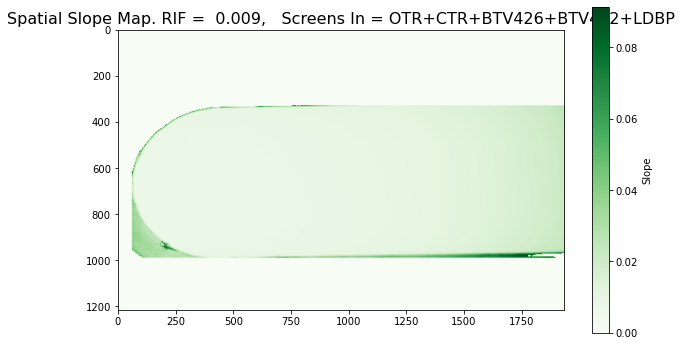

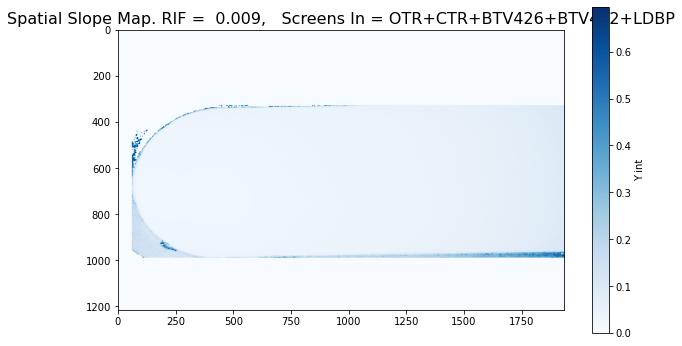

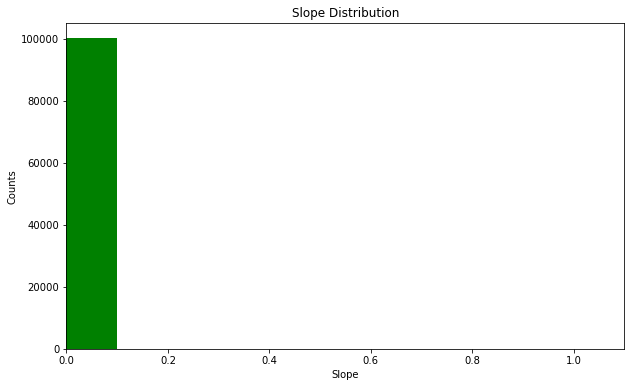

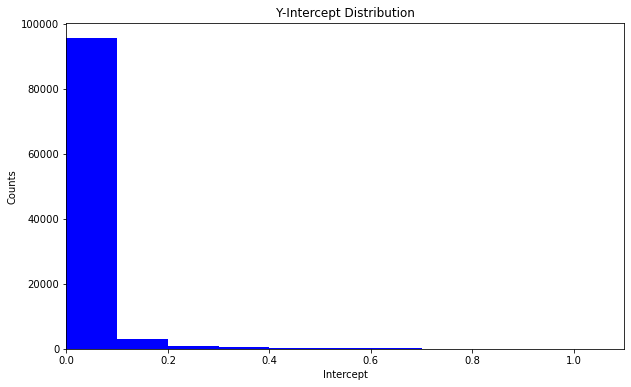

/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:206: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in divide
  arrmean = um.true_divide(arrmean, div, out=arrmean,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:198: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Error
Error


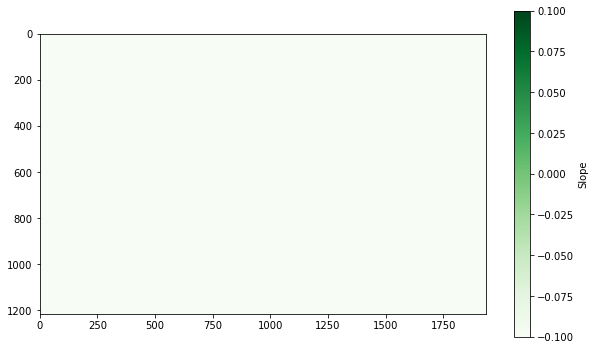

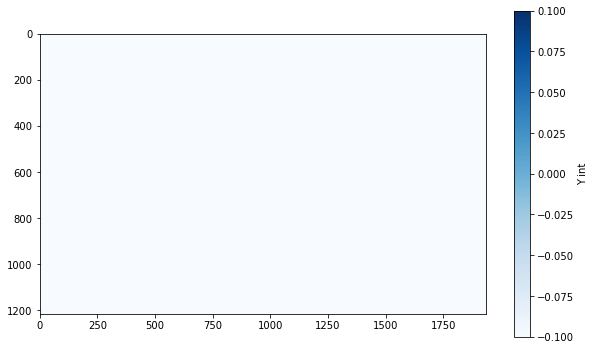

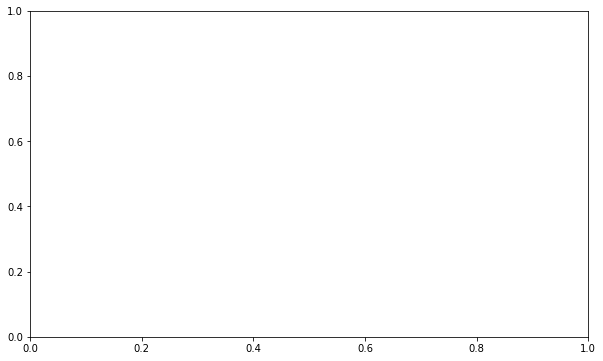

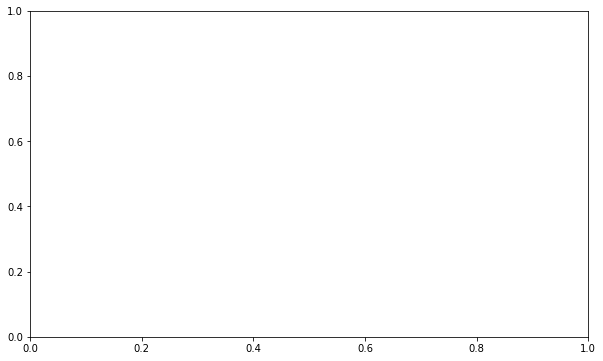

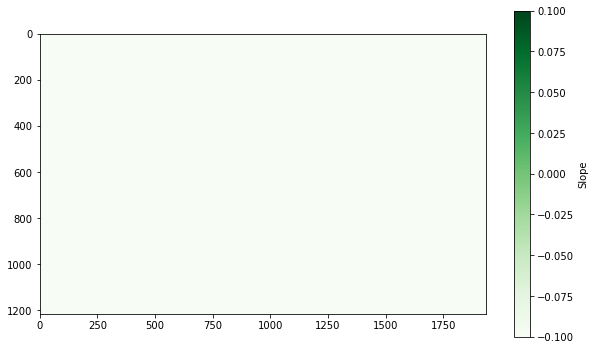

...

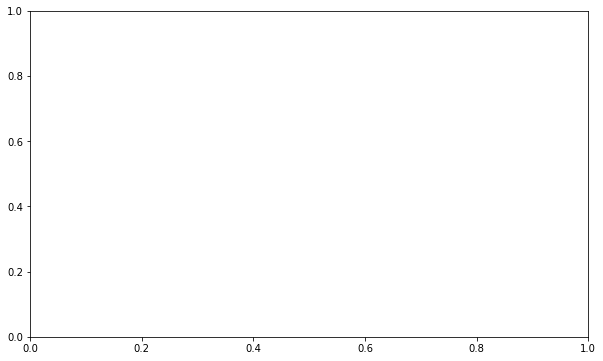

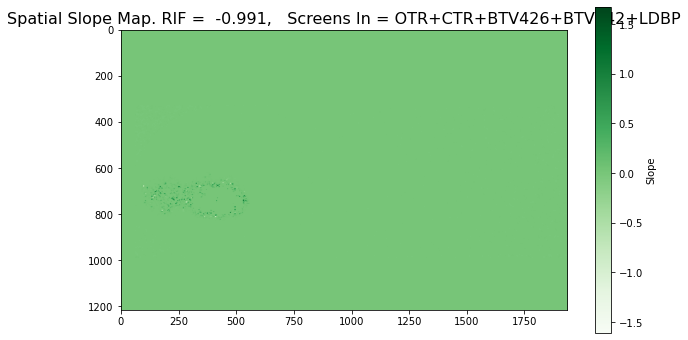

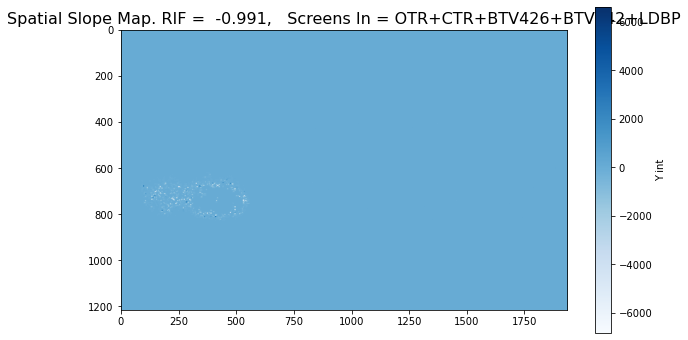

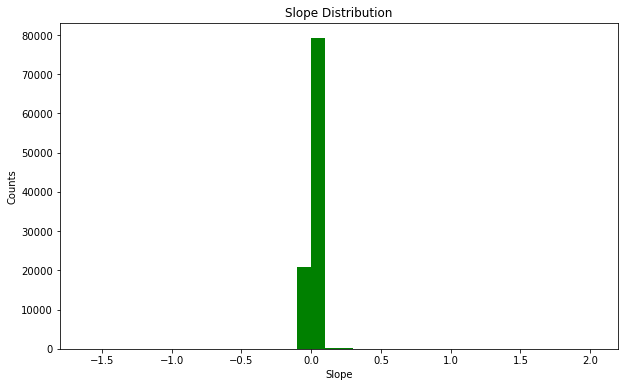

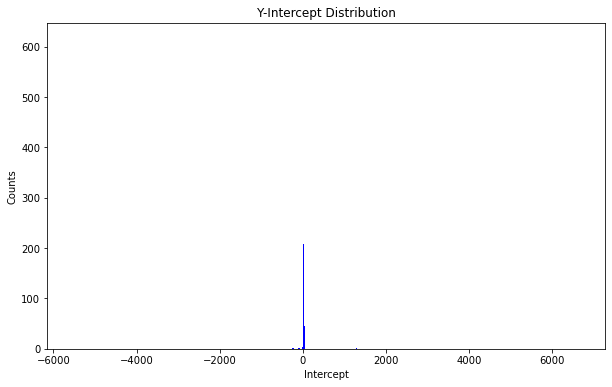

In [18]:
store_slopes_std_filtering(scin_screen_events_pixel_by_pixel)

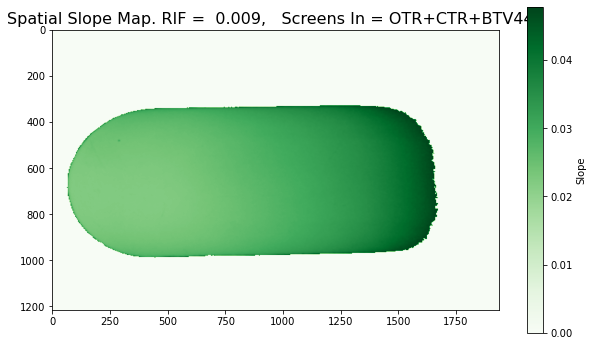

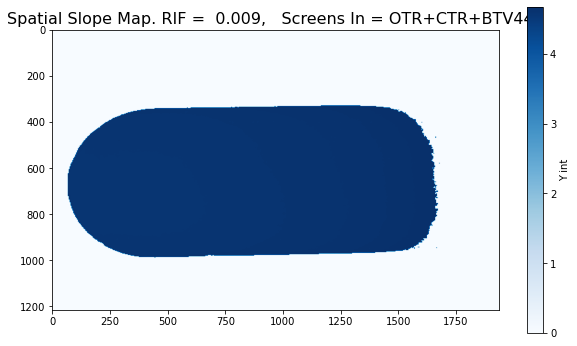

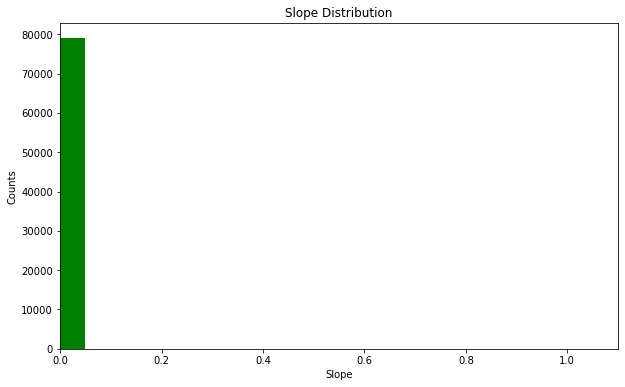

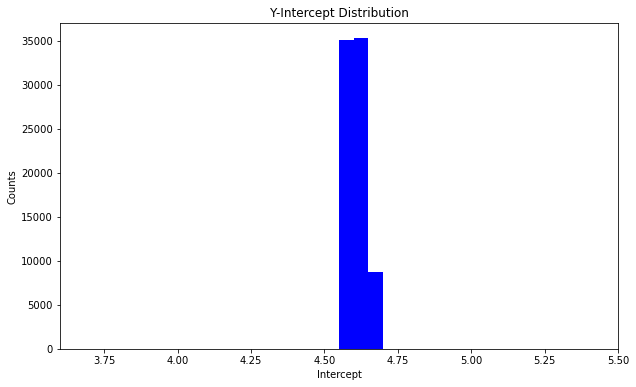

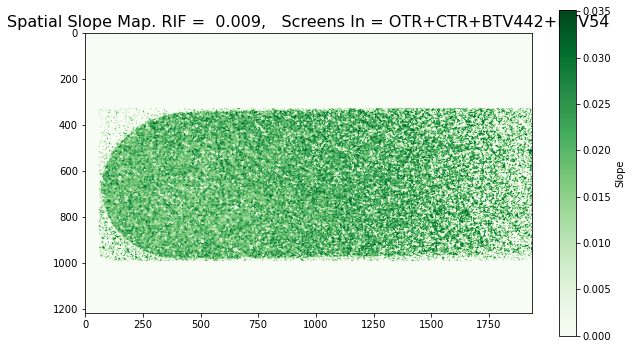

...

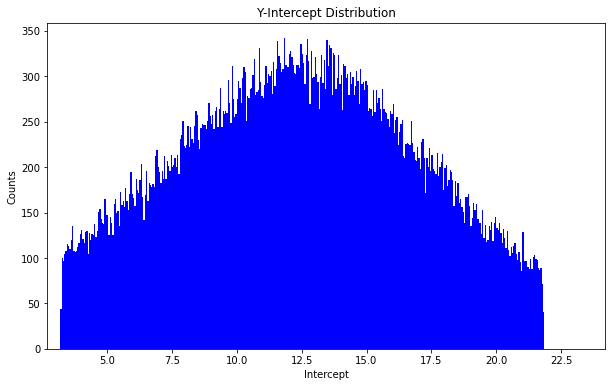

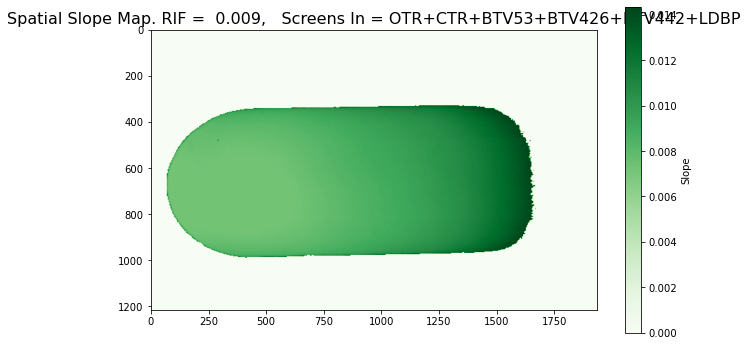

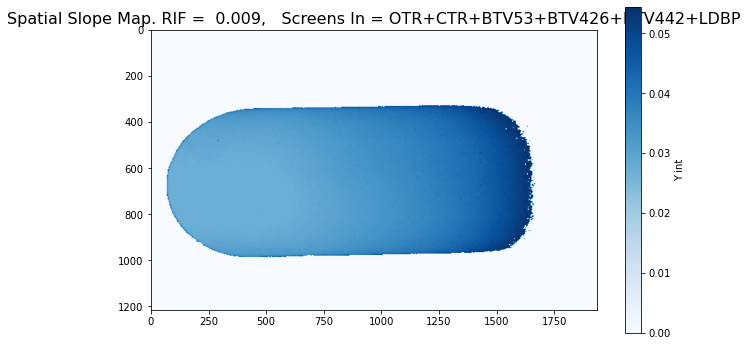

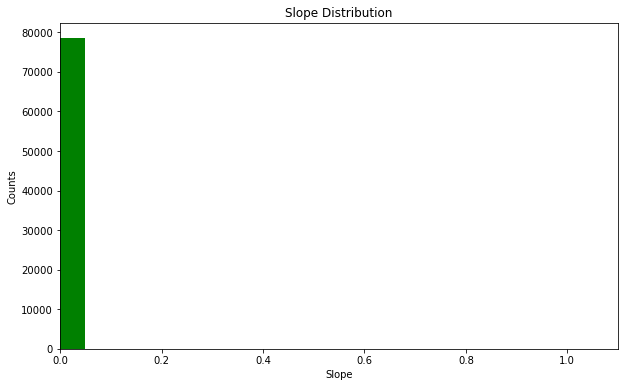

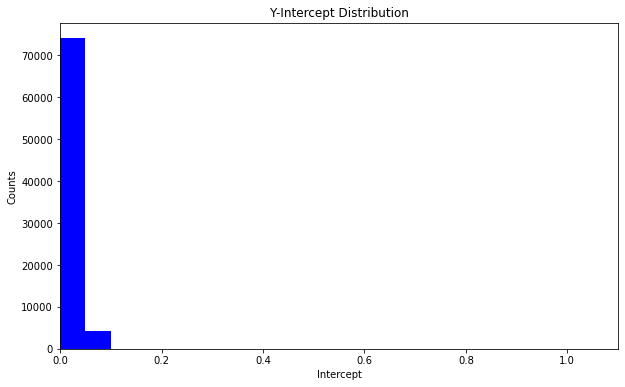

/tmp/ipykernel_458/408449721.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


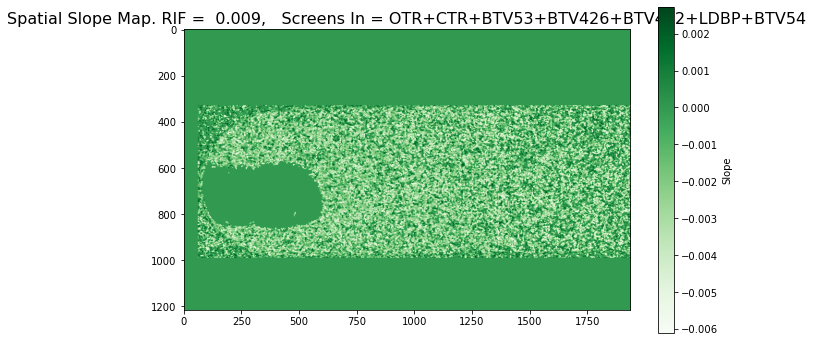

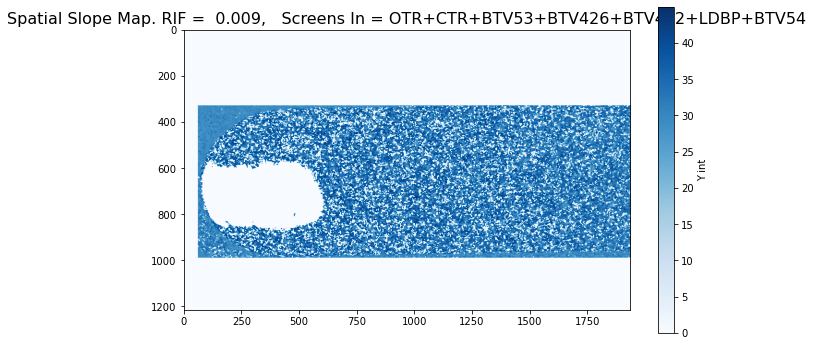

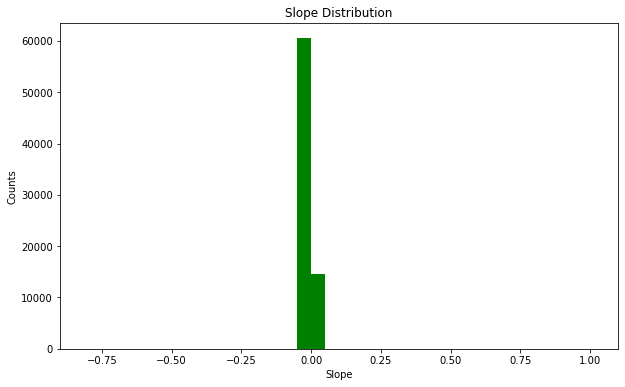

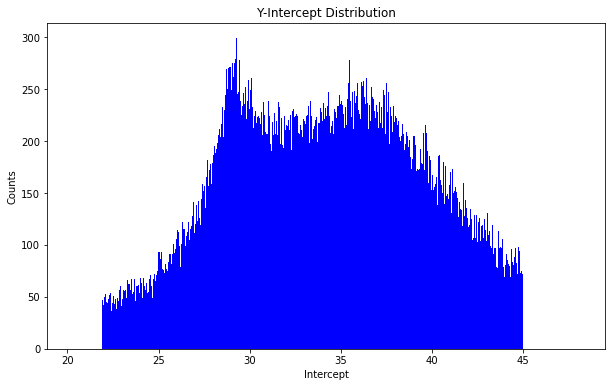

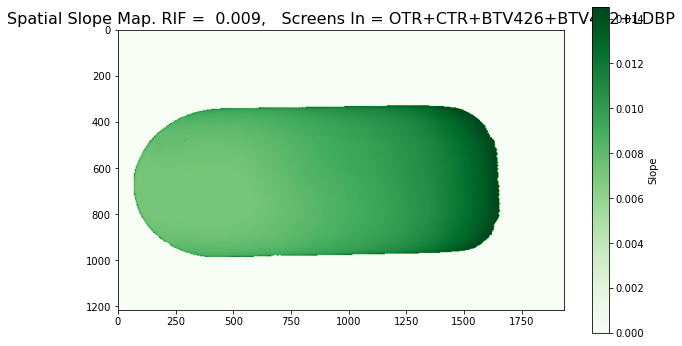

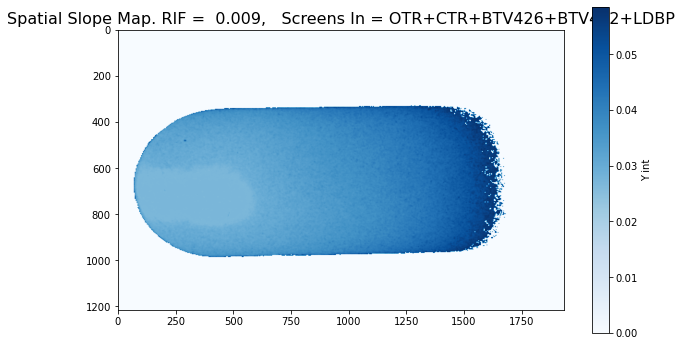

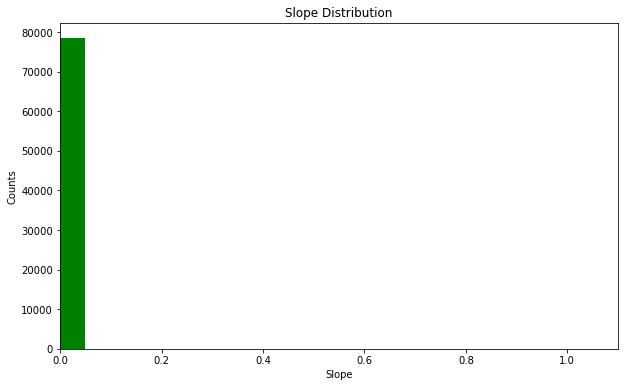

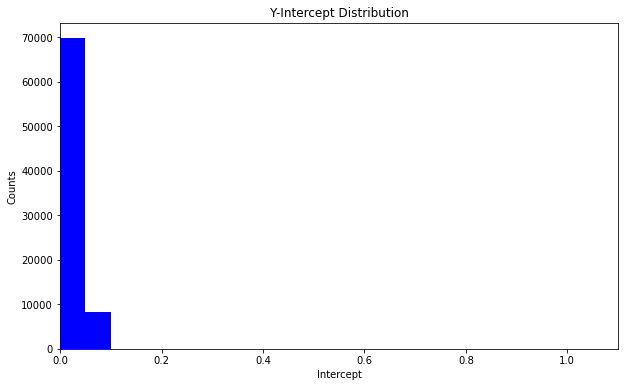

/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/cvmfs/sft.cern.ch/lcg/views/LCG_107_swan/x86_64-el9-gcc13-opt/lib/python3.11/site-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Error
Error


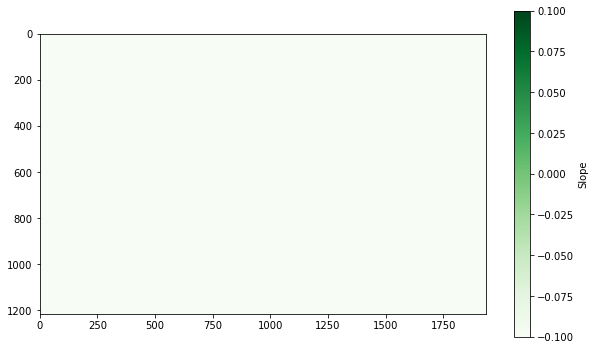

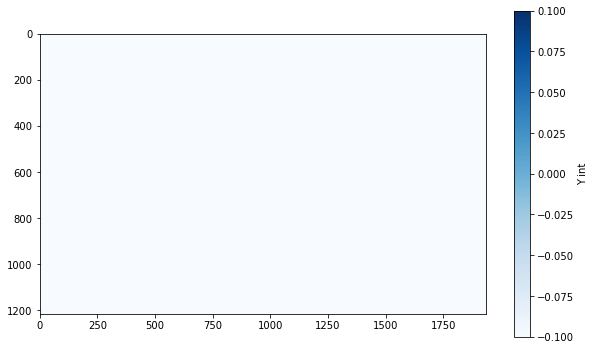

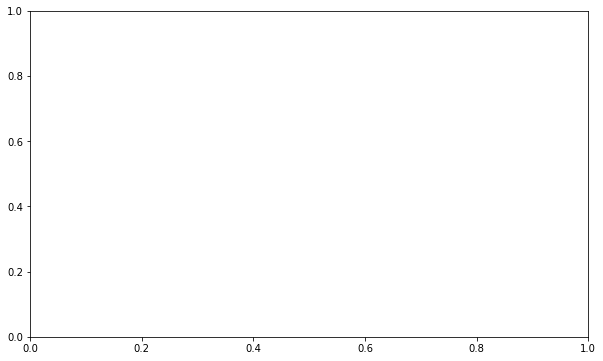

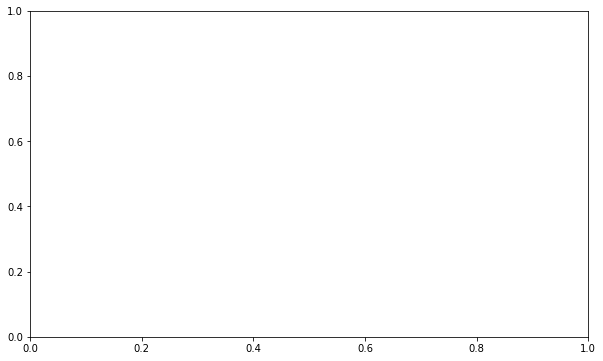

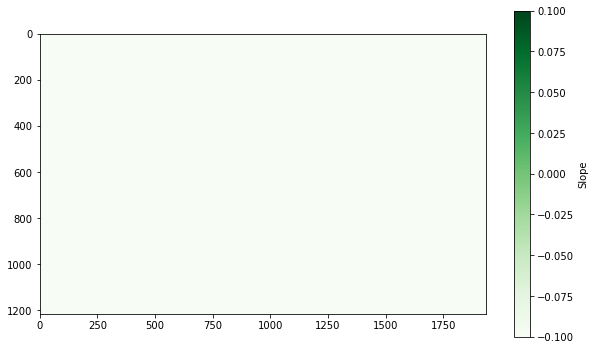

...

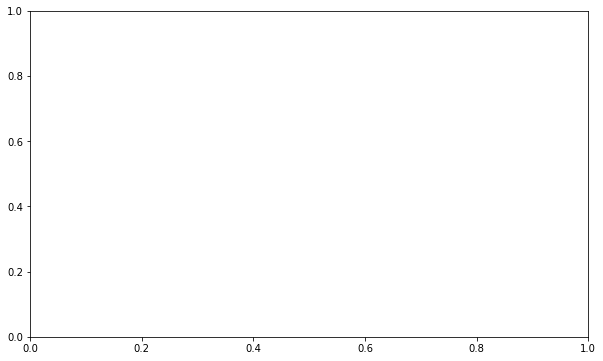

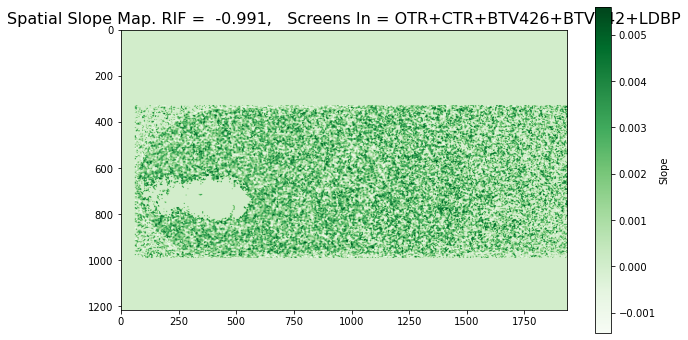

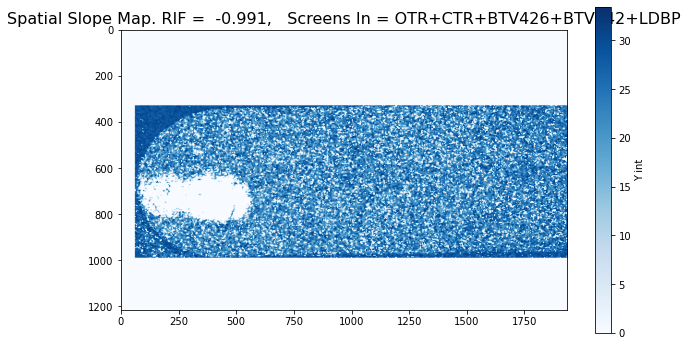

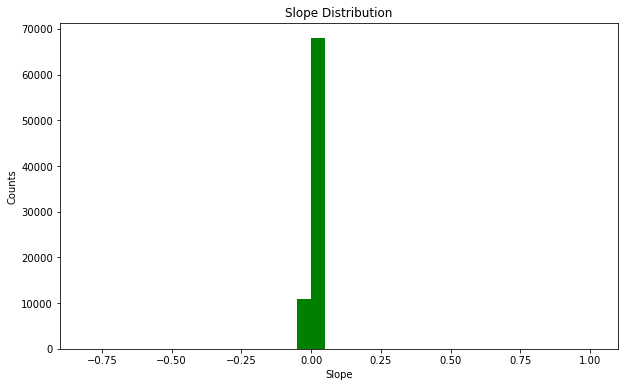

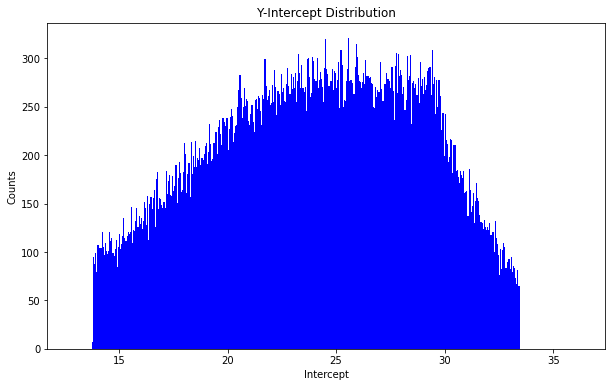

In [17]:
store_slopes_mad_filtering(scin_screen_events_pixel_by_pixel)

# Try for 220 by 469 for 16/05

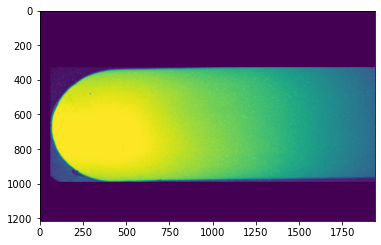

In [39]:
y_step = int(660/220)
x_step = int(1876/469)    
    
list_indices_y = list(range(330, 990, y_step))
list_indices_x = list(range(60, 1936, x_step))

results = []
list_means= []
intensity_grid = np.zeros((1216, 1936))

for i in list_indices_y:
    for j in list_indices_x:        
        sliced_data = ex_data[i:i+y_step,j:j+x_step]
        
        block_mean = np.mean(sliced_data)
        list_means.append(block_mean)
        
        intensity_grid[i:i+y_step, j:j+x_step] = block_mean       
        
#print(intensity_grid[8:16,11:22])
#print(list_means)
plt.imshow(intensity_grid)

In [ ]:
## 17/05 220*469

In [35]:
scin_screen_events_pixel_220_469_16 = sort_by_space_scin_screen(220,469,100,'2025/05/16')

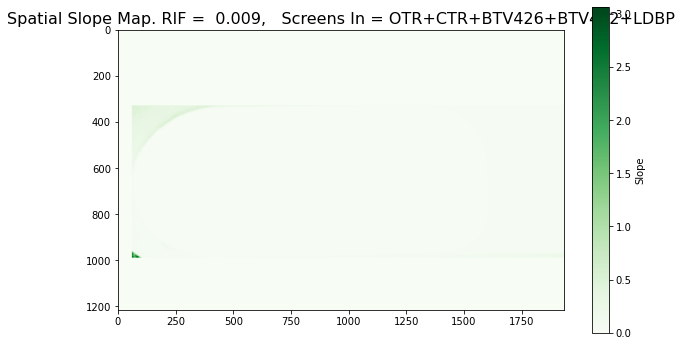

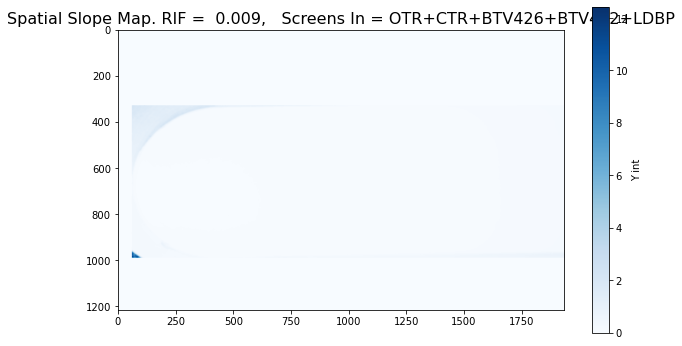

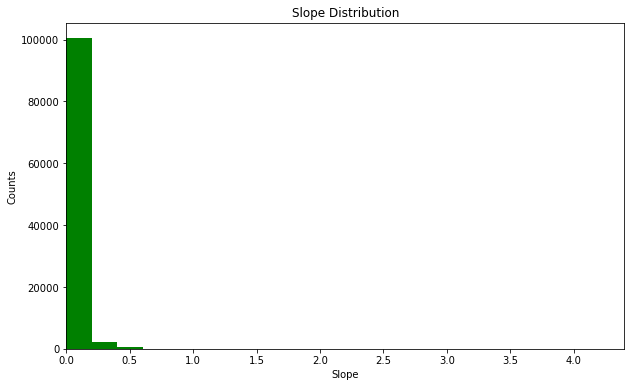

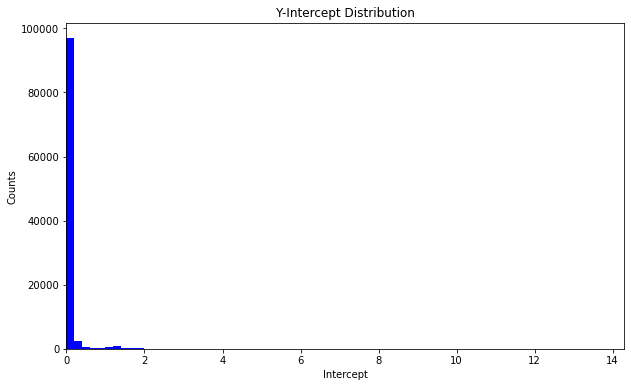

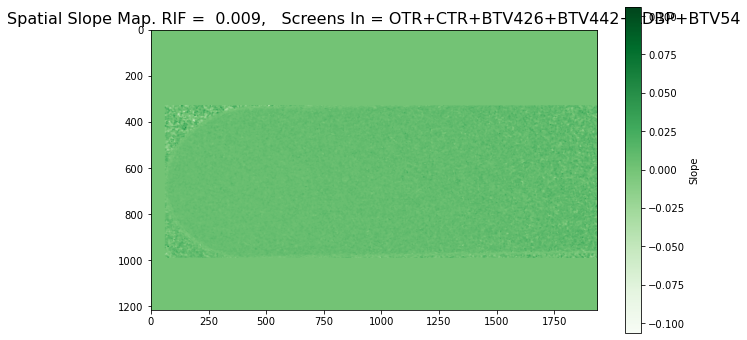

...

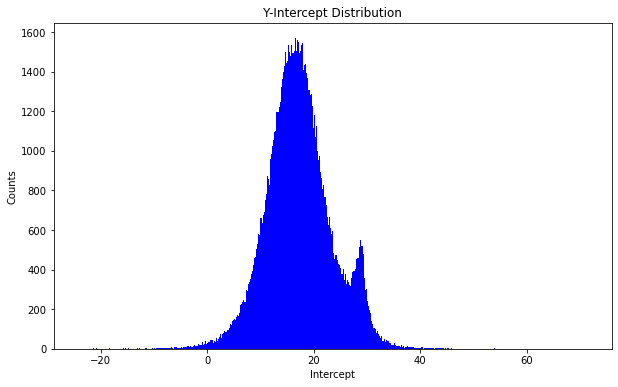

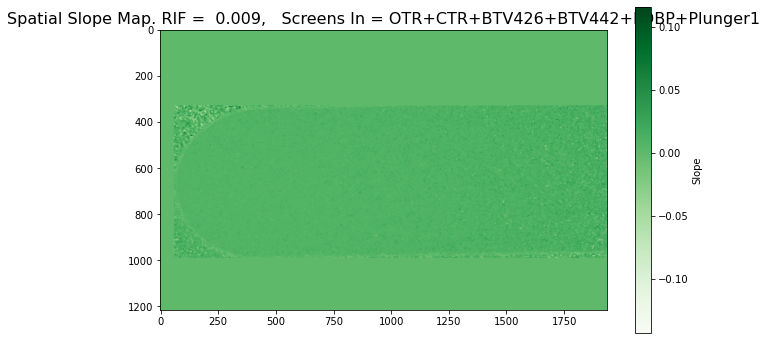

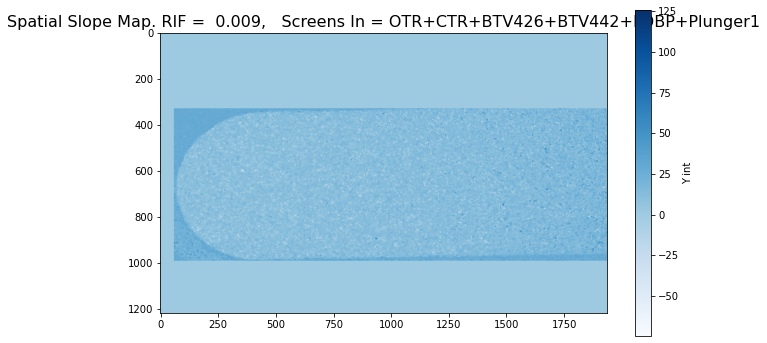

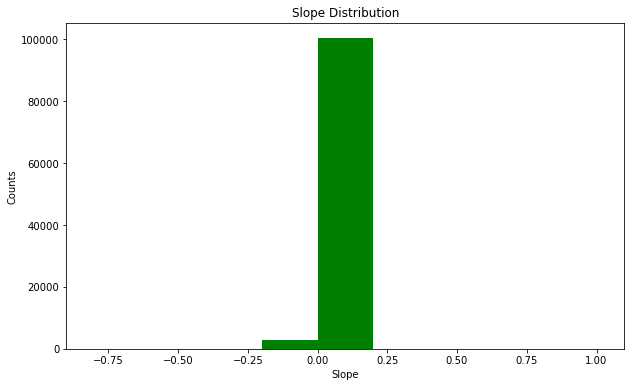

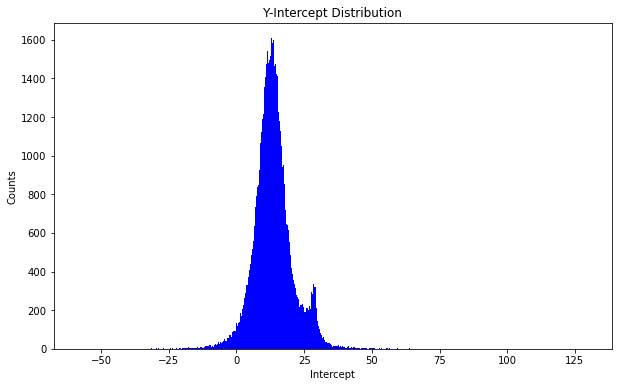

Error


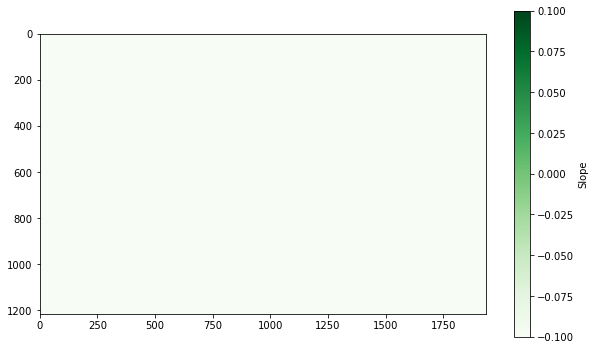

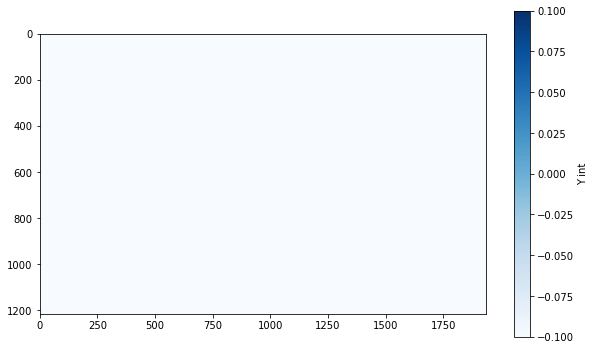

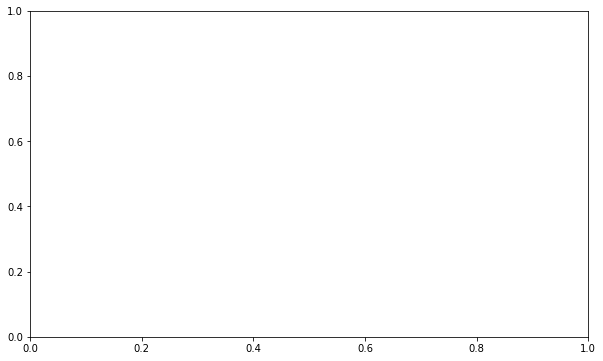

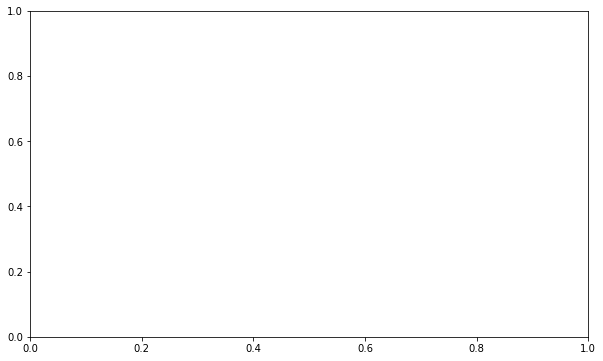

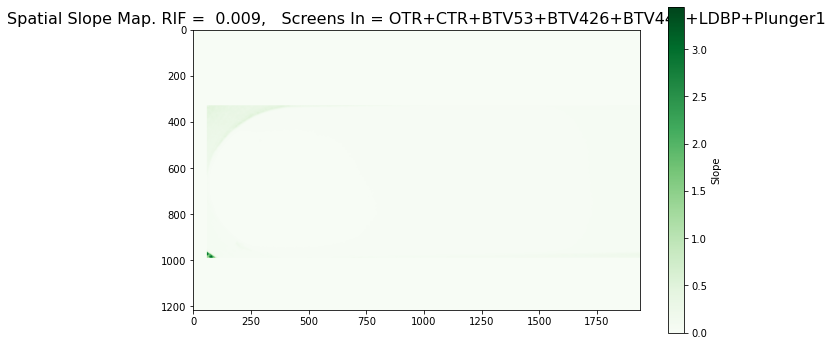

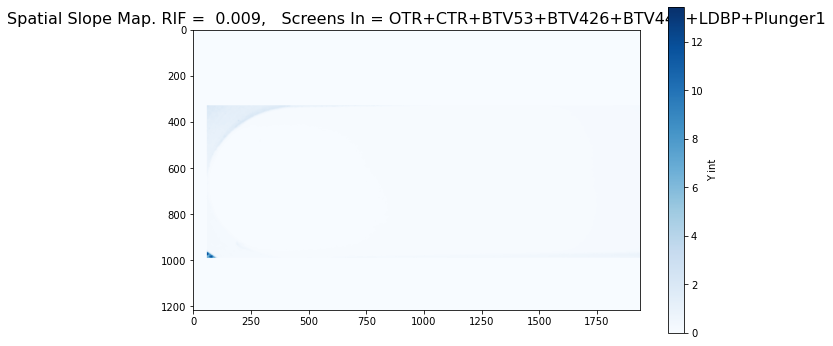

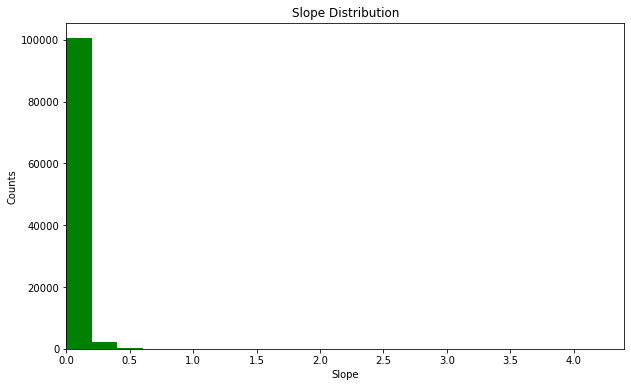

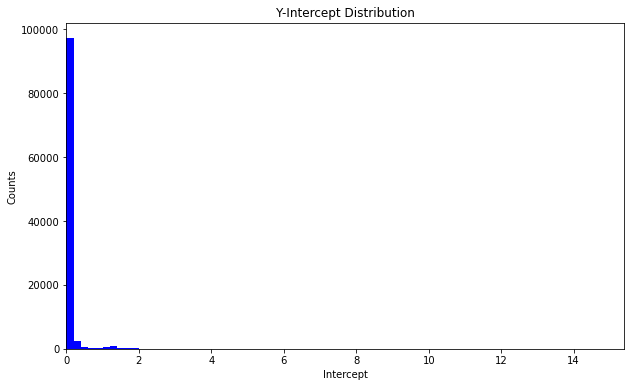

Error


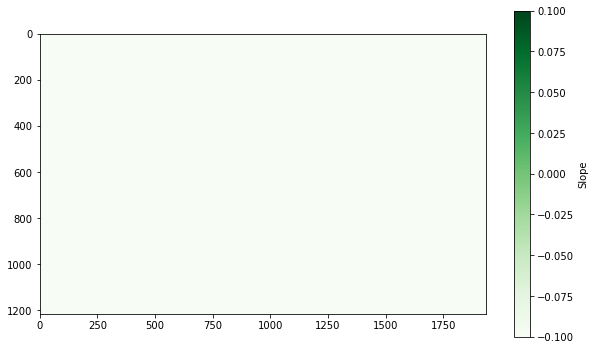

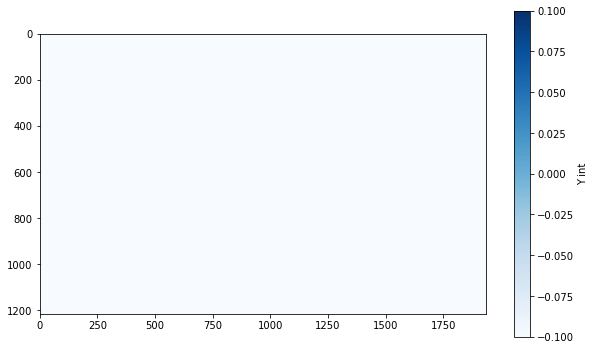

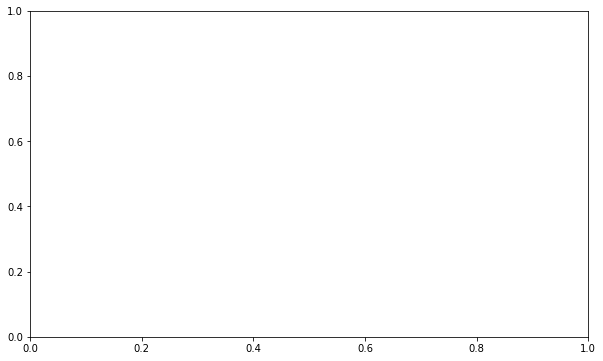

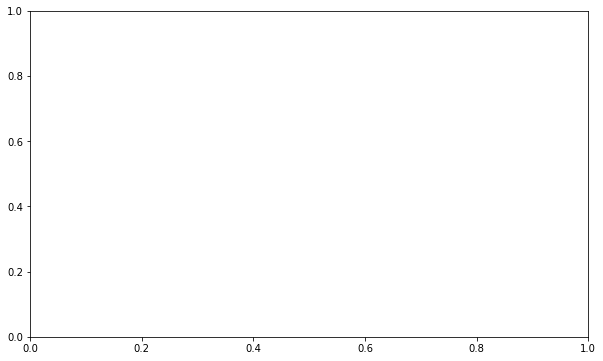

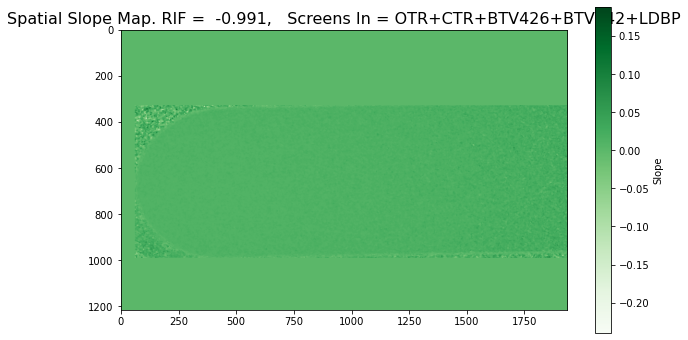

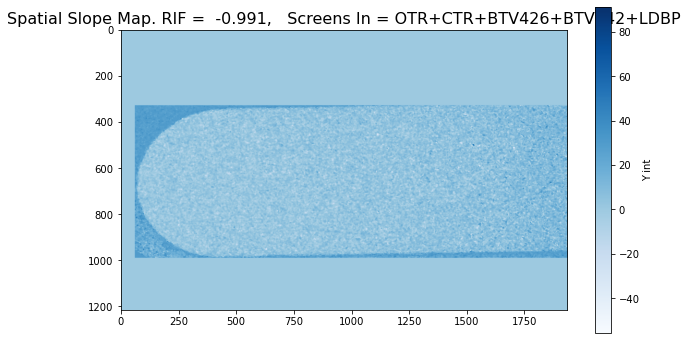

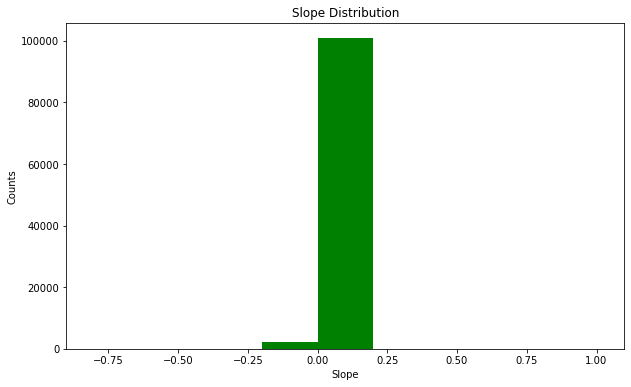

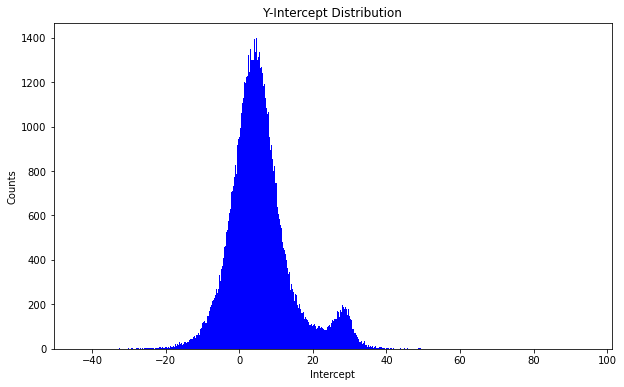

In [36]:
store_slopes_no_filtering(scin_screen_events_pixel_220_469_16)

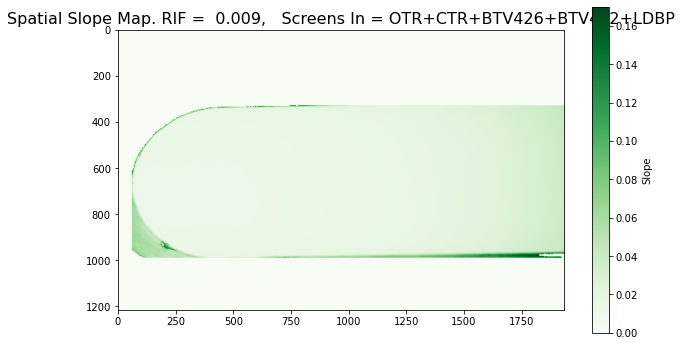

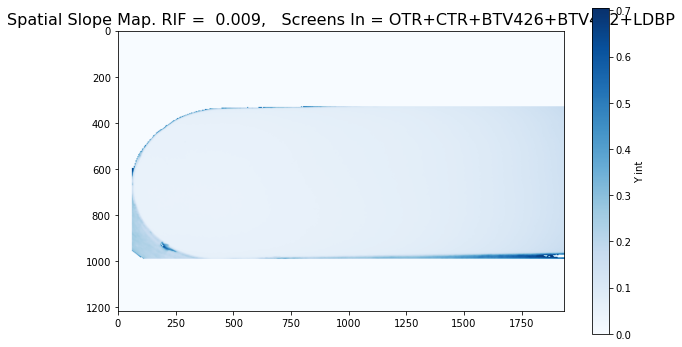

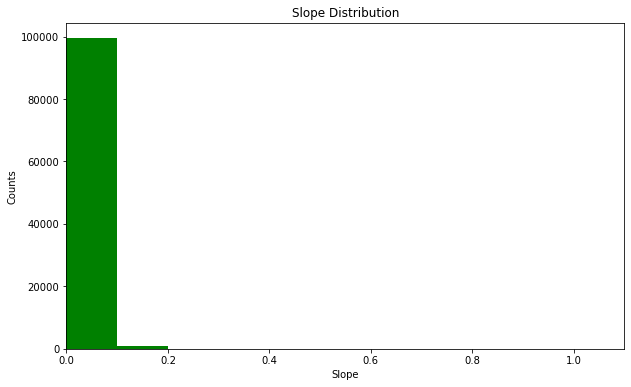

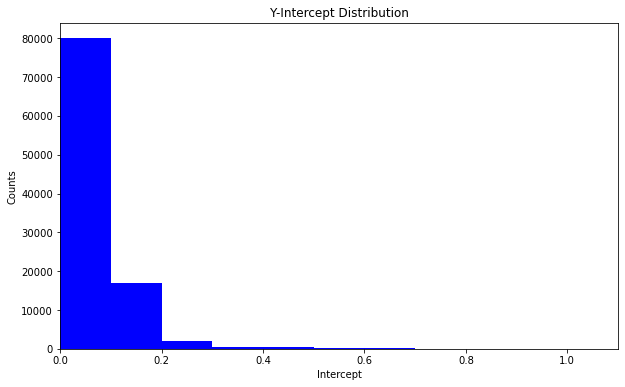

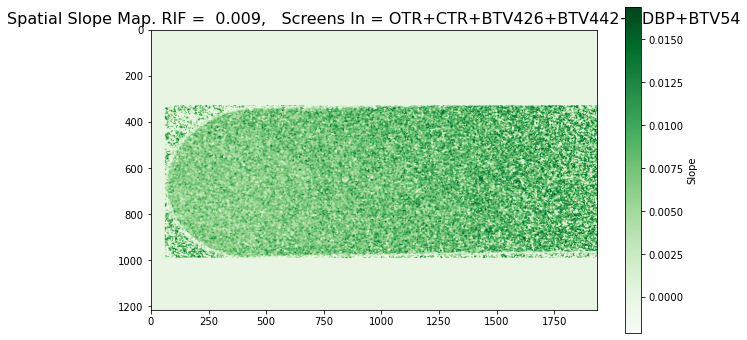

...

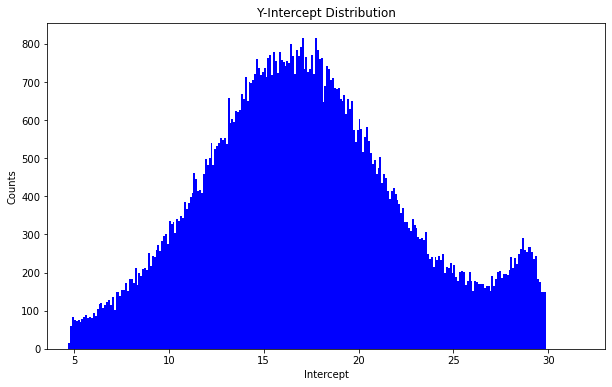

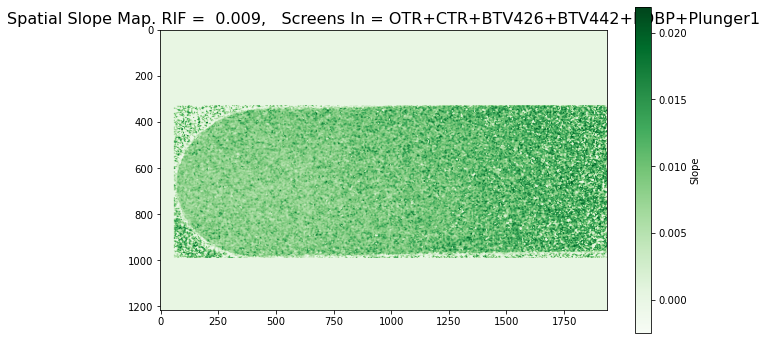

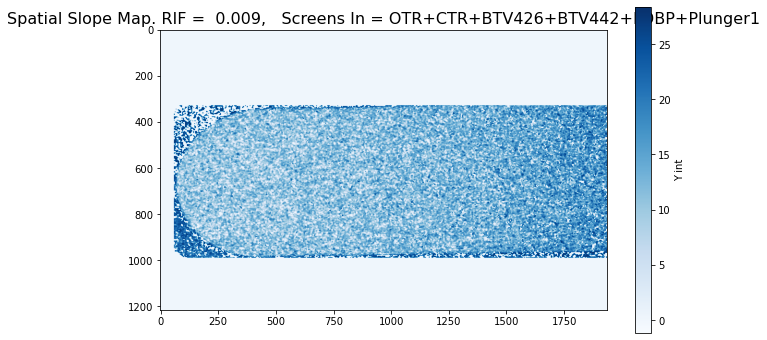

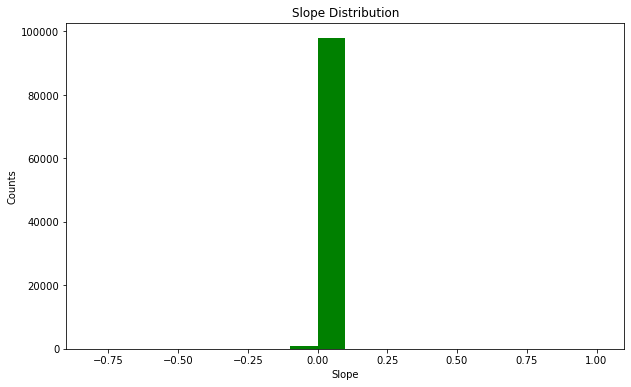

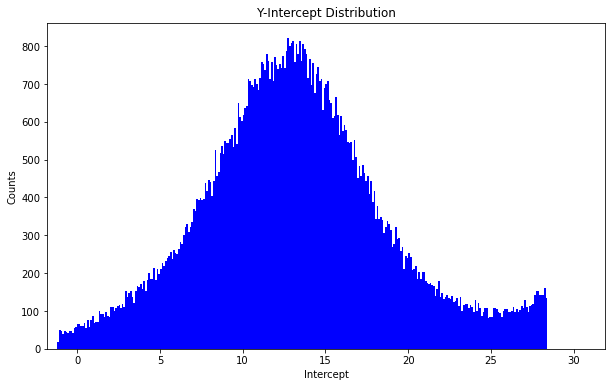

Error


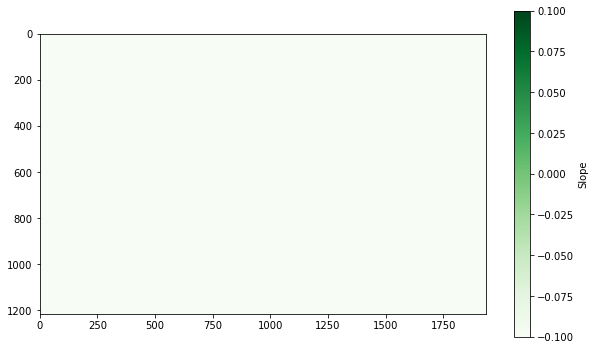

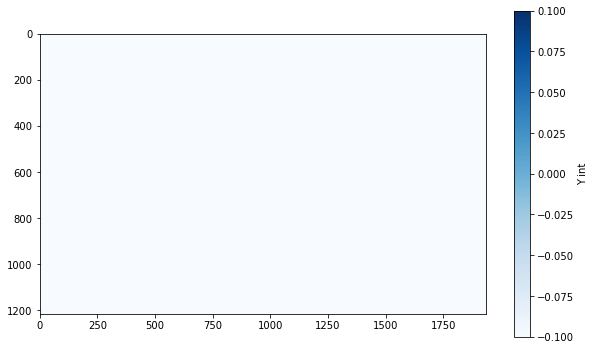

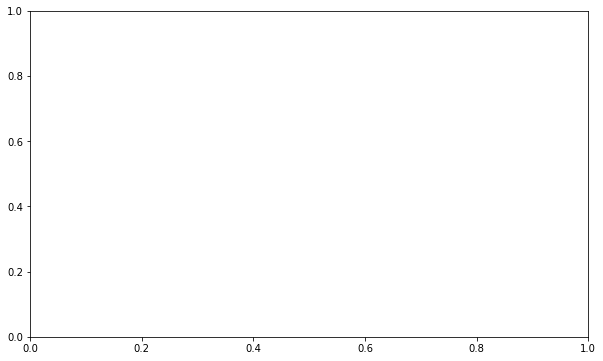

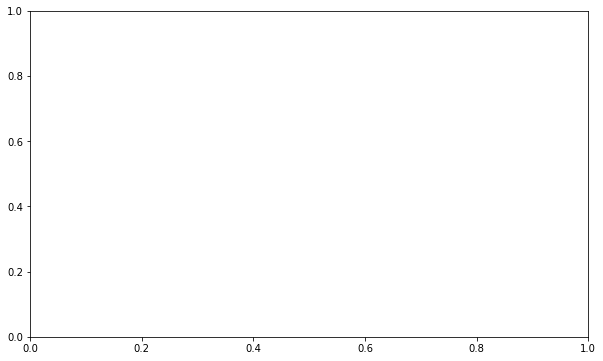

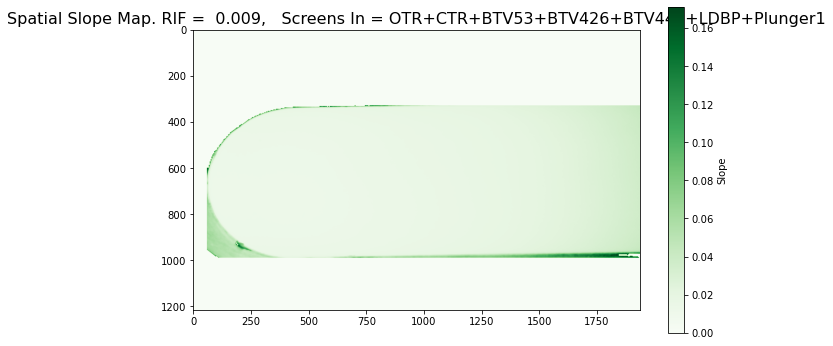

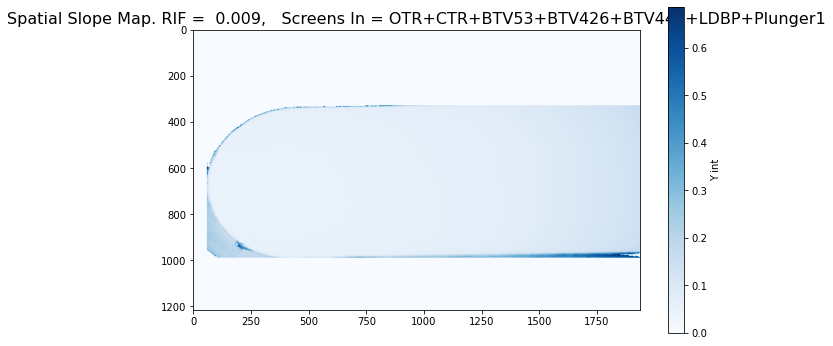

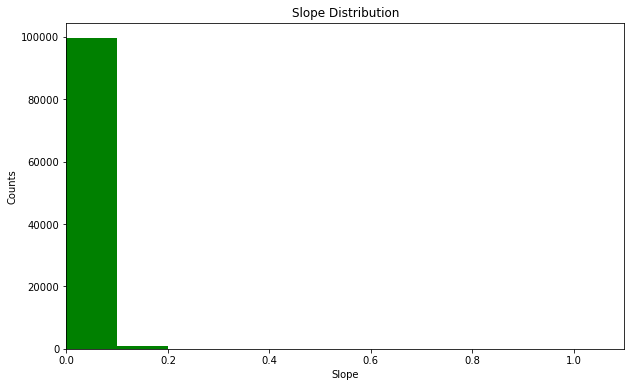

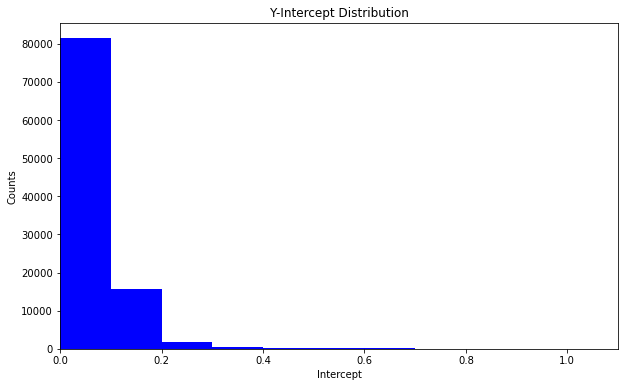

Error


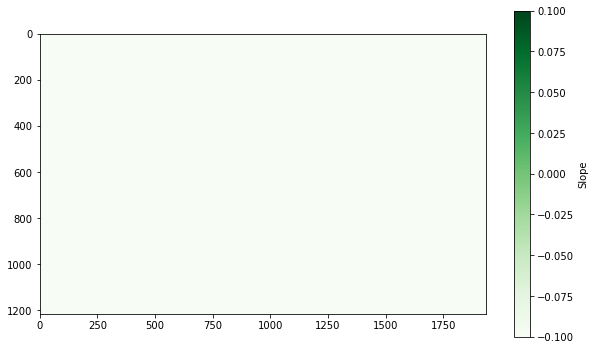

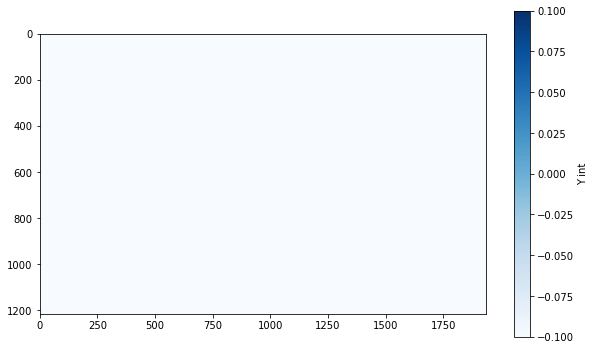

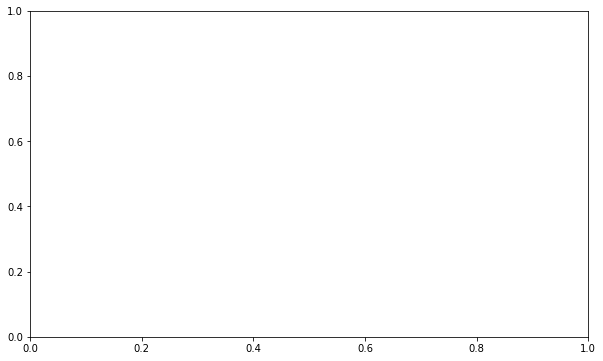

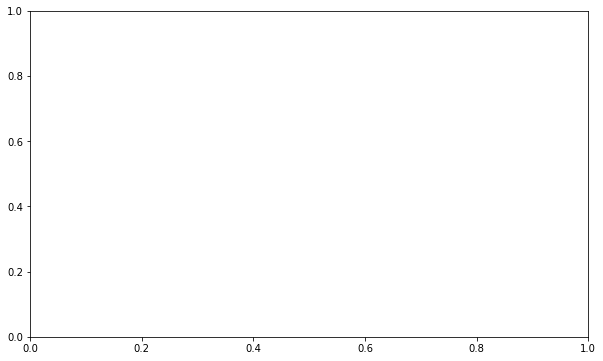

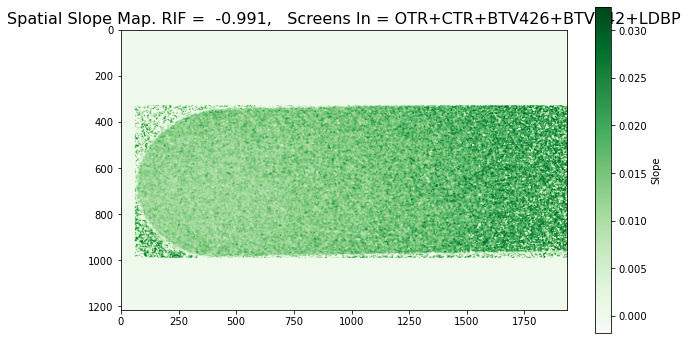

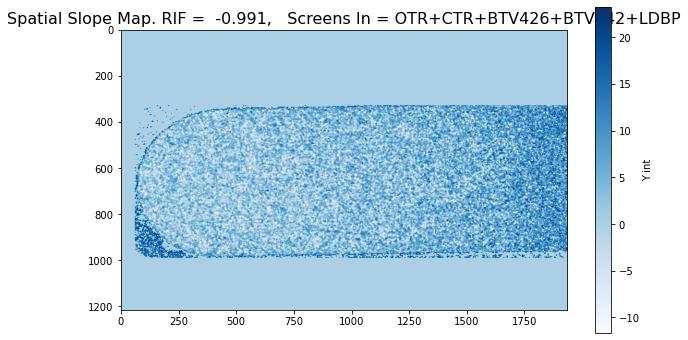

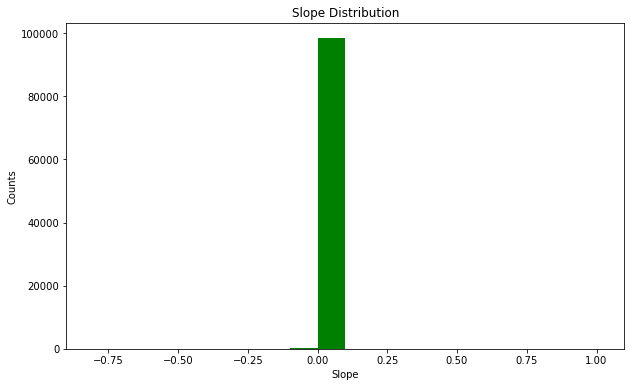

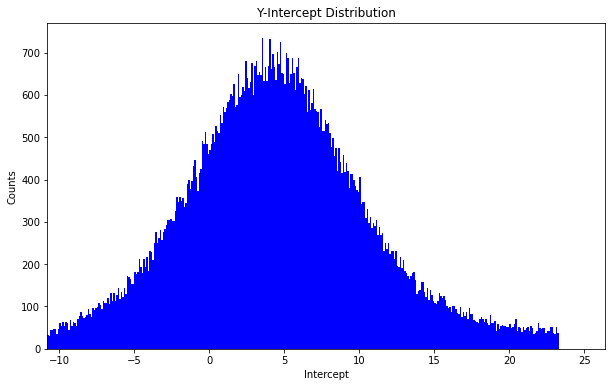

In [30]:
store_slopes_std_filtering(scin_screen_events_pixel_220_469_16)

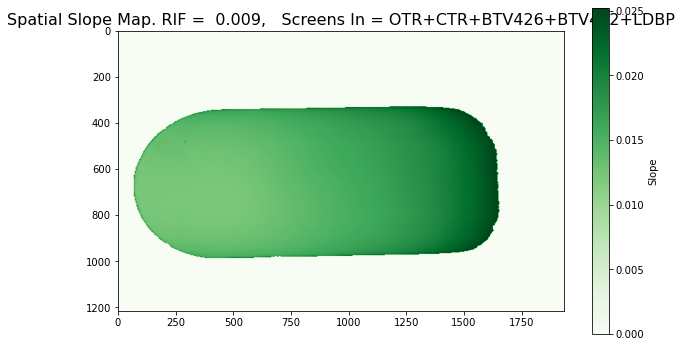

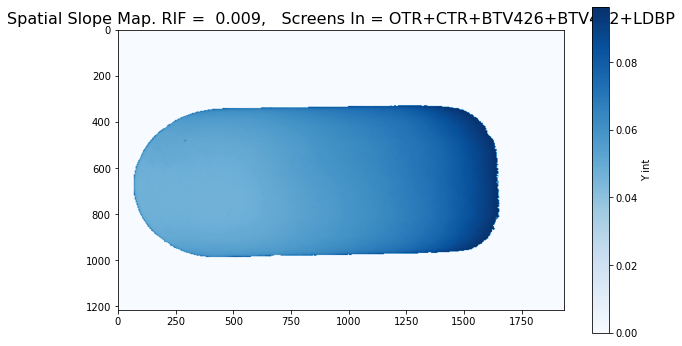

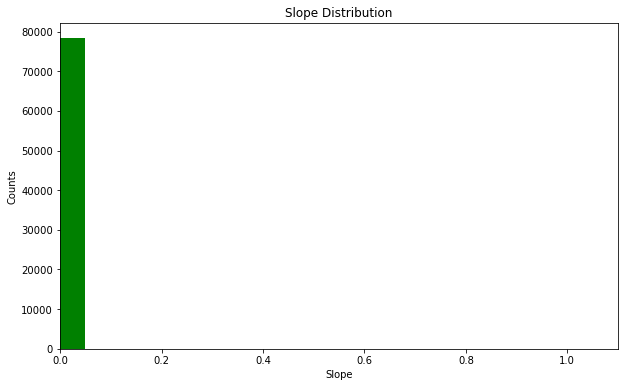

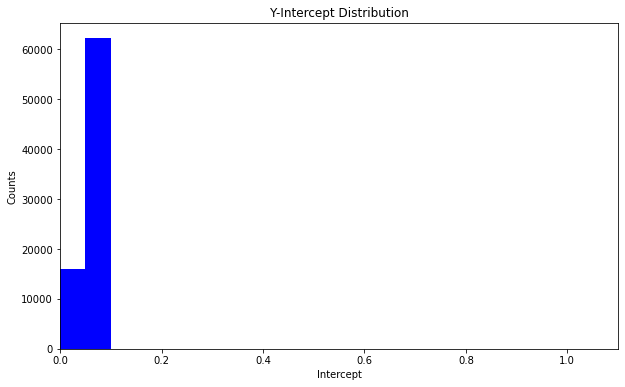

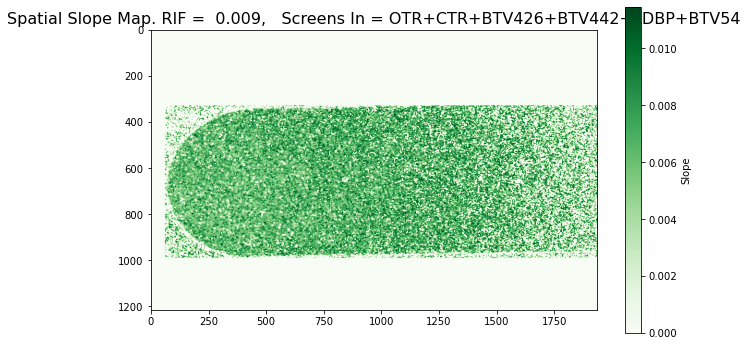

...

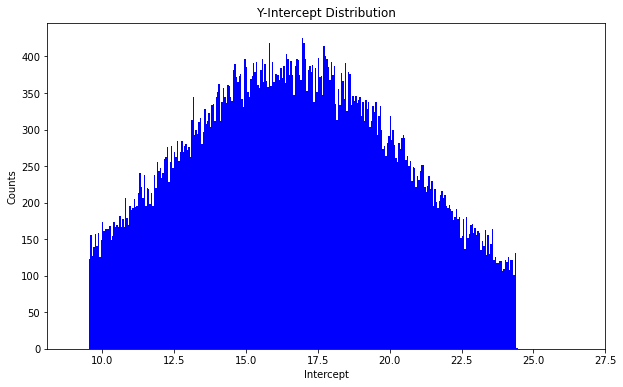

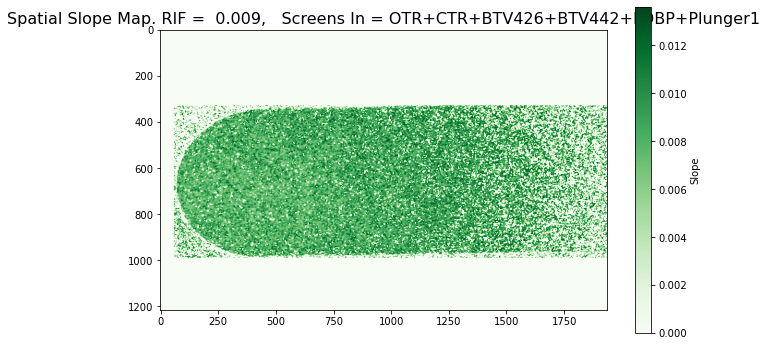

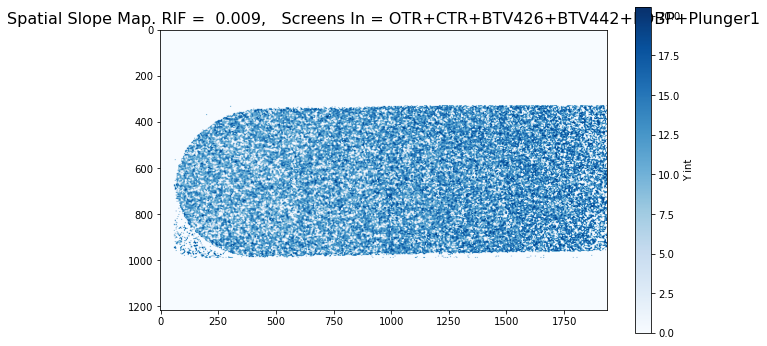

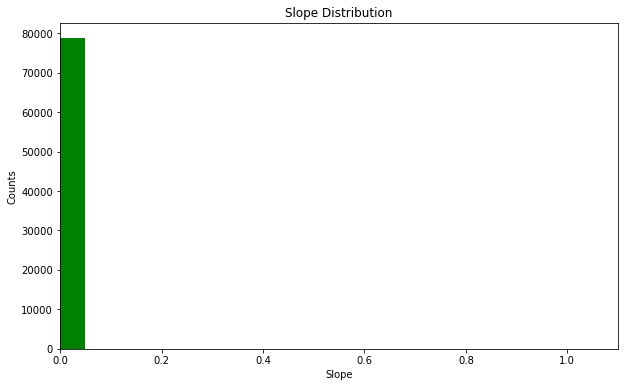

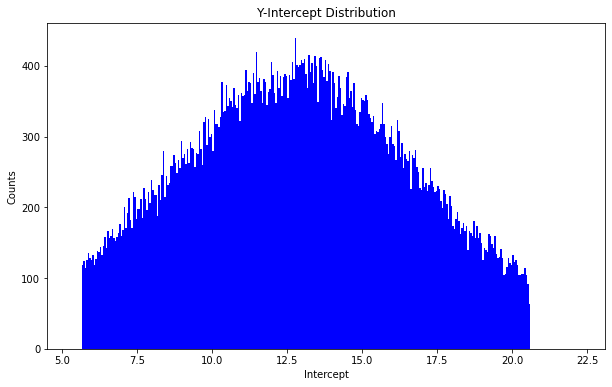

Error


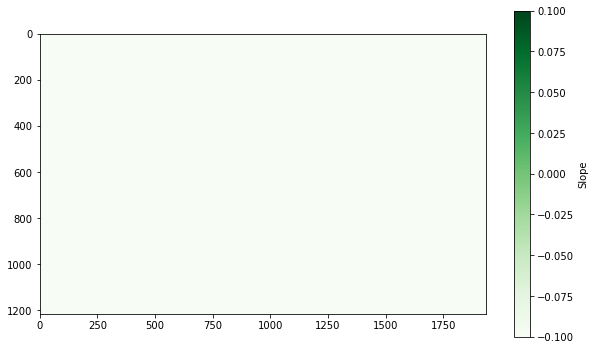

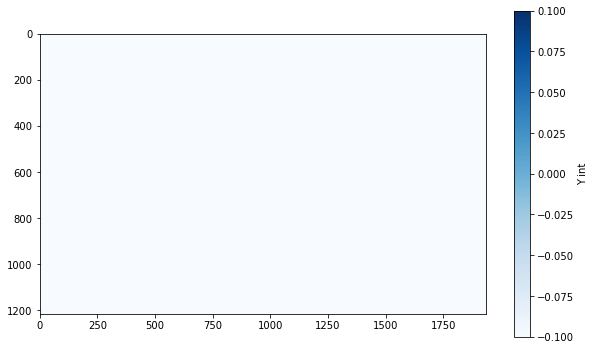

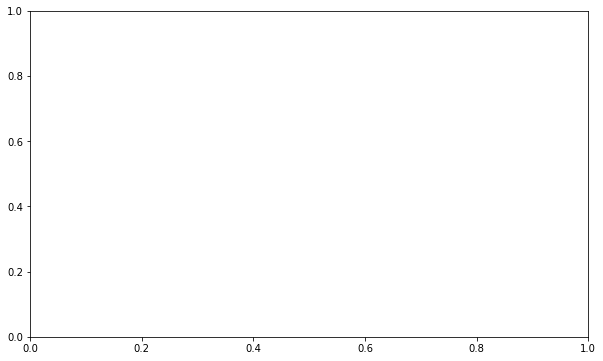

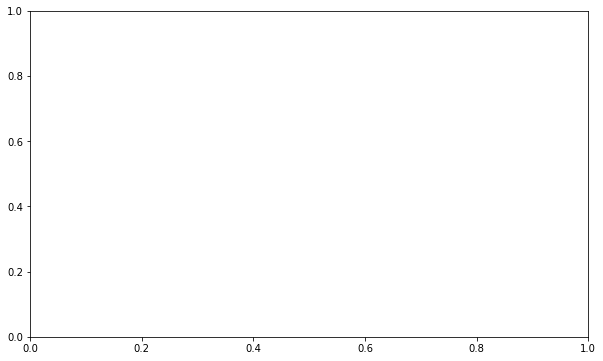

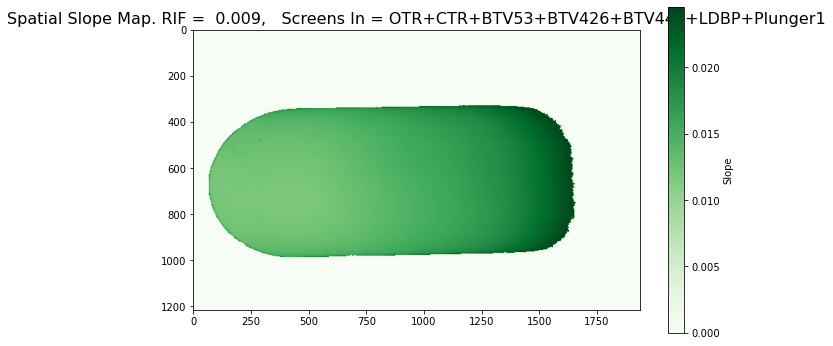

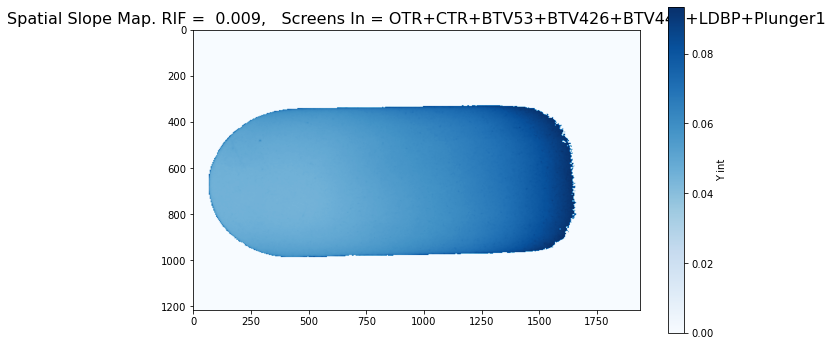

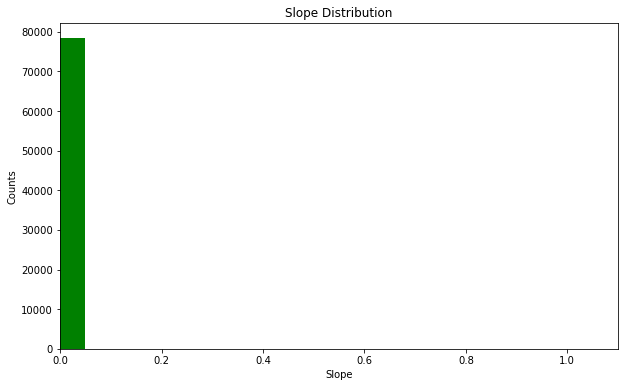

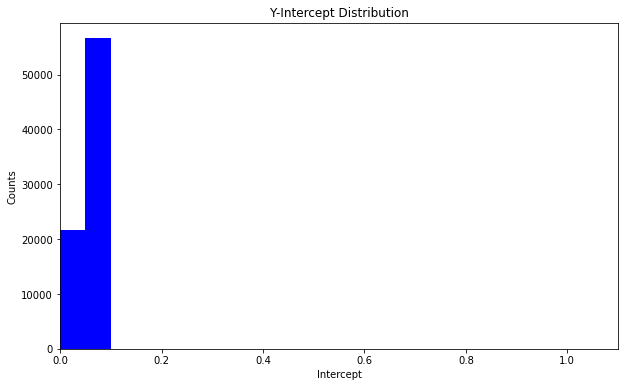

Error


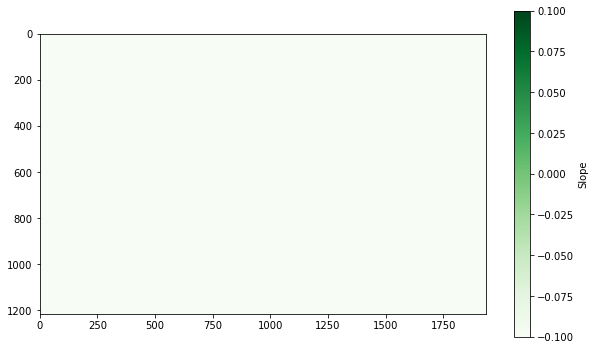

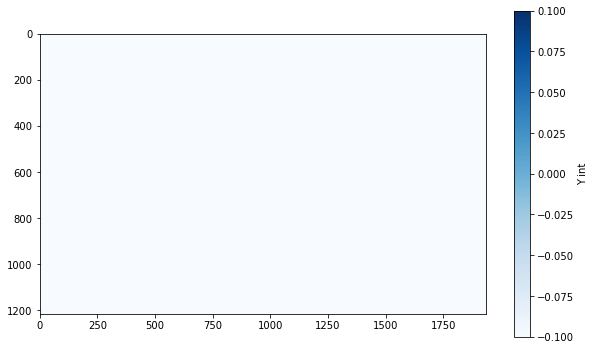

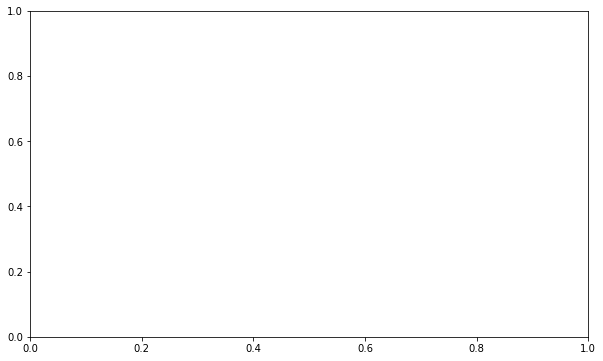

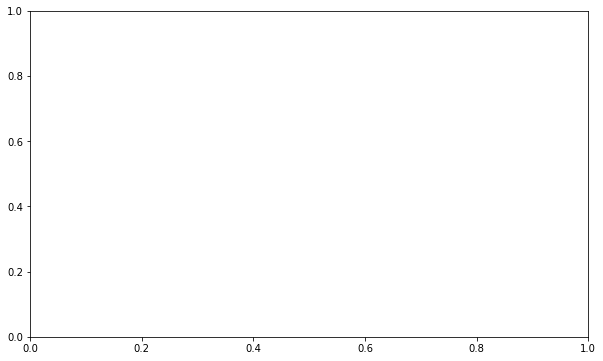

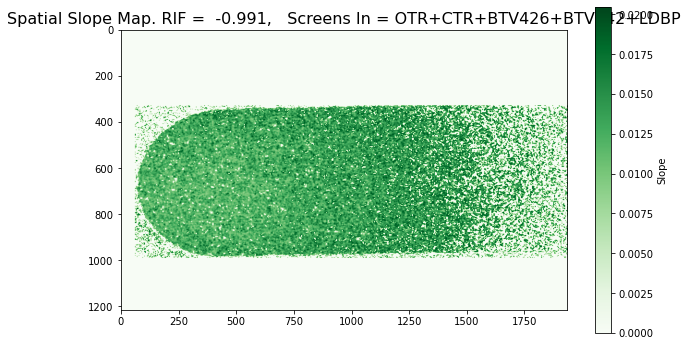

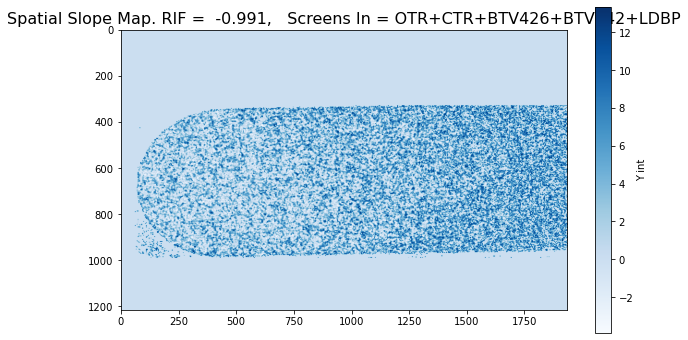

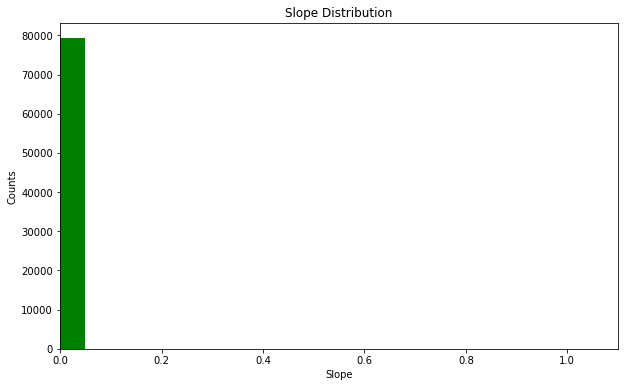

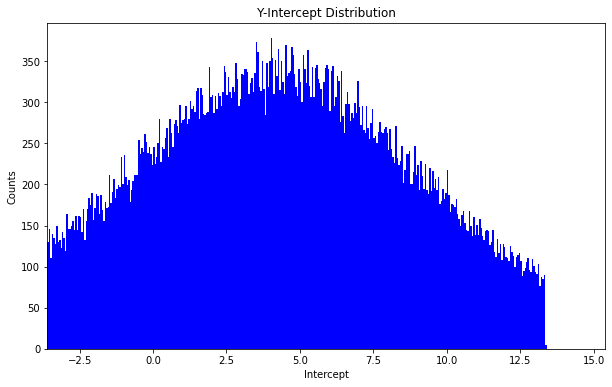

In [31]:
store_slopes_mad_filtering(scin_screen_events_pixel_220_469_16)

# Pixel by Pixel (16 & 17)

In [19]:
scin_screen_events_pixel_16 = sort_by_space_scin_screen(660,1876,100,'2025/05/16')

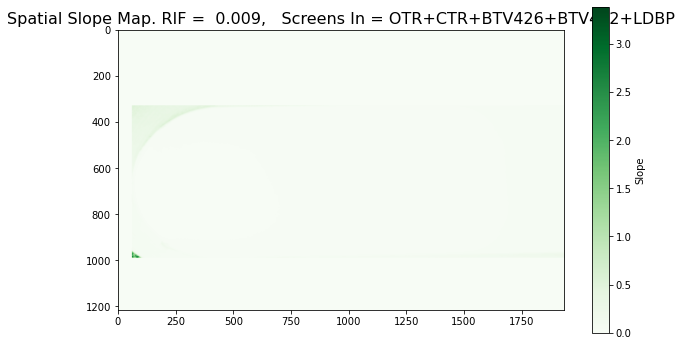

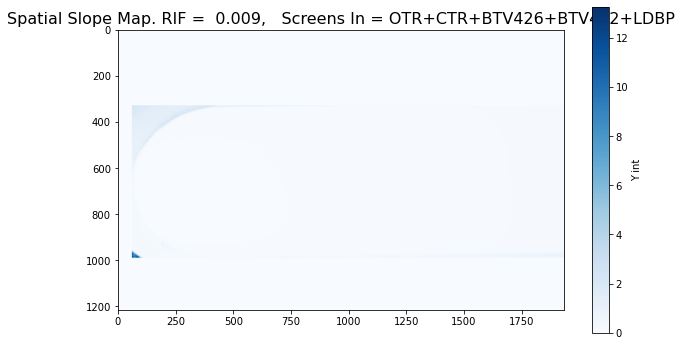

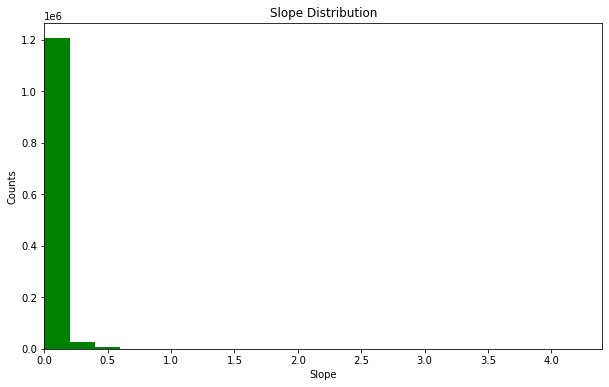

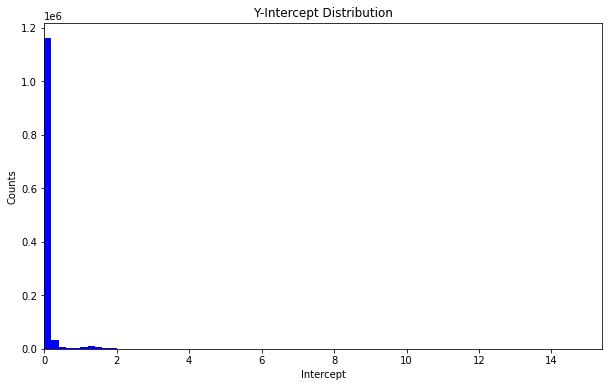

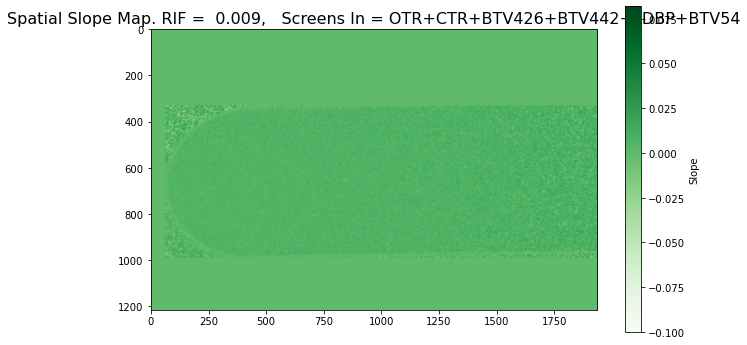

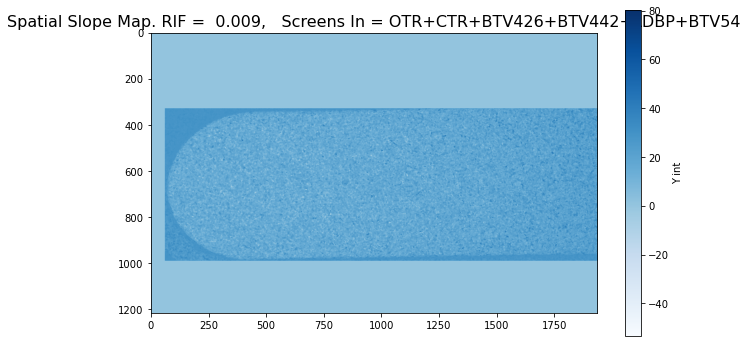

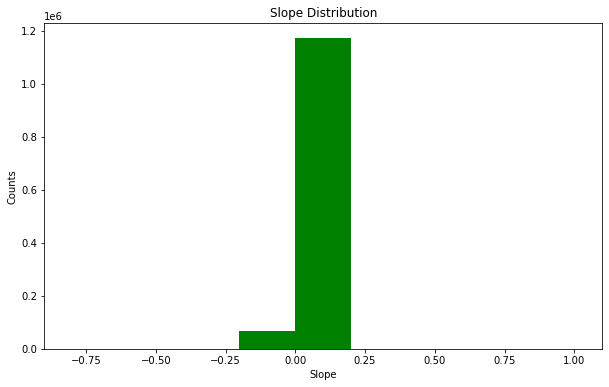

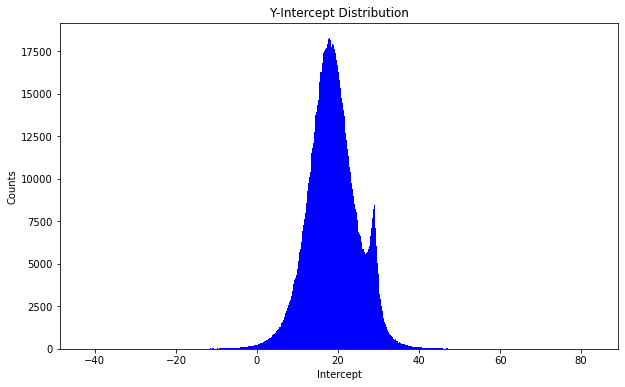

/tmp/ipykernel_458/3616925976.py:32: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


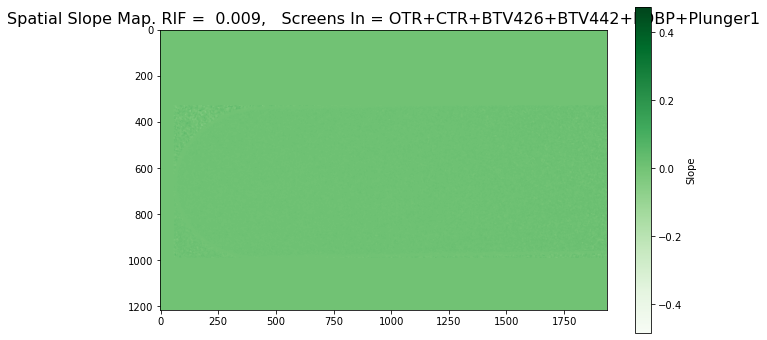

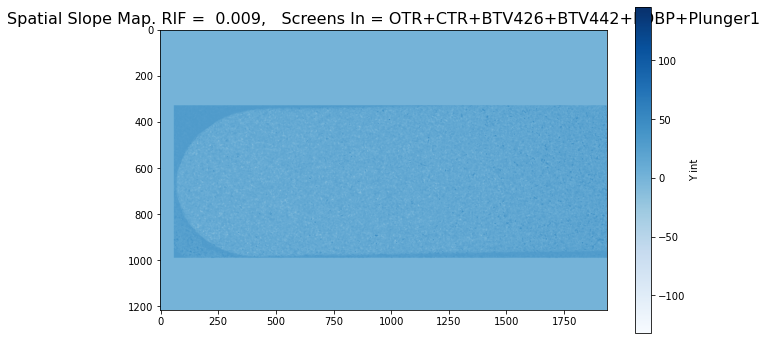

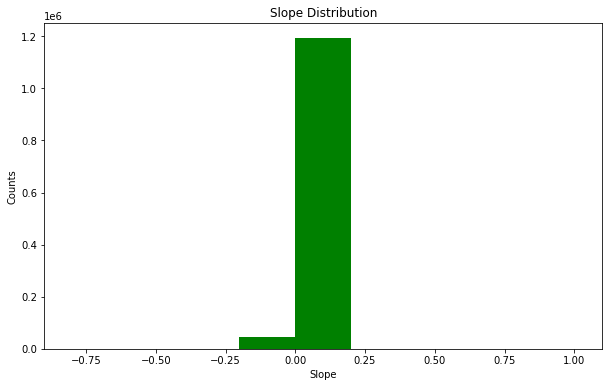

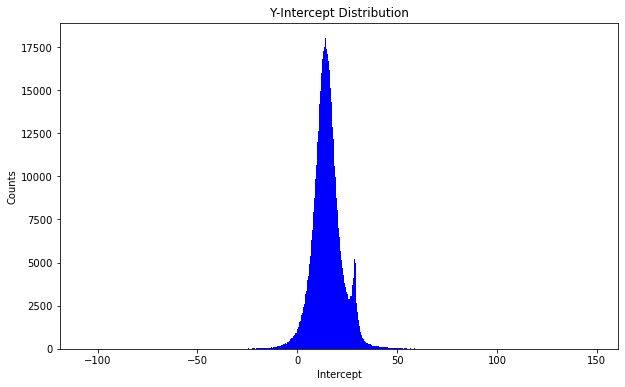

Error


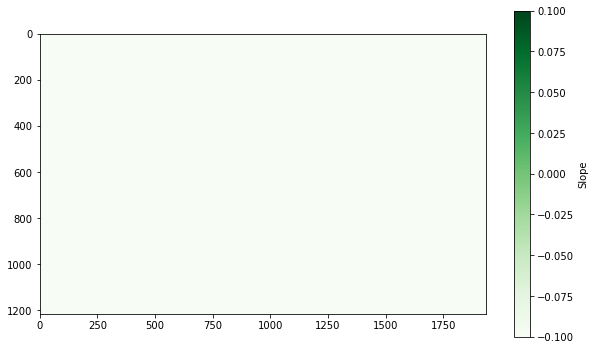

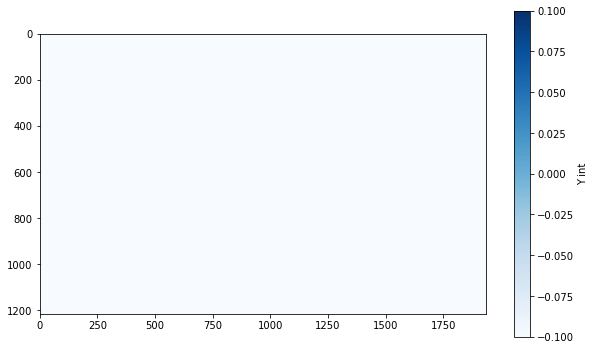

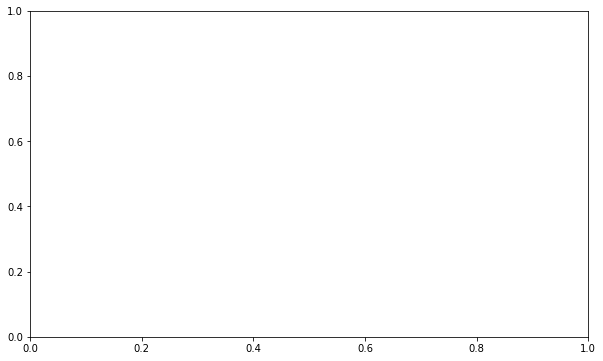

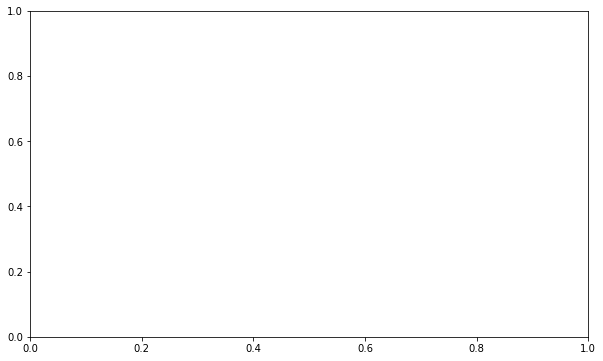

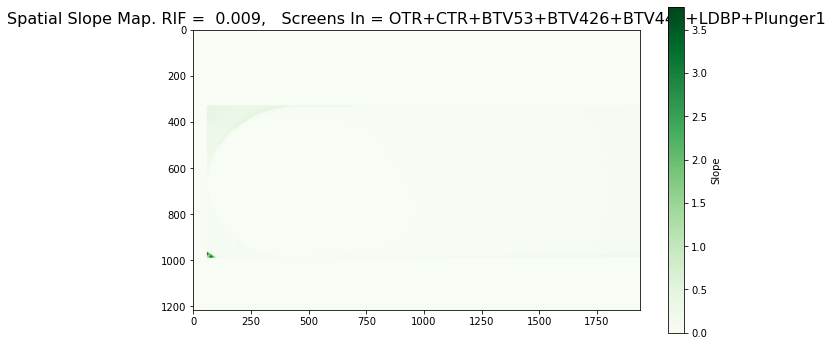

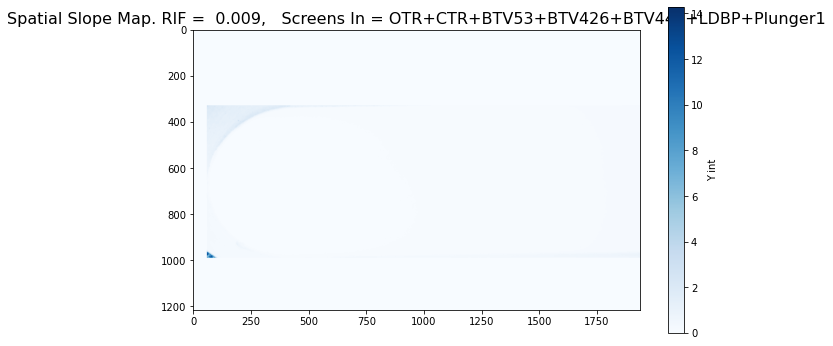

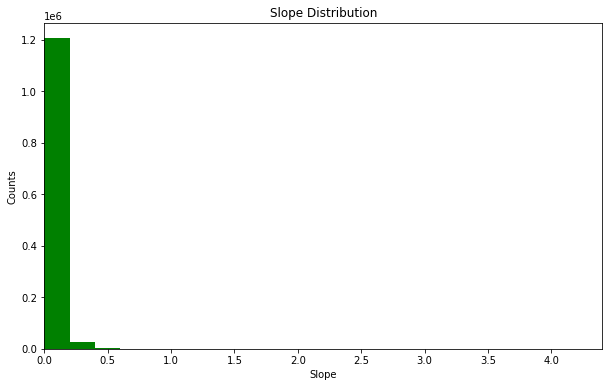

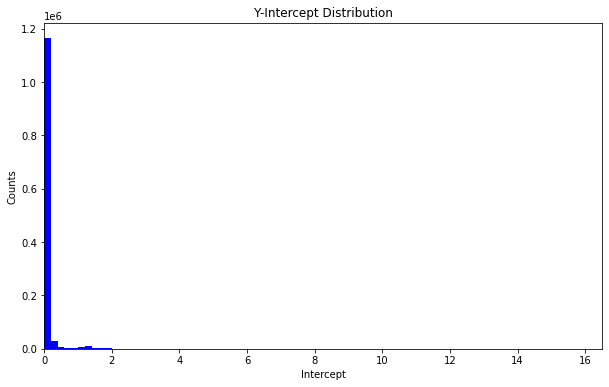

Error


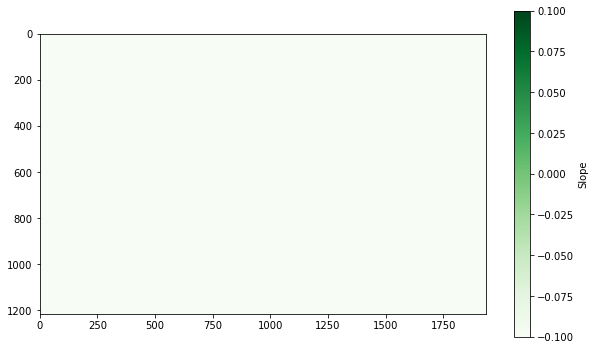

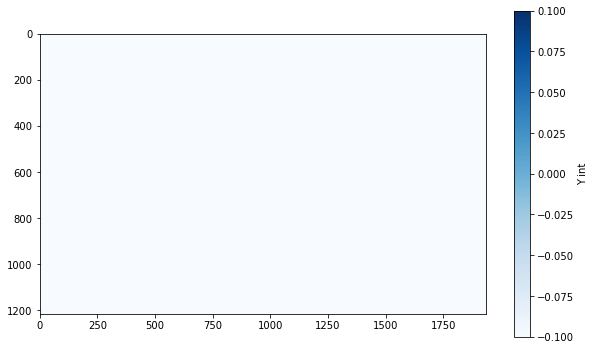

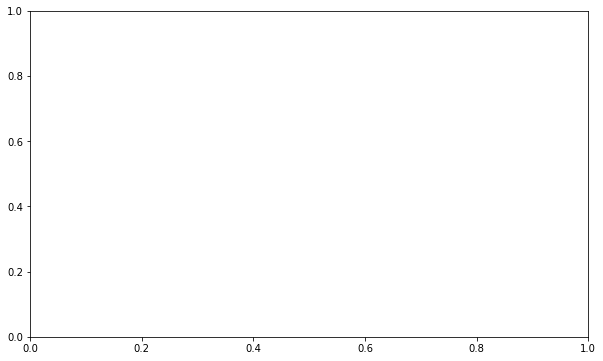

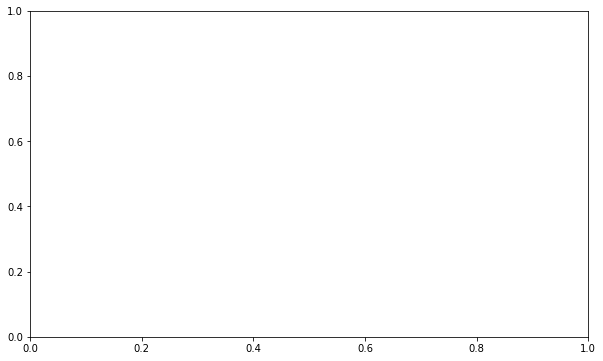

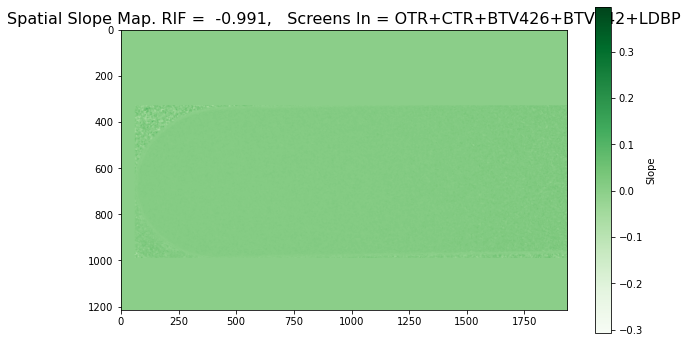

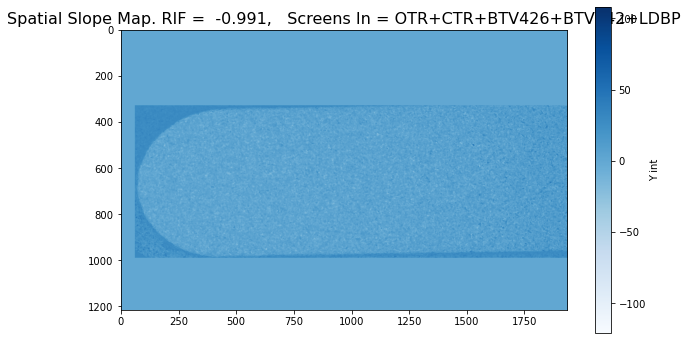

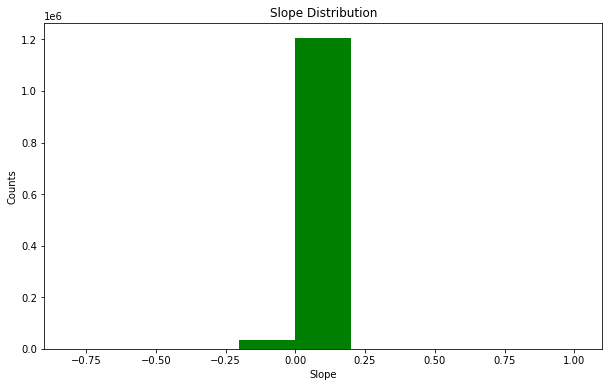

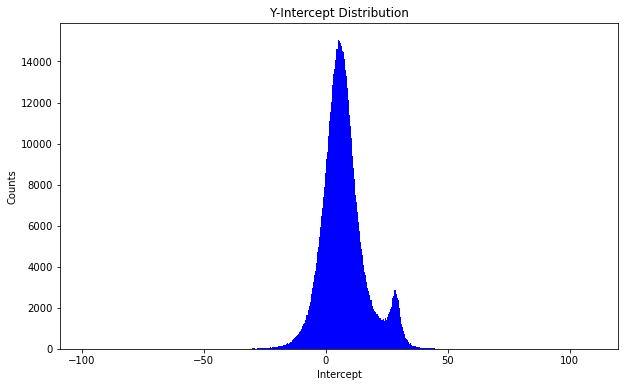

In [21]:
store_slopes_no_filtering(scin_screen_events_pixel_16)

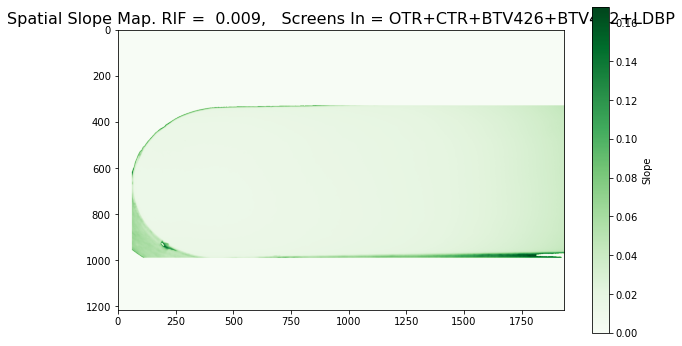

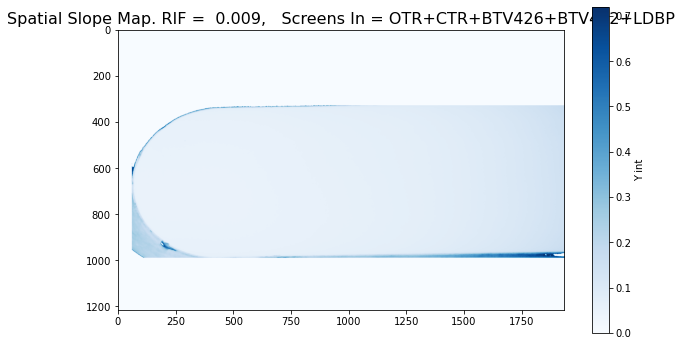

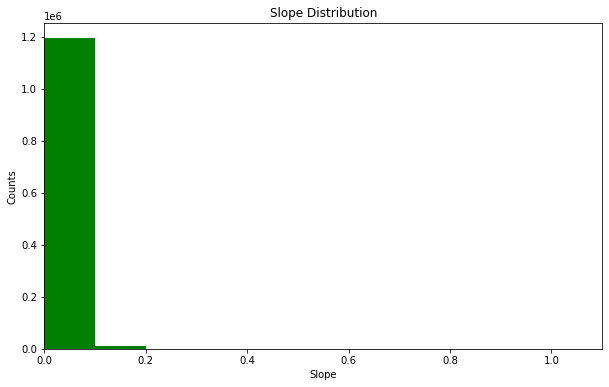

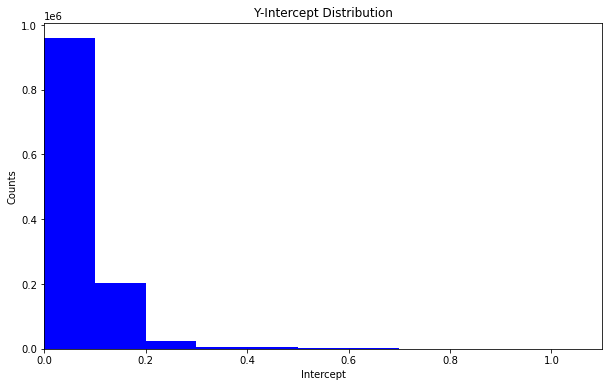

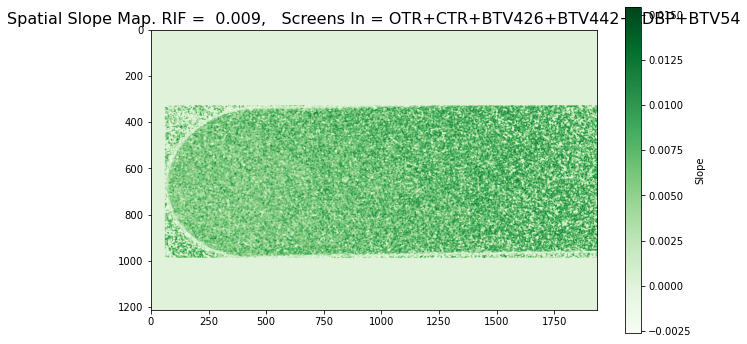

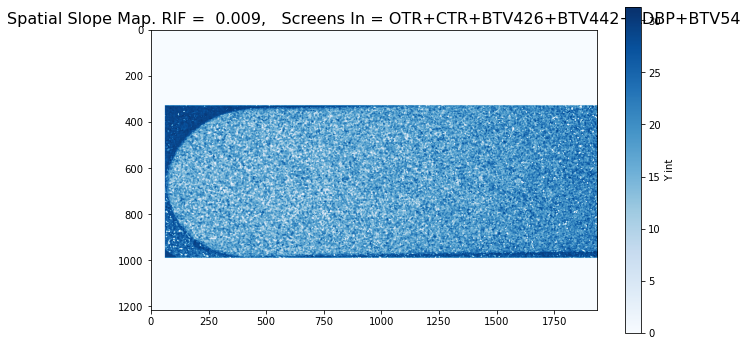

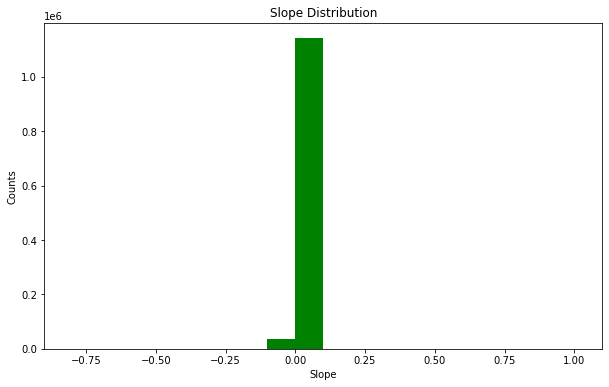

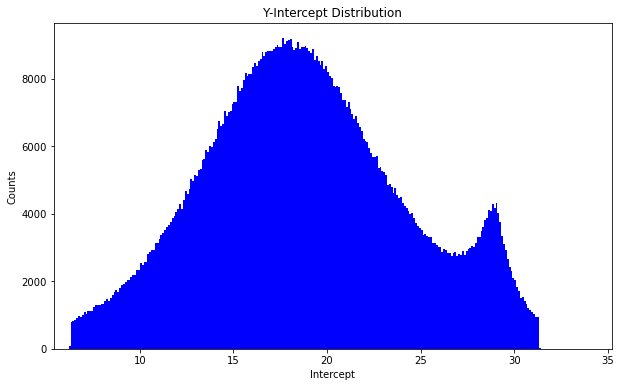

/tmp/ipykernel_458/1964412611.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


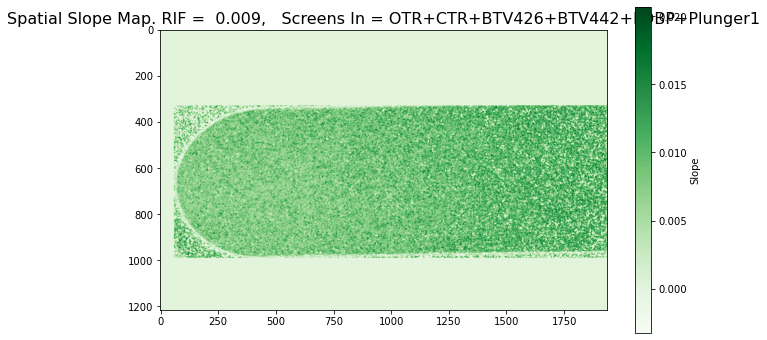

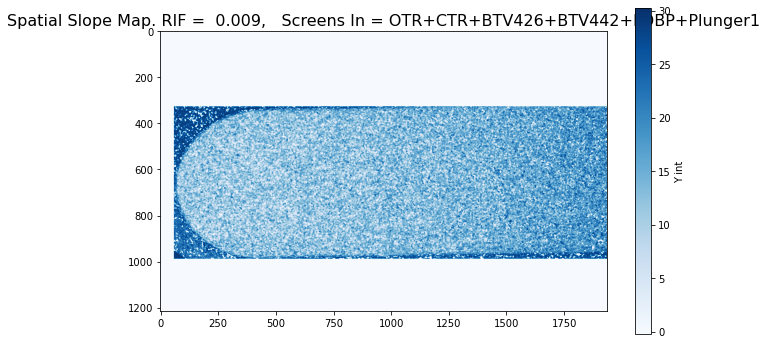

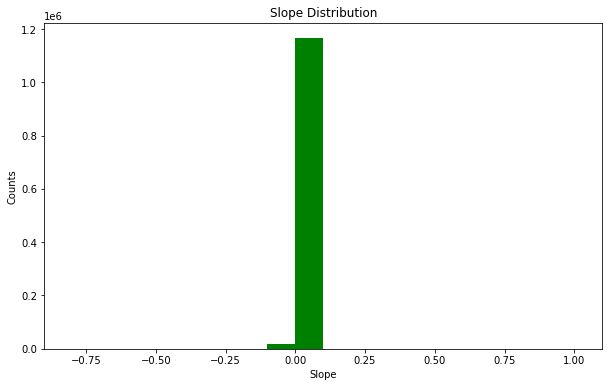

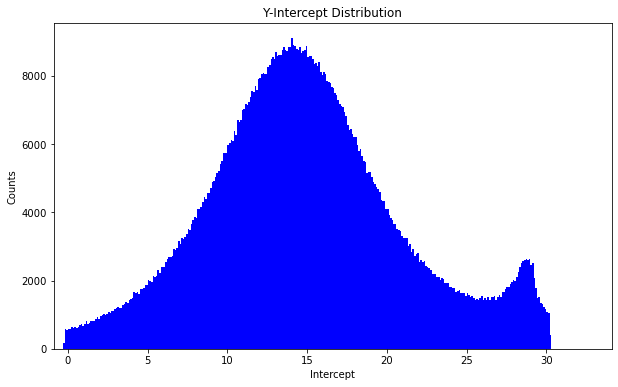

Error


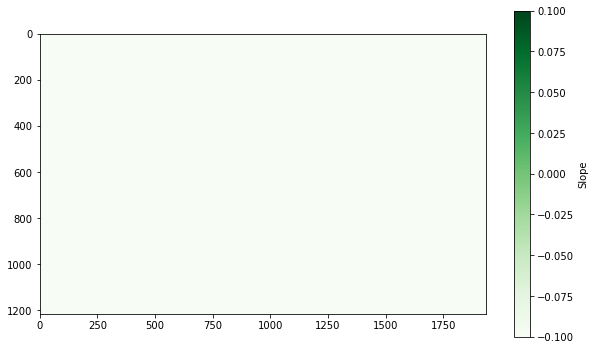

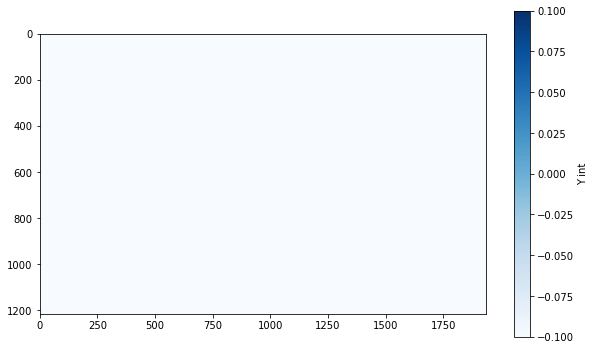

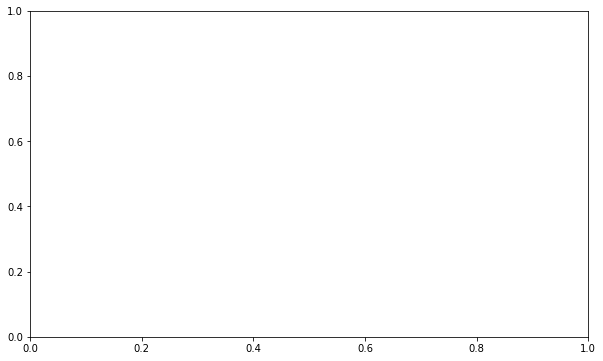

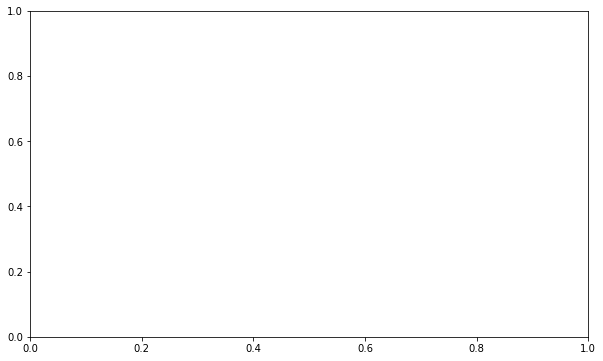

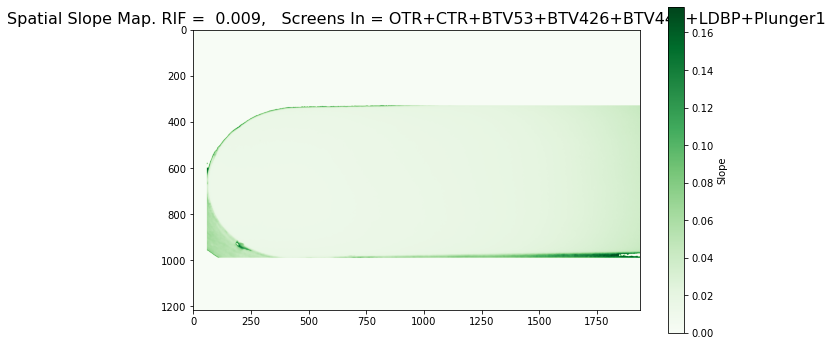

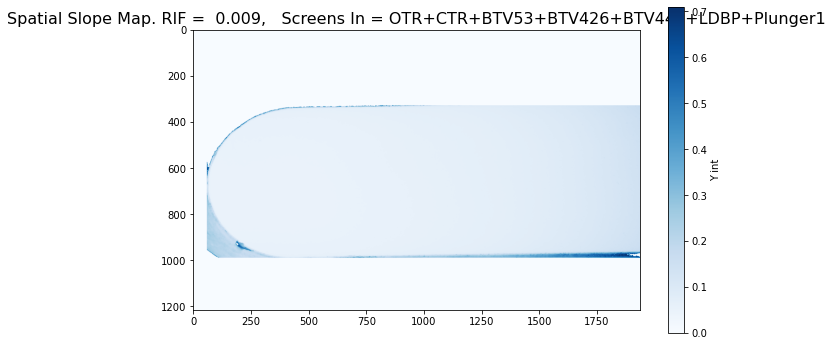

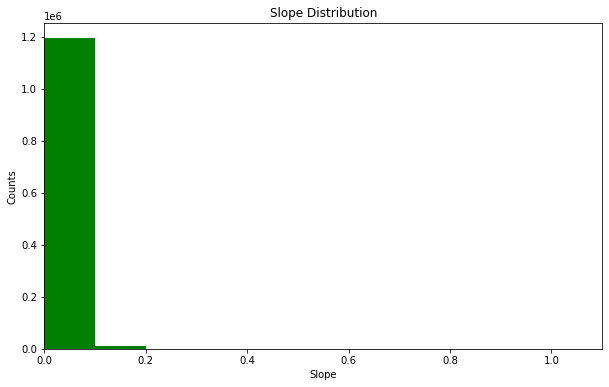

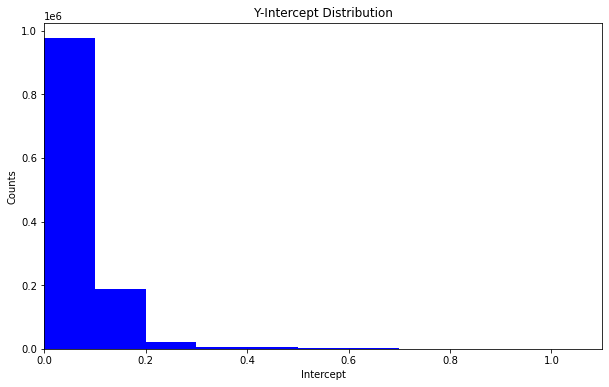

Error


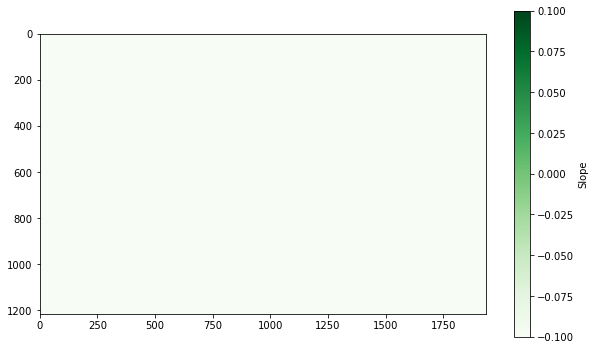

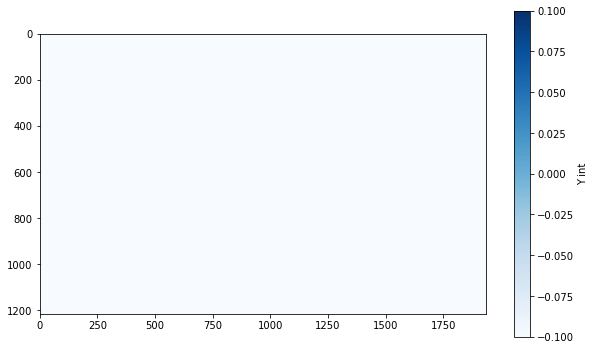

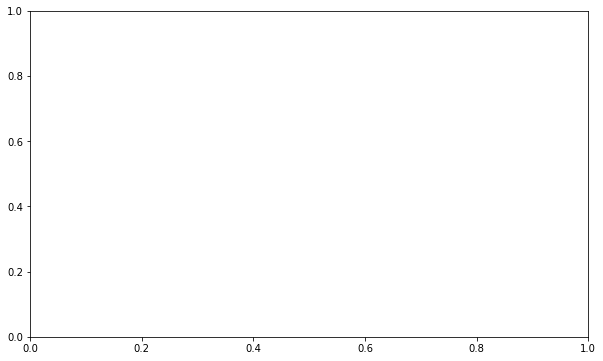

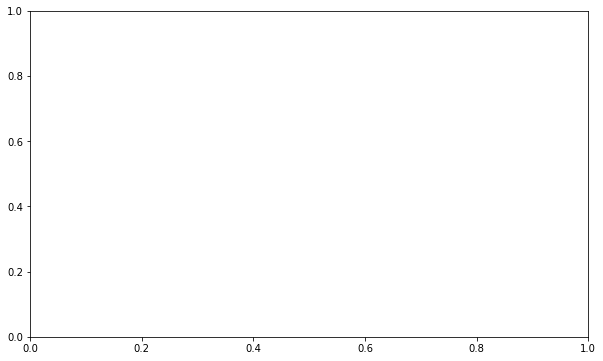

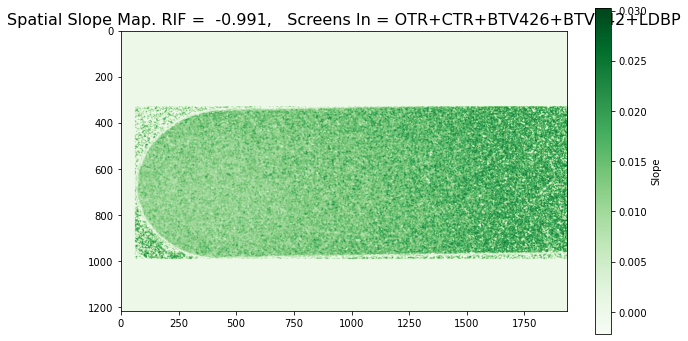

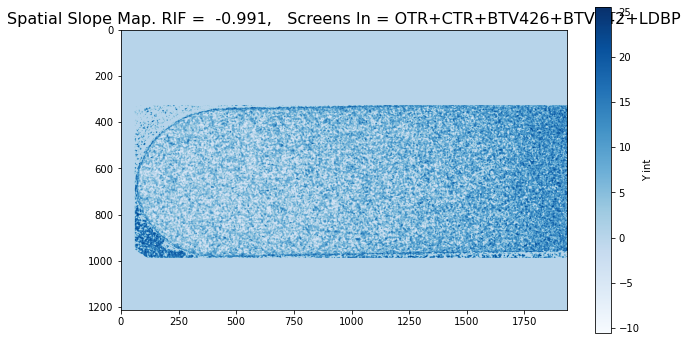

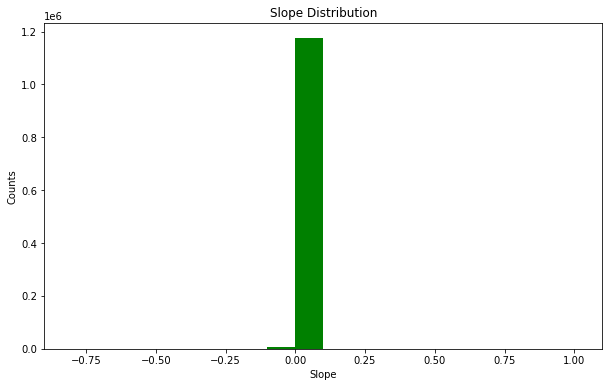

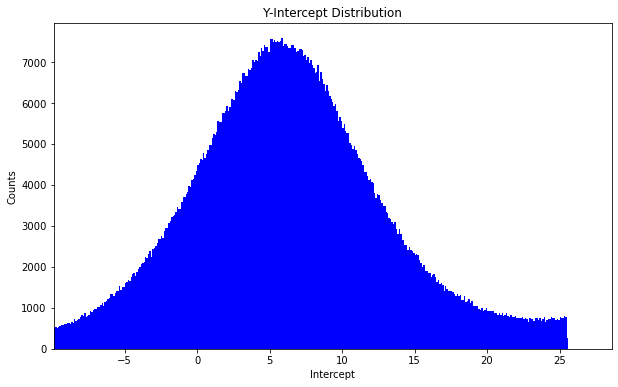

In [22]:
store_slopes_std_filtering(scin_screen_events_pixel_16)

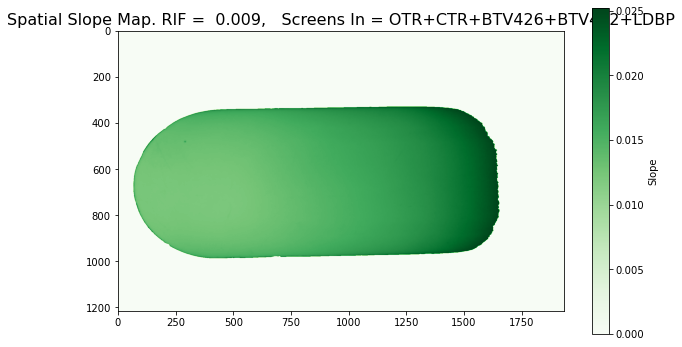

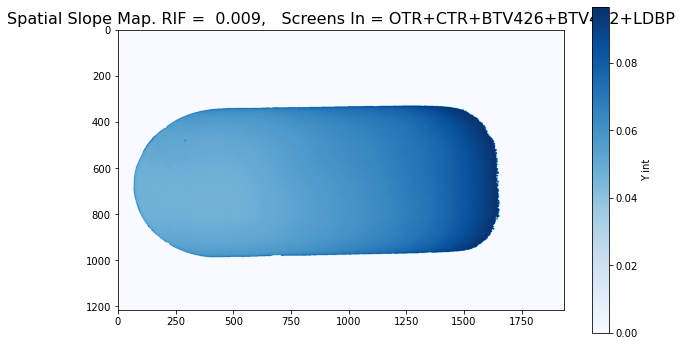

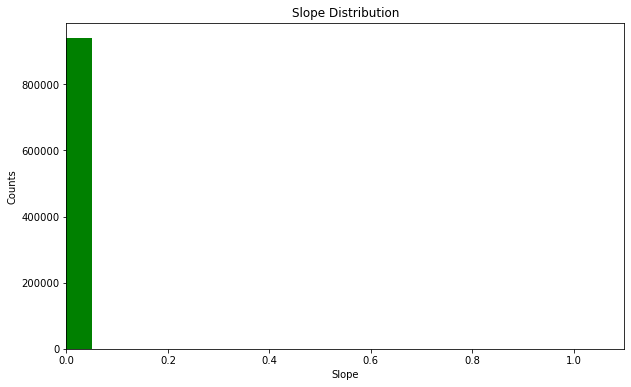

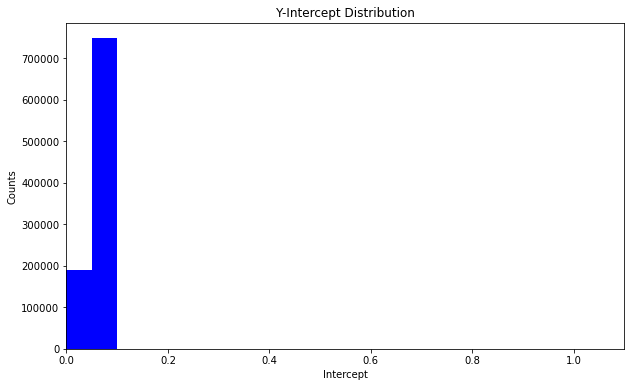

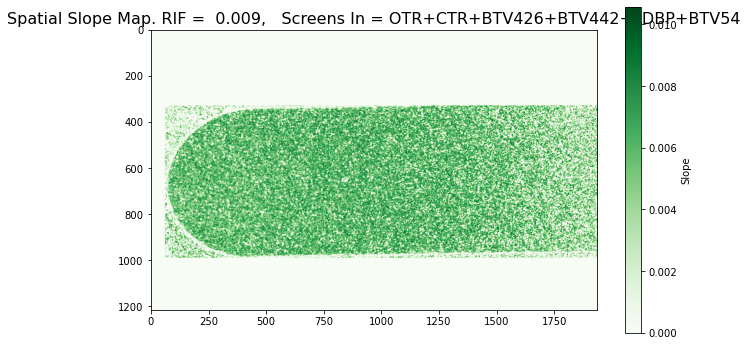

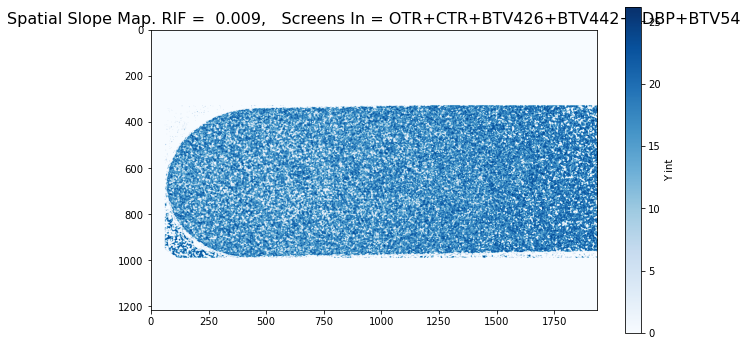

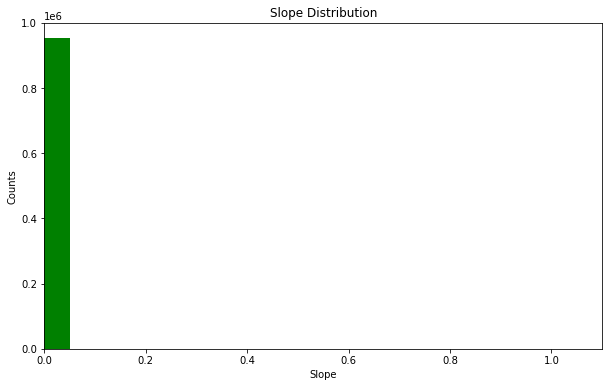

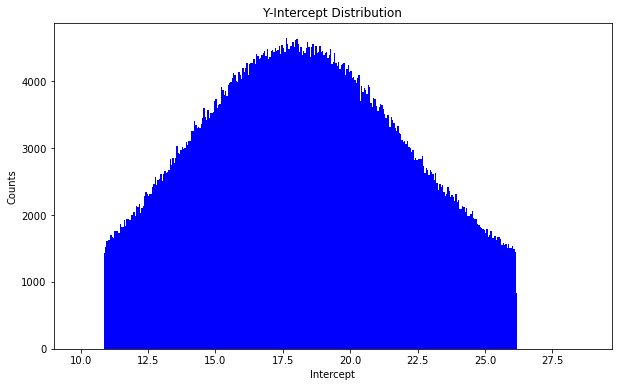

/tmp/ipykernel_458/408449721.py:30: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


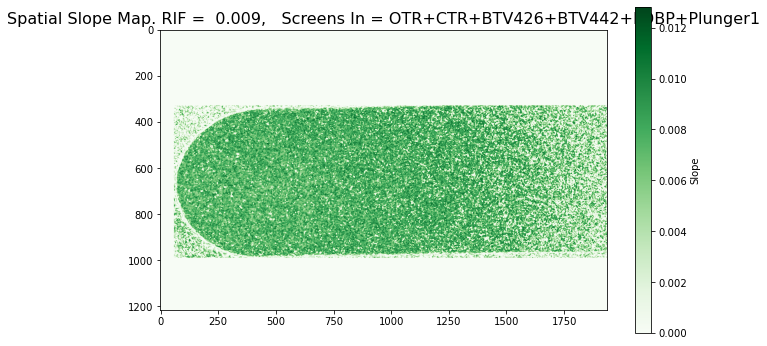

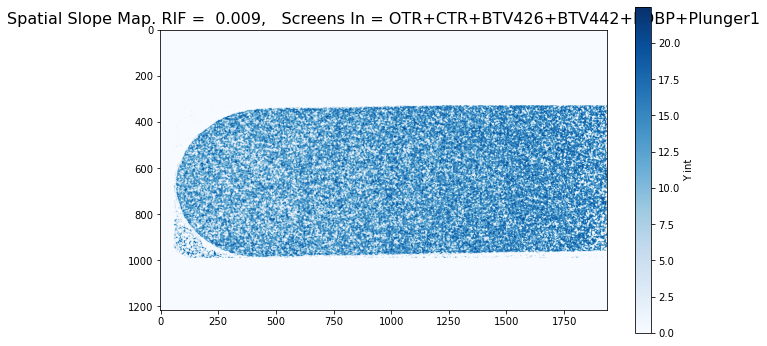

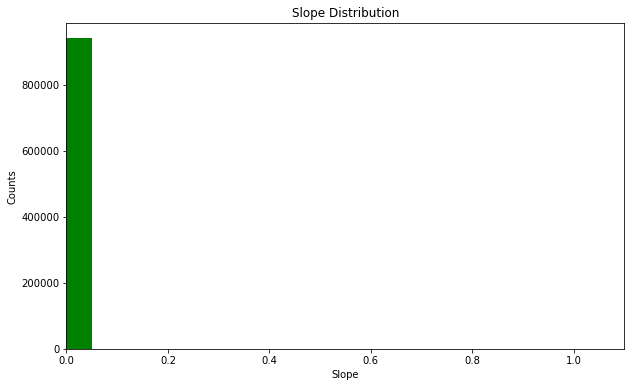

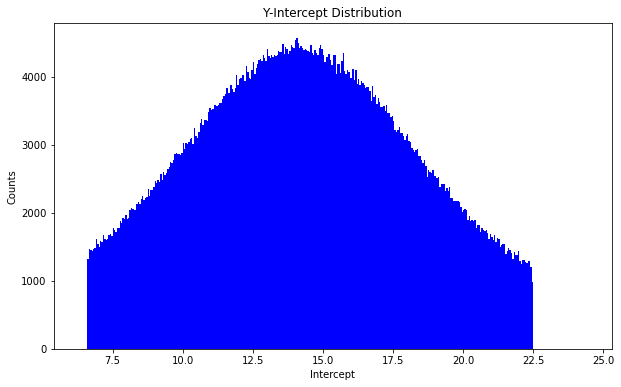

Error


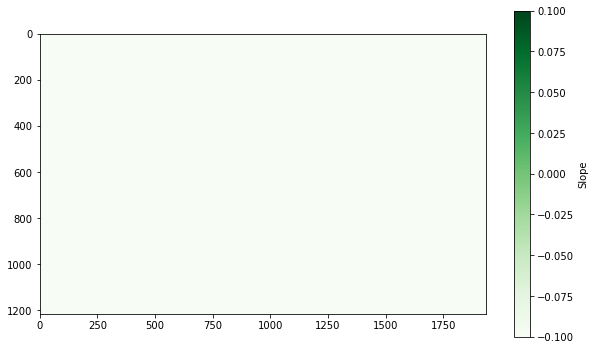

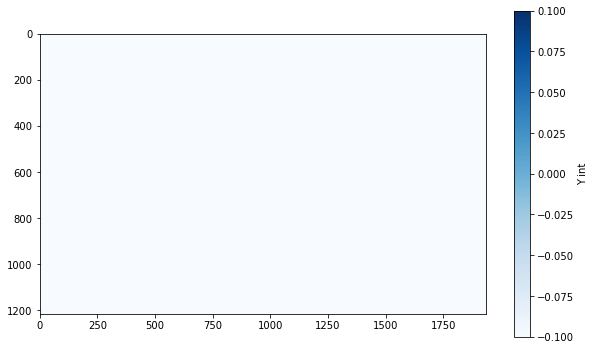

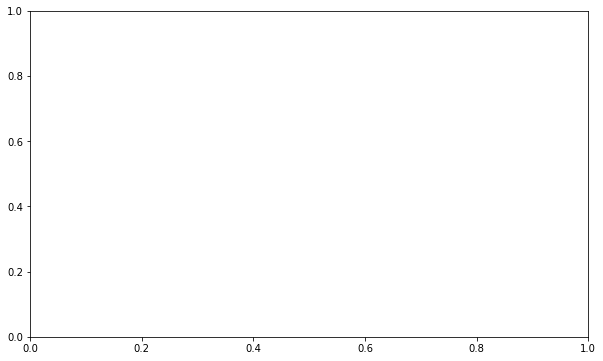

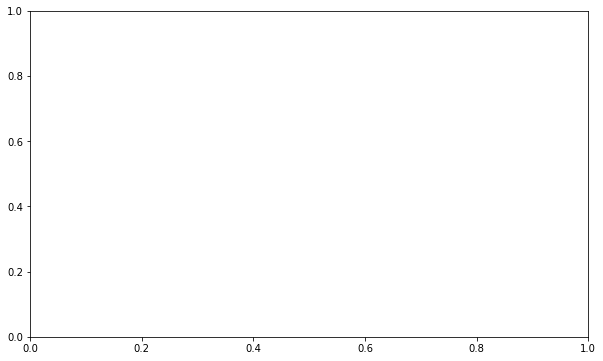

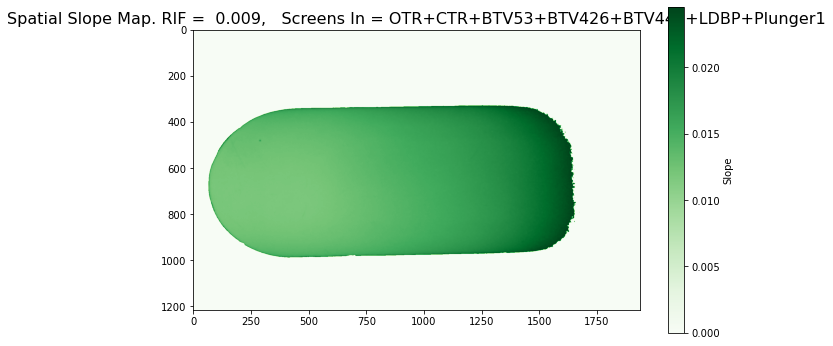

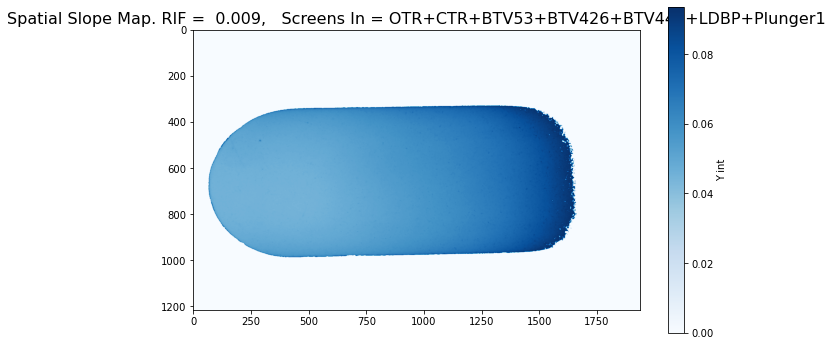

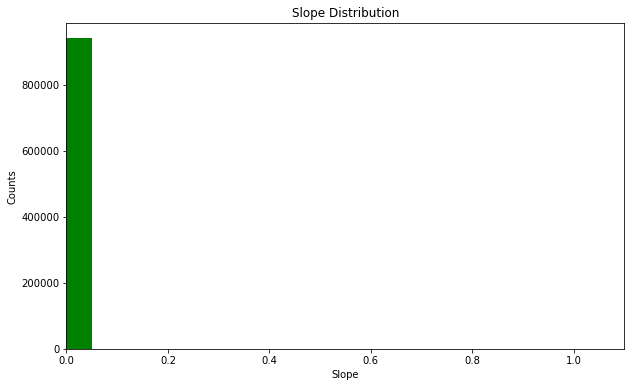

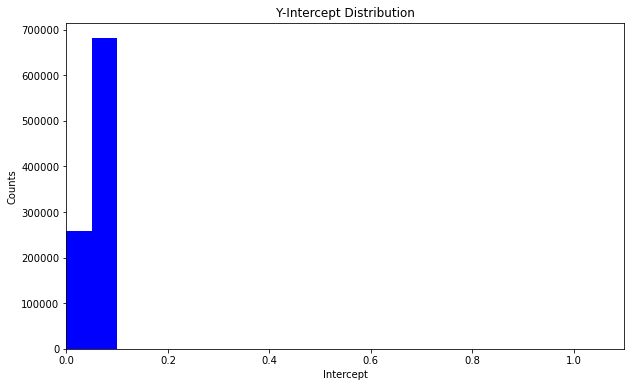

Error


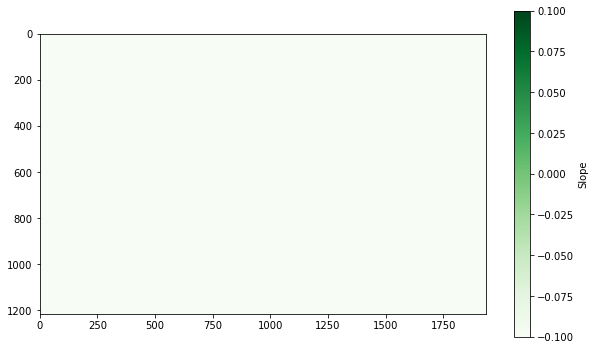

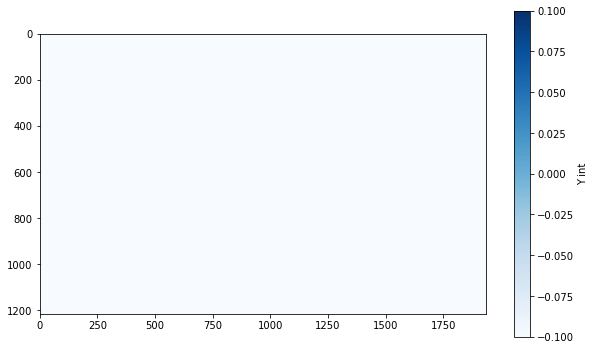

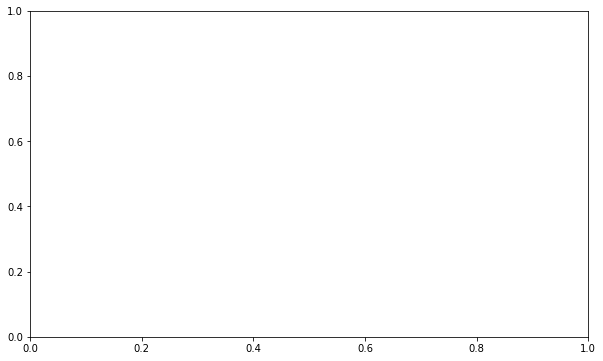

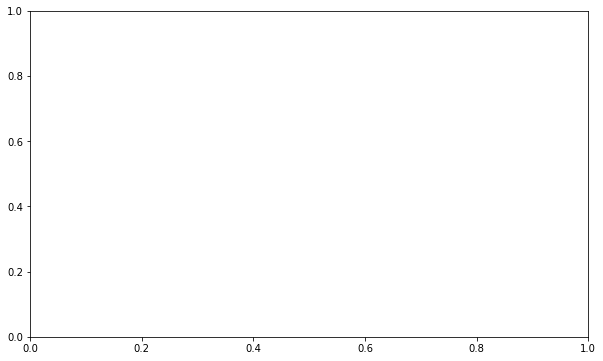

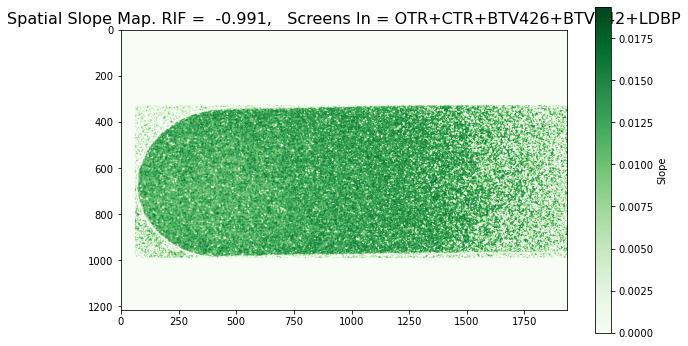

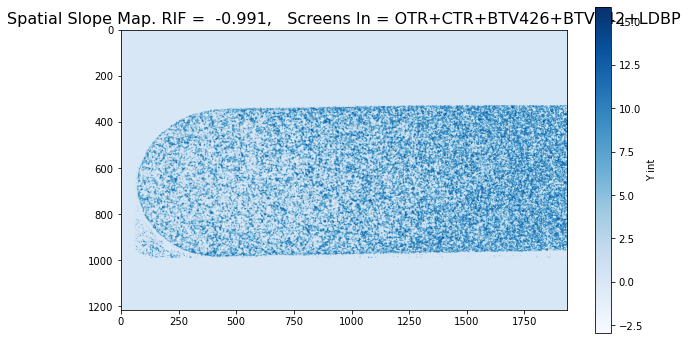

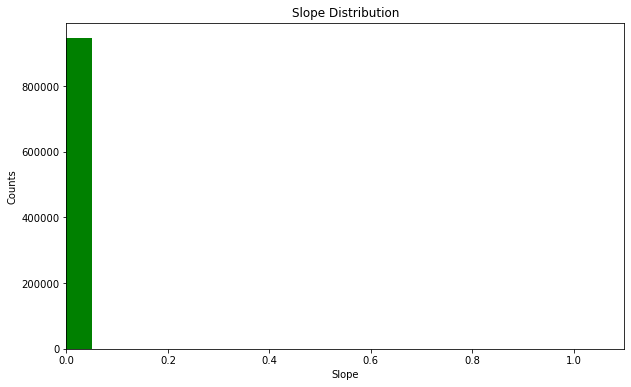

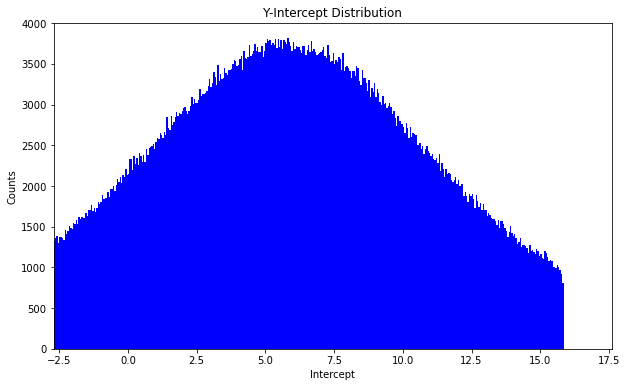

In [20]:
store_slopes_mad_filtering(scin_screen_events_pixel_16)

In [ ]:
scin_screen_events_pixel_17 = sort_by_space_scin_screen(660,1876,100,'2025/05/17')

In [ ]:
store_slopes_no_filtering(scin_screen_events_pixel_17)

In [ ]:
scin_screen_events_pixel_330_938_16 = sort_by_space_scin_screen(330,938,100,'2025/05/16')

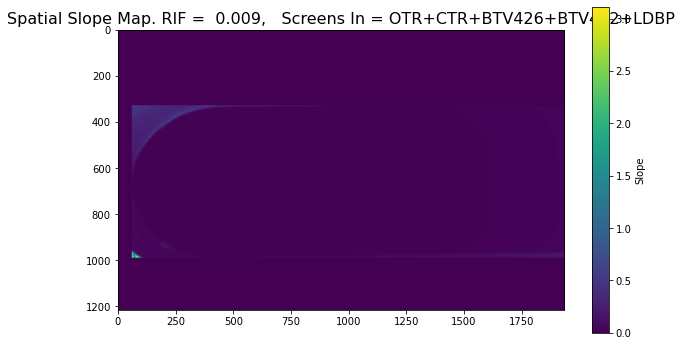

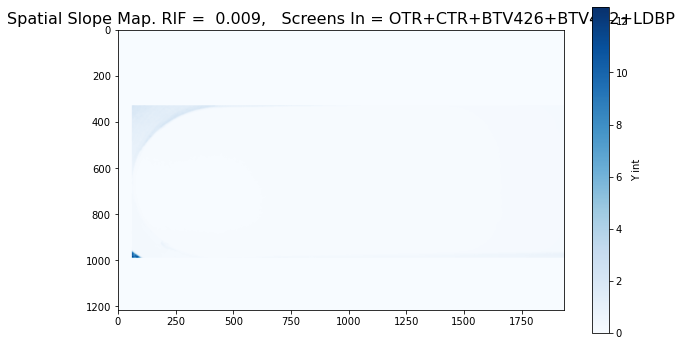

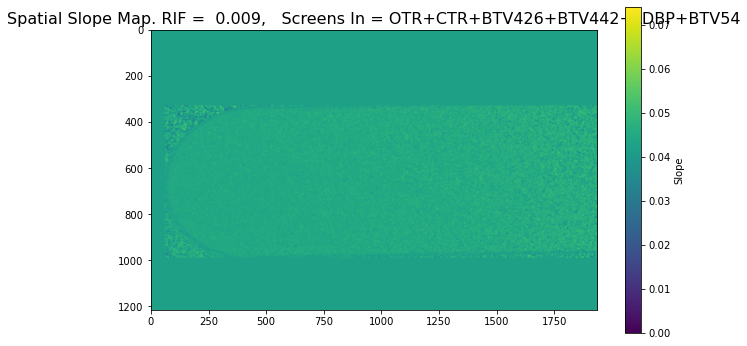

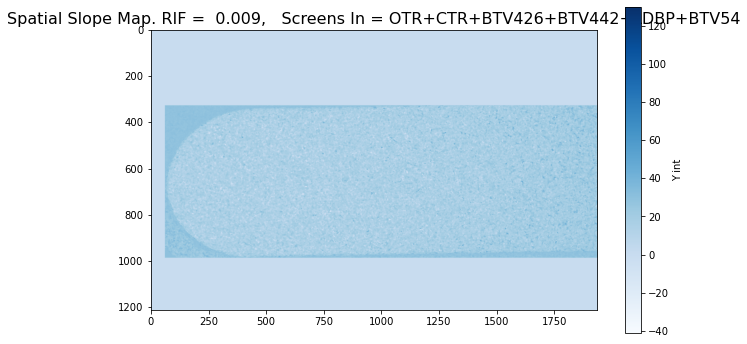

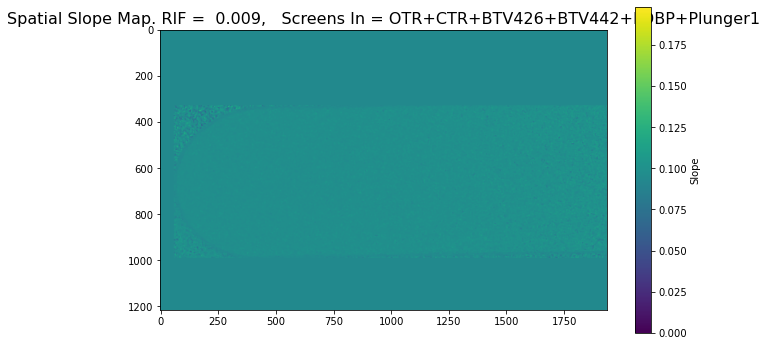

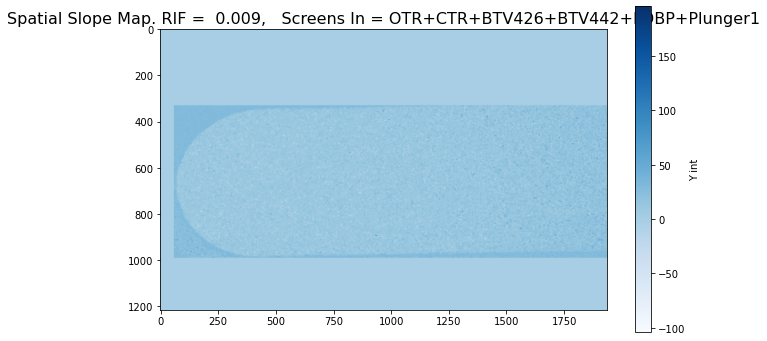

/tmp/ipykernel_458/3749705734.py:28: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


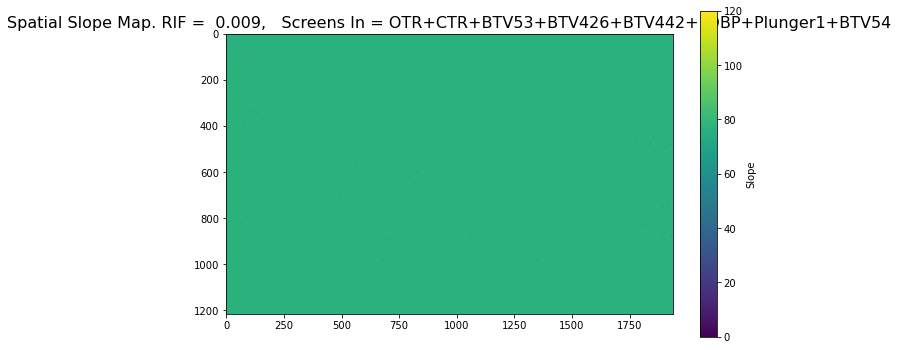

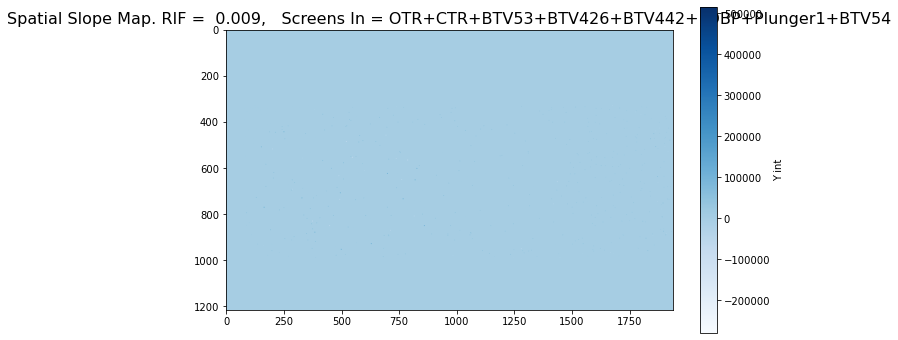

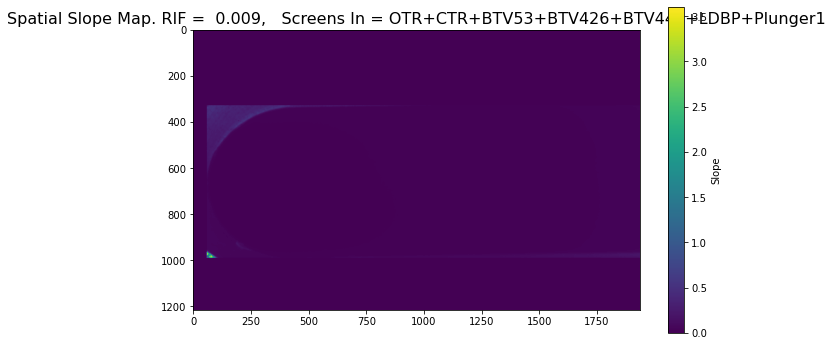

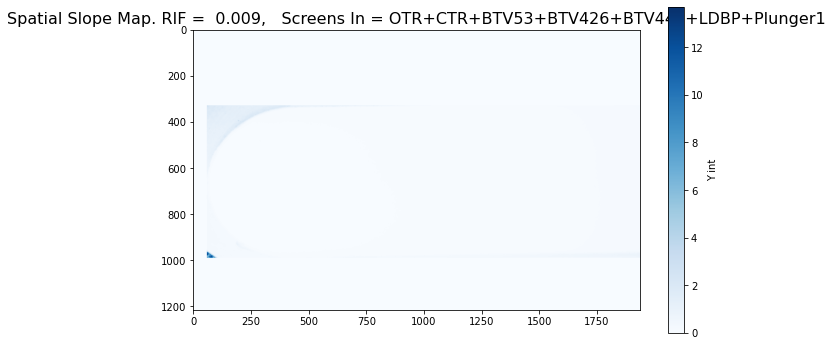

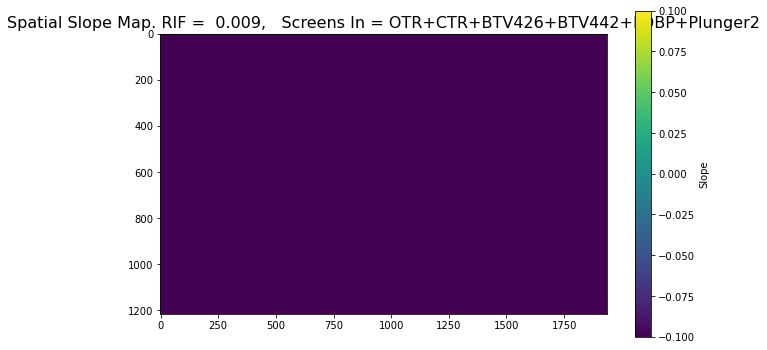

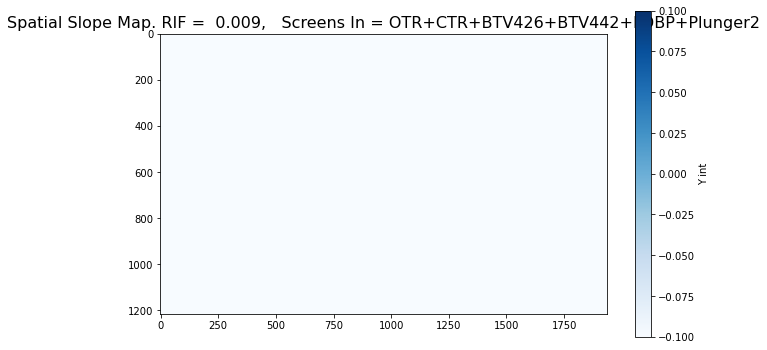

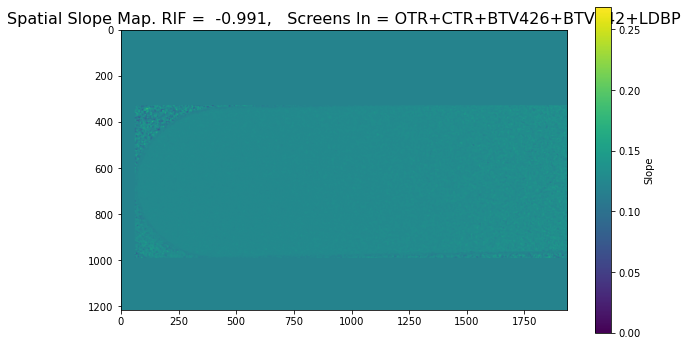

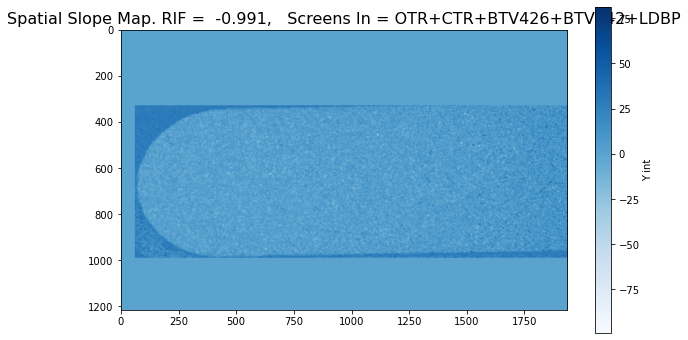

In [41]:
store_slopes(scin_screen_events_pixel_330_938_16)

In [42]:
scin_screen_events_pixel_by_pixel_16 = sort_by_space_scin_screen(660,1876,100,'2025/05/16')

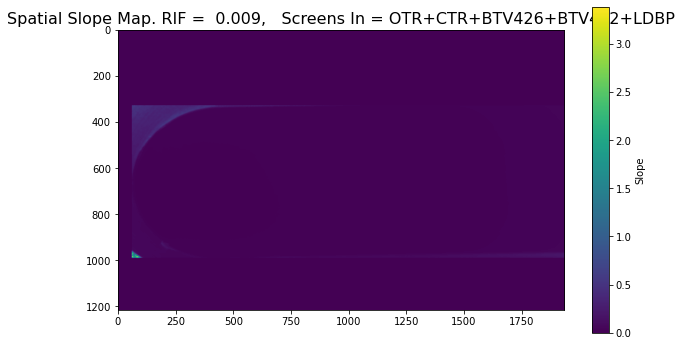

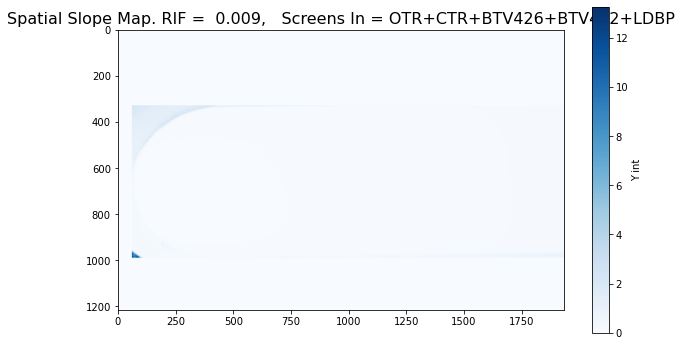

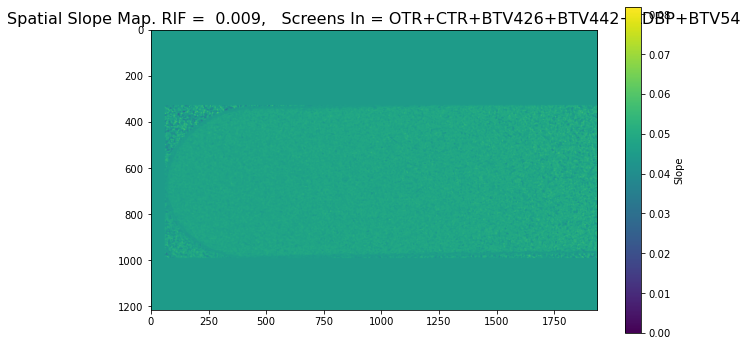

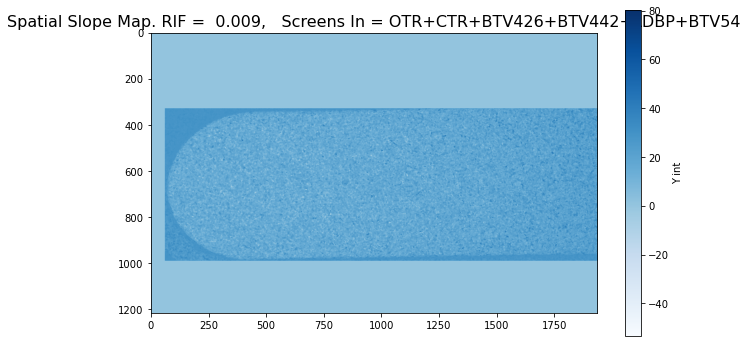

/tmp/ipykernel_458/3749705734.py:28: OptimizeWarning: Covariance of the parameters could not be estimated
  params = curve_fit(fit_line, x, y)[0]


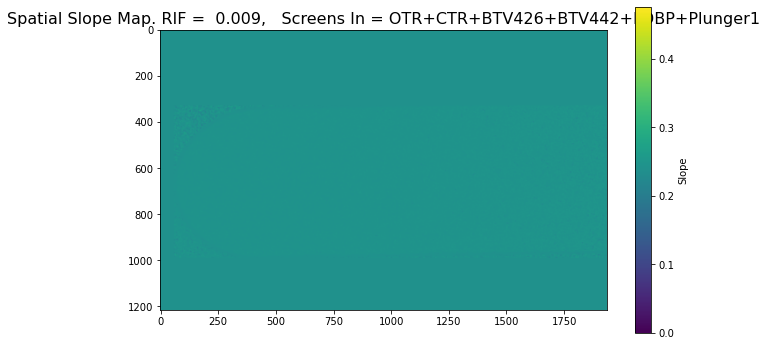

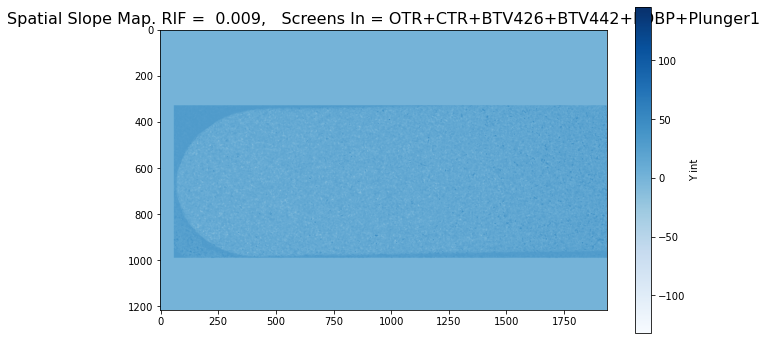

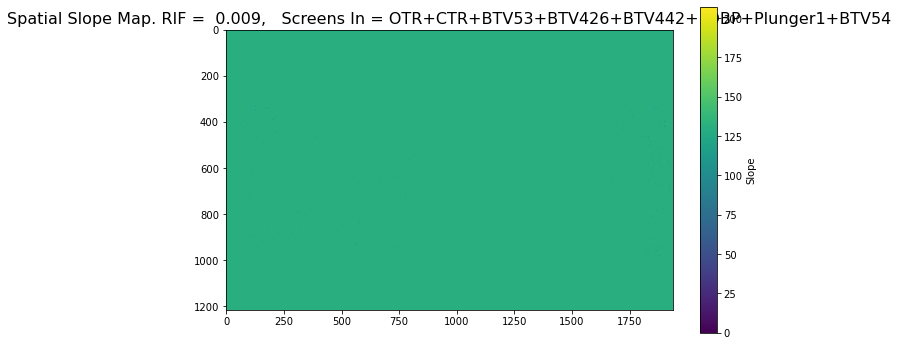

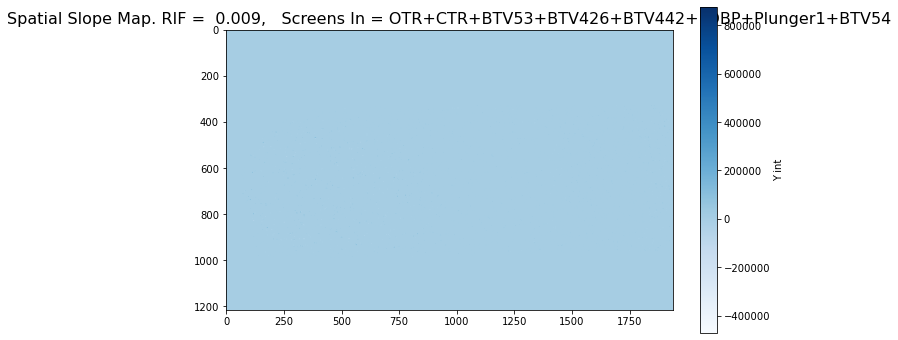

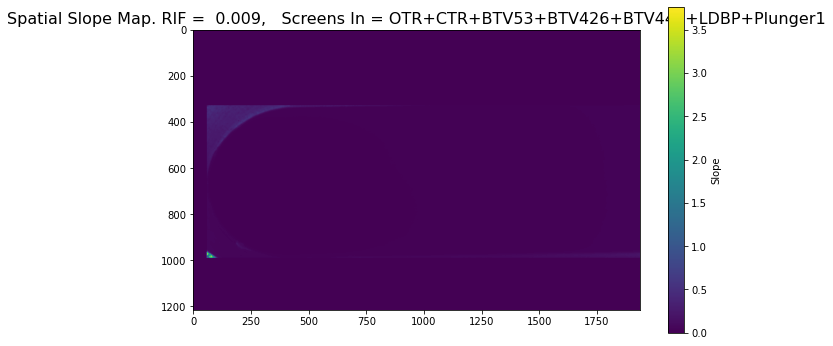

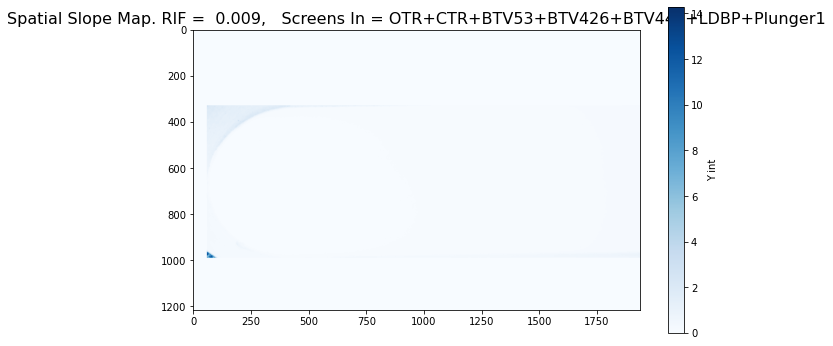

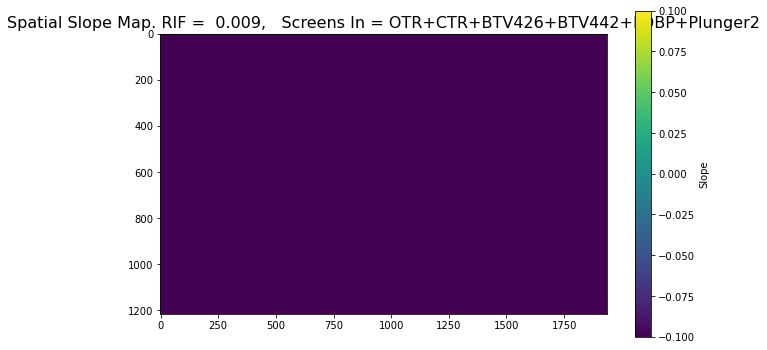

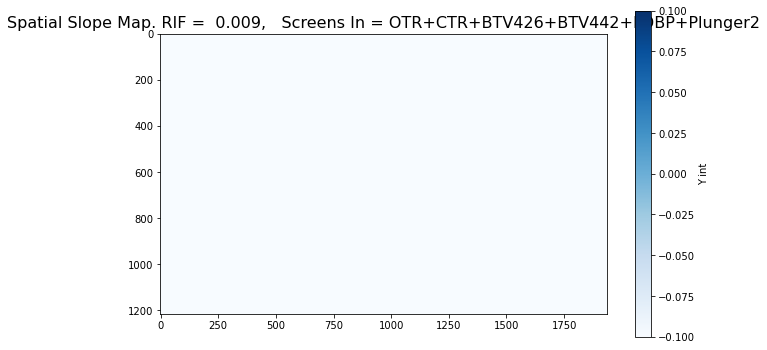

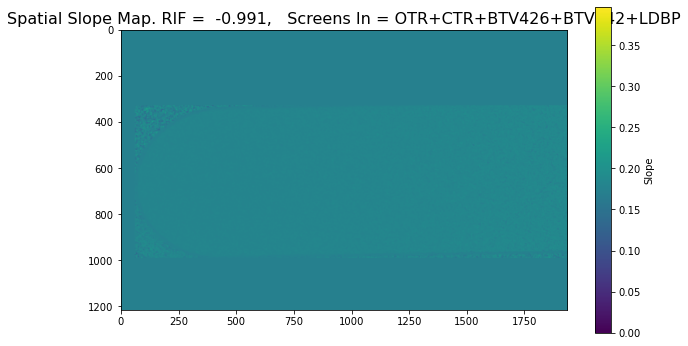

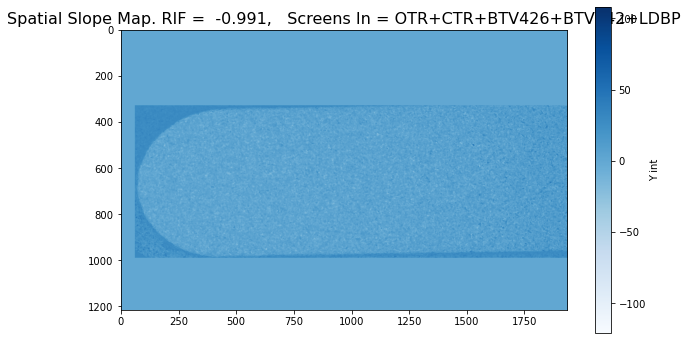

In [43]:
store_slopes(scin_screen_events_pixel_by_pixel_16)